In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
## Unzipping the files and extracting all the folders

!unzip "/content/drive/MyDrive/Datasets/wheat spike detection/global-wheat-detection.zip"


Archive:  /content/drive/MyDrive/Datasets/wheat spike detection/global-wheat-detection.zip
  inflating: sample_submission.csv   
  inflating: test/2fd875eaa.jpg      
  inflating: test/348a992bb.jpg      
  inflating: test/51b3e36ab.jpg      
  inflating: test/51f1be19e.jpg      
  inflating: test/53f253011.jpg      
  inflating: test/796707dd7.jpg      
  inflating: test/aac893a91.jpg      
  inflating: test/cb8d261a3.jpg      
  inflating: test/cc3532ff6.jpg      
  inflating: test/f5a1f0358.jpg      
  inflating: train.csv               
  inflating: train/00333207f.jpg     
  inflating: train/005b0d8bb.jpg     
  inflating: train/006a994f7.jpg     
  inflating: train/00764ad5d.jpg     
  inflating: train/00b5c6764.jpg     
  inflating: train/00b5fefed.jpg     
  inflating: train/00b70a919.jpg     
  inflating: train/00e903abe.jpg     
  inflating: train/00ea5e5ee.jpg     
  inflating: train/010b216d4.jpg     
  inflating: train/010c93b99.jpg     
  inflating: train/010dbcc8f.jpg   

In [ ]:
#!pip install --upgrade albumentations
!git clone https://github.com/facebookresearch/detr.git   #cloning github repo of detr to import its unique loss

fatal: destination path 'detr' already exists and is not an empty directory.


In [ ]:
import os
import numpy as np
import pandas as pd
from datetime import datetime
import time
import random
from tqdm.autonotebook import tqdm

!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118

#Torch
import torch
import torch.nn as nn
from torch.utils.data import Dataset,DataLoader
from torch.utils.data.sampler import SequentialSampler, RandomSampler

#sklearn
from sklearn.model_selection import StratifiedKFold

#CV
import cv2

################# DETR FUCNTIONS FOR LOSS########################
import sys
sys.path.append('/content/detr')

from detr.models.matcher import HungarianMatcher
from detr.models.detr import SetCriterion
#################################################################

#Albumenatations
import albumentations as A
#from albumentations.augmentations.bbox_utils import normalize_bboxes
import matplotlib.pyplot as plt
from albumentations.pytorch.transforms import ToTensorV2

#Glob
from glob import glob

<ipython-input-6-168b408f0149>:7: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


Looking in indexes: https://download.pytorch.org/whl/cu118


In [ ]:
#Configuration

n_folds = 5
seed = 42
num_classes = 2
num_queries = 100
null_class_coef = 0.5
BATCH_SIZE = 8
LR = 1e-5
EPOCHS = 10

In [ ]:
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = True

seed_everything(seed)

In [ ]:
marking = pd.read_csv('/content/train.csv')

bboxs = np.stack(marking['bbox'].apply(lambda x: np.fromstring(x[1:-1], sep=',')))
for i, column in enumerate(['x', 'y', 'w', 'h']):
    marking[column] = bboxs[:,i]
marking.drop(columns=['bbox'], inplace=True)

In [ ]:
marking.head()


,image_id,width,height,source,x,y,w,h
0,b6ab77fd7,1024,1024,usask_1,834.0,222.0,56.0,36.0
1,b6ab77fd7,1024,1024,usask_1,226.0,548.0,130.0,58.0
2,b6ab77fd7,1024,1024,usask_1,377.0,504.0,74.0,160.0
3,b6ab77fd7,1024,1024,usask_1,834.0,95.0,109.0,107.0
4,b6ab77fd7,1024,1024,usask_1,26.0,144.0,124.0,117.0


In [ ]:
# Creating Folds
skf = StratifiedKFold(n_splits=n_folds, shuffle=True, random_state=seed)

df_folds = marking[['image_id']].copy()
df_folds.loc[:, 'bbox_count'] = 1
df_folds = df_folds.groupby('image_id').count()
df_folds.loc[:, 'source'] = marking[['image_id', 'source']].groupby('image_id').min()['source']
df_folds.loc[:, 'stratify_group'] = np.char.add(
    df_folds['source'].values.astype(str),
    df_folds['bbox_count'].apply(lambda x: f'_{x // 15}').values.astype(str)
)
df_folds.loc[:, 'fold'] = 0

for fold_number, (train_index, val_index) in enumerate(skf.split(X=df_folds.index, y=df_folds['stratify_group'])):
    df_folds.loc[df_folds.iloc[val_index].index, 'fold'] = fold_number


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


In [ ]:
def get_train_transforms():
    return A.Compose([A.OneOf([A.HueSaturationValue(hue_shift_limit=0.2, sat_shift_limit= 0.2, val_shift_limit=0.2, p=0.9),

                      A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=0.9)],p=0.9),

                      A.ToGray(p=0.01),

                      A.HorizontalFlip(p=0.5),

                      A.VerticalFlip(p=0.5),

                      A.Resize(height=512, width=512, p=1),

                     # A.Cutout(num_holes=8, max_h_size=64, max_w_size=64, fill_value=0, p=0.5),

                      ToTensorV2(p=1.0)],

                      p=1.0,

                      bbox_params=A.BboxParams(format='coco',min_area=0, min_visibility=0,label_fields=['labels'])
                      )

def get_valid_transforms():
    return A.Compose([A.Resize(height=512, width=512, p=1.0),
                      ToTensorV2(p=1.0)],
                      p=1.0,
                      bbox_params=A.BboxParams(format='coco',min_area=0, min_visibility=0,label_fields=['labels'])
                      )

In [ ]:
DIR_TRAIN = '/content/train'

class WheatDataset(Dataset):
    def __init__(self,image_ids,dataframe,transforms=None):
        self.image_ids = image_ids
        self.df = dataframe
        self.transforms = transforms


    def __len__(self) -> int:
        return self.image_ids.shape[0]

    def __getitem__(self,index):
        image_id = self.image_ids[index]
        records = self.df[self.df['image_id'] == image_id]

        image = cv2.imread(f'{DIR_TRAIN}/{image_id}.jpg', cv2.IMREAD_COLOR)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32)
        image /= 255.0

        # Extract and manually normalize bounding boxes
        h, w, _ = image.shape
        boxes = records[['x', 'y', 'w', 'h']].values
        boxes[:, 0] /= w  # x
        boxes[:, 1] /= h  # y
        boxes[:, 2] /= w  # width
        boxes[:, 3] /= h  # height

        # Convert image to torch tensor format
        image = torch.tensor(image).permute(2, 0, 1)  # (H, W, C) -> (C, H, W)

        #Area of bb
        area = boxes[:,2]*boxes[:,3]
        area = torch.as_tensor(area, dtype=torch.float32)

        # AS pointed out by PRVI It works better if the main class is labelled as zero
        labels =  np.zeros(len(boxes), dtype=np.int32)


        if self.transforms:
          sample = {
              'image': image,
              'bboxes': boxes,
              'labels': labels
          }


       # sample = self.transforms(**sample)
        image = sample['image']
        boxes = sample['bboxes']
        labels = sample['labels']


        #Normalizing BBOXES

        _,h,w = image.shape
       # boxes = A.augmentations.bbox_utils.normalize_bboxes(sample['bboxes'],rows=h,cols=w)
        #boxes = A.bbox_utils.normalize_bboxes(sample['bboxes'], rows=h, cols=w)
        target = {}
        target['boxes'] = torch.as_tensor(boxes,dtype=torch.float32)
        target['labels'] = torch.as_tensor(labels,dtype=torch.long)
        target['image_id'] = torch.tensor([index])
        target['area'] = area

        return image, target, image_id


In [ ]:
class DETRModel(nn.Module):
    def __init__(self,num_classes,num_queries):
        super(DETRModel,self).__init__()
        self.num_classes = num_classes
        self.num_queries = num_queries

        self.model = torch.hub.load('facebookresearch/detr', 'detr_resnet50', pretrained=True)
        self.in_features = self.model.class_embed.in_features

        self.model.class_embed = nn.Linear(in_features=self.in_features,out_features=self.num_classes)
        self.model.num_queries = self.num_queries

    def forward(self,images):
        return self.model(images)


In [ ]:
matcher = HungarianMatcher()

#weight_dict = weight_dict = {'loss_ce': 1, 'loss_bbox': 1 , 'loss_giou': 1}
weight_dict = {'loss_ce': 1, 'loss_bbox': 1, 'loss_giou': 1}


losses = ['labels', 'boxes', 'cardinality']


In [ ]:



class AverageMeter(object):
    """Computes and stores the average and current value"""
    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

def train_fn(data_loader,model,criterion,optimizer,device,scheduler,epoch):
    model.train()
    criterion.train()

    summary_loss = AverageMeter()

    tk0 = tqdm(data_loader, total=len(data_loader))

    for step, (images, targets, image_ids) in enumerate(tk0):

        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]


        output = model(images)

        loss_dict = criterion(output, targets)
        weight_dict = criterion.weight_dict

        losses = sum(loss_dict[k] * weight_dict[k] for k in loss_dict.keys() if k in weight_dict)

        optimizer.zero_grad()

        losses.backward()
        optimizer.step()
        if scheduler is not None:
            scheduler.step()

        summary_loss.update(losses.item(),BATCH_SIZE)
        tk0.set_postfix(loss=summary_loss.avg)

    return summary_loss

In [ ]:
def eval_fn(data_loader, model,criterion, device):
    model.eval()
    criterion.eval()
    summary_loss = AverageMeter()

    with torch.no_grad():

        tk0 = tqdm(data_loader, total=len(data_loader))
        for step, (images, targets, image_ids) in enumerate(tk0):

            images = list(image.to(device) for image in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            output = model(images)

            loss_dict = criterion(output, targets)
            weight_dict = criterion.weight_dict

            losses = sum(loss_dict[k] * weight_dict[k] for k in loss_dict.keys() if k in weight_dict)

            summary_loss.update(losses.item(),BATCH_SIZE)
            tk0.set_postfix(loss=summary_loss.avg)

    return summary_loss

In [ ]:
def collate_fn(batch):
    return tuple(zip(*batch))


In [ ]:
df_folds

,bbox_count,source,stratify_group,fold
image_id,,,,
00333207f,55,arvalis_1,arvalis_1_3,1
005b0d8bb,20,usask_1,usask_1_1,3
006a994f7,25,inrae_1,inrae_1_1,1
00764ad5d,41,inrae_1,inrae_1_2,0
00b5fefed,25,arvalis_3,arvalis_3_1,3
...,...,...,...,...
ffb445410,57,rres_1,rres_1_3,1
ffbf75e5b,52,arvalis_1,arvalis_1_3,1
ffbfe7cc0,34,arvalis_1,arvalis_1_2,3


In [ ]:
def run(fold):

    df_train = df_folds[df_folds['fold'] != fold]
    df_valid = df_folds[df_folds['fold'] == fold]
    print(f'Validation Set Size for Fold {fold}: {len(df_valid)}')


    train_dataset = WheatDataset(
    image_ids=df_train.index.values,
    dataframe=marking,
    transforms=get_train_transforms()
    )

    valid_dataset = WheatDataset(
    image_ids=df_valid.index.values,
    dataframe=marking,
    transforms=get_valid_transforms()
    )

    train_data_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=4,
    collate_fn=collate_fn
    )

    valid_data_loader = DataLoader(
    valid_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=4,
    collate_fn=collate_fn
    )

    device = torch.device('cuda')
    model = DETRModel(num_classes=num_classes,num_queries=num_queries)
    model = model.to(device)
    criterion = SetCriterion(num_classes-1, matcher, weight_dict, eos_coef = null_class_coef, losses=losses)
    criterion = criterion.to(device)


    optimizer = torch.optim.AdamW(model.parameters(), lr=LR)

    best_loss = 10**5
    for epoch in range(EPOCHS):
        train_loss = train_fn(train_data_loader, model,criterion, optimizer,device,scheduler=None,epoch=epoch)
        valid_loss = eval_fn(valid_data_loader, model,criterion, device)

        print('|EPOCH {}| TRAIN_LOSS {}| VALID_LOSS {}|'.format(epoch+1,train_loss.avg,valid_loss.avg))

        if valid_loss.avg < best_loss:
            best_loss = valid_loss.avg
            print('Best model found for Fold {} in Epoch {}........Saving Model'.format(fold,epoch+1))
            torch.save(model.state_dict(), f'detr_best_{fold}.pth')
    return best_loss


In [ ]:
loss = []

best_loss = 0

for i in range(n_folds):
  best_loss = run(fold=i)
  print("Best loss for Each Fold {} :".format(i, best_loss))
  loss.append(best_loss)


Validation Set Size for Fold 0: 675


Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 1| TRAIN_LOSS 1.2926093657341229| VALID_LOSS 0.8760152339935303|
Best model found for Fold 0 in Epoch 1........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 2| TRAIN_LOSS 0.8730122346497147| VALID_LOSS 0.7743616854443269|
Best model found for Fold 0 in Epoch 2........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 3| TRAIN_LOSS 0.8024880605689168| VALID_LOSS 0.7891309625962202|


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 4| TRAIN_LOSS 0.7770720115427435| VALID_LOSS 0.722471486119663|
Best model found for Fold 0 in Epoch 4........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 5| TRAIN_LOSS 0.7324568154896505| VALID_LOSS 0.7034004169351914|
Best model found for Fold 0 in Epoch 5........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 6| TRAIN_LOSS 0.7209077228808544| VALID_LOSS 0.6842801626990823|
Best model found for Fold 0 in Epoch 6........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 7| TRAIN_LOSS 0.7078634200716866| VALID_LOSS 0.6922074654523064|


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 8| TRAIN_LOSS 0.7180725981497905| VALID_LOSS 0.6869167916914996|


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 9| TRAIN_LOSS 0.6842603332544925| VALID_LOSS 0.6328210227629718|
Best model found for Fold 0 in Epoch 9........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 10| TRAIN_LOSS 0.6720919205239538| VALID_LOSS 0.635371678015765|
Best loss for Each Fold 0 :
Validation Set Size for Fold 1: 675


Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 1| TRAIN_LOSS 1.2944394457622392| VALID_LOSS 0.9225073632072|
Best model found for Fold 1 in Epoch 1........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 2| TRAIN_LOSS 0.8691390818040047| VALID_LOSS 0.7844958179137286|
Best model found for Fold 1 in Epoch 2........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 3| TRAIN_LOSS 0.7791022753574439| VALID_LOSS 0.7628161942257601|
Best model found for Fold 1 in Epoch 3........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 4| TRAIN_LOSS 0.7543745430616232| VALID_LOSS 0.7005417403052835|
Best model found for Fold 1 in Epoch 4........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 5| TRAIN_LOSS 0.7471795464761158| VALID_LOSS 0.7123601408565745|


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 6| TRAIN_LOSS 0.7708213632628762| VALID_LOSS 0.7313195642303018|


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 7| TRAIN_LOSS 0.7510636812131081| VALID_LOSS 0.6984856191803427|
Best model found for Fold 1 in Epoch 7........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 8| TRAIN_LOSS 0.7205878711311069| VALID_LOSS 0.6815037194420309|
Best model found for Fold 1 in Epoch 8........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 9| TRAIN_LOSS 0.7016629802404776| VALID_LOSS 0.6717474849785076|
Best model found for Fold 1 in Epoch 9........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 10| TRAIN_LOSS 0.6889034019419428| VALID_LOSS 0.6789958378847908|
Best loss for Each Fold 1 :
Validation Set Size for Fold 2: 675


Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 1| TRAIN_LOSS 1.2640967529553633| VALID_LOSS 0.907156747228959|
Best model found for Fold 2 in Epoch 1........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 2| TRAIN_LOSS 0.8692445816725669| VALID_LOSS 0.7723948829314288|
Best model found for Fold 2 in Epoch 2........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 3| TRAIN_LOSS 0.8170543919653582| VALID_LOSS 0.7346082329750061|
Best model found for Fold 2 in Epoch 3........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 4| TRAIN_LOSS 0.769496510896457| VALID_LOSS 0.7114895077312694|
Best model found for Fold 2 in Epoch 4........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 5| TRAIN_LOSS 0.7351822350504835| VALID_LOSS 0.6912040394895217|
Best model found for Fold 2 in Epoch 5........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 6| TRAIN_LOSS 0.7501655194533647| VALID_LOSS 0.693567181334776|


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 7| TRAIN_LOSS 0.7182056339534783| VALID_LOSS 0.6732102583436405|
Best model found for Fold 2 in Epoch 7........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 8| TRAIN_LOSS 0.6994289306141216| VALID_LOSS 0.6515351912554572|
Best model found for Fold 2 in Epoch 8........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 9| TRAIN_LOSS 0.6886882200043583| VALID_LOSS 0.6510954274850733|
Best model found for Fold 2 in Epoch 9........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 10| TRAIN_LOSS 0.6946644888827082| VALID_LOSS 0.6462037577348597|
Best model found for Fold 2 in Epoch 10........Saving Model
Best loss for Each Fold 2 :
Validation Set Size for Fold 3: 674


Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 1| TRAIN_LOSS 1.2702872199419688| VALID_LOSS 0.8983121619505041|
Best model found for Fold 3 in Epoch 1........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 2| TRAIN_LOSS 0.8779807166587672| VALID_LOSS 0.8475623481413898|
Best model found for Fold 3 in Epoch 2........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 3| TRAIN_LOSS 0.8154826210095332| VALID_LOSS 0.7581360992263345|
Best model found for Fold 3 in Epoch 3........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 4| TRAIN_LOSS 0.7657310523577696| VALID_LOSS 0.7297488871742698|
Best model found for Fold 3 in Epoch 4........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 5| TRAIN_LOSS 0.7337124192503077| VALID_LOSS 0.7042417007334092|
Best model found for Fold 3 in Epoch 5........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 6| TRAIN_LOSS 0.7443582787668916| VALID_LOSS 0.7235808246275958|


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 7| TRAIN_LOSS 0.7227445784405139| VALID_LOSS 0.6769339456277735|
Best model found for Fold 3 in Epoch 7........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 8| TRAIN_LOSS 0.7107911753583942| VALID_LOSS 0.6860352754592896|


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 9| TRAIN_LOSS 0.7094577898287914| VALID_LOSS 0.6738523721694947|
Best model found for Fold 3 in Epoch 9........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 10| TRAIN_LOSS 0.7246535374568059| VALID_LOSS 0.6867709152838763|
Best loss for Each Fold 3 :
Validation Set Size for Fold 4: 674


Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 1| TRAIN_LOSS 1.2971773793006085| VALID_LOSS 0.960738724119523|
Best model found for Fold 4 in Epoch 1........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 2| TRAIN_LOSS 0.8687669603076912| VALID_LOSS 0.7746818156803356|
Best model found for Fold 4 in Epoch 2........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 3| TRAIN_LOSS 0.800712165924219| VALID_LOSS 0.7264793290811427|
Best model found for Fold 4 in Epoch 3........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 4| TRAIN_LOSS 0.7639286191858483| VALID_LOSS 0.7255419717115514|
Best model found for Fold 4 in Epoch 4........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 5| TRAIN_LOSS 0.7305214135251807| VALID_LOSS 0.6900126499288223|
Best model found for Fold 4 in Epoch 5........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 6| TRAIN_LOSS 0.7225371216528514| VALID_LOSS 0.6716059628654929|
Best model found for Fold 4 in Epoch 6........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 7| TRAIN_LOSS 0.7091198919792853| VALID_LOSS 0.6639549879466786|
Best model found for Fold 4 in Epoch 7........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 8| TRAIN_LOSS 0.7312202035675387| VALID_LOSS 0.6864420014269211|


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 9| TRAIN_LOSS 0.7119233821623424| VALID_LOSS 0.6476193273768706|
Best model found for Fold 4 in Epoch 9........Saving Model


  0%|          | 0/338 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

|EPOCH 10| TRAIN_LOSS 0.6992298047218097| VALID_LOSS 0.6734954006531659|
Best loss for Each Fold 4 :


Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main
<ipython-input-27-e57de25520c2>:48: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dic

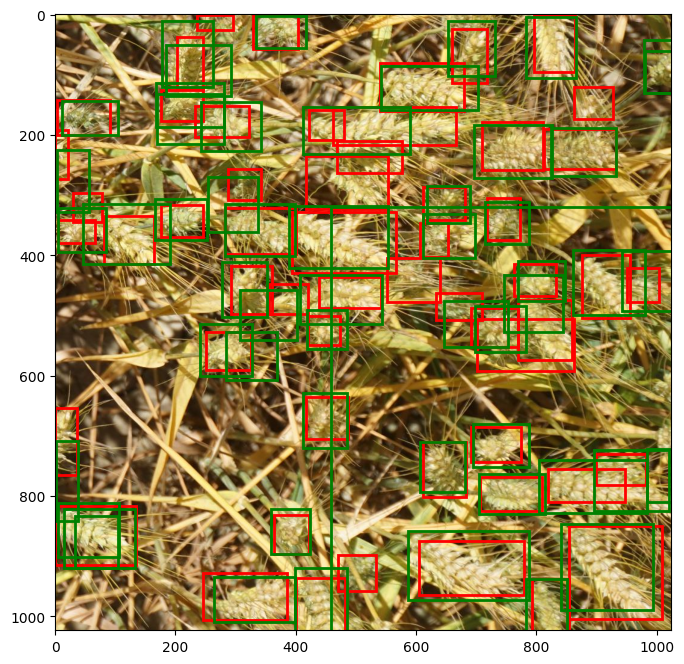

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import cv2
from torchvision.ops import nms  # NMS function

def plot_image_with_boxes(image, gt_boxes, pred_boxes):
    # Plot the image with ground truth and predicted boxes
    fig, ax = plt.subplots(1, figsize=(8, 8))
    ax.imshow(image)

    # Ground truth boxes in red
    for box in gt_boxes:
        rect = patches.Rectangle(
            (box[0], box[1]), box[2], box[3],
            linewidth=2, edgecolor='red', facecolor='none'
        )
        ax.add_patch(rect)

    # Predicted boxes in green
    for box in pred_boxes:
        rect = patches.Rectangle(
            (box[0], box[1]), box[2], box[3],
            linewidth=2, edgecolor='green', facecolor='none'
        )
        ax.add_patch(rect)

    #plt.figure(figsize=(2, 2))
    plt.show()

def apply_nms(pred_boxes, pred_scores, iou_threshold=0.5):
    """
    Apply Non-Maximum Suppression (NMS) to reduce overlapping boxes.

    Args:
        pred_boxes (torch.Tensor): Predicted bounding boxes [N, 4].
        pred_scores (torch.Tensor): Scores for each box [N].
        iou_threshold (float): Intersection over Union (IoU) threshold.

    Returns:
        torch.Tensor: Indices of boxes to keep after NMS.
    """
    keep_indices = nms(pred_boxes, pred_scores, iou_threshold)
    return keep_indices

# Load the trained model
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = DETRModel(num_classes=num_classes, num_queries=num_queries)
model.load_state_dict(torch.load('detr_best_0.pth'))
model = model.to(device)
model.eval()

# Pick an image from the training dataset
sample_image_id = df_folds.index[0]  # Replace 0 with any other index to pick a different image
image_path = f'{DIR_TRAIN}/{sample_image_id}.jpg'
#image_path = '/content/wheat2.jpg'
image = cv2.imread(image_path, cv2.IMREAD_COLOR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32) / 255.0

# Get ground truth bounding boxes
# Simulated ground truth (replace with actual dataset)
record = marking[marking['image_id'] == '00333207f']  # Replace with the correct ID
gt_boxes = record[['x', 'y', 'w', 'h']].values  # Ground truth boxes

# Transform image for model input
transformed_image = torch.tensor(image).permute(2, 0, 1).unsqueeze(0).to(device)  # (1, C, H, W)

# Predict bounding boxes
with torch.no_grad():
    outputs = model(transformed_image)

# Extract bounding boxes from predictions
pred_logits = outputs['pred_logits'][0]  # Shape: (num_queries, num_classes)
pred_boxes = outputs['pred_boxes'][0]  # Shape: (num_queries, 4)
probs = pred_logits.softmax(-1)
scores, labels = probs.max(-1)  # Get max probability and class labels

# Apply confidence threshold
prob_threshold = 0.95
keep = scores > prob_threshold  # Filter by confidence threshold
pred_boxes = pred_boxes[keep]  # Keep high-confidence boxes
pred_scores = scores[keep]  # Keep corresponding scores

# Apply NMS
keep_indices = apply_nms(pred_boxes, pred_scores, iou_threshold=0.2)
pred_boxes = pred_boxes[keep_indices]  # Filter boxes after NMS
pred_scores = pred_scores[keep_indices]

# Convert normalized boxes to absolute coordinates
h, w = image.shape[:2]
#pred_boxes = pred_boxes * torch.tensor([w, h, w, h]).to(device)  # Scale to image size
pred_boxes = pred_boxes.cpu().numpy() * [w, h, w, h]  # Scale to image size

gt_boxes = gt_boxes  # No scaling needed if ground truth is in absolute coordinates

# Plot and compare ground truth and predicted boxes
plot_image_with_boxes(image, gt_boxes, pred_boxes)


In [ ]:
import numpy as np
import os
import torch
import cv2
import matplotlib.pyplot as plt
from PIL import Image

def load_test_image(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_COLOR)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32)
    image /= 255.0
    return image

def predict_on_test_images(model, device, test_dir, confidence_threshold=0.5):
    model.eval()
    model.to(device)
    cpu_device = torch.device("cpu")

    for img_file in os.listdir(test_dir):
        img_path = os.path.join(test_dir, img_file)
        image = load_test_image(img_path)
        h, w, _ = image.shape
        image_tensor = torch.tensor(image).permute(2, 0, 1).unsqueeze(0).to(device)

        with torch.no_grad():
            outputs = model(image_tensor)

        pred_boxes = outputs['pred_boxes'][0].cpu().numpy()
       # print("pred_boxes 1 : ",pred_boxes)
        # Convert from center format [cx, cy, width, height] to corner format [x_min, y_min, x_max, y_max]
        cx, cy, bw, bh = pred_boxes[:, 0], pred_boxes[:, 1], pred_boxes[:, 2], pred_boxes[:, 3]
        x_min = (cx - bw / 2) * w
        y_min = (cy - bh / 2) * h
        x_max = (cx + bw / 2) * w
        y_max = (cy + bh / 2) * h
        pred_boxes = np.stack([x_min+50, y_min+50, x_max+100, y_max+100], axis=-1)
        #print("pred_boxes 2 : ",pred_boxes)

        pred_logits = outputs['pred_logits'][0].softmax(-1).cpu().numpy()

        filtered_boxes = []
        filtered_scores = []
        for box, scores in zip(pred_boxes, pred_logits):
            score = scores[0]
            if score > confidence_threshold:
                x_min, y_min, x_max, y_max = box.astype(int)
                if 0 <= x_min < x_max <= w and 0 <= y_min < y_max <= h:
                    filtered_boxes.append([x_min, y_min, x_max, y_max])
                    filtered_scores.append(score)
                #else:
                   # print(f"Skipping box with invalid dimensions or out of bounds: {box}")

        sample_image = (image * 255).astype(np.uint8)
        for box in filtered_boxes:
            x_min, y_min, x_max, y_max = box
            cv2.rectangle(sample_image, (x_min, y_min), (x_max, y_max), (0, 0, 220), 2)

        plt.figure(figsize=(12, 8))
        plt.imshow(sample_image)
        plt.axis('off')
        plt.show()


Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
<ipython-input-28-bd4594d9a37c>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com

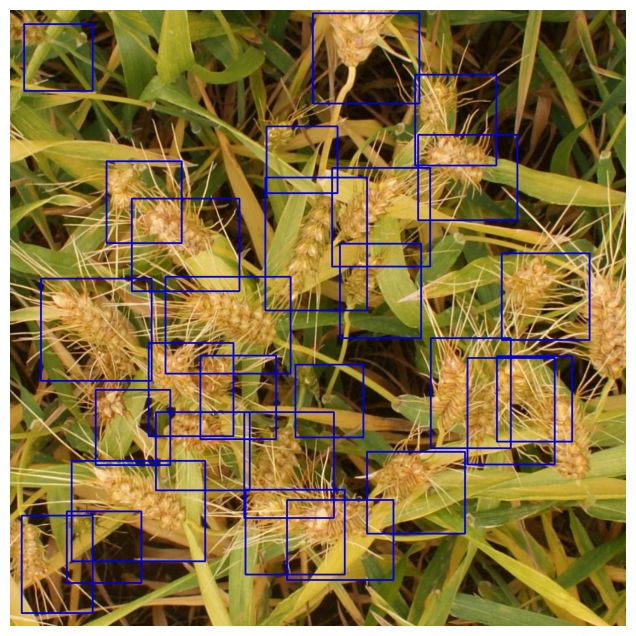

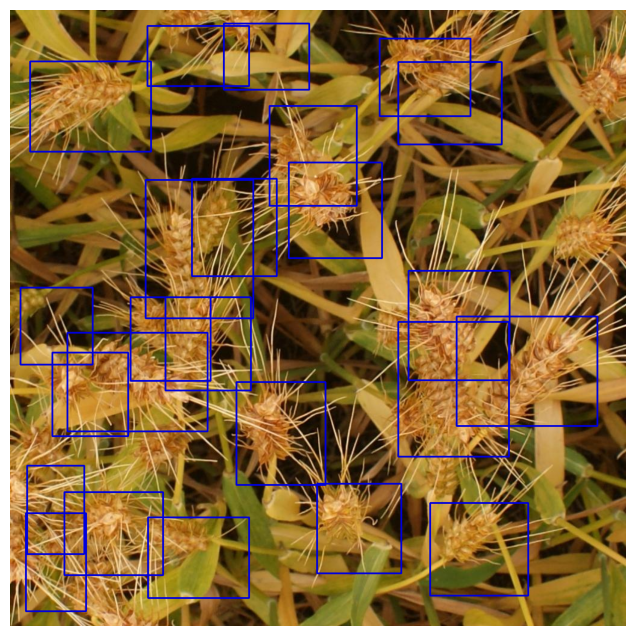

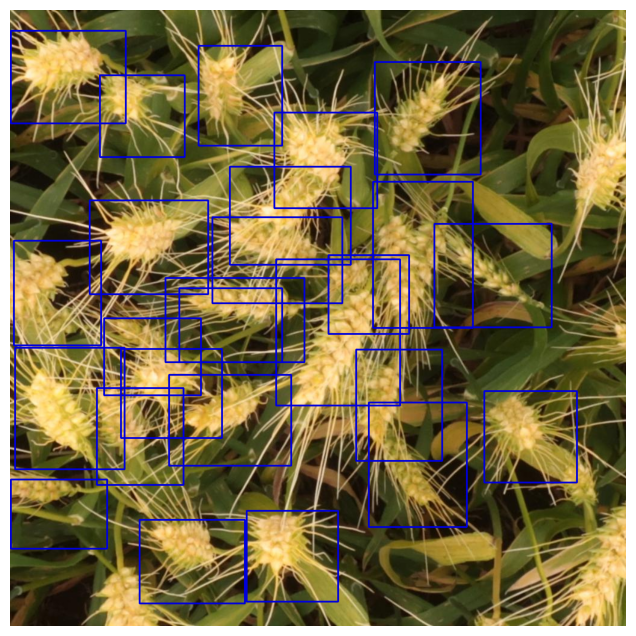

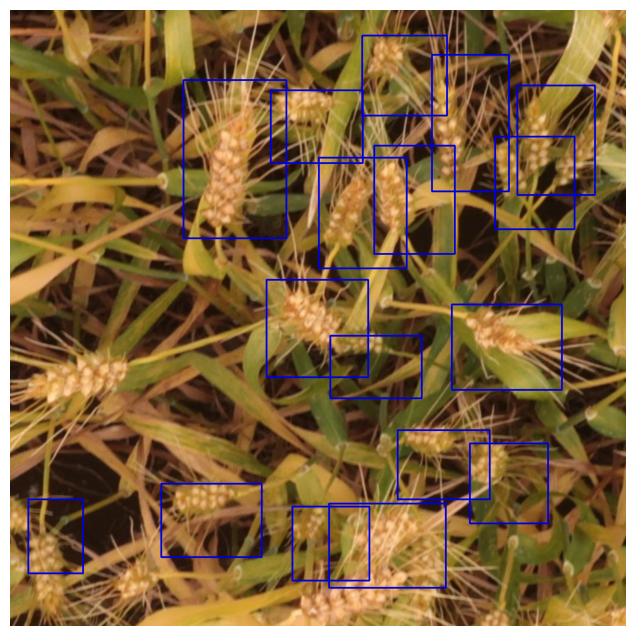

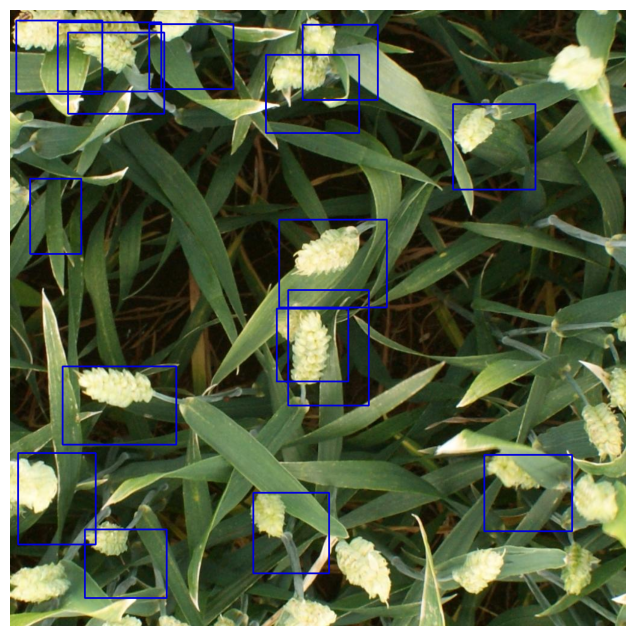

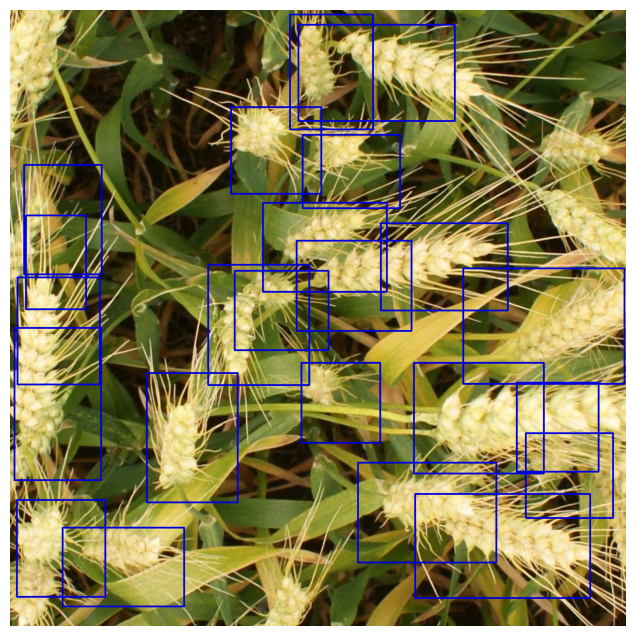

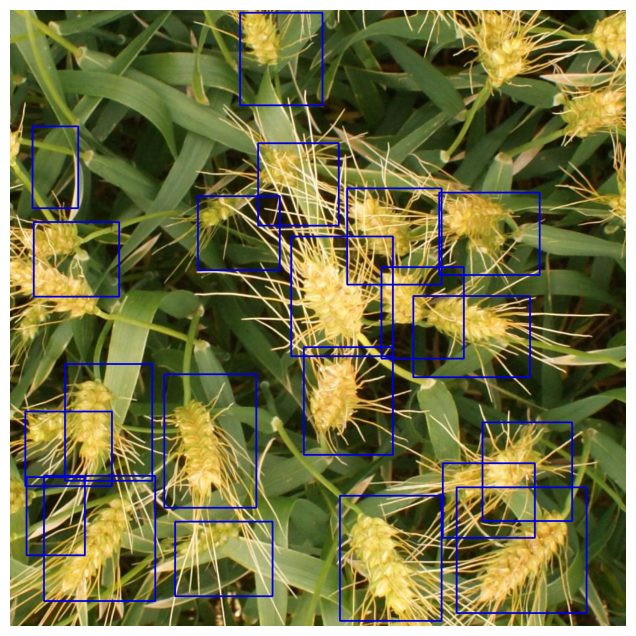

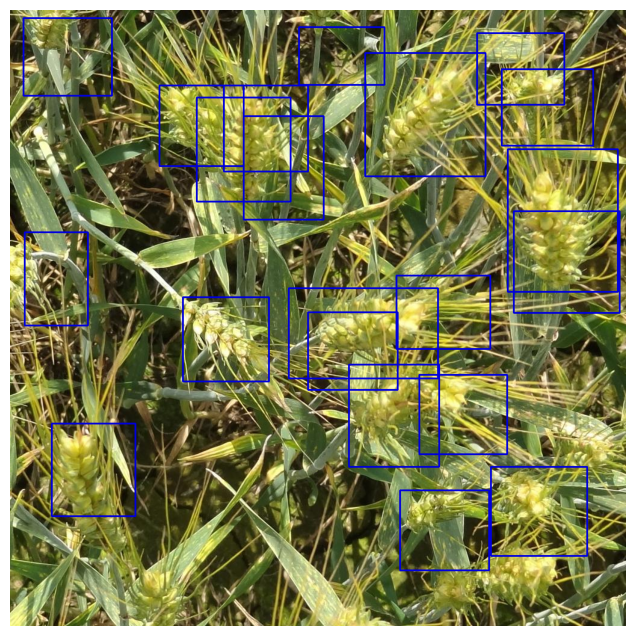

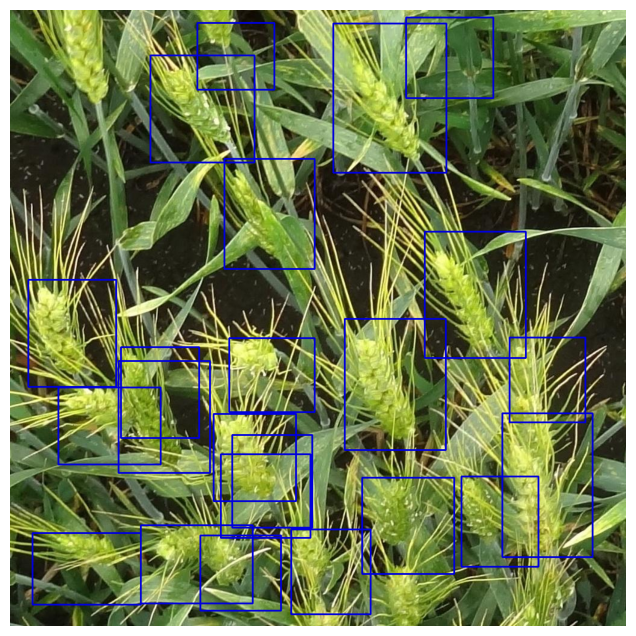

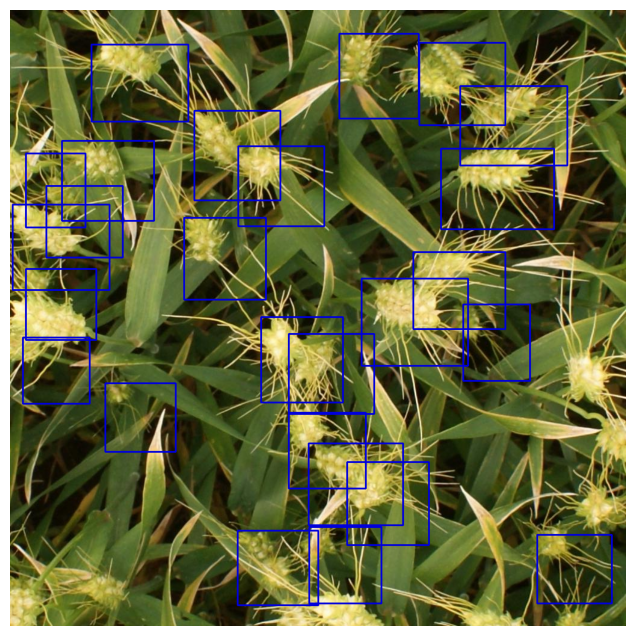

In [ ]:
# Load the model and weights
model = DETRModel(num_classes=num_classes, num_queries=num_queries)
model.load_state_dict(torch.load("./detr_best_0.pth"))
predict_on_test_images(model, device=torch.device('cuda'), test_dir='/content/test')


In [ ]:
import shutil
shutil.copy("/content/detr_best_0.pth", "/content/drive/My Drive/Models/detr_best_0.pth")
shutil.copy("/content/detr_best_1.pth", "/content/drive/My Drive/Models/detr_best_1.pth")

shutil.copy("/content/detr_best_2.pth", "/content/drive/My Drive/Models/detr_best_2.pth")

shutil.copy("/content/detr_best_3.pth", "/content/drive/My Drive/Models/detr_best_3.pth")

shutil.copy("/content/detr_best_4.pth", "/content/drive/My Drive/Models/detr_best_4.pth")




'/content/drive/My Drive/Models/detr_best_4.pth'

#YOLOv5

In [ ]:
!git clone https://github.com/ultralytics/yolov5.git
%cd yolov5
!pip install -r requirements.txt


Cloning into 'yolov5'...
remote: Enumerating objects: 17045, done.
remote: Counting objects: 100% (23/23), done.
remote: Compressing objects: 100% (15/15), done.
remote: Total 17045 (delta 10), reused 18 (delta 8), pack-reused 17022 (from 1)
Receiving objects: 100% (17045/17045), 15.67 MiB | 16.41 MiB/s, done.
Resolving deltas: 100% (11704/11704), done.
/content/yolov5
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.0/887.0 kB 46.6 MB/s eta 0:00:00


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
import shutil
import os

# Load the annotations CSV
df = pd.read_csv("/content/train.csv")

print(len(df))

# Define train-val split
train_df, val_df = train_test_split(df, test_size=0.2, random_state=42)

# Create directories for split dataset
os.makedirs("datasets/images/train", exist_ok=True)
os.makedirs("datasets/images/val", exist_ok=True)
os.makedirs("datasets/labels/train", exist_ok=True)
os.makedirs("datasets/labels/val", exist_ok=True)

# Function to copy images and save labels in YOLO format
def save_dataset(data, image_dir, label_dir):
    for _, row in data.iterrows():
        image_path = f"/content/train/{row['image_id']}.jpg"  # Corrected path

        # Check if the image exists
        if not os.path.exists(image_path):
            print(f"Warning: Image {image_path} not found. Skipping...")
            continue

        # Copy image
        shutil.copy(image_path, image_dir)

        # Extract bounding box values
        x_min, y_min, width, height = eval(row['bbox'])  # Convert string to list

        # Compute YOLO format values
        x_center = x_min + (width / 2)
        y_center = y_min + (height / 2)
        width = width
        height = height

        # Normalize values
        x_center /= row['width']  # Use the 'width' column
        y_center /= row['height']  # Use the 'height' column
        width /= row['width']
        height /= row['height']

        # Save to .txt file
        label_path = os.path.join(label_dir, f"{row['image_id'].split('.')[0]}.txt")
        with open(label_path, "a") as f:
            f.write(f"0 {x_center} {y_center} {width} {height}\n")  # Class ID is 0 for wheat spike

# Save train and validation datasets
print(len(train_df))
print(len(val_df))



save_dataset(df, "datasets/images/train", "datasets/labels/train")
save_dataset(df, "datasets/images/val", "datasets/labels/val")


147793
118234
29559


In [ ]:
import torch
print(f"GPU available: {torch.cuda.is_available()}")
print(f"Device name: {torch.cuda.get_device_name(0)}")

GPU available: True
Device name: NVIDIA A100-SXM4-40GB


In [ ]:



!python train.py --img 640 --batch 16 --epochs 10 --data wheat_spike.yaml --weights yolov5s.pt


wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
2024-11-17 19:04:53.100744: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-17 19:04:53.121888: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-17 19:04:53.128346: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: mannepallivishwajeet (mannepallivishwajeet-university-of-memph

In [ ]:
!python val.py --weights runs/train/exp/weights/best.pt --data wheat_spike.yaml


val: data=/content/yolov5/data/wheat_spike.yaml, weights=['runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-383-g1435a8ee Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning /content/yolov5/datasets/labels/val.cache... 3373 images, 0 backgrounds, 0 corrupt: 100% 3373/3373 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 106/106 [00:57<00:00,  1.84it/s]
                   all       3373     147793      0.929      0.893      0.947      0.542
Speed: 0.1ms pre-process, 2.0ms inference, 3.4ms NMS per image at shape (32, 3, 64

In [ ]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.25 --source /content/test/


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/test/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-383-g1435a8ee Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/10 /content/test/2fd875eaa.jpg: 640x640 29 wheat_spikes, 6.4ms
image 2/10 /content/test/348a992bb.jpg: 640x640 37 wheat_spikes, 7.0ms
image 3/10 /content/test/51b3e36ab.jpg: 640x640 27 wheat_spikes, 6.6ms
image 4/10 /content/test/51f1be19e.jpg: 640x640 19 

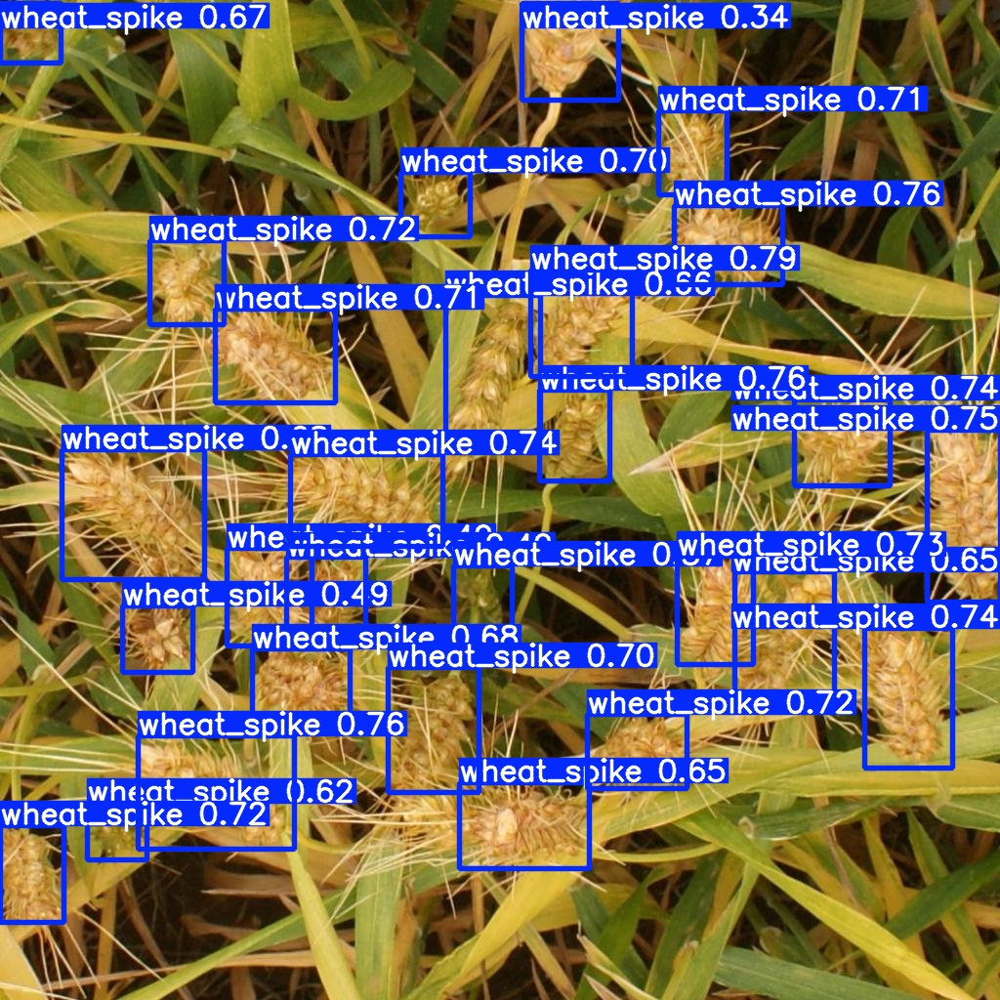

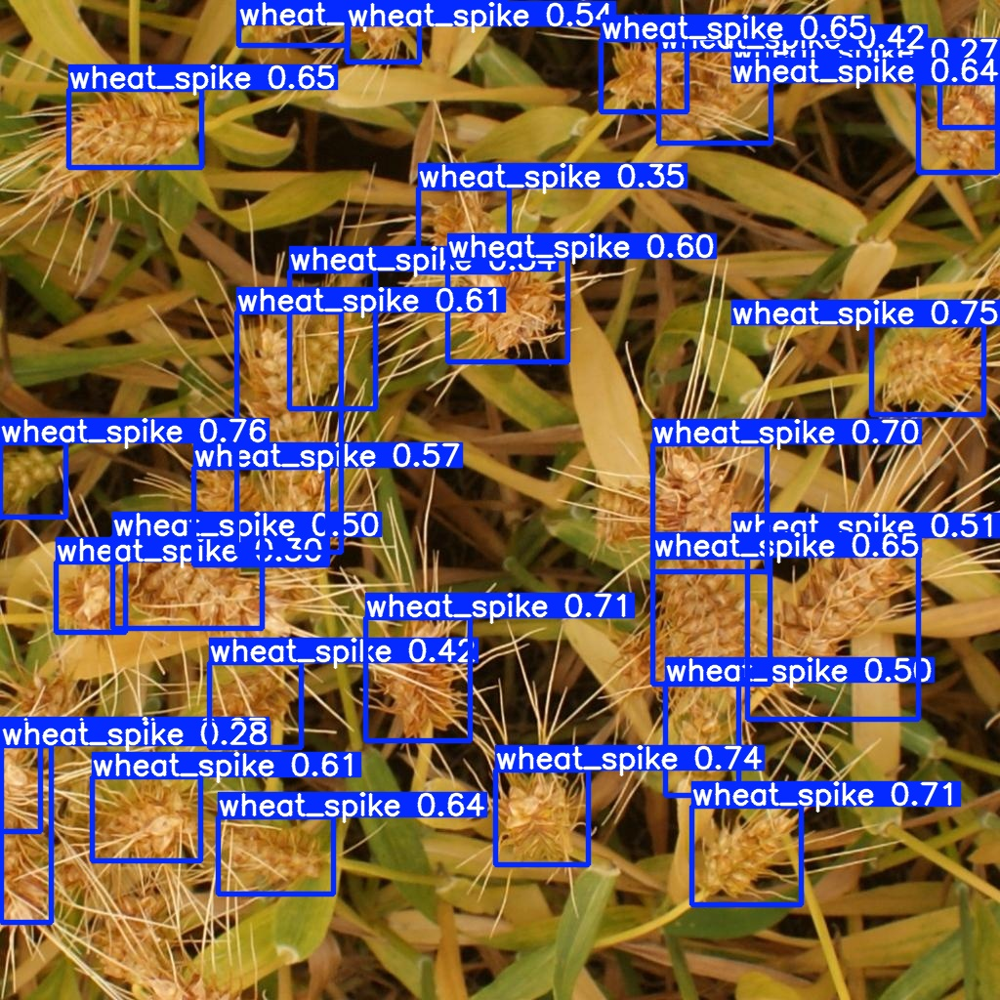

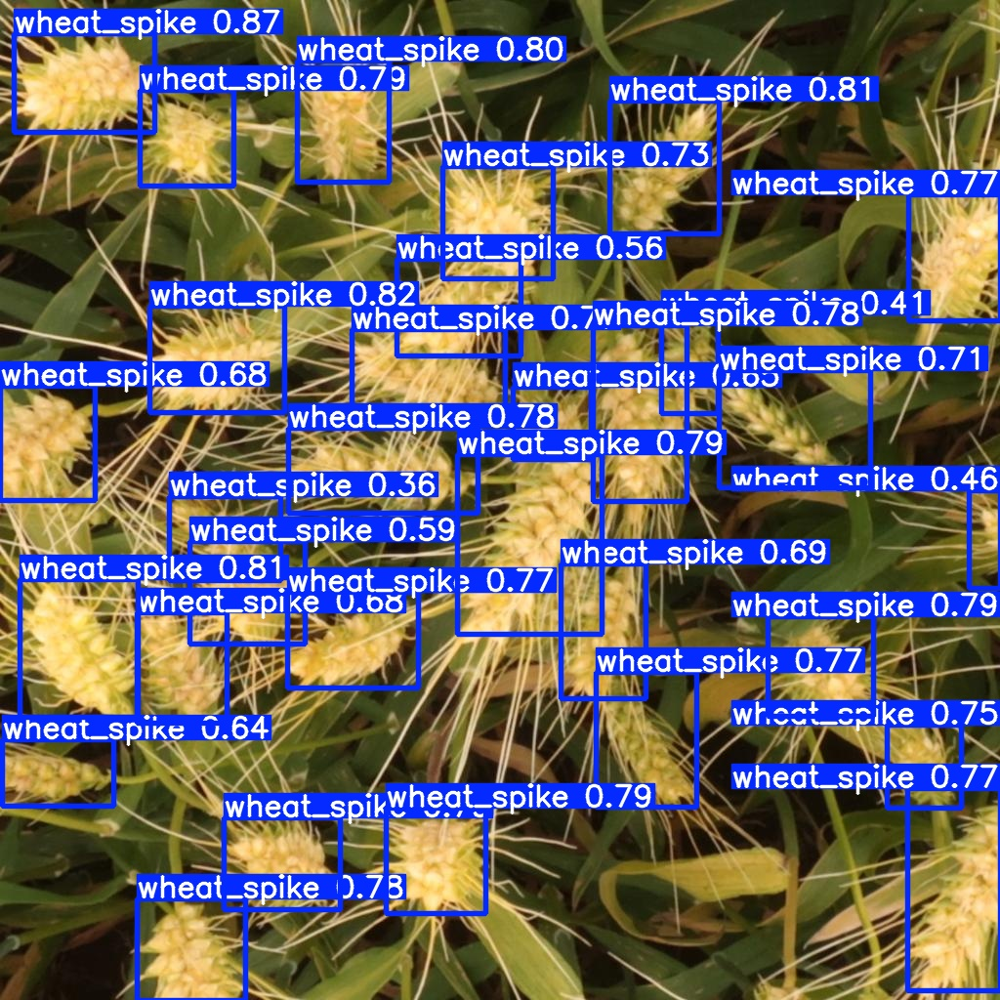

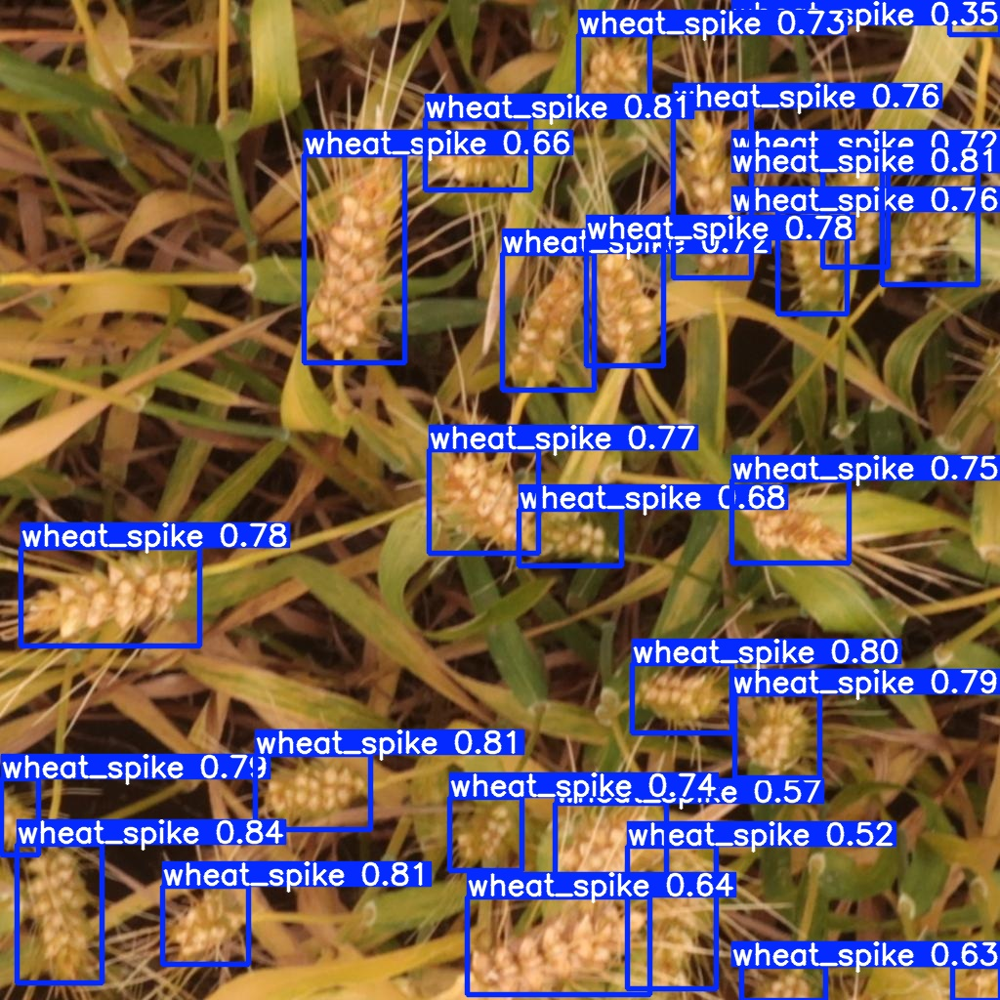

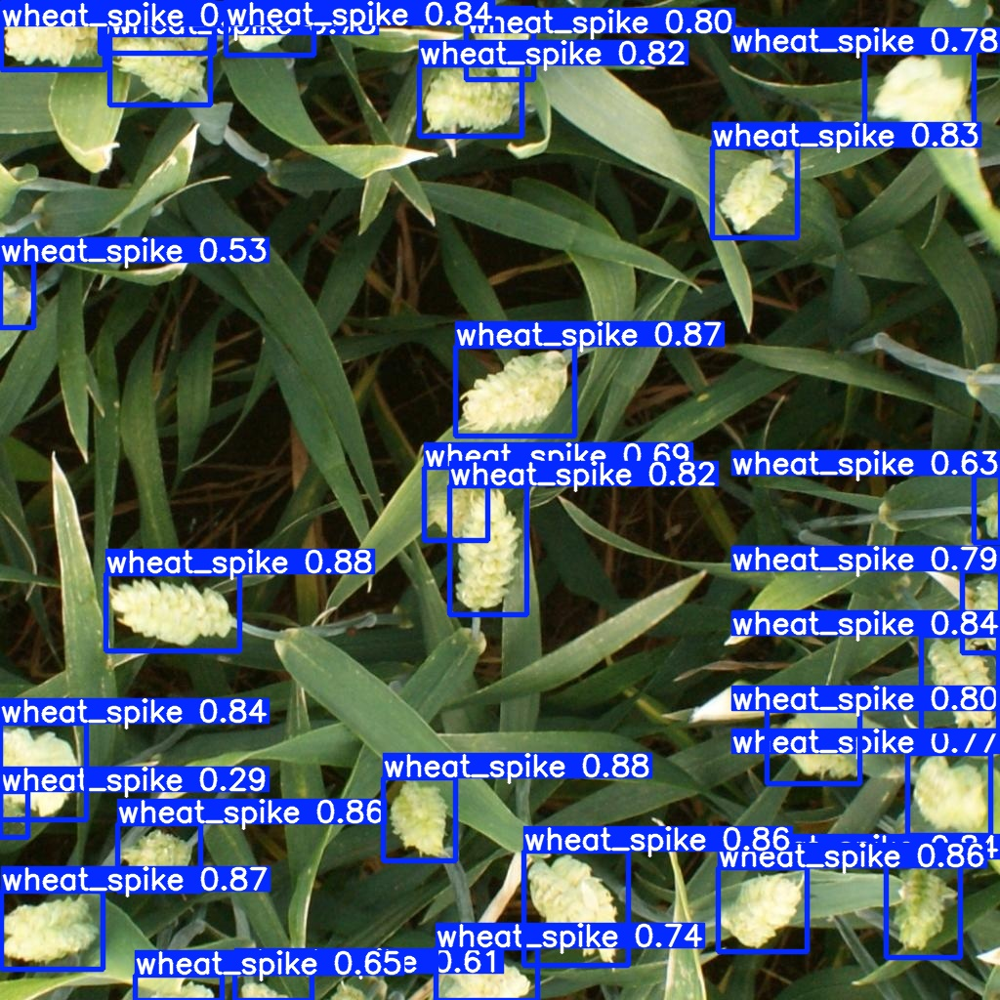

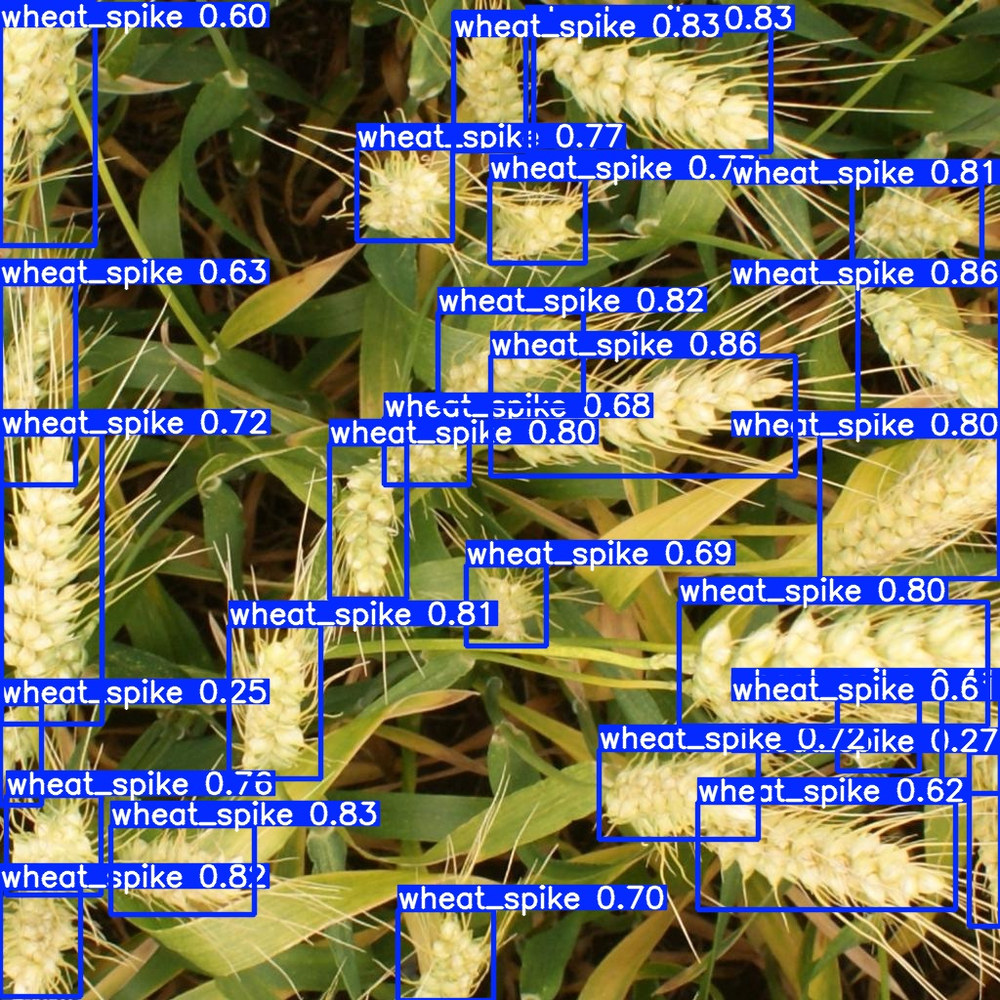

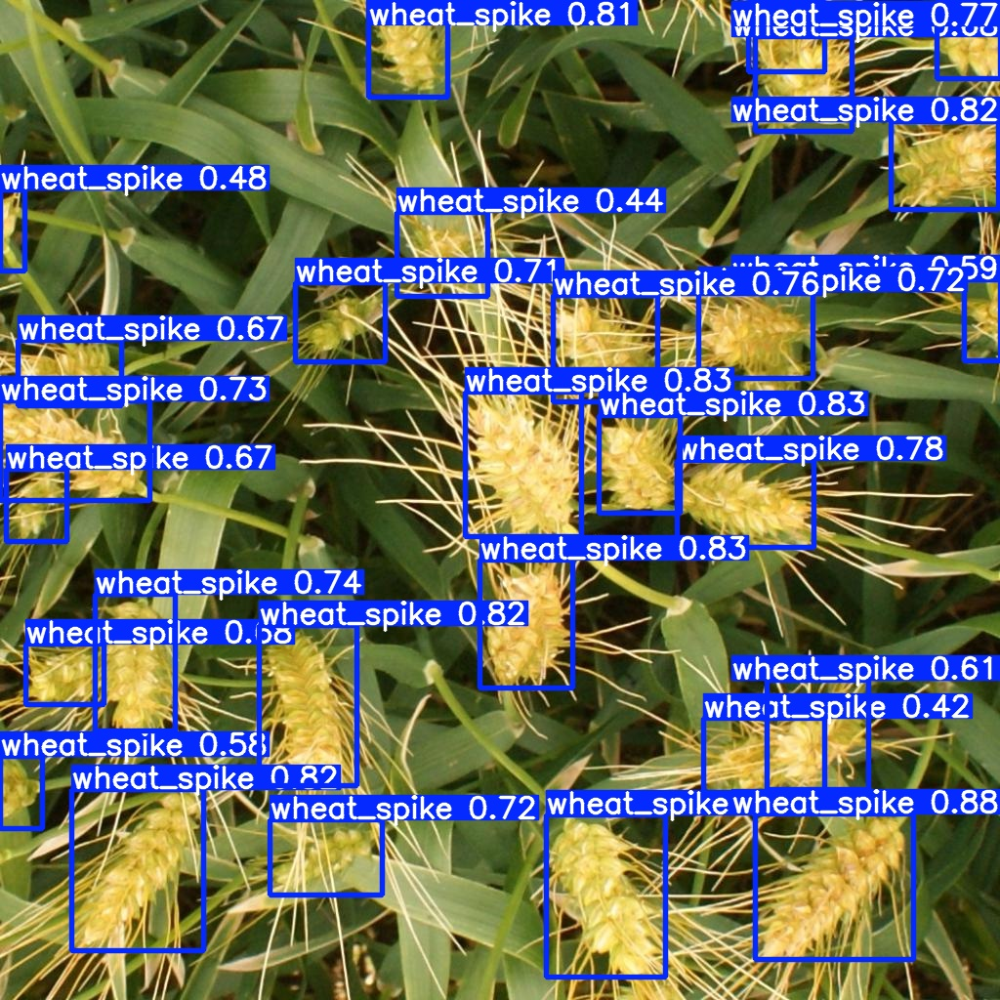

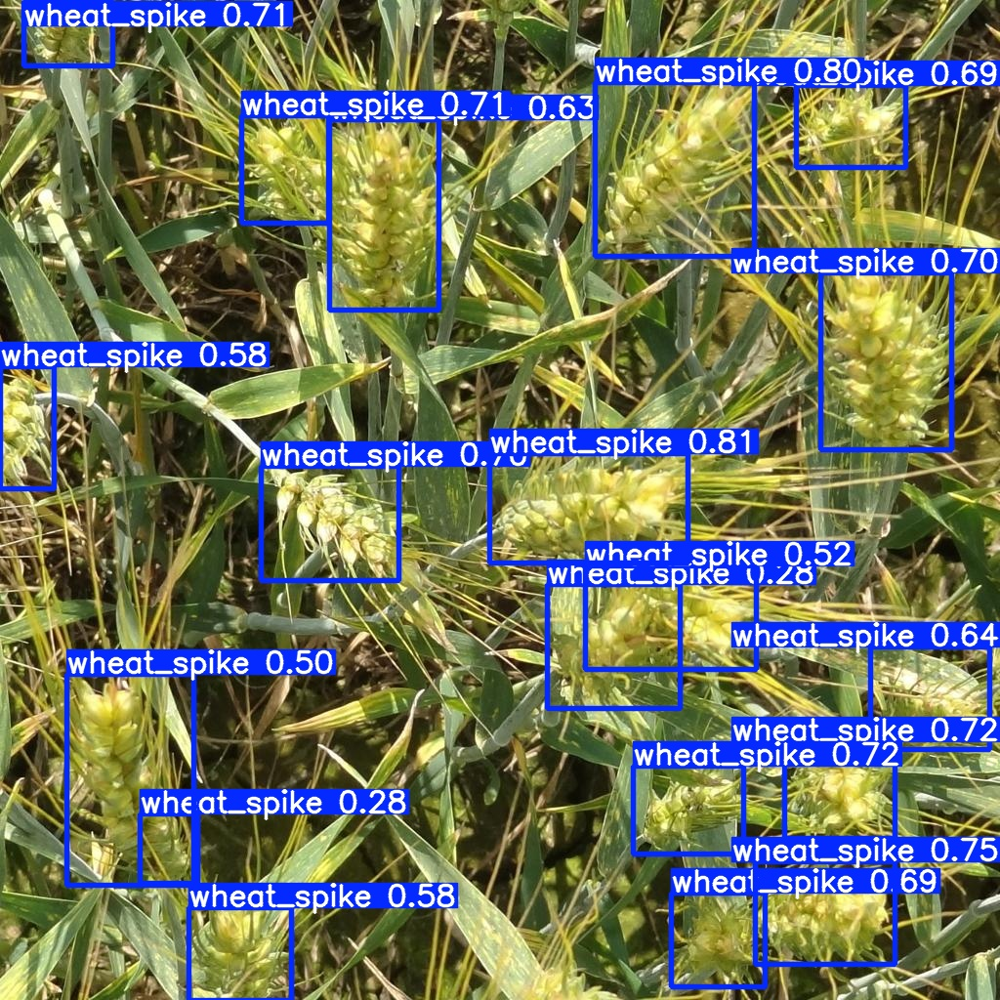

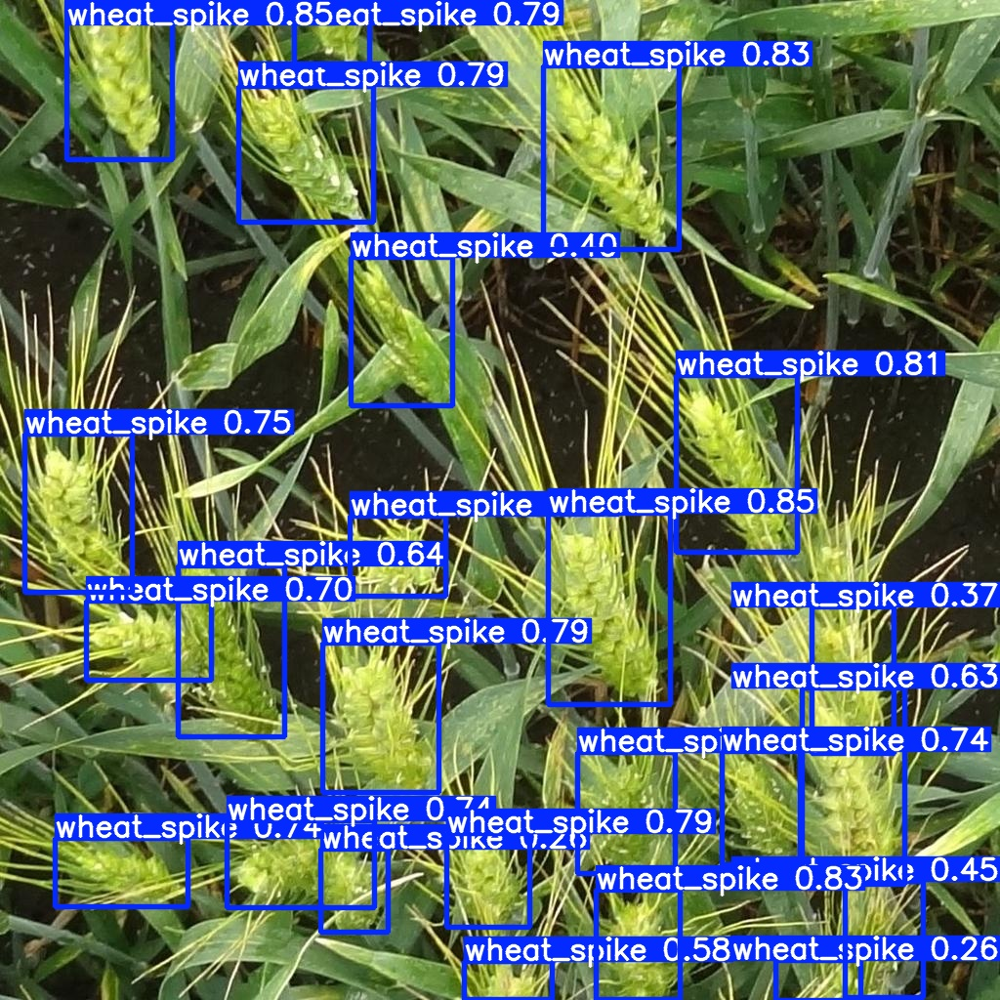

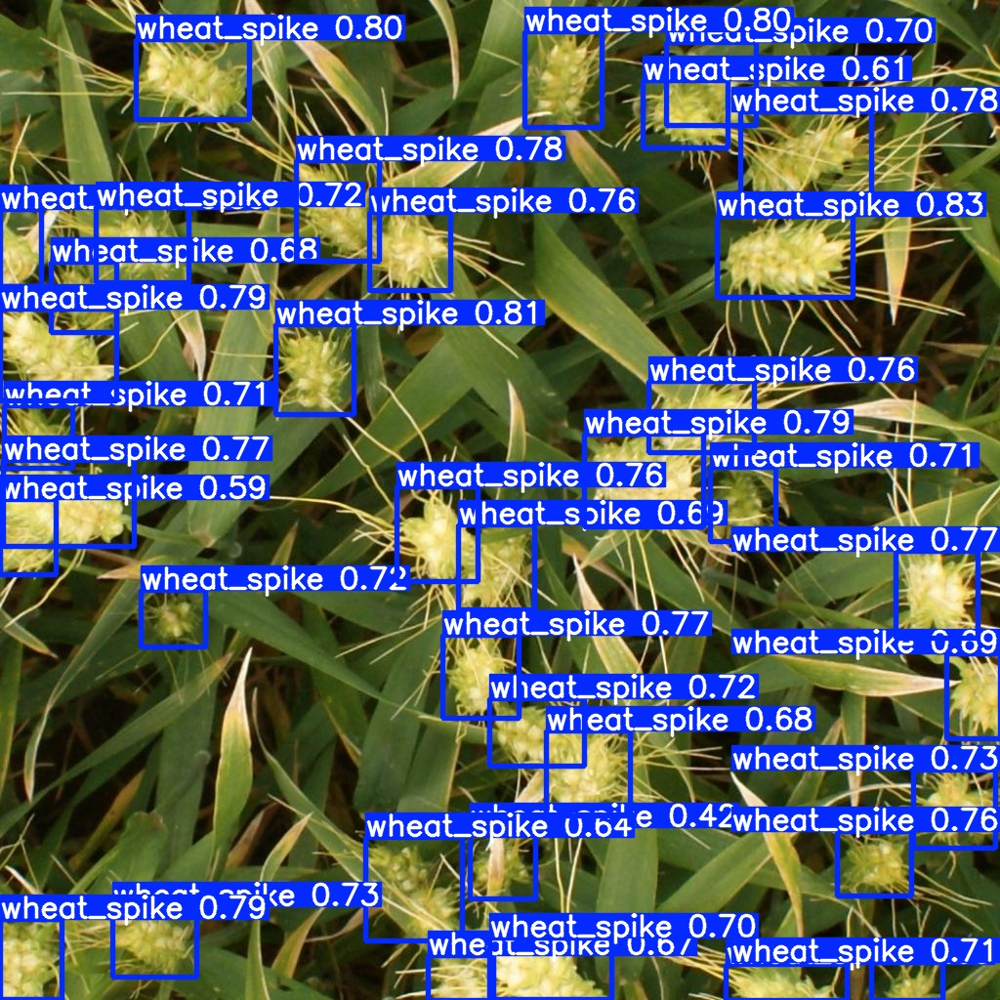

In [ ]:
import os
from IPython.display import Image, display

# Path to the directory containing YOLOv5 results
results_dir = 'runs/detect/exp/'  # Adjust this if results are saved in a different directory

# List all images in the results directory
result_images = [os.path.join(results_dir, img) for img in os.listdir(results_dir) if img.endswith(('.png', '.jpg', '.jpeg'))]

# Display each image
for img_path in result_images:
    display(Image(filename=img_path))


In [ ]:
!cp runs/train/exp/weights/best.pt /content/drive/MyDrive/Models/YOLOv5/
!cp -r runs/detect/exp/* /content/drive/MyDrive/Models/YOLOv5/test/


#MobileNetV2 based SSD

In [ ]:
!pip install tensorflow


In [ ]:
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow.keras.utils import Sequence
from sklearn.model_selection import train_test_split
import cv2
import os

# Load dataset
df = pd.read_csv('/content/train.csv')  # Path to your bounding box CSV

# Split dataset into train and validation sets
train_df, val_df = train_test_split(df, test_size=0.2, random_state=42)

# Dataset generator
class WheatSpikeDataset(Sequence):
    def __init__(self, dataframe, img_dir, batch_size=16, target_size=(224, 224)):
        self.dataframe = dataframe
        self.img_dir = img_dir
        self.batch_size = batch_size
        self.target_size = target_size

    def __len__(self):
        return int(np.ceil(len(self.dataframe) / self.batch_size))

    def __getitem__(self, idx):
        batch = self.dataframe.iloc[idx * self.batch_size:(idx + 1) * self.batch_size]
        images = []
        bboxes = []
        for _, row in batch.iterrows():
            # Load image
            img_path = os.path.join(self.img_dir, f"{row['image_id']}.jpg")
            if not os.path.exists(img_path):
              print(f"Warning: Image {img_path} not found. Skipping...")
              continue

            img = cv2.imread(img_path)
            img = cv2.resize(img, self.target_size)
            img = img / 255.0  # Normalize to [0, 1]
            images.append(img)

            # Bounding box
           # x_min, y_min, width, height = row['x_min'], row['y_min'], row['width'], row['height']
              # Extract bounding box values
            x_min, y_min, width, height = eval(row['bbox'])  # Convert string to list

            x_center = x_min + (width / 2)
            y_center = y_min + (height / 2)

            # Normalize values
            x_center /= row['width']  # Use the 'width' column
            y_center /= row['height']  # Use the 'height' column
            width /= row['width']
            height /= row['height']
            bboxes.append([x_center, y_center, width, height])

        return np.array(images), np.array(bboxes)

# Create dataset generators
train_gen = WheatSpikeDataset(train_df, '/content/train/')
val_gen = WheatSpikeDataset(val_df, '/content/train/')



In [ ]:
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D

# Load MobileNetV2 backbone
base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add custom detection head
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(128, activation='relu')(x)
x = Dense(4, activation='sigmoid')(x)  # Output: (x_center, y_center, width, height)

# Create final model
model = Model(inputs=base_model.input, outputs=x)

# Compile the model
model.compile(optimizer='adam', loss='mse', metrics=['mae'])  # MSE for bounding box regression


In [ ]:
# Train the model
history = model.fit(
    train_gen,
    validation_data=val_gen,
    epochs=10,
    batch_size=8
)


Epoch 1/10


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


7390/7390 ━━━━━━━━━━━━━━━━━━━━ 1167s 153ms/step - loss: 0.0449 - mae: 0.1432 - val_loss: 0.0443 - val_mae: 0.1453
Epoch 2/10
7390/7390 ━━━━━━━━━━━━━━━━━━━━ 1091s 148ms/step - loss: 0.0438 - mae: 0.1398 - val_loss: 0.0438 - val_mae: 0.1409
Epoch 3/10
7390/7390 ━━━━━━━━━━━━━━━━━━━━ 1118s 151ms/step - loss: 0.0437 - mae: 0.1393 - val_loss: 0.0441 - val_mae: 0.1430
Epoch 4/10
7390/7390 ━━━━━━━━━━━━━━━━━━━━ 1098s 148ms/step - loss: 0.0436 - mae: 0.1392 - val_loss: 0.0438 - val_mae: 0.1408
Epoch 5/10
7390/7390 ━━━━━━━━━━━━━━━━━━━━ 1115s 151ms/step - loss: 0.0437 - mae: 0.1394 - val_loss: 0.0454 - val_mae: 0.1416
Epoch 6/10
7390/7390 ━━━━━━━━━━━━━━━━━━━━ 1103s 149ms/step - loss: 0.0434 - mae: 0.1389 - val_loss: 0.0442 - val_mae: 0.1393
Epoch 7/10
7390/7390 ━━━━━━━━━━━━━━━━━━━━ 1139s 154ms/step - loss: 0.0433 - mae: 0.1389 - val_loss: 0.0435 - val_mae: 0.1391
Epoch 8/10
7390/7390 ━━━━━━━━━━━━━━━━━━━━ 1109s 150ms/step - loss: 0.0431 - mae: 0.1385 - val_loss: 0.0440 - val_mae: 0.1400
Epoch 9/10


In [ ]:
val_loss, val_mae = model.evaluate(val_gen)
print(f"Validation Loss: {val_loss}, Validation MAE: {val_mae}")


1848/1848 ━━━━━━━━━━━━━━━━━━━━ 214s 116ms/step - loss: 0.0430 - mae: 0.1374
Validation Loss: 0.043094344437122345, Validation MAE: 0.1377650648355484


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


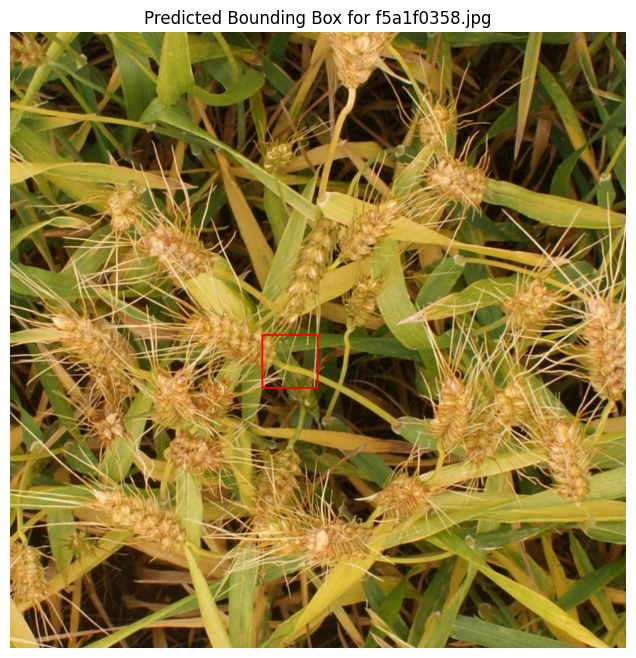

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


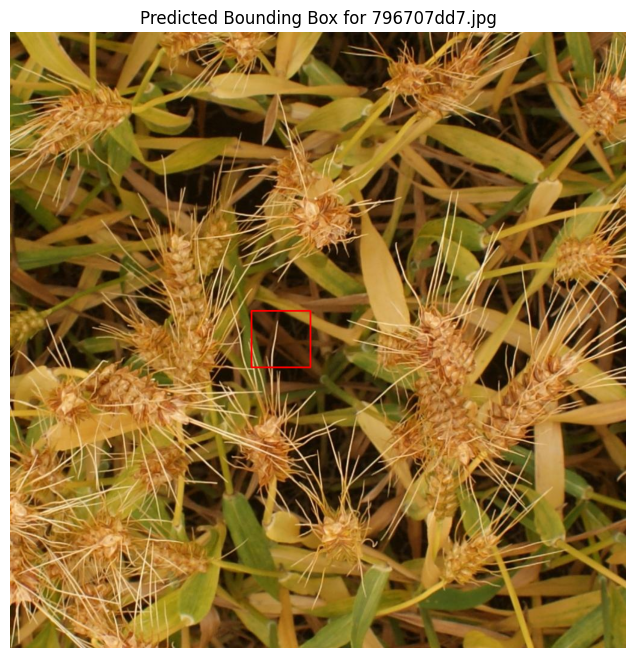

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


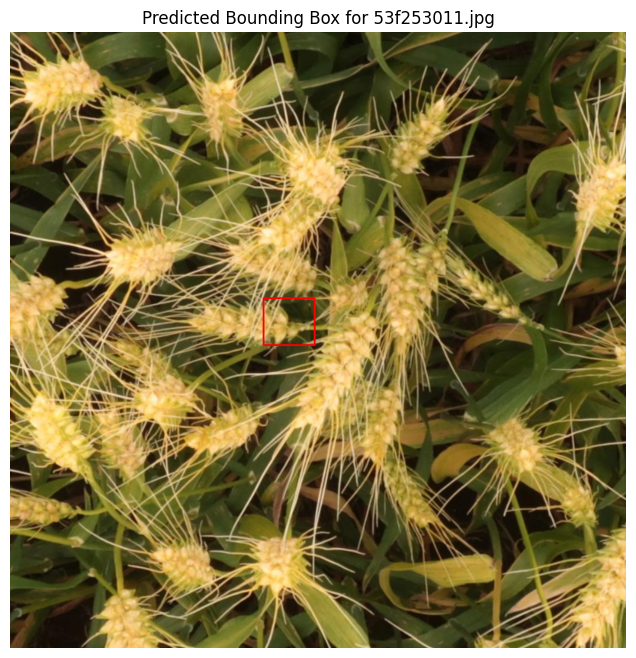

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


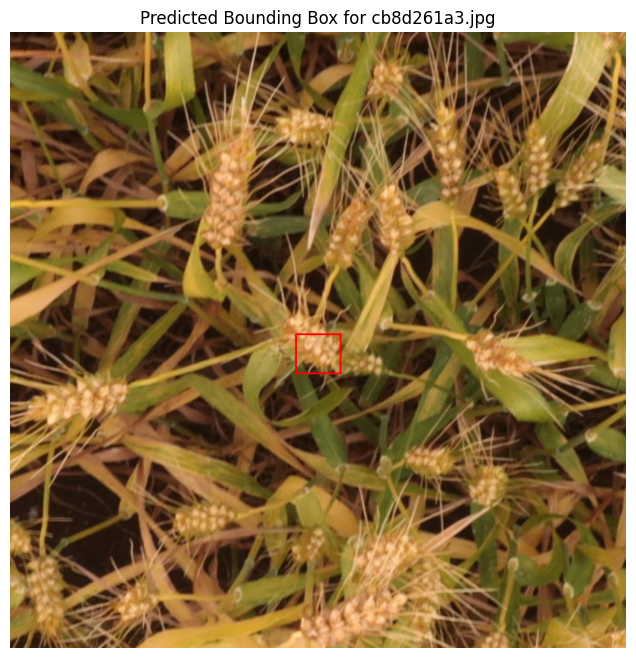

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


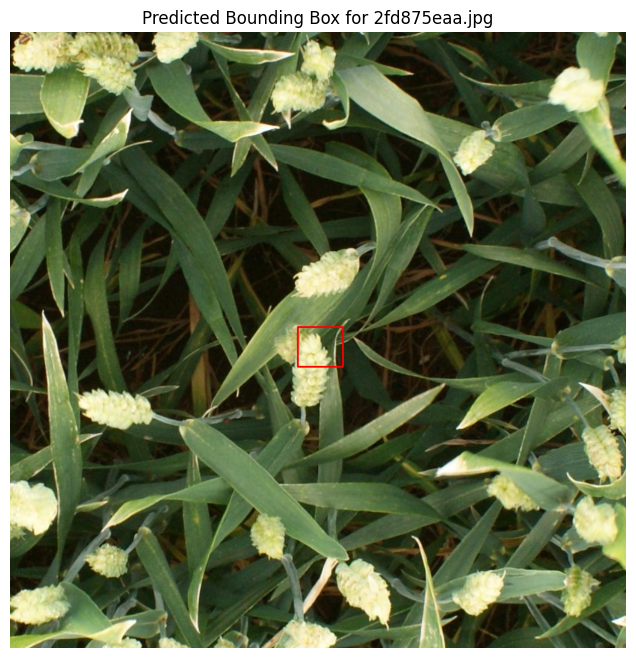

In [ ]:
import matplotlib.pyplot as plt
import cv2
import numpy as np
import os

def visualize_test_predictions(model, test_dir, target_size=(224, 224), num_images=5):
    """
    Visualizes predictions on test images without ground truth bounding boxes.

    Args:
        model: Trained MobileNetV2 model.
        test_dir: Directory containing test images.
        target_size: Tuple specifying input size of the model (default: (224, 224)).
        num_images: Number of test images to visualize.
    """
    test_images = [f for f in os.listdir(test_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    for i, img_name in enumerate(test_images[:num_images]):
        # Load and preprocess the image
        img_path = os.path.join(test_dir, img_name)
        img = cv2.imread(img_path)
        original_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for visualization
        resized_img = cv2.resize(original_img, target_size) / 255.0  # Resize and normalize

        # Predict bounding box
        pred_bbox = model.predict(np.expand_dims(resized_img, axis=0))[0]

        # Denormalize bounding box
        x_center = pred_bbox[0] * original_img.shape[1]
        y_center = pred_bbox[1] * original_img.shape[0]
        width = pred_bbox[2] * original_img.shape[1]
        height = pred_bbox[3] * original_img.shape[0]

        x_min = int(x_center - width / 2)
        y_min = int(y_center - height / 2)
        x_max = int(x_center + width / 2)
        y_max = int(y_center + height / 2)

        # Draw bounding box on the original image
        cv2.rectangle(original_img, (x_min, y_min), (x_max, y_max), (255, 0, 0), 2)  # Blue box for prediction

        # Display the image
        plt.figure(figsize=(8, 8))
        plt.imshow(original_img)
        plt.axis('off')
        plt.title(f"Predicted Bounding Box for {img_name}")
        plt.show()

# Visualize predictions
visualize_test_predictions(model, '/content/test/', target_size=(224, 224), num_images=5)


In [ ]:
!pip install tensorflow tensorflow-hub tensorflow-addons


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.8/611.8 kB 7.4 MB/s eta 0:00:00
  Attempting uninstall: typeguard
    Found existing installation: typeguard 4.4.1
    Uninstalling typeguard-4.4.1:
      Successfully uninstalled typeguard-4.4.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
inflect 7.4.0 requires typeguard>=4.0.1, but you have typeguard 2.13.3 which is incompatible.


#Faster R-CNN with ResNet-50 in PyTorc

In [ ]:
!pip install torch torchvision


In [ ]:
import torch
from torchvision.models.detection import fasterrcnn_resnet50_fpn
import os
import torch
import pandas as pd
from torchvision.transforms import functional as F
from PIL import Image
from tqdm import tqdm


# Load the pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()  # Set to evaluation mode
print("Faster R-CNN model loaded!")



# Preprocess the dataset
csv_file = "/content/train.csv"  # Path to annotations CSV
image_dir = "/content/train/"  # Path to images
save_dir = "/content/drive/MyDrive/Models/Faster RCNN_ResNET/preprocessedData/"  # Directory for preprocessed data


RCNN_df = pd.read_csv(csv_file)
image_ids = RCNN_df['image_id'].unique()

print(image_ids)



/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Faster R-CNN model loaded!
['b6ab77fd7' 'b53afdf5c' '7b72ea0fb' ... 'a5c8d5f5c' 'e6b5e296d'
 '5e0747034']


In [ ]:
import cv2
import numpy as np
import torch
from torch.utils.data import Dataset
import ast  # To parse the string representation of the bbox


DIR_TRAIN = '/content/train'

class WheatDataset(Dataset):
    def __init__(self, image_ids, dataframe):
        """
        Dataset for wheat detection.

        Args:
            image_ids (list): List of image IDs.
            dataframe (pd.DataFrame): DataFrame containing annotations.
            transforms (callable, optional): Augmentation/transformation pipeline.
        """
        self.image_ids = image_ids
        self.df = dataframe

    def __len__(self) -> int:
        return len(self.image_ids)

    def __getitem__(self, index):
        #print('Index :', index)
        image_id = self.image_ids[index]
        records = self.df[self.df['image_id'] == image_id]
        #print('Records: ',len(records))

        # Read and normalize the image
        image = cv2.imread(f'{DIR_TRAIN}/{image_id}.jpg', cv2.IMREAD_COLOR)
        if image is None:
            raise ValueError(f"Image {image_id} not found.")
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32)
        image /= 255.0

        # Get bounding boxes
        h, w, _ = image.shape

        # Initialize lists for bounding boxes
        boxes = []

        # Process each bounding box for the image
        for _, row in records.iterrows():
            # Parse the bbox (assumed to be a string like '(x, y, w, h)')
            bbox = ast.literal_eval(row['bbox'])
            #print(bbox)
            x_min, y_min, width, height = bbox
            x_max = x_min + width
            y_max = y_min + height

            # Normalize bounding box coordinates to [0, 1]
            x_min /= w
            y_min /= h
            x_max /= w
            y_max /= h

            boxes.append([x_min, y_min, x_max, y_max])

        #boxes = torch.tensor(boxes, dtype=torch.float32)

        # Compute area of bounding boxes
        #area = (boxes[:, 2] - boxes[:, 0]) * (boxes[:, 3] - boxes[:, 1])
        #area = torch.as_tensor(area, dtype=torch.float32)

        # Assign labels
        labels = np.ones(len(boxes), dtype=np.int64)  # Class ID = 1 for wheat spike

        # Convert to PyTorch tensors
        image = torch.tensor(image).permute(2, 0, 1)  # (H, W, C) -> (C, H, W)
        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)

        # Build target dictionary
        target = {
            'boxes': boxes,
            'labels': labels,
            #'area': area,
            'image_id': torch.tensor([index]),
        }


        return image, target


In [ ]:
from torch.utils.data import DataLoader # This line has been added to import DataLoader


# Step 3: Split Dataset and Create DataLoader

data_dir = "/content/drive/MyDrive/Models/Faster RCNN_ResNET/preprocessedData"
#data_dir = "/content/preprocessed"
#dataset = PreprocessedDataset(data_dir)
dataset = WheatDataset(image_ids=image_ids, dataframe=RCNN_df)


train_size = int(0.9 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = torch.utils.data.random_split(dataset, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=2, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
val_loader = DataLoader(val_dataset, batch_size=2, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

for image, target in train_loader:
  print("Target:", target)
  break
# Check dataset
for image, target in train_loader:
   # print("Image shape:", image[0].shape)
   # print("Target boxes:", target[0]['boxes'])
    #print("Target labels:", target[0]['labels'])
    break

for images, targets in train_loader:  # `__getitem__` will be called for the required indices
    print(f"Processed batch with {len(images)} images")



for image, target in train_loader:
    for box in target[0]['boxes']:
        if not (0 <= box[0] < box[2] <= 1 and 0 <= box[1] < box[3] <= 1):
            print("Invalid box:", box)
    break


Target: ({'boxes': tensor([[0.0000, 0.2939, 0.0381, 0.3818],
        [0.0879, 0.3223, 0.1592, 0.4229],
        [0.2588, 0.0479, 0.3594, 0.1289],
        [0.4248, 0.1650, 0.5107, 0.2471],
        [0.5684, 0.1885, 0.6572, 0.2920],
        [0.6924, 0.0186, 0.7686, 0.1055],
        [0.3877, 0.0000, 0.4492, 0.0605],
        [0.2920, 0.2363, 0.3818, 0.3184],
        [0.3066, 0.3916, 0.4131, 0.4863],
        [0.0977, 0.1953, 0.1855, 0.2559],
        [0.5264, 0.3652, 0.5820, 0.4688],
        [0.6338, 0.3916, 0.7227, 0.4824],
        [0.6992, 0.4766, 0.7803, 0.5537],
        [0.4531, 0.5742, 0.5303, 0.6592],
        [0.1172, 0.5605, 0.2031, 0.6992],
        [0.0000, 0.4648, 0.0762, 0.5654],
        [0.0146, 0.8203, 0.0781, 0.9248],
        [0.0479, 0.7627, 0.1309, 0.8652],
        [0.2725, 0.8672, 0.3457, 0.9805],
        [0.0635, 0.8975, 0.2031, 1.0000],
        [0.5557, 0.9570, 0.6670, 1.0000],
        [0.3535, 0.8809, 0.4316, 0.9668],
        [0.2188, 0.6953, 0.3496, 0.8301],
        [0.3877

In [ ]:
for image, target in train_loader:
    #print("Image shape:", image[0].shape)
    print("Target boxes:", target[0]['boxes'])
    print("Target labels:", target[0]['labels'])


Streaming output truncated to the last 5000 lines.
        [0.3652, 0.8125, 0.4561, 0.8633],
        [0.4414, 0.7480, 0.5156, 0.8242],
        [0.4385, 0.6680, 0.5146, 0.7373],
        [0.4824, 0.9209, 0.5684, 0.9854],
        [0.6367, 0.8857, 0.7080, 0.9473],
        [0.8008, 0.8184, 0.9395, 0.8926],
        [0.7422, 0.8877, 0.8223, 0.9502],
        [0.7676, 0.9531, 0.8350, 1.0000],
        [0.6914, 0.9287, 0.7471, 0.9922],
        [0.6553, 0.7549, 0.7324, 0.8350],
        [0.7363, 0.7510, 0.8193, 0.8145],
        [0.6592, 0.6514, 0.7305, 0.7178],
        [0.5078, 0.5996, 0.6006, 0.6914],
        [0.5166, 0.5498, 0.6152, 0.6064],
        [0.4902, 0.4180, 0.5527, 0.5410],
        [0.6953, 0.5381, 0.8018, 0.6006],
        [0.5889, 0.5303, 0.6582, 0.6133],
        [0.4053, 0.4033, 0.4727, 0.4688],
        [0.5078, 0.3535, 0.5732, 0.4014],
        [0.6660, 0.3447, 0.7227, 0.3984],
        [0.8428, 0.4531, 0.9043, 0.5303],
        [0.8965, 0.4736, 0.9512, 0.5654],
        [0.8730, 0.6084, 

In [ ]:
# Step 4: Initialize the Model
from torchvision.models.detection.backbone_utils import resnet_fpn_backbone
# Create a FasterRCNN model with the custom backbone and specified num_classes
# By not specifying the 'backbone' argument in fasterrcnn_resnet50_fpn, you use the default ResNet50 backbone.
# Then, you replace the default backbone with your custom ResNet18 backbone.
backbone = resnet_fpn_backbone('resnet18', pretrained=True)
model = fasterrcnn_resnet50_fpn(num_classes=2, weights= None)
model.backbone = backbone



In [ ]:
# Step 5: Move Model to GPU and Set Optimizer
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

from torch.cuda.amp import GradScaler, autocast

scaler = GradScaler()
num_epochs = 5

<ipython-input-38-b9b7fbbc0055>:10: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()


In [ ]:
# Directory to save checkpoints
checkpoint_dir = "/content/drive/MyDrive/Models/Faster RCNN_ResNET/checkpointsforEachEpoch/"
#os.makedirs(checkpoint_dir, exist_ok=True)

for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0

    for images, targets in tqdm(train_loader):
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

 # Validate targets
        for target in targets:
            for box in target['boxes']:
                if not (0 <= box[0] < box[2] <= 1 and 0 <= box[1] < box[3] <= 1):
                    print(f"Invalid box: {box}")
                    continue

        optimizer.zero_grad()

        # Inspect images
        for i, image in enumerate(images):
            if torch.isnan(image).any() or torch.isinf(image).any():
                print(f"Invalid tensor for batch index {i}. Skipping...")
                continue

        with autocast():
            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())

        print(f"Loss Breakdown: {loss_dict}")  # Print loss breakdown for debugging

        # Handle NaN loss
        if torch.isnan(losses) or torch.isinf(losses):
            print("Encountered NaN loss. Skipping this batch...")
            continue

        scaler.scale(losses).backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=5.0)
        scaler.step(optimizer)
        scaler.update()

        epoch_loss += losses.item()

    lr_scheduler.step()
    print(f"Epoch {epoch + 1}, Loss: {epoch_loss:.4f}")

    # Save model checkpoint after each epoch
    checkpoint_path = os.path.join(checkpoint_dir, f"faster_rcnn_epoch_{epoch + 1}.pth")
    torch.save({
        'epoch': epoch + 1,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'scaler_state_dict': scaler.state_dict(),
        'loss': epoch_loss,
    }, checkpoint_path)
    print(f"Checkpoint saved at {checkpoint_path}")


  0%|          | 0/1518 [00:00<?, ?it/s]<ipython-input-39-141267a72e96>:28: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Loss Breakdown: {'loss_classifier': tensor(0.7195, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0151, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.6799, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(1.6628, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 3/1518 [00:03<19:40,  1.28it/s]

Loss Breakdown: {'loss_classifier': tensor(1.1628, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.3619, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.5997, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(1.5477, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1969, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0658, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.5880, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(1.6101, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 5/1518 [00:03<09:36,  2.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.3027, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6754, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.2378, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(1.2753, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.3150, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.6149, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.3275, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(1.0899, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 7/1518 [00:03<05:59,  4.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.3207, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.5271, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.3054, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(1.1767, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(7.3594, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4852, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.2452, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.8552, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 9/1518 [00:04<04:45,  5.29it/s]

Loss Breakdown: {'loss_classifier': tensor(7.9313, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3248, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.2390, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.9228, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(7.2100, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1425, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.2398, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.9619, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 11/1518 [00:04<03:51,  6.50it/s]

Loss Breakdown: {'loss_classifier': tensor(7.6968, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2830, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.2501, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.8117, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.2072, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0971, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.2523, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.8510, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 13/1518 [00:04<03:24,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(7.8451, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2177, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.7477, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(2.0232, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(1.2620, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4821, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.6885, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(1.6842, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 15/1518 [00:04<03:11,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0820, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.4250, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.2449, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.6783, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0810, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0288, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.2645, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.9608, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 17/1518 [00:05<03:15,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.4119, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.2648, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.1548, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.7480, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.5007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.4134, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.1167, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.7129, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 19/1518 [00:05<03:08,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(3.6354, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0926, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.1299, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.4230, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.5815, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0925, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.2610, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3567, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 21/1518 [00:05<03:03,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.2494, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.1458, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0703, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3471, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1225, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0439, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0460, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.5204, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 23/1518 [00:05<03:04,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0746, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0321, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0345, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2591, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1527, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.1786, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0256, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3049, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 25/1518 [00:06<02:59,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0768, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0454, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0146, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2239, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0520, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0781, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0108, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2858, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 27/1518 [00:06<03:02,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.7149, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.3262, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.3890, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.5975, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0556, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0763, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0373, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2865, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 29/1518 [00:06<03:09,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0648, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.1642, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0082, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2058, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0853, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0868, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0189, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2969, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 31/1518 [00:06<03:00,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0407, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0832, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0099, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1814, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0226, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0325, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0040, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2175, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 33/1518 [00:07<03:04,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0979, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0616, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0205, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3814, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0267, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0582, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0075, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1555, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 35/1518 [00:07<03:03,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0638, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.1386, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0034, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1531, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0087, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.1053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0131, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1723, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 37/1518 [00:07<03:10,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0569, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0363, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0036, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2278, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0147, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.1018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0049, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3023, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 39/1518 [00:07<03:07,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0316, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0365, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0049, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.4341, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0511, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0657, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0036, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1842, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 41/1518 [00:08<02:58,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0133, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0198, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0198, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.4601, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0088, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0065, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0035, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3704, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 43/1518 [00:08<03:01,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0455, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0099, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0266, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2827, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0265, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0131, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0134, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2009, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 45/1518 [00:08<03:01,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0161, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0374, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0199, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3807, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0168, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0349, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0104, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3136, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 47/1518 [00:08<03:02,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0162, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0219, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0924, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0136, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1677, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 49/1518 [00:09<03:03,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0134, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0146, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1098, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0115, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0715, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1460, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 51/1518 [00:09<03:01,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0247, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0212, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0179, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3626, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0030, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1923, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 53/1518 [00:09<03:02,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0127, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0068, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0012, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3547, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0235, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0014, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3775, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▎         | 55/1518 [00:09<03:03,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0125, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0096, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0092, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2441, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0082, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0148, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6498e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3899, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 57/1518 [00:10<03:06,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0120, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0322, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9555e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.6637, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0113, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2669e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3549, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 59/1518 [00:10<03:04,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0071, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1282, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0147, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0207, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1919, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 61/1518 [00:10<03:00,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0171, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0015, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2713, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0226, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0081, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0014, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2032, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 63/1518 [00:10<02:58,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0154, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0015, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2203, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0708, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0156, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3781, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 65/1518 [00:11<03:06,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0151, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0514, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1049, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0189, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0024, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1663, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 67/1518 [00:11<03:06,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0845, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0233, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0304, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0035, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1486, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 69/1518 [00:11<02:56,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0280, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3224, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0173, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1151, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 71/1518 [00:11<02:59,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0116, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0077, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0032, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2442, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0131, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2237, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 73/1518 [00:12<02:57,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0178, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1140, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0534, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 75/1518 [00:12<02:50,  8.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0088, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0120, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0798, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0093, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0774, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 77/1518 [00:12<02:53,  8.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0151, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2108, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0047, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2059, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 79/1518 [00:12<02:53,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0045, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0876, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0189, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0047, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0754, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 81/1518 [00:12<02:47,  8.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2106, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1798, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 83/1518 [00:13<02:58,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1053, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0105, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0134, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0078, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1944, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 85/1518 [00:13<02:57,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0124, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0147, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1746, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0313, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0992, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 87/1518 [00:13<02:58,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0016, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1614, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0094, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0091, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2041, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 89/1518 [00:13<02:59,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0240, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0122, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0059, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1441, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0194, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0156, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1307, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 91/1518 [00:14<03:00,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0131, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1735, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1250, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 93/1518 [00:14<02:59,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0147, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0066, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1195, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0194, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0105, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1789, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 95/1518 [00:14<03:00,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0499, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1511, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0246, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1653, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 97/1518 [00:14<02:53,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0124, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0230, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0205, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1247, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0229, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1753, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 99/1518 [00:15<02:54,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0870, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0113, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0130, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1167, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 101/1518 [00:15<02:56,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1098, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0069, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1381, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 103/1518 [00:15<02:48,  8.42it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0084, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1070, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0982, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 105/1518 [00:15<02:51,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0086, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1178, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0227, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1313, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 107/1518 [00:16<02:58,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0163, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0071, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2303, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0399, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0058, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0105, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2517, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 109/1518 [00:16<02:59,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0187, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2620, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0162, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0044, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1364, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 111/1518 [00:16<02:56,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0111, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1247, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0023, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1062, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 113/1518 [00:16<02:54,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0286, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1194, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0245, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0123, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2878, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 115/1518 [00:17<02:53,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0116, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0084, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3056, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0107, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0245, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1699, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 117/1518 [00:17<02:51,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0305, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0115, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1603, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0188, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0010, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2289, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 119/1518 [00:17<02:50,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0233, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0012, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2644, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0306, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0141, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0053, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3400, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 121/1518 [00:17<02:50,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0321, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2173, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0118, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1689, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 123/1518 [00:18<02:57,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0140, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3794, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0450, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2411, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 125/1518 [00:18<02:54,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0214, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0108, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2279, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0241, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1602, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 127/1518 [00:18<02:57,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0789, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2134, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0035, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0104, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1788, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 129/1518 [00:18<02:55,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0223, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1092, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0139, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1275, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▊         | 131/1518 [00:19<02:56,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1407, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0102, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0811, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 133/1518 [00:19<02:52,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0063, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1309, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0192, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0070, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1296, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 135/1518 [00:19<02:56,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0027, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0073, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1614, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0252, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0151, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1113, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 137/1518 [00:19<02:47,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2932, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0103, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1741, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 139/1518 [00:20<02:50,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0096, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0009, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1753, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0119, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0104, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0855, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 141/1518 [00:20<02:51,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0059, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1495, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0177, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1090, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 143/1518 [00:20<02:54,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0029, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1466, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0985, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 145/1518 [00:20<02:46,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0267, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1296, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0063, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1155, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 147/1518 [00:21<02:48,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0268, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0059, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0962, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0153, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0898, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 149/1518 [00:21<02:54,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0169, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0014, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1599, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0109, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1507, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 151/1518 [00:21<02:54,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0126, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0868, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0289, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0877, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 153/1518 [00:21<03:02,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0102, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0118, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1437, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0349, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0020, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2223, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 155/1518 [00:22<02:53,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0082, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1699, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0125, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1164, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 157/1518 [00:22<02:49,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0076, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1006, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0187, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3154, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 159/1518 [00:22<02:45,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0168, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1931, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0080, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0989, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 161/1518 [00:22<02:50,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2211, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0096, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2194, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 163/1518 [00:23<02:53,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0118, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2241, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0104, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1172, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 165/1518 [00:23<02:51,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1295, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0059, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1809, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 167/1518 [00:23<02:50,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0069, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1442, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0090, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1246, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 169/1518 [00:23<02:48,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0062, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1881, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0103, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2222, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█▏        | 171/1518 [00:24<02:47,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0121, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0725, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0140, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1756, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█▏        | 173/1518 [00:24<02:50,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0113, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2075, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1454, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 175/1518 [00:24<02:44,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0113, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2645, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0351, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1396, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 177/1518 [00:24<02:44,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0097, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1204, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0789, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 179/1518 [00:25<02:51,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0103, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1381, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0063, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0953, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 181/1518 [00:25<02:47,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0160, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0838, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5229e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2155, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 183/1518 [00:25<02:40,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0102, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0141, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1614, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0151, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1554, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 185/1518 [00:25<02:41,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0079, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1240, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0094, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7664e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1499, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 187/1518 [00:26<02:36,  8.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0061, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1744e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1398, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0100, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1596, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 189/1518 [00:26<02:35,  8.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0260, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0131, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2031, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0070, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1119, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 191/1518 [00:26<02:41,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0044, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1025, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0650, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0059, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1439, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 193/1518 [00:26<02:51,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0971, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0351, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1741, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 195/1518 [00:27<02:51,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0616, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1548, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0153, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0387, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1357, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 197/1518 [00:27<02:45,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0133, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0799, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0591, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0250, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0249, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1908, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 199/1518 [00:27<02:45,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0119, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0113, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0726, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0206, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0116, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0731, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 201/1518 [00:27<02:47,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1492, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0022, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1245, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0098, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0220, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0840, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 203/1518 [00:28<02:47,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0571, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0096, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1214, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0609, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0067, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0902, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▎        | 205/1518 [00:28<02:44,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0357, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0022, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0774, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0127, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1149, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▎        | 207/1518 [00:28<02:50,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0248, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0117, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2572, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0605, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2222, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 209/1518 [00:28<02:41,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0229, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1354, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0103, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1888, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 211/1518 [00:29<02:39,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0108, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0165, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4928e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3349, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0370, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1990, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 213/1518 [00:29<02:38,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0159, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0086, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1828, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2317, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 215/1518 [00:29<02:37,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0114, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1550, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0164, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0772, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 217/1518 [00:29<02:39,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0220, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0996, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0093, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0225, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1413, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 219/1518 [00:30<02:44,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0036, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0129, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0115, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1448, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0129, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0115, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1139, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 221/1518 [00:30<02:40,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0110, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1720, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0014, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0923, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 223/1518 [00:30<02:35,  8.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0056, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1008, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0290, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0802, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 225/1518 [00:30<02:32,  8.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0016, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0146, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1222, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0107, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0892, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 227/1518 [00:31<02:36,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0745, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0105, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1317, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 229/1518 [00:31<02:36,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0610, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0164, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1057, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 231/1518 [00:31<02:41,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0199, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0789, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0188, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1162, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 233/1518 [00:31<02:40,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0164, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0286, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1304, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0108, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0955, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 235/1518 [00:32<02:37,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0170, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1476, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0037, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1582, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 237/1518 [00:32<02:33,  8.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0029, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0106, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0794, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0063, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1601, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 239/1518 [00:32<02:39,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0095, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0927, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0110, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0587, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 241/1518 [00:32<02:37,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0182, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0088, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1244, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0149, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0065, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0948, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 243/1518 [00:33<02:37,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0214, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0016, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1644, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1444, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 245/1518 [00:33<02:40,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0124, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0782, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0137, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0069, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2355, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▋        | 247/1518 [00:33<02:36,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0115, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2002, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0837, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▋        | 249/1518 [00:33<02:39,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0094, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1194, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0052, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1249, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 251/1518 [00:34<02:45,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0090, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0059, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0086, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1630, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0167, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0813, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 253/1518 [00:34<02:38,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0084, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1574, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0050, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0762, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 255/1518 [00:34<02:37,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0134, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2042e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0097, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0843, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0206, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1563, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 257/1518 [00:34<02:30,  8.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0149, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1889, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0258, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1209, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 259/1518 [00:35<02:36,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0167, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1297, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0154, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1845, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 261/1518 [00:35<02:33,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0029, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3492, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0059, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3798e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1128, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 263/1518 [00:35<02:33,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0211, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1343, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0140, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1123, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 265/1518 [00:35<02:32,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0066, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1173, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0129, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1407, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 267/1518 [00:36<02:37,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2095, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0080, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1429, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 269/1518 [00:36<02:36,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0281, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0844, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0230, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2291, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 271/1518 [00:36<02:35,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0303, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2584e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2856, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1757, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 273/1518 [00:36<02:35,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0023, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0826, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0171, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0551, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 275/1518 [00:37<02:31,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0107, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6569e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0032, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0890, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0289, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0111, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0590, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 277/1518 [00:37<02:31,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1475, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0096, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0135, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1224, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 279/1518 [00:37<02:35,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0194, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0787, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0128, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1285, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▊        | 281/1518 [00:37<02:40,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0303, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0759, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0310, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0146, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0874, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▊        | 283/1518 [00:38<02:30,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0198, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0869, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0189, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0685, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 285/1518 [00:38<02:27,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0459, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0998, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0046, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0846, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 287/1518 [00:38<02:31,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0131, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0127, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1179, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0109, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0119, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1008, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 289/1518 [00:38<02:26,  8.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0194, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0836, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0088, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2589e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0734, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 291/1518 [00:39<02:29,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0010, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0864, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0247, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0082, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1579, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 293/1518 [00:39<02:31,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0047, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0011, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1781, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0066, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1282, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 295/1518 [00:39<02:37,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0063, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1504, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0072, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1642, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 297/1518 [00:39<02:36,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1609, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1284, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 299/1518 [00:40<02:39,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0187, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1499, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1433, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 301/1518 [00:40<02:39,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0858, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1213, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 303/1518 [00:40<02:37,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0193, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1492, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1285, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 305/1518 [00:40<02:38,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0092, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0900, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0462, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 307/1518 [00:41<02:32,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4262e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0906, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0084, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1355, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 309/1518 [00:41<02:35,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0139, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0989, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0093, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0672, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 311/1518 [00:41<02:25,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3512e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0112, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0507, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0062, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0349e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0794, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 313/1518 [00:41<02:24,  8.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1058, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0114, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2997, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 315/1518 [00:42<02:33,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1253, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0023, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0482, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 317/1518 [00:42<02:36,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9167e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2168, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0101, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2232, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 319/1518 [00:42<02:35,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0033, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2141, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0628, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 321/1518 [00:42<02:32,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0303, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0130, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2834, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0126, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1593, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██▏       | 323/1518 [00:43<02:36,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1204, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0231, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0097, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0764, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██▏       | 325/1518 [00:43<02:36,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1423, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0003, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1405, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 327/1518 [00:43<02:34,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2075, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0180, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1066, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 329/1518 [00:43<02:30,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0046, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1740, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0018, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2065, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 331/1518 [00:44<02:28,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0118, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2685, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0085, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1861, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 333/1518 [00:44<02:23,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2692e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1560, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0073, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1592, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 335/1518 [00:44<02:24,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0340, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0010, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1952, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0415, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0009, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2363, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 337/1518 [00:44<02:22,  8.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0003, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2407e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1887, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0027, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1167, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 339/1518 [00:45<02:24,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0981, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2806e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1310, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 341/1518 [00:45<02:36,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0100, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2409e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1030, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0474e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1110, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 343/1518 [00:45<02:30,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4075e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1361, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0105, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1465, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 345/1518 [00:45<02:29,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0172, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0946e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0957, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0052, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3468e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0858, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 347/1518 [00:46<02:29,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0036, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8446e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1329, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0096, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0241, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1298, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 349/1518 [00:46<02:24,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0014, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7422e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1816, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8323e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1873, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 351/1518 [00:46<02:28,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0298, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5236e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1891, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0087, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3814e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1671, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 353/1518 [00:46<02:27,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2594e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2657, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5967e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0116, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1230, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 355/1518 [00:47<02:27,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0405, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2595e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1144, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3061e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1111, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▎       | 357/1518 [00:47<02:32,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0074, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8531e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1569, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0042, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0516e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0875, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▎       | 359/1518 [00:47<02:32,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0038, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1316e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0588, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0034, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8259e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1334, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 361/1518 [00:47<02:22,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0129, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8874e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1757, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0013, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5321e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1104, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 363/1518 [00:48<02:25,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0018, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8778e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1354, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0096, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5462e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1074, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 365/1518 [00:48<02:18,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0061, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6124e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1129, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0092, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0083e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0613, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 367/1518 [00:48<02:13,  8.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0203, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1235, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8215e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1049, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 369/1518 [00:48<02:16,  8.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3469e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0090, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2111, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0140, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2641, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 371/1518 [00:49<02:13,  8.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0070, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8103e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0118, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0633, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0852e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0112, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0525, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 373/1518 [00:49<02:17,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0088, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3617e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1726, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0949, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 375/1518 [00:49<02:23,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0664, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0458, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0916, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 377/1518 [00:49<02:21,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0059, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0711, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0214, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0806, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 379/1518 [00:50<02:14,  8.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0205, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1006, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0377, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1056, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 381/1518 [00:50<02:17,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0016, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0032, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0812, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0238, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0836, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 383/1518 [00:50<02:23,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0177, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0120, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0855, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0065, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0873, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 385/1518 [00:50<02:17,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0396, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0103, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1277, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0056, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1057, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 387/1518 [00:51<02:13,  8.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0010, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0697, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0009, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1579, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 389/1518 [00:51<02:13,  8.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0232, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0011, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1186, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0300, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0010, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0885, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 391/1518 [00:51<02:14,  8.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0192, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0088, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0365, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2063, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 393/1518 [00:51<02:16,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0313, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0064, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0597, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0178, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0062, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0666, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 395/1518 [00:52<02:19,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0275, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0062, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0586, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0084, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0609, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 397/1518 [00:52<02:23,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2146, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0131, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0564, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▋       | 399/1518 [00:52<02:21,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0972, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0070, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1702, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▋       | 401/1518 [00:52<02:14,  8.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0096, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1063, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0072, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0997, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 403/1518 [00:53<02:12,  8.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0111, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1098, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0054, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1946, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 405/1518 [00:53<02:06,  8.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0752, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0018, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0884, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 407/1518 [00:53<02:14,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0182, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0077, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2589, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1298, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 409/1518 [00:53<02:12,  8.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1520, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0137, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0807, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 411/1518 [00:53<02:09,  8.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0074, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0878, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1054, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 413/1518 [00:54<02:15,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0272, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0747, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0259, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1004, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 414/1518 [00:54<02:16,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0142, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1379, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 416/1518 [00:54<02:33,  7.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0231, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1124, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0120, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1158, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 418/1518 [00:54<02:14,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0223, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5431e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1357, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0174, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0152e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1610, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 420/1518 [00:55<02:13,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0087, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1504, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0149, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1443, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 422/1518 [00:55<02:17,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0088, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0121, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2141, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0351, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1541, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 424/1518 [00:55<02:17,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0149, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1840, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0195, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0134, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0641, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 426/1518 [00:55<02:06,  8.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0184, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3072e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1947, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0109, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3435e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1834e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2030, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 428/1518 [00:56<02:14,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0205, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1608e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0887, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1600e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0714, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 430/1518 [00:56<02:13,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0860, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0202, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1296, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 432/1518 [00:56<02:06,  8.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0162, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0104, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1751, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0236, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0800, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▊       | 434/1518 [00:56<02:12,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0117, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1304, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0204, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1572, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▊       | 436/1518 [00:57<02:08,  8.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1952, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0110, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0928, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 438/1518 [00:57<02:09,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0124, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1150, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0921, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 440/1518 [00:57<02:15,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0292, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0556, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0189, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1145, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 442/1518 [00:57<02:16,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0231, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1460, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0115, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0857, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 444/1518 [00:58<02:23,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0164, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1400, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1886, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 446/1518 [00:58<02:19,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0098, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0683, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0176, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0888, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 448/1518 [00:58<02:10,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0071, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0022, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2137, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1633, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 450/1518 [00:58<02:16,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0887, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0139, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2574, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 452/1518 [00:59<02:13,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0102, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1664, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0075, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0809, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 454/1518 [00:59<02:15,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0792, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0865, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 456/1518 [00:59<02:09,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0013, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2417, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0978, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 458/1518 [00:59<02:10,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0090, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2579, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0062, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1601, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 460/1518 [01:00<02:15,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0121, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1255, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0142, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2559, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 462/1518 [01:00<02:14,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0259, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2774, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0105, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0606, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 464/1518 [01:00<02:08,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0116, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1597, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5820e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1839, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 466/1518 [01:00<02:13,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0084, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3817e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2006, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0133, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0577, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 468/1518 [01:01<02:16,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1069, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0076, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0600, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 470/1518 [01:01<02:11,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0191, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0107, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0717, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0056, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6523e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1191, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 472/1518 [01:01<02:09,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0128, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1418e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2097e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1008, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4691e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1822, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 474/1518 [01:01<02:06,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1646, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0084, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1649, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███▏      | 476/1518 [01:02<02:08,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1238e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2074, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0034, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1340, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███▏      | 478/1518 [01:02<02:06,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1484, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4003e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0112, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2055, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 480/1518 [01:02<02:05,  8.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6113e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1172e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1249, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1407, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 482/1518 [01:02<02:11,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0071, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1017, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0061, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2038e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0959, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 484/1518 [01:03<02:09,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0151, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2090, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0122, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0757, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 486/1518 [01:03<02:07,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0231, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1345, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0102, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1115, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 488/1518 [01:03<02:02,  8.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0094, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3142e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0113, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1161, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0447, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0436e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1167, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 490/1518 [01:03<02:01,  8.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0300, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1361, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0042, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0246e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1655, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 492/1518 [01:04<02:03,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0061, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2206e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1369, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0136, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3895e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0805, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 494/1518 [01:04<02:07,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7005e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0127, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0995, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0213, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0731e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0664, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 496/1518 [01:04<02:05,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0223, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1285, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0272, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1106, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 498/1518 [01:04<02:08,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0110, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0438e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0878, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0235, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0054e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1219, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 500/1518 [01:05<02:01,  8.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0104, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1548, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8081e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0745, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 502/1518 [01:05<02:02,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0135, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1524, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0147, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1216, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 504/1518 [01:05<02:02,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0918, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0091, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7793e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1726, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 506/1518 [01:05<02:02,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0079, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0145, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1698, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5966e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2023, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 508/1518 [01:06<02:01,  8.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0027, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0142, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0597, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2368e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0100, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0573, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▎      | 510/1518 [01:06<02:04,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0003, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3026e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0986, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0987, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▎      | 512/1518 [01:06<01:58,  8.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0223, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0847, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0142, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1596, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 514/1518 [01:06<02:08,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1168, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0096, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9352e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1327, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 516/1518 [01:07<02:03,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3263e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1301, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1288e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0665, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 518/1518 [01:07<02:07,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5511e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0908, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8713e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0123, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0752, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 520/1518 [01:07<02:04,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0014, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3434e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1330, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0046, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6867e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6387e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1908, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 522/1518 [01:07<02:03,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0217, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2297e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0907, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5341e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1125, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 524/1518 [01:08<02:04,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0208, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2494e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0519, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1241e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1658, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 526/1518 [01:08<02:06,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0119, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1222, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0239, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8492e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1329, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 528/1518 [01:08<02:04,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0080, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1162e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0093, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1393, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6542e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0108, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1997, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 530/1518 [01:08<02:02,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0071, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6037e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1747, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3719e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9300e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2272, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 532/1518 [01:09<02:00,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0044, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5424e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1501, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0251, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4063e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1480, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 534/1518 [01:09<01:53,  8.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0122, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1154e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1322, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0157e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2630, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 536/1518 [01:09<01:53,  8.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0296, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3481e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2600, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0084, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0128e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0872, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 538/1518 [01:09<02:00,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0086, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2079e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0981, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0118, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0217e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1743, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 540/1518 [01:09<01:56,  8.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3450e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2733, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0100, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1808, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 542/1518 [01:10<02:03,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0123, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0952, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0033, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0383e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0476, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 544/1518 [01:10<01:58,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0139, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6244e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1647, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1316, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 546/1518 [01:10<01:54,  8.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1646, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0594, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 548/1518 [01:10<02:00,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4127e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0978, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0390, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 550/1518 [01:11<01:53,  8.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0170, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0483, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9206e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0899, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▋      | 552/1518 [01:11<01:57,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0016, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1317, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0085, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0758, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▋      | 554/1518 [01:11<01:58,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0279, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0909, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7196e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0447, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 556/1518 [01:11<01:59,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0209, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0129, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1120, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0219, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1801, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 558/1518 [01:12<01:54,  8.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0114, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1840e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1439, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0235, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4618e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0121, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1070, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 560/1518 [01:12<01:58,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0279, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9466e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1496, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0103, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0982, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 562/1518 [01:12<02:01,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0170, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0730, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0226, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4736e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1235, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 564/1518 [01:12<01:54,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0066, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5921e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0771, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0080, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3740e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1263, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 566/1518 [01:13<01:58,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0109, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6020e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0766, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0088, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6976e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1301, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 568/1518 [01:13<01:57,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7989e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0090, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1503, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0045, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2394e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1242, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 570/1518 [01:13<01:58,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0033, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5858e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1417, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0062, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7662e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1925, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 572/1518 [01:13<01:58,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0215, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7602e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1077, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0185, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4542e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0872, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 574/1518 [01:14<01:54,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0106, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1213e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1647, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0219, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1185e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2018, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 576/1518 [01:14<01:50,  8.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0042, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2865e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2603, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0042, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2708e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2148, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 578/1518 [01:14<01:57,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0224, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4107e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2085, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5686e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0469, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 580/1518 [01:14<01:55,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0217, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0611, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0055, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2529e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1221, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 582/1518 [01:15<01:56,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0174, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0854, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0212, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7711e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1198, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 584/1518 [01:15<01:58,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0330, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5476e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1405, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0080, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1736e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1730, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▊      | 586/1518 [01:15<02:02,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0175, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0144e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1466, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0172, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6156e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1162, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▊      | 588/1518 [01:15<01:59,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0190, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6735e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1098, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0502, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8701e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8998e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1581, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 590/1518 [01:16<01:58,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0062, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7182e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2271e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1793, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0066, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7819e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5102e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1606, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 592/1518 [01:16<01:56,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0208, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0929, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0110, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5441e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0806, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 594/1518 [01:16<01:52,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3693e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2335, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8180e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0085, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1356, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 596/1518 [01:16<01:49,  8.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1606e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1156, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0228, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0191e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1545, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 598/1518 [01:17<01:52,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0094, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4115e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1244, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0178, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0705e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3923e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1924, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 600/1518 [01:17<01:50,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0033, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8001e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7004e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2701, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0070, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6371e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3693e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2516, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 602/1518 [01:17<01:51,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0013, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3231e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2526e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1375, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0030, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9740e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0217, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1140, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 604/1518 [01:17<01:49,  8.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0119, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6059e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1442, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0152, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7891e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1776, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 606/1518 [01:18<01:53,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2639, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0454, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1048e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0752, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 608/1518 [01:18<01:50,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4452e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0122, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1009, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0088, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1298, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 610/1518 [01:18<01:51,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1048, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0694, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 612/1518 [01:18<01:53,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0074, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0661, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0722, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 614/1518 [01:19<01:52,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0079, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0586, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0079, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0999, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 616/1518 [01:19<01:53,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0079, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0859, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0030, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1872, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 618/1518 [01:19<01:57,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0135, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1196, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0075, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0553, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 620/1518 [01:19<01:52,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0106, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8780e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0995, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0047, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1657, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 622/1518 [01:20<01:43,  8.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0091, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0961, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0183, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0096, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1194, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 624/1518 [01:20<01:47,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0965, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0016, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2032, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 626/1518 [01:20<01:49,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0108, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1210, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0113, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1935, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████▏     | 628/1518 [01:20<01:53,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0210, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1488, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0237, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1484, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 630/1518 [01:21<01:55,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0183, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0100, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1342, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0112, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0835, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 632/1518 [01:21<01:52,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0576, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0227, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6952e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1504, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 634/1518 [01:21<01:52,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0056, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1033e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1567, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0087, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0143, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1024, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 636/1518 [01:21<01:48,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0082, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0085, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0915, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0111, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0322, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 638/1518 [01:22<01:48,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0102, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1192, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0074, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0710, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 640/1518 [01:22<01:48,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0264, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0102, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1271, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0196, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2781e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1693, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 642/1518 [01:22<01:50,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1192, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0237, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1370, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 644/1518 [01:22<01:51,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0276, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1709, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0096, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0009, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1369, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 646/1518 [01:23<01:49,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0107, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0022, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1488, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0158, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1391, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 648/1518 [01:23<01:46,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1497, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0050, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0089, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1136, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 650/1518 [01:23<01:46,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0113, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1466, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1264, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 652/1518 [01:23<01:48,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0116, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1079, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0901, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 654/1518 [01:24<01:43,  8.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0203, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0596, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0928, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 656/1518 [01:24<01:48,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0054, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0788, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0317, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0955, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 658/1518 [01:24<01:49,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0166, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0551, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0136, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0811, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 660/1518 [01:24<01:46,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0245, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0806, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0135, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0812, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▎     | 662/1518 [01:25<01:49,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0166, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0829, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0755, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▎     | 664/1518 [01:25<01:44,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0180, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1478, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0159, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1237, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 666/1518 [01:25<01:45,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0107, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0125, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1189, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0134, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0126, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0916, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 668/1518 [01:25<01:42,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0003, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1438, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1269, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 670/1518 [01:26<01:45,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0029, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1557, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(7.4806e-05, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1062, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 672/1518 [01:26<01:47,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0150, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1059, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0131, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1404, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 674/1518 [01:26<01:47,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0955, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0001, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0736, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 676/1518 [01:26<01:45,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0140, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1083, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0001, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1152, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 678/1518 [01:27<01:45,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0082, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8228e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1383, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0201, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0751, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 680/1518 [01:27<01:44,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0100, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1035, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0226, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1078, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 682/1518 [01:27<01:40,  8.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0924, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0131, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0760, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 684/1518 [01:27<01:39,  8.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1318, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0105, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1347, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 686/1518 [01:28<01:40,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0191, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0534, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0552, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 688/1518 [01:28<01:40,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0129, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1686, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3409e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1323, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 690/1518 [01:28<01:41,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0098, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1875, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0030, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1372, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 692/1518 [01:28<01:41,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1239, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0093, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1097e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0727, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 694/1518 [01:29<01:40,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2880e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0862, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0150, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0798, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 696/1518 [01:29<01:41,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0193, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1122, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0147, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3174e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1201, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 698/1518 [01:29<01:43,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0082, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0918, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0115, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0014, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1869, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 700/1518 [01:29<01:41,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0062, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0485, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0071, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0892, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 702/1518 [01:30<01:36,  8.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1008, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0054, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1261, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▋     | 704/1518 [01:30<01:39,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0046, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0789, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0199, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2179e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2803e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1910, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 706/1518 [01:30<01:37,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0113, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1339, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0248, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1571, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 708/1518 [01:30<01:42,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0965, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0245, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0989e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0826, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 710/1518 [01:31<01:37,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0881, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.2301e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0889, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 712/1518 [01:31<01:35,  8.42it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0308, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0543, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0248, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1370, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 714/1518 [01:31<01:34,  8.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0108, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0954, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0347, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6177e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1806, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 716/1518 [01:31<01:30,  8.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0163, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8950e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1022, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0120, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2781e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1679, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 718/1518 [01:31<01:34,  8.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5437e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1005, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2517e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1043, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 720/1518 [01:32<01:39,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0186, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0632, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0127, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6870e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0589, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 722/1518 [01:32<01:38,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0178, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6687e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6115e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2121, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0121, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1970, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 724/1518 [01:32<01:39,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0063, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7648e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2639, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4675e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0854, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 726/1518 [01:32<01:35,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0172, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2463e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0114, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1210, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0035, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0704, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 728/1518 [01:33<01:36,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0103, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1765e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1156, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0046, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0700, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 730/1518 [01:33<01:35,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0161, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0400, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0052, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7454e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0924, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 732/1518 [01:33<01:33,  8.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9869e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9556e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1496, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0150, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9658e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5011e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1333, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 734/1518 [01:33<01:33,  8.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6519e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0510, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0061, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1654, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 736/1518 [01:34<01:29,  8.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0676e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1574, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0150, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7266e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1703, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▊     | 738/1518 [01:34<01:35,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8699e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1075, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1358, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▊     | 740/1518 [01:34<01:36,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0085, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9531e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0252, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0690, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0036, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1014e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0831, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 742/1518 [01:34<01:38,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0052, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7444e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.3189e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2376, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1314, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 744/1518 [01:35<01:35,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0109, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0940e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0528, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0222, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8367e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1362, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 746/1518 [01:35<01:35,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0080, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0116, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1046, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0104, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4497e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2002, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 748/1518 [01:35<01:36,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0790, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0469e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2144, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0586e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1767, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 750/1518 [01:35<01:33,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5518e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1575, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1745e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1049, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 752/1518 [01:36<01:36,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2405e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1213, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0038, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8545e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0119, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1424, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 754/1518 [01:36<01:32,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0100, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0627, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0204, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5845e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0466, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 756/1518 [01:36<01:32,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3574e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1293, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0076, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9497e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0882, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 758/1518 [01:36<01:35,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0098, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4184e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1065, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0211, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6862e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0906, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 760/1518 [01:37<01:37,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6669e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1183, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0205, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2124e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1214, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 762/1518 [01:37<01:36,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0218, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1506e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3225, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0393, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1249e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0139, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1986, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 764/1518 [01:37<01:36,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0220, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0593, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0190, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0114, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0924, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 766/1518 [01:37<01:32,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0278, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8868e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0088, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1120, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0299, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2283e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0112, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0336, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 768/1518 [01:38<01:32,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0210, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5424e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1396, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0208, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4966e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0959, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 770/1518 [01:38<01:30,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0148, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0064, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1197, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0169, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9107e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1273, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 772/1518 [01:38<01:34,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0251, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1596, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0106, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9816e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0950, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 774/1518 [01:38<01:37,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0216, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1047e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1373, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0232, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3341e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2069, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 776/1518 [01:39<01:34,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0167e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0831, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0024, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9647e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1534, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████▏    | 778/1518 [01:39<01:31,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0148, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3378e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1099, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0389, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7407e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1435, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████▏    | 780/1518 [01:39<01:33,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1723e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0916, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0135, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9706e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1846, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 782/1518 [01:39<01:25,  8.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0288, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5556e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0115, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1719, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2362e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0121, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0724, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 784/1518 [01:40<01:30,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0191, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2002e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0984, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0183, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2269e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0975, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 786/1518 [01:40<01:36,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0160, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1130e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0833, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0197, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0084, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2314, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 788/1518 [01:40<01:36,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8474e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0074, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1407, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 790/1518 [01:40<01:35,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0192, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9208e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1178, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0036, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0874e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1852, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 792/1518 [01:41<01:33,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0013, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7024e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0757, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0139, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4764e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1046, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 794/1518 [01:41<01:34,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0092, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1323e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0443, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3980e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0998, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 796/1518 [01:41<01:31,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1604e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1950, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0014, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2417e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1638, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 798/1518 [01:41<01:32,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0390, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7737e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0110, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1770, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0164, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8524e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0939, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 800/1518 [01:42<01:30,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6991e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3118, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3771e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2988, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 802/1518 [01:42<01:31,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0114, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2067e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2204, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0327, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2401e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0968, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 804/1518 [01:42<01:33,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0072, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8695e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0094, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0741, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0119, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4034e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1419, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 806/1518 [01:42<01:33,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0190, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7985e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1242, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0189, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4063e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0546, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 808/1518 [01:43<01:31,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0178, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0835, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0254, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1157, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 810/1518 [01:43<01:30,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0206, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2716, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0107, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2332, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 812/1518 [01:43<01:30,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0199, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2078, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0072, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3585e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1309, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▎    | 814/1518 [01:43<01:28,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0219, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9319e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1926, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0208, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4093e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1488, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 816/1518 [01:44<01:28,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0084, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3123e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3006, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7588e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2282, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 818/1518 [01:44<01:26,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0016, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6634e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0830, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0247, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1942, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 820/1518 [01:44<01:26,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0054, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8601e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2250e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1080, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7228e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0132, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0760, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 822/1518 [01:44<01:24,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0029, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0519e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0567, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0112, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9845e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1008, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 824/1518 [01:45<01:22,  8.42it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9137e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0112, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2178, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7587e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1643, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 826/1518 [01:45<01:24,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0110, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4968e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1878, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0070, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3070e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1318, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 828/1518 [01:45<01:22,  8.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0304, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3007e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0606, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1420e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1937, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 830/1518 [01:45<01:24,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0042, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8877e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1804, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2583e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0125, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1558, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 832/1518 [01:46<01:24,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0165, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0983, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0194, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0864, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 834/1518 [01:46<01:25,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0055, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1485, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0722, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 836/1518 [01:46<01:26,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0177, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0970, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0092, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6613e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1364, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 838/1518 [01:46<01:23,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5021e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0858, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0501, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8284e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0918, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 840/1518 [01:47<01:22,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5351e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1523, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0134, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5887e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0849, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 842/1518 [01:47<01:23,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0042, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6845e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0538, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0056, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8206e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0606, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 844/1518 [01:47<01:19,  8.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0017, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5004e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1052, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0023, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6594e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0931, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 846/1518 [01:47<01:22,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0276, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3823e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0685, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0036, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2013e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1333, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 848/1518 [01:48<01:22,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0042, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1952e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1369, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0094, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1396, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 850/1518 [01:48<01:21,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0207, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3695e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0186, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9851e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9613e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0895, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 852/1518 [01:48<01:24,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0055, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7805e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2961e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0797, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0359, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0097e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4380e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1070, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▋    | 854/1518 [01:48<01:22,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0161, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3907e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0110, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0574, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0090, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8292e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0076e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0620, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▋    | 856/1518 [01:49<01:19,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0378, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4578e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0657, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0164, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3678e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0981, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 858/1518 [01:49<01:25,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0187, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3711e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7416e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0434, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0247, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6115e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0426, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 860/1518 [01:49<01:23,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0186, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6584e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1165, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0147, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8304e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9594e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0826, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 862/1518 [01:49<01:23,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0165, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1349, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0040, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0053e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1212, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 864/1518 [01:50<01:23,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0117, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5844e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1841, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5263e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2313, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 866/1518 [01:50<01:22,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0033, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9082e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2082, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0031, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6821e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1476, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 868/1518 [01:50<01:23,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8165e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6073e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1569, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0076, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3171e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2758e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0928, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 870/1518 [01:50<01:25,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7549e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0738, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9195e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7738e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0737, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 872/1518 [01:51<01:23,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0563, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3578e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1789e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1090, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0499, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 874/1518 [01:51<01:23,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0177, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0900, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0128, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0110, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0633, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 876/1518 [01:51<01:19,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0119, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4746e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0763, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0162, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9314e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1118, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 878/1518 [01:51<01:19,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0106, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7133e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0128, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1190, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0183, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7890e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8175e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0823, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 880/1518 [01:52<01:19,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0272, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0066, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1138, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0185, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4533e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1122, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 882/1518 [01:52<01:20,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0153, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4056e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0108, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0946, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0143, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0061e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1079, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 884/1518 [01:52<01:19,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0066, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1827e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0766, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1427e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1618, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 886/1518 [01:52<01:19,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0089, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5868e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1249, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0020, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1884e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1685, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 888/1518 [01:53<01:17,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0024, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1494, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1454, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▊    | 890/1518 [01:53<01:14,  8.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4777e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1879, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0037, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1387, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 892/1518 [01:53<01:16,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0743, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0820, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 894/1518 [01:53<01:17,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0630, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 896/1518 [01:54<01:14,  8.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0723, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5402e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0009, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1980, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0461, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0012, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2652, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 898/1518 [01:54<01:17,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0216, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0009, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2306, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0122, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1473, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 900/1518 [01:54<01:19,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0036, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0605, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0074, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0963, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 902/1518 [01:54<01:22,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0040, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3090, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0027, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0210, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2260, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 904/1518 [01:55<01:20,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0027, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0106, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2718, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0284, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0014, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1317, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 906/1518 [01:55<01:16,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0040, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1095, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0126, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1175, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 908/1518 [01:55<01:16,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0121, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8283e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1797, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1943, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 909/1518 [01:55<01:14,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0201, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1105, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 911/1518 [01:56<01:23,  7.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0240, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4145e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0293, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0773, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0416, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0870, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 913/1518 [01:56<01:17,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1259, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0167, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0570, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 915/1518 [01:56<01:12,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0085, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1126, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0112, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0967, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 917/1518 [01:56<01:11,  8.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0980, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0115, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1006, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 919/1518 [01:57<01:13,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0117, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2662, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0114, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0097, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0918, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 921/1518 [01:57<01:12,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0755, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0107, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0928, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 923/1518 [01:57<01:17,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0903, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0796, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 925/1518 [01:57<01:14,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0034, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0823, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1007, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 927/1518 [01:58<01:14,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0038, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0767, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0087, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1082, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 929/1518 [01:58<01:12,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0337, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0093, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0617, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0868, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████▏   | 931/1518 [01:58<01:12,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1291, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0104, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0136, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1197, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████▏   | 933/1518 [01:58<01:12,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0110, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0068, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1054, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0031, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0890, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 935/1518 [01:59<01:14,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0148, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0121, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1031, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0084, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1546, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 937/1518 [01:59<01:13,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0034, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1632, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0082, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0065, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2011, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 939/1518 [01:59<01:12,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0120, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0081, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1066, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0072, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0078, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1196, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 941/1518 [01:59<01:12,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0967, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0124, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1353, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 943/1518 [02:00<01:12,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1075, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0071, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1248, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 945/1518 [02:00<01:11,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0740, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0100, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0690, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 947/1518 [02:00<01:11,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1744, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0063, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1139, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 949/1518 [02:00<01:12,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0036, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1461, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0156, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0626, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 951/1518 [02:01<01:10,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1688, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0903, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 953/1518 [02:01<01:08,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0014, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0100, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0891, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0176, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0117, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0852, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 955/1518 [02:01<01:10,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0003, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1273, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0027, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0130, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0461, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 957/1518 [02:01<01:08,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0026, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0661, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0158, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0675, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 959/1518 [02:02<01:07,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0079, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1153, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0128, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0994, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 961/1518 [02:02<01:09,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1151, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0782, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 963/1518 [02:02<01:10,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0116, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1040, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0085, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0671, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▎   | 965/1518 [02:02<01:09,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1168, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0211, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0782, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▎   | 967/1518 [02:03<01:09,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0139, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0067, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0876, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0119, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0102, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1051, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 969/1518 [02:03<01:08,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0342, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0465, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 971/1518 [02:03<01:07,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0862, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0878, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 973/1518 [02:03<01:08,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0037, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0124, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1110, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0027, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0659, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 975/1518 [02:04<01:05,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0258, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0595, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0029, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0558, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 977/1518 [02:04<01:07,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0834, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0971, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 979/1518 [02:04<01:06,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0056, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8119e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1050, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0094, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1059, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 981/1518 [02:04<01:07,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0059, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0484, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0024, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1048, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 983/1518 [02:05<01:08,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0033, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0400, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0136, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0948e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0817, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 985/1518 [02:05<01:09,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0076, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0501, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0013, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6180e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1109, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 987/1518 [02:05<01:09,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0076, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1585, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2816e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1105, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 989/1518 [02:05<01:05,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1768e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0099, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0702, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0293, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3557e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0646, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 991/1518 [02:06<01:04,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0117, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0614, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0076, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3933e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0476, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 993/1518 [02:06<01:02,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0778e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1078, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0038, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3515e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7635e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2581, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 995/1518 [02:06<01:02,  8.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0293, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0619, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 997/1518 [02:06<01:00,  8.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0044, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4952e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0508, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0046, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0565e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0773, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 999/1518 [02:07<01:01,  8.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9035e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1609, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0014, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9078e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0874, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 1001/1518 [02:07<01:02,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0026, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0101, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0738, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0052, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.2754e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1229, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 1003/1518 [02:07<01:06,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4339e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0895, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5005e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1067, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 1005/1518 [02:07<01:06,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7094e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1418, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6976e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1063, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▋   | 1007/1518 [02:08<01:05,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0115, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6638e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0674, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0167, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3642e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1077, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▋   | 1009/1518 [02:08<01:00,  8.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0184, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9732e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1563, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6629e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1432, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1011/1518 [02:08<01:00,  8.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0679, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3584e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0839, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1013/1518 [02:08<01:00,  8.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6420e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0479, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7557e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0809, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1015/1518 [02:09<01:00,  8.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4750e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0930, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2530e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1198, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1017/1518 [02:09<01:00,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0085, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0862, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0113, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0857, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1019/1518 [02:09<01:03,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0196, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0537, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0377e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9259e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1457, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1021/1518 [02:09<01:01,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0075, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6073e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1258, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0123, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1437e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0580, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1023/1518 [02:10<01:01,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0445, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8262e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1155, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0207, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0690e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0385, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1025/1518 [02:10<00:59,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0206, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4174e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1067, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0258, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8595e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0872, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1027/1518 [02:10<01:00,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0372, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5491e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0810, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0182, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6217e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0706, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1029/1518 [02:10<00:58,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0125, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3090e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0118, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1020, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0239, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8456e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0124, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0627, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1031/1518 [02:11<01:01,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0507, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0446, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0457, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4579e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0767, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1033/1518 [02:11<01:01,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0071, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0523e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2323, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0109, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0539, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1035/1518 [02:11<01:02,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5014e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0114, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0502, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0466, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0470, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1037/1518 [02:11<01:01,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0392, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0599, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0311, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0077, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0956, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1039/1518 [02:12<01:02,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0243, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0067, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1232, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0152, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0325, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0085, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1043, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▊   | 1041/1518 [02:12<00:59,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0164, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1243, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1136, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▊   | 1043/1518 [02:12<00:58,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0198, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0158, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1646, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0118, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0895, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1045/1518 [02:12<00:57,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0871, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0114, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0645, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1047/1518 [02:13<00:58,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0134, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0068, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0848, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0151, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1900, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1049/1518 [02:13<00:56,  8.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0169, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0089, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1869, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0097, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0071, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1413, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1051/1518 [02:13<00:57,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0197, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0127, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0221, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0988, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0166, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1248, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1053/1518 [02:13<00:56,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0122, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1944, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0206, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1102, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1055/1518 [02:14<00:56,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0116, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1323, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0191, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0153, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1049, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1057/1518 [02:14<00:56,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0115, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1298, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0191, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0685, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1059/1518 [02:14<00:55,  8.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0121, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0089, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1015, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0093, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1391, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1061/1518 [02:14<00:55,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0117, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0106, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1287, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0075, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1541, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1063/1518 [02:15<00:56,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0110, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1124, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0116, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1105, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1065/1518 [02:15<00:52,  8.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0549, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0777, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1067/1518 [02:15<00:53,  8.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0031, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0834, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1707, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1069/1518 [02:15<00:55,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0623, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0088, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0815, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1071/1518 [02:15<00:54,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0232, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2014, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1927, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1073/1518 [02:16<00:53,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0987, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0014, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1047, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1075/1518 [02:16<00:53,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0136, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1312, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0630, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1077/1518 [02:16<00:56,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0026, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0074, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0551, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0180, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3990e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0543, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1079/1518 [02:16<00:54,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0014, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0784, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0648, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1081/1518 [02:17<00:53,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1107, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0267, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0709, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████▏  | 1083/1518 [02:17<00:53,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0171, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4772e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0978, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0026, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0699, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████▏  | 1085/1518 [02:17<00:54,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0448, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0125, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0086, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0970, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1087/1518 [02:17<00:53,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0152, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0861, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1005, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1089/1518 [02:18<00:51,  8.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0976, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0069, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1027, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1091/1518 [02:18<00:51,  8.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0017, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0873, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0091, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0586, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1093/1518 [02:18<00:52,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0117, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0569, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0044, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5631e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0572, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1095/1518 [02:18<00:52,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0115, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0815e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1963, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.3539e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1061, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1097/1518 [02:19<00:52,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0020, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1110, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0188, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0128, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0696, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1099/1518 [02:19<00:50,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0034, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1014, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0063, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6149e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0786, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1101/1518 [02:19<00:54,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0037, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0601, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0136, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9248e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0600, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1103/1518 [02:19<00:53,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0017, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0141, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2066, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1034e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1917, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1105/1518 [02:20<00:51,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1500e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1114, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0074, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0126, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0652, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1107/1518 [02:20<00:50,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0089, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1658, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0086, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1875, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1109/1518 [02:20<00:53,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0840, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0723, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1111/1518 [02:20<00:51,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0803, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0123, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1270, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1113/1518 [02:21<00:51,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(9.2234e-05, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1546, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0190, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0984, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1115/1518 [02:21<00:49,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1052, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(7.7105e-05, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4521e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0392, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▎  | 1117/1518 [02:21<00:51,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0733, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0693, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▎  | 1119/1518 [02:21<00:48,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8270e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0749, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0159, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5619e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0719, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1121/1518 [02:22<00:48,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0470, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(3.7711e-05, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0494, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1123/1518 [02:22<00:48,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0920, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0878, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1125/1518 [02:22<00:48,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4189e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1091, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1154, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1127/1518 [02:22<00:47,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1297, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2403e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0879, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1129/1518 [02:23<00:47,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0013, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0876, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1080, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1131/1518 [02:23<00:46,  8.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0023, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4677e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0937, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8715e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0952, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1133/1518 [02:23<00:45,  8.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0380, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0027, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3074e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2257, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1135/1518 [02:23<00:47,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0090, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1855, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0525, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1137/1518 [02:24<00:47,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3036e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0864, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1019, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1139/1518 [02:24<00:46,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0879, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0003, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4671e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0789, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1141/1518 [02:24<00:45,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0777, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0124, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0792, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1143/1518 [02:24<00:45,  8.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0066, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0788, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0112, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1051, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1145/1518 [02:25<00:46,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1149, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0056, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0702, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1147/1518 [02:25<00:45,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0786, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0532, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1149/1518 [02:25<00:45,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9409e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0410, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0118, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0518, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1151/1518 [02:25<00:44,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0003, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0667, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0003, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3534e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0596, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1153/1518 [02:26<00:43,  8.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0935, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1615, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1155/1518 [02:26<00:44,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1050, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5538e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0732, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1157/1518 [02:26<00:45,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0136, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0650, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0016, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9065e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1615, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▋  | 1159/1518 [02:26<00:45,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1361e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0862, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0139, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1503, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▋  | 1161/1518 [02:27<00:43,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8341e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0750, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0042, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0097, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1019, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1163/1518 [02:27<00:45,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0030, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1046e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2505e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2364, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0201, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6469e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0748, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1165/1518 [02:27<00:44,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0003, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2480e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0363, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0305, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2991e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0895, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1167/1518 [02:27<00:43,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0172, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2158e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0687, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0003, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0076, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0585, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1169/1518 [02:28<00:44,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0069, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7983e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0620, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0135, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1748, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1171/1518 [02:28<00:45,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0110, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1976, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1566e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1102, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1173/1518 [02:28<00:43,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0083e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0920, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1243, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1175/1518 [02:28<00:43,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3914e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0507, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2932e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1253, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1177/1518 [02:29<00:41,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0018, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8296e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0429, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0210, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4331e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0924, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1179/1518 [02:29<00:43,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0612e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1468, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0991, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1181/1518 [02:29<00:41,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0169, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1404e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0964, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0111, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0846, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1183/1518 [02:29<00:42,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0868, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9369e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1099, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1185/1518 [02:30<00:42,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0044, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1930e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1072, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0108, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4538e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0099, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1979, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1187/1518 [02:30<00:44,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0030, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1346, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0026, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1116, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1189/1518 [02:30<00:43,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0018, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4093e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2390, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2216, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1191/1518 [02:30<00:43,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1074, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7354e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2220e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0839, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▊  | 1193/1518 [02:31<00:42,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4517e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1028, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0215, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5800e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0774, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▊  | 1195/1518 [02:31<00:41,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0758, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1362e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1310, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1197/1518 [02:31<00:38,  8.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0045, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3471e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1733, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1168, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1199/1518 [02:31<00:37,  8.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2381e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0689, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2625e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6279e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1106, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1201/1518 [02:32<00:37,  8.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3327e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7355e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1090, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0054, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0201e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1586, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1203/1518 [02:32<00:37,  8.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3723e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5911e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0873, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6122e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4049e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0812, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1205/1518 [02:32<00:38,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4783e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1742, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0079, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1293, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1207/1518 [02:32<00:38,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7170e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2224e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0962, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9235e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2553e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1006, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1209/1518 [02:33<00:39,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8851e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2910, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0017, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5054e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1830, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1211/1518 [02:33<00:37,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0033, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6490e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8615e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1870, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6344e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8725e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0644, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1213/1518 [02:33<00:36,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(9.3498e-05, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3689e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4206e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1069, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7608e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1184, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1215/1518 [02:33<00:37,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0080, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0736e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0098, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0959, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5709e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2317e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1061, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1217/1518 [02:34<00:36,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0023, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3810e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0646, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0080, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4384e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9508e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0803, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1219/1518 [02:34<00:37,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0173, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2457e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1473, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7367e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0586, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1221/1518 [02:34<00:37,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0038, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8328e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1150, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3168e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1015, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1223/1518 [02:34<00:37,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0106, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2115e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0697, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0809e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0782, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1225/1518 [02:35<00:35,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0193, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7512e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0771, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0018, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2718e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5538e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2246, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1227/1518 [02:35<00:37,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9922e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7369e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2126, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0120, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8723e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0408, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1229/1518 [02:35<00:36,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0116, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7984e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0654, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0063, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0572, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1231/1518 [02:35<00:36,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5668e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0701, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7711e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0578, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1233/1518 [02:36<00:34,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0045, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0781, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6623e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0683, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████▏ | 1235/1518 [02:36<00:35,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0191, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3928e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0423, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6176e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1082, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████▏ | 1237/1518 [02:36<00:35,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7764e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1501, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0088, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1886e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1730, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1239/1518 [02:36<00:34,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5947e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1115, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0112, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1545e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1515, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1241/1518 [02:37<00:35,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0030, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0889, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5991e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0801, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1243/1518 [02:37<00:34,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0090, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8849e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0178, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0905, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0105, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2633e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1468, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1245/1518 [02:37<00:34,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0136, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8220e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0905, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0037, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0091, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0935, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1247/1518 [02:37<00:33,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0122, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8472e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0942, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0420e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1774, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1249/1518 [02:38<00:44,  5.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0014, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0868, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1362, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1251/1518 [02:38<00:38,  6.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0119, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3701e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2063e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0949, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0208, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1966e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0413, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1253/1518 [02:38<00:35,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2040e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8024e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0779, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3129e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0131, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0601, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1255/1518 [02:39<00:33,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1692e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6176e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1220, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0344, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0964, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1257/1518 [02:39<00:32,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0617, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0059, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0749e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1454, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1259/1518 [02:39<00:31,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0026, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7583e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0772, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5370e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5596e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0801, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1261/1518 [02:39<00:32,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0242, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0772e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0924e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0705, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1338e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6533e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1446, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1263/1518 [02:40<00:31,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0131, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0794e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0604, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0090, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0169e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0667, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1265/1518 [02:40<00:31,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3422e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0960, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0102, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1552e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0895, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1267/1518 [02:40<00:30,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0161, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8005e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0122, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0910, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0382, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6418e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7898e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0800, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▎ | 1269/1518 [02:40<00:31,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0084, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9400e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9997e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1305, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0140, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0097, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0493, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▎ | 1271/1518 [02:41<00:33,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0220, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3131e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0579, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0371, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1261e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1137, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1273/1518 [02:41<00:32,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3137e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1179, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0157, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6802e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1109, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1275/1518 [02:41<00:32,  7.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0192, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4994e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0835, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0228, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5586e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0637, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1277/1518 [02:41<00:31,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9958e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0948, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9022e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1533, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1279/1518 [02:42<00:30,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0045, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8014e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0521, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6100e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0995, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1281/1518 [02:42<00:29,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0184, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6206e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1500, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0003, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9363e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1283/1518 [02:42<00:28,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0094, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2598e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0707, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0182, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6669e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0540, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1285/1518 [02:42<00:28,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6771e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0717, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0044, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6466e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1131, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1287/1518 [02:43<00:28,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0107, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1463e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1312, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4666e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1880, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1289/1518 [02:43<00:28,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9020e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1637, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0149, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0577, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1291/1518 [02:43<00:26,  8.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0157, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2291e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1391, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0069, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1069, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1293/1518 [02:43<00:28,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0180, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0969, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.3293e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0672, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1295/1518 [02:44<00:27,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1967e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0977, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0063, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2096e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1457, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1297/1518 [02:44<00:27,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0142, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0818, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6395e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0488, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1299/1518 [02:44<00:27,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0382, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1735e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0505, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0151, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0922e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0493, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1301/1518 [02:44<00:25,  8.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0152, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0729, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0250, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0901e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0913, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1303/1518 [02:45<00:26,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0158, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8171e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0831, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0224, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1188, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1305/1518 [02:45<00:26,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0170, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1811, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0257, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1352, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1307/1518 [02:45<00:27,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0142, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1211, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0014, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8166e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1006, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1309/1518 [02:45<00:27,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0133, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2252e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1332, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0050, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0058, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0847, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▋ | 1311/1518 [02:46<00:25,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1176, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0487, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▋ | 1313/1518 [02:46<00:25,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1380, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0754, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1315/1518 [02:46<00:25,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1131, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0111, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1451, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1317/1518 [02:46<00:24,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0063, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1156, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0037, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4878e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1531, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1319/1518 [02:47<00:23,  8.30it/s]

Loss Breakdown: {'loss_classifier': tensor(9.7330e-05, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1057, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0001, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1299, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1321/1518 [02:47<00:24,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0099, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1192, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0634, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0579, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1323/1518 [02:47<00:23,  8.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0069, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1257, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1007, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1325/1518 [02:47<00:23,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0827, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0109, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1211, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1327/1518 [02:48<00:23,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0158, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0947, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2014, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1329/1518 [02:48<00:23,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0015, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0725, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1332, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1331/1518 [02:48<00:23,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0106, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1806, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1802, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1333/1518 [02:48<00:22,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0036, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0396, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0089, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0932, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1335/1518 [02:49<00:21,  8.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6688e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0521, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0687, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1337/1518 [02:49<00:21,  8.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0055, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0116, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0926, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0044, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1171, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1339/1518 [02:49<00:21,  8.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7578e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0445, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0171, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0611, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1341/1518 [02:49<00:20,  8.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0015, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0120, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2996, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0097, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4221e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1837, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1343/1518 [02:50<00:20,  8.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0137, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1807e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1461, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0115, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1563, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▊ | 1345/1518 [02:50<00:20,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0663, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1128, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▊ | 1347/1518 [02:50<00:20,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0066, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0502e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2176, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1613, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1349/1518 [02:50<00:20,  8.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0225, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0968, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4243e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1203, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1351/1518 [02:50<00:19,  8.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0056, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6978e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0673, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0003, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0226e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8188e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1188, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1353/1518 [02:51<00:19,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4834e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1749, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6134e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9341e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2079, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1355/1518 [02:51<00:19,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9187e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1138, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0113, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0707, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1357/1518 [02:51<00:19,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0208, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0459, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0164, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0114, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1640, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1359/1518 [02:51<00:19,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0018, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1013, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0045e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1083, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1361/1518 [02:52<00:19,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0862, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0059, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1937e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1549, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1363/1518 [02:52<00:19,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0037, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0618, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0023, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1284, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1365/1518 [02:52<00:19,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0014, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0098, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0692, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0031, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3100e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1070, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1367/1518 [02:52<00:18,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0120, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1741e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1577, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0561, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1369/1518 [02:53<00:17,  8.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9715e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0400, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1504e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0350, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1371/1518 [02:53<00:18,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0044, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0648, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0824, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1373/1518 [02:53<00:17,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3734e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1578, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0014, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0811, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1375/1518 [02:53<00:18,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0020, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0786, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0136, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6109e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0656, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1377/1518 [02:54<00:18,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2649e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1041, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0982, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1379/1518 [02:54<00:17,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0650e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0437, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0134, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0642, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1381/1518 [02:54<00:17,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0198, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0065e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0914, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1229, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1383/1518 [02:55<00:17,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0169, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1564e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0689, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3047e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0559, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1385/1518 [02:55<00:17,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0205, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0792, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0015, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6012e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0682, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████▏| 1387/1518 [02:55<00:17,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0105, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0668e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0480, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5649e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0691, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1389/1518 [02:55<00:16,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4442e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1729, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6391e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1181, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1391/1518 [02:56<00:16,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0092, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3376e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0755, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5932e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0097, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0623, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1393/1518 [02:56<00:15,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0030, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6695e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7953e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1402, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8879e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0236e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1883, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1395/1518 [02:56<00:16,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1501e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3686e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1112, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0096, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5048e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0102, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0753, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1397/1518 [02:56<00:15,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8076e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0512, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0090, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8349e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1273, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1399/1518 [02:57<00:15,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5032e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1104, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0142, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2617e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1579, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1400/1518 [02:57<00:15,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9311e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0766, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1392, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1403/1518 [02:57<00:16,  6.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5925e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6779e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1441, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0035, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6623e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1371, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1405/1518 [02:57<00:15,  7.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0026, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7111e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1065, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0018, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0441e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0887, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1407/1518 [02:58<00:14,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0785e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0100, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0715, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0115, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2059e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0522, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1409/1518 [02:58<00:14,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0209, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4369e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2305, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0995e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2058, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1411/1518 [02:58<00:13,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0106, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1861e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2111, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0155, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8030e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0971, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1413/1518 [02:58<00:13,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0122, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7682e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0599, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0169, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8035e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1630, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1415/1518 [02:59<00:13,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0020, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5003e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1939, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0094, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2796e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1780, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1417/1518 [02:59<00:12,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0061, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9752e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0121, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1266, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0066, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9462e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0842, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1419/1518 [02:59<00:12,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0213, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2943e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0921, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0042, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5050e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0416, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▎| 1421/1518 [02:59<00:12,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0046, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0673e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1417, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0054, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3074e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0781, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▎| 1423/1518 [03:00<00:11,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9912e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1414, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0405, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0891, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1425/1518 [03:00<00:12,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3285e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0123, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0735, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9995e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0941, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1427/1518 [03:00<00:11,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0108, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5011e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1108, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0171, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0197e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0117, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1479, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1429/1518 [03:00<00:11,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0140, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5134e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0639, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9016e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0606, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1431/1518 [03:01<00:10,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0087, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3545e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0959, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0524e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1226, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1433/1518 [03:01<00:10,  8.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0036, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0008e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1432, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6274e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0669, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1435/1518 [03:01<00:10,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0056, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0777, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0788, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1437/1518 [03:01<00:10,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0080, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0567e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1422, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0195, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1010, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1439/1518 [03:02<00:10,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0116, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1946e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0811, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0640, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1441/1518 [03:02<00:09,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0071, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1244, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0805, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1443/1518 [03:02<00:09,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4186e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0937, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0153, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2847, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1445/1518 [03:02<00:09,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0020, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0097, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1289, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0017, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4758e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0982, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1447/1518 [03:03<00:08,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1171, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0192, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3521e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0976, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1449/1518 [03:03<00:08,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9228e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2162, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0498, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1127, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1451/1518 [03:03<00:08,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0054, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0576, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0229, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0114, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0368, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1453/1518 [03:03<00:08,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0023, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0106, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0521, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0276, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0925, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1455/1518 [03:04<00:07,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0378, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1988, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0503, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1227, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1457/1518 [03:04<00:07,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0411, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0562, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0362, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0107, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1379, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1459/1518 [03:04<00:07,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0119, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1483, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0528, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0014, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1039, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1461/1518 [03:04<00:07,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0329, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0792, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0055, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0713e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0979, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▋| 1463/1518 [03:05<00:06,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0084, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0068, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1900, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0310, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0956, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1465/1518 [03:05<00:06,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0255, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0434, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0115, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1059e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0641, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1467/1518 [03:05<00:06,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0223, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1540, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0210, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1706, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1469/1518 [03:06<00:06,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0115, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0923, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0850, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1471/1518 [03:06<00:06,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0035, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0443, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0428, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1965, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1473/1518 [03:06<00:05,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0127, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0098, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1727, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0109, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1521, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1475/1518 [03:06<00:05,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0052, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0649, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0248, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0922, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1477/1518 [03:07<00:05,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0292, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1363, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0018, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1233, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1479/1518 [03:07<00:04,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1337, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1225, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1481/1518 [03:07<00:04,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0014, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1567, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0167, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1179, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1483/1518 [03:07<00:04,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0016, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0531, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0024, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1221, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1485/1518 [03:08<00:04,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0046, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6914e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0098, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0760, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0299, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1186, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1487/1518 [03:08<00:03,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0314, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0582, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1489/1518 [03:08<00:03,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0115, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2930, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1952, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1491/1518 [03:08<00:03,  7.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0087, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0108, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1440, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0047, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0717, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1493/1518 [03:09<00:03,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0033, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0924, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0075, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1415, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1495/1518 [03:09<00:02,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0168, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1334, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0102, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0865, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▊| 1497/1518 [03:09<00:02,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0023, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6803e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1259, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0030, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0095, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2114, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▊| 1499/1518 [03:09<00:02,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0014, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0584, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0014, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1320, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1501/1518 [03:10<00:02,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6756e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1004, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0587, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1503/1518 [03:10<00:01,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0293, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0390, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0153, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2163e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1016, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1505/1518 [03:10<00:01,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0515, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0626, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1507/1518 [03:10<00:01,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0227, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0673, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0038, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9437e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0662, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1509/1518 [03:11<00:01,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1093, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0034, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0884, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1511/1518 [03:11<00:00,  8.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0460, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0110, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1652, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1513/1518 [03:11<00:00,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0080, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2351e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1220, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1292, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1515/1518 [03:11<00:00,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0327, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0692, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0206, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1295, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1517/1518 [03:12<00:00,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0206, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0812, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0289, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1329e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0680, device='cuda:0', grad_fn=<DivBackward0>)}


100%|██████████| 1518/1518 [03:12<00:00,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6025e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0969, device='cuda:0', grad_fn=<DivBackward0>)}
Epoch 1, Loss: 311.4129


Checkpoint saved at /content/drive/MyDrive/Models/Faster RCNN_ResNET/checkpointsforEachEpoch/faster_rcnn_epoch_1.pth


  0%|          | 1/1518 [00:00<03:22,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1302e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1511, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 2/1518 [00:00<03:23,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0244, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0098, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0415, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 3/1518 [00:00<03:20,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0244, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0653, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 4/1518 [00:00<03:20,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0245, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6729e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0765, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 5/1518 [00:00<03:20,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0142, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2044, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 6/1518 [00:00<03:19,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0213, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0882, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 7/1518 [00:00<03:14,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6119e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0436, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 8/1518 [00:01<03:13,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0062, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1011, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 9/1518 [00:01<03:22,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0098, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9179e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1886, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 10/1518 [00:01<03:19,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0087, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1813, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 11/1518 [00:01<03:19,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0601, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 12/1518 [00:01<03:13,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3496e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0099, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1159, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 13/1518 [00:01<03:17,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0165, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0979, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 14/1518 [00:01<03:11,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0173, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1041, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 15/1518 [00:01<03:04,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7474e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0752, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 16/1518 [00:02<03:09,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0091, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0892, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 17/1518 [00:02<03:07,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0899, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 18/1518 [00:02<03:10,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0213, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8325e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0863e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1629, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 19/1518 [00:02<03:09,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0062, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6554e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2088e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1516, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 20/1518 [00:02<03:08,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1036, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 21/1518 [00:02<03:06,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1100, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 22/1518 [00:02<03:07,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0015, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0555, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 23/1518 [00:02<03:04,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0229, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1211e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0948, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 24/1518 [00:03<03:07,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0016, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1174, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 25/1518 [00:03<03:22,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0017, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0983, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 26/1518 [00:03<03:14,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1106e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1263, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 27/1518 [00:03<03:14,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0020, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4247e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1034, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 28/1518 [00:03<03:15,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0217, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0450, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 29/1518 [00:03<03:13,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0023, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6531e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8946e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1958, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 30/1518 [00:03<03:17,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4715e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0714, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 31/1518 [00:03<03:06,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6097e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0563, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 32/1518 [00:04<03:07,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0024, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0488, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 33/1518 [00:04<03:07,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0246, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0660, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 34/1518 [00:04<03:06,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0086, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5627e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0586, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 35/1518 [00:04<03:10,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0015, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9489e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0571, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 36/1518 [00:04<03:12,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0034, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5804e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4120e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1127, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 37/1518 [00:04<03:08,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7515e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6282e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1378, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 38/1518 [00:04<03:11,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0107, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6310e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8685e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0674, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 39/1518 [00:05<03:05,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0047, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0007e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0792, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 40/1518 [00:05<03:07,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0023, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5467e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1138, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 41/1518 [00:05<02:58,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0453e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0800, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 42/1518 [00:05<02:54,  8.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3131e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0744, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 43/1518 [00:05<02:59,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0069, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6266e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1432e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1261, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 44/1518 [00:05<02:59,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0046, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3723e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9368e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0630, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 45/1518 [00:05<03:03,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0014, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4845e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0135, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0614, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 46/1518 [00:05<03:04,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0143, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2765e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7268e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0607, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 47/1518 [00:05<03:02,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8152e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5448e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0985, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 48/1518 [00:06<03:05,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0024, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1823e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5752e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0563, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 49/1518 [00:06<03:11,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0200, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1449e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1393, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 50/1518 [00:06<03:10,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0121, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1406, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 51/1518 [00:06<03:18,  7.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0125, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4415e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0802, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 52/1518 [00:06<03:19,  7.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0122, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3692e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8324e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1162, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 53/1518 [00:06<03:09,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0070, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5858e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0686e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1238, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▎         | 54/1518 [00:06<03:09,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0216, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5494e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0527e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0882, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▎         | 55/1518 [00:07<03:08,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0084, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4213e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1117, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▎         | 56/1518 [00:07<03:06,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0325e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0771, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 57/1518 [00:07<03:00,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0024, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3663e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0785, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 58/1518 [00:07<03:04,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0143, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6577e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1220, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 59/1518 [00:07<02:57,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0017, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2121e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1200, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 60/1518 [00:07<03:03,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7242e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1562e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0521, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 61/1518 [00:07<02:58,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2393e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9872e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0918, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 62/1518 [00:07<02:55,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0131, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9609e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1909e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0948, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 63/1518 [00:08<02:57,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2079e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0171e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0329, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 64/1518 [00:08<02:53,  8.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5847e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3194e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0912, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 65/1518 [00:08<02:47,  8.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3951e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0899, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 66/1518 [00:08<02:52,  8.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0090, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0547e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0761, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 67/1518 [00:08<02:58,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3837e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1445, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 68/1518 [00:08<02:59,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8120e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1085, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 69/1518 [00:08<03:07,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4714e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1131, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 70/1518 [00:08<02:57,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2064e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0336e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1209, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 71/1518 [00:08<02:54,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1651e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0134, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0983, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 72/1518 [00:09<02:54,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0352, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1564e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7877e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1246, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 73/1518 [00:09<02:57,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3822e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7488e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0927, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 74/1518 [00:09<03:02,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8190e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6820e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 75/1518 [00:09<03:07,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4561e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8705e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0866, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 76/1518 [00:09<03:07,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0160, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0973e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0821, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 77/1518 [00:09<03:03,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0066, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3565e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0720, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 78/1518 [00:09<02:57,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0013, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0928e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0818, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 79/1518 [00:10<02:57,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0014, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6081e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1986e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1118, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 80/1518 [00:10<02:56,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6774e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0972e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0940, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 81/1518 [00:10<02:58,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2930e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6138e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0613, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 82/1518 [00:10<03:00,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0234, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3247e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6066e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1028, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 83/1518 [00:10<03:01,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5196e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8310e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0723, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 84/1518 [00:10<02:57,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0129, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2138e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0643, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 85/1518 [00:10<02:58,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0479e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9973e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0786, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 86/1518 [00:10<03:00,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0185, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1048e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1169, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 87/1518 [00:11<03:02,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0171, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5148e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6086e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0761, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 88/1518 [00:11<03:02,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0255, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0426e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0103, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0472, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 89/1518 [00:11<03:09,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0188, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7783e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0119, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0956, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 90/1518 [00:11<03:10,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0131, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6201e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2029e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0699, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 91/1518 [00:11<03:11,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7043e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4204e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0581, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 92/1518 [00:11<03:10,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0288e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0797, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 93/1518 [00:11<03:15,  7.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0300, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0625e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0696, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 94/1518 [00:11<03:08,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0294e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0537, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 95/1518 [00:12<03:04,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7461e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0856, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 96/1518 [00:12<03:01,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0268, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0974, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 97/1518 [00:12<03:06,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0066, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0022e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0946, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 98/1518 [00:12<03:13,  7.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0072, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5208e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1097, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 99/1518 [00:12<03:12,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0394, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1553, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 100/1518 [00:12<03:11,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0271, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0852, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 101/1518 [00:12<03:10,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0102, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9285e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0859, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 102/1518 [00:13<03:06,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0205, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7827e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0902, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 103/1518 [00:13<03:05,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0100, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3310e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1278, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 104/1518 [00:13<03:04,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0206, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1280e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0536, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 105/1518 [00:13<03:05,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0387, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3505e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0584, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 106/1518 [00:13<03:00,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0123, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8310e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0790, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 107/1518 [00:13<03:03,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0537, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3554e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1058, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 108/1518 [00:13<03:01,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0211, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0274e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1047, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 109/1518 [00:13<03:06,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0163, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0694, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 110/1518 [00:14<03:05,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0177, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4202e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1184, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 111/1518 [00:14<03:06,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0190, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4456e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0883, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 112/1518 [00:14<03:07,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0262, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2806e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0499, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 113/1518 [00:14<03:02,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0241, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7155e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0485, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 114/1518 [00:14<03:01,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0322, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9972e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1619, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 115/1518 [00:14<03:00,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0346, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5574e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0642, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 116/1518 [00:14<02:57,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0133, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6448e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1305, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 117/1518 [00:14<03:02,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0393, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3439e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0765, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 118/1518 [00:15<02:57,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0129, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7460e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1394, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 119/1518 [00:15<03:06,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0104, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1525e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1308, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 120/1518 [00:15<03:02,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0209, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9077e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0551, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 121/1518 [00:15<02:59,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0264, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5949e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1102, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 122/1518 [00:15<03:07,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2071e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0599, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 123/1518 [00:15<03:02,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0214, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0871, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 124/1518 [00:15<03:06,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0192, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3283e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1044, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 125/1518 [00:16<03:04,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2192e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2367e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0819, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 126/1518 [00:16<03:07,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0134, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0129, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0785, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 127/1518 [00:16<03:15,  7.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0292, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6025e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0441, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 128/1518 [00:16<03:09,  7.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0059, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5738e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6281e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2046, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 129/1518 [00:16<03:20,  6.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0116, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9254e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4789e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0668, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▊         | 130/1518 [00:16<03:15,  7.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0178, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8513e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1909e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1088, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▊         | 131/1518 [00:16<03:08,  7.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0024, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9590e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0603, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▊         | 132/1518 [00:16<03:05,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0047, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8600e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0822, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 133/1518 [00:17<03:07,  7.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0201, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4846e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1405, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 134/1518 [00:17<03:02,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0283, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0600e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0674, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 135/1518 [00:17<03:02,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0142, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0389e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0506, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 136/1518 [00:17<02:57,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0188, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5006e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5162e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2701, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 137/1518 [00:17<02:54,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0211, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3928e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0392e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1929, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 138/1518 [00:17<02:49,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0189, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3786e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1371, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 139/1518 [00:17<02:50,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7598e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0503, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 140/1518 [00:17<02:51,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0110, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3144e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2923e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0878, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 141/1518 [00:18<02:52,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0296, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4016e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1079, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 142/1518 [00:18<02:58,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0187, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4157e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0399, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 143/1518 [00:18<02:54,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0168, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0773, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 144/1518 [00:18<02:56,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0267, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2933e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0097, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0803, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 145/1518 [00:18<02:53,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0174, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6799e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0770, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 146/1518 [00:18<02:51,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0303, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0834e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1821e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0782, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 147/1518 [00:18<02:52,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0233, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3582e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0664, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 148/1518 [00:19<02:55,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6232e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0719, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 149/1518 [00:19<02:54,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0274, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5080e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1595, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 150/1518 [00:19<02:58,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0220, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0175e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0106, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1753, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 151/1518 [00:19<02:56,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0188, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2104e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1130, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 152/1518 [00:19<02:50,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0020, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6627e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7230e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1643, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 153/1518 [00:19<02:49,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0036, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9505e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5370e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1240, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 154/1518 [00:19<02:54,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0220, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2446e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8046e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1475, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 155/1518 [00:19<02:53,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0035, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9826e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1077, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 156/1518 [00:20<02:54,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0027, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3219e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1182, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 157/1518 [00:20<02:55,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3008e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0819, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 158/1518 [00:20<02:51,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0259, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1067e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0988, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 159/1518 [00:20<02:56,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0018, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8019e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0896, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 160/1518 [00:20<02:49,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8326e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1590, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 161/1518 [00:20<02:51,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7283e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2166e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2480, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 162/1518 [00:20<02:53,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0054, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5199e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0800, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 163/1518 [00:20<02:50,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0286, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1255e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0572, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 164/1518 [00:21<02:48,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0623e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0993, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 165/1518 [00:21<02:44,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0789e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0257, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0621, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 166/1518 [00:21<02:45,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0016, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9597e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0878, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 167/1518 [00:21<02:46,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0206, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4351e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1101, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 168/1518 [00:21<02:43,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0014, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3760e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0082, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0602, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 169/1518 [00:21<02:39,  8.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0017, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0416e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0612, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 170/1518 [00:21<02:40,  8.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0020, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2359e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0687, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█▏        | 171/1518 [00:21<02:46,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0245, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0510, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█▏        | 172/1518 [00:22<02:44,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2092e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1107, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█▏        | 173/1518 [00:22<02:47,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0026, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3074e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1263, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█▏        | 174/1518 [00:22<02:43,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6600e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0381, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 175/1518 [00:22<02:47,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0149, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0775e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0859, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 176/1518 [00:22<02:42,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0156, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0133e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1022, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 177/1518 [00:22<02:45,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0015, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9306e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0510, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 178/1518 [00:22<02:51,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0023, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3800e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0368, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 179/1518 [00:22<02:50,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0072, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9398e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1024, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 180/1518 [00:23<02:47,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0123, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7108e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0694, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 181/1518 [00:23<02:47,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8749e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0090, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0967, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 182/1518 [00:23<02:43,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0705e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0126, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1871, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 183/1518 [00:23<02:42,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1722e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1069, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 184/1518 [00:23<02:43,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3801e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0778, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 185/1518 [00:23<02:52,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4807e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1928, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 186/1518 [00:23<02:48,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1398e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2272, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 187/1518 [00:23<02:46,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0013, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1380e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2925, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 188/1518 [00:24<02:43,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7104e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1500, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 189/1518 [00:24<02:47,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0046, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1482e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1713, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 190/1518 [00:24<02:51,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0030, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7680e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1009, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 191/1518 [00:24<02:52,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1112, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 192/1518 [00:24<02:46,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1584, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 193/1518 [00:24<02:46,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1082e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0943, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 194/1518 [00:24<02:42,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3792e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0068, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1100, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 195/1518 [00:24<02:43,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3936e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0701, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 196/1518 [00:25<02:45,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0104, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4309e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0957, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 197/1518 [00:25<02:44,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0604e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0947, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 198/1518 [00:25<02:40,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0001, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0087e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0766, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 199/1518 [00:25<02:43,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0214, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1109e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0104, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0616, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 200/1518 [00:25<02:47,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0137, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7284e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0895, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 201/1518 [00:25<02:49,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0783, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 202/1518 [00:25<02:52,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0120, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7836e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0592, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 203/1518 [00:25<02:53,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0046, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8877e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0439, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 204/1518 [00:26<02:52,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0222, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1115e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1190, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▎        | 205/1518 [00:26<02:49,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5769e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0112, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0789, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▎        | 206/1518 [00:26<02:48,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0045, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1798e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0544, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▎        | 207/1518 [00:26<02:45,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0046, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9391e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0576, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▎        | 208/1518 [00:26<02:42,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0050, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6434e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0856, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 209/1518 [00:26<02:43,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0128, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1966e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2091, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 210/1518 [00:26<02:47,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2944e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1852, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 211/1518 [00:26<02:41,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0122, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6945e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1982, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 212/1518 [00:27<02:46,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0172, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0978e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1672, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 213/1518 [00:27<02:49,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0194, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1343e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1162, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 214/1518 [00:27<02:49,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0199, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0874e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1052, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 215/1518 [00:27<02:43,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2753e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0782, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 216/1518 [00:27<02:45,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0086, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0009, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1913, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 217/1518 [00:27<02:45,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0163, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0690, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 218/1518 [00:27<02:53,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0114, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4211e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1027, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 219/1518 [00:27<02:44,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5966e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0870, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 220/1518 [00:28<02:46,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0663, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 221/1518 [00:28<02:43,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0204, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4257e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1286, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 222/1518 [00:28<02:41,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0002, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9908e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0720, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 223/1518 [00:28<02:46,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(5.9622e-05, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0975, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 224/1518 [00:28<02:45,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0061, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1156, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 225/1518 [00:28<02:45,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0304, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0861, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 226/1518 [00:28<02:45,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0259, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0984, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 227/1518 [00:28<02:46,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0360, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0713, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 228/1518 [00:29<02:47,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0249, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5778e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1019, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 229/1518 [00:29<02:49,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0344e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1559, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 230/1518 [00:29<02:44,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0235, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1120e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7094e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1486, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 231/1518 [00:29<02:44,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0119, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8370e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1135, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 232/1518 [00:29<02:50,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0137, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8216e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0984, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 233/1518 [00:29<02:45,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0059, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1543e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0362, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 234/1518 [00:29<02:44,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0763, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 235/1518 [00:30<02:43,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0075, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5493e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0631, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 236/1518 [00:30<02:42,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0165, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8193e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0394, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 237/1518 [00:30<02:45,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0414, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6416e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0924, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 238/1518 [00:30<02:46,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0121, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9039e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0305e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1065, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 239/1518 [00:30<02:45,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0243, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1070e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1095, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 240/1518 [00:30<02:45,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0162, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2704e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6866e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2749, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 241/1518 [00:30<02:48,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0128, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2759e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1399e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0919, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 242/1518 [00:30<02:48,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5426e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1793e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1063, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 243/1518 [00:31<02:48,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0174, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8641e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9746e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0550, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 244/1518 [00:31<02:43,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0134, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1558e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5397e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0715, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 245/1518 [00:31<02:46,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0106, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2102e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1369, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 246/1518 [00:31<02:46,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0182, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9784e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1555, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▋        | 247/1518 [00:31<02:44,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0231, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3994e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9974e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1102, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▋        | 248/1518 [00:31<02:41,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0229, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6085e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1049e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0741, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▋        | 249/1518 [00:31<02:42,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0194, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0101, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2721e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0596, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▋        | 250/1518 [00:31<02:36,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0230, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9477e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2652e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0809, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 251/1518 [00:32<02:38,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0069, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8972e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0511, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 252/1518 [00:32<02:37,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0055, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7888e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.3763e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0402, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 253/1518 [00:32<02:35,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0312, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2259e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9606e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0772, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 254/1518 [00:32<02:38,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3230e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0112, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1034, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 255/1518 [00:32<02:41,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0296, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1234e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1143, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 256/1518 [00:32<02:44,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0238, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4937e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0712, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 257/1518 [00:32<02:41,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0174, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0100, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1866, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 258/1518 [00:32<02:39,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2199e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0438, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 259/1518 [00:33<02:39,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0119, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8760e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8455e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1107, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 260/1518 [00:33<02:40,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5912e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1558e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0869, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 261/1518 [00:33<02:35,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0015, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.2849e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9781e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1287, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 262/1518 [00:33<02:32,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0013, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9298e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1090, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 263/1518 [00:33<02:30,  8.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0031, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1203e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5743e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1862, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 264/1518 [00:33<02:34,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0232, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7954e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1483, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 265/1518 [00:33<02:32,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0488e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1536e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0497, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 266/1518 [00:33<02:30,  8.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0111, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6010e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1151, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 267/1518 [00:34<02:36,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0916, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.3120e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1003, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 268/1518 [00:34<02:39,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0406e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0546, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 269/1518 [00:34<02:41,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0105, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9374e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0900, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 270/1518 [00:34<02:42,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0417, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9431e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1640, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 271/1518 [00:34<02:44,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0089, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0916, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 272/1518 [00:34<02:47,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0094, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6908e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0680, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 273/1518 [00:34<02:45,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0050, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9381e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7655e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0841, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 274/1518 [00:34<02:44,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0031, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9067e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0717, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 275/1518 [00:35<02:37,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0018, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2299e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1638e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0612, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 276/1518 [00:35<02:36,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0086, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8568e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0116, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1037, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 277/1518 [00:35<02:38,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0148, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1857e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1348, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 278/1518 [00:35<02:34,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0024, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0208e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0925, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 279/1518 [00:35<02:36,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1961, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 280/1518 [00:35<02:38,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1493, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▊        | 281/1518 [00:35<02:38,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0112, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7422e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2455, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▊        | 282/1518 [00:36<02:38,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0046, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2071e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0097, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1060, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▊        | 283/1518 [00:36<02:44,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0030, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3070e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1135, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▊        | 284/1518 [00:36<02:40,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4474e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7806e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1190, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 285/1518 [00:36<02:42,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0089, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9708e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2267, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 286/1518 [00:36<02:41,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0035, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2260e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0885, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 287/1518 [00:36<02:38,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2214e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0797e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1541, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 288/1518 [00:36<02:40,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0087, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0075, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1475, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 289/1518 [00:36<02:36,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0006, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6537e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0945, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 290/1518 [00:37<02:40,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0844, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 291/1518 [00:37<02:36,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8162e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2013, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 292/1518 [00:37<02:35,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0860e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1094, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 293/1518 [00:37<02:33,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7281e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1479, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 294/1518 [00:37<02:28,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0173, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5736e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1401, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 295/1518 [00:37<02:31,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2947e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1067, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 296/1518 [00:37<02:29,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0585e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8935e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1097, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 297/1518 [00:37<02:33,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8165e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0675, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 298/1518 [00:38<02:34,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7233e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0829, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 299/1518 [00:38<02:32,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0168, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9994e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0772, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 300/1518 [00:38<02:35,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1849e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1006, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 301/1518 [00:38<02:32,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9374e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1254, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 302/1518 [00:38<02:37,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0013, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1459, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 303/1518 [00:38<02:37,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1391e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1050, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 304/1518 [00:38<02:32,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0381, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0257e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1147, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 305/1518 [00:38<02:34,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0035, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2081, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 306/1518 [00:39<02:34,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0016, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9126e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0885, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 307/1518 [00:39<02:35,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2051e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0966, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 308/1518 [00:39<02:31,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3165e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2951e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1181, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 309/1518 [00:39<02:33,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0024, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0323e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3036e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1116, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 310/1518 [00:39<02:33,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0038, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9111e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5038e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2003, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 311/1518 [00:39<02:30,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0104, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0482e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3259e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2628, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 312/1518 [00:39<02:29,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0076, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7930e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4199e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1435, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 313/1518 [00:39<02:26,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5097e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0383, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 314/1518 [00:40<02:30,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8281e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0647, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 315/1518 [00:40<02:32,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0229, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2576e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1442, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 316/1518 [00:40<02:34,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6711e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1416, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 317/1518 [00:40<02:32,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0038, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0803e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0409, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 318/1518 [00:40<02:44,  7.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0567e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0586, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 319/1518 [00:40<02:44,  7.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0027, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0904e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4726e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0895, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 320/1518 [00:40<02:40,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0063, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2871e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0163, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1925, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 322/1518 [00:41<02:53,  6.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1630e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0163e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1408, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0029, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1104e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3532e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1031, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██▏       | 324/1518 [00:41<02:46,  7.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2434e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1939e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1061, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5329e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2794e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1123, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██▏       | 326/1518 [00:41<02:35,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0378, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9171e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0004e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0470, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0124, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8149e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1739, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 328/1518 [00:41<02:37,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0249, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2238, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0168, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5546e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1779, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 330/1518 [00:42<02:37,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0124, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7919e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8022e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0758, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0267, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5457e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0879, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 332/1518 [00:42<02:38,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6679e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9163e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1108, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0082, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9511e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2005, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 334/1518 [00:42<02:28,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9870e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8850e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2440, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0045, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7754e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9632e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1968, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 336/1518 [00:42<02:25,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0203, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0401e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1270e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0925, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0126, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1696e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2692e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0722, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 338/1518 [00:43<02:20,  8.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0107, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0611e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1947, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7425e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2641, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 340/1518 [00:43<02:27,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0244, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9231e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3290, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0147, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2800, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 342/1518 [00:43<02:26,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1741e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0086, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1301, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4193e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9058e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1190, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 344/1518 [00:43<02:22,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0029, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9492e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1652, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6924e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4284e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1299, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 346/1518 [00:44<02:24,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0248, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4120e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0134, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1223, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8197e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3217e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0734, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 348/1518 [00:44<02:20,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7116e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2621e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0666, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1128e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.3111e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1319, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 350/1518 [00:44<02:17,  8.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1212e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8281e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0819, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0293, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8721e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2119e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1729, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 352/1518 [00:44<02:24,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8286e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5620e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0933, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2906e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7430e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0852, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 354/1518 [00:45<02:25,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0093, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7428e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5309e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0946, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0158, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3254e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2090e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0691, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 356/1518 [00:45<02:25,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0037, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0182e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0221e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0427, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0018, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8325e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6266e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1239, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▎       | 358/1518 [00:45<02:23,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0015, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4836e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0129e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1403, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0203, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0878, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▎       | 360/1518 [00:45<02:19,  8.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0104, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7491e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6680e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1117, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0189, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2351e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0007e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0535, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 362/1518 [00:46<02:30,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0069, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4019e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1879, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0100, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7648e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5383e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0659, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 364/1518 [00:46<02:21,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0602e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1269, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0162, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6623e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0610e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0885, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 366/1518 [00:46<02:18,  8.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0148, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0755, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1237, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 368/1518 [00:46<02:22,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0055, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7451e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0334, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4434e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0648, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 370/1518 [00:47<02:21,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0062, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0134, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1209, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3372e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8041e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1651, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 372/1518 [00:47<02:19,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0356e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2373e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0658, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0313, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6900e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9433e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0426, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 374/1518 [00:47<02:25,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0424e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6665e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1160, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0284, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5240e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9348e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0610, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 376/1518 [00:47<02:27,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1443e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5270e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0417, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0769e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0193e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0546, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 378/1518 [00:48<02:19,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0210, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7522e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3792e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1815, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7941e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9033e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1979, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 380/1518 [00:48<02:25,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0096, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9176e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0117, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2026, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0062, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1522e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2592e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1477, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 382/1518 [00:48<02:24,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6134e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7556e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1033, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0125, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9572e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1133, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 384/1518 [00:48<02:21,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0286, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5001e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0946, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0040, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2757e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1113, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 386/1518 [00:49<02:25,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5214e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0693, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1307e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0659, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 388/1518 [00:49<02:22,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0227, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7790e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3702e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0760, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2392e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6524e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1054, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 390/1518 [00:49<02:23,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0346e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3836e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0483, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0042, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8807e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5223e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0656, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 392/1518 [00:49<02:18,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0091, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7253e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9852e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0396, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8267e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1306, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 394/1518 [00:50<02:24,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5923e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4768e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0938, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0104, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5773e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1362, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 396/1518 [00:50<02:22,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0171, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1216e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0750, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0489, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4376e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5241e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0749, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 398/1518 [00:50<02:13,  8.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0659e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0674e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0926, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0082, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4340e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0854e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1361, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▋       | 400/1518 [00:50<02:11,  8.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0020, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8575e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0922e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1055, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0124, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9693e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6862e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1179, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▋       | 402/1518 [00:51<02:18,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0254, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3327e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1476, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0181, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3288e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8617e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0748, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 404/1518 [00:51<02:16,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0248, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5116e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2475e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0762, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9061e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1382, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 406/1518 [00:51<02:17,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0172, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6584e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1280, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0169, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6500e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1796, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 408/1518 [00:51<02:11,  8.42it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0236, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1183, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3550e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1515e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0645, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 410/1518 [00:52<02:16,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0082, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6813e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6000e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1543, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0315, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0974e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0234, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0906, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 412/1518 [00:52<02:14,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0253, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3755e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0714, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0061, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1159e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8182e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0962, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 414/1518 [00:52<02:11,  8.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0352, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8642e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8281e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0682, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0352, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0059, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4094e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1020, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 416/1518 [00:52<02:11,  8.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0127, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1545e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4458e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0903, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0157, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0823e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2609e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0343, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 418/1518 [00:53<02:14,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0283, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7936e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4479e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0676, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0313, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1633e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1241e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1118, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 420/1518 [00:53<02:13,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0203, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2618e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0082, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0796, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0241, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0851e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0513, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 422/1518 [00:53<02:16,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0159, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7233e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0646, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0236, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6517e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0471, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 424/1518 [00:53<02:16,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0295, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0760e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0713, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0211, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1114e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1002, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 426/1518 [00:54<02:17,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0266, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0128, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1709, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0347, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0132, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1326, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 428/1518 [00:54<02:16,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0214, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4644e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1376, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0038, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0441e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0792, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 430/1518 [00:54<02:20,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0161, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7880e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0091, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0831, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0262, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8555e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0541, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 432/1518 [00:54<02:23,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1272e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1604, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0878, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▊       | 434/1518 [00:55<02:18,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0117e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0088, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0624, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0220, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5631e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0570, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▊       | 436/1518 [00:55<02:23,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0194, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0061, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1179, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0329, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8736e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1083, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 438/1518 [00:55<02:17,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0222, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1243e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0479, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0189, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3296e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0680, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 440/1518 [00:55<02:14,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0165, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3179e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1028, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0219, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2823e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1516, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 442/1518 [00:56<02:11,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3832e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2220, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0763e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0729, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 444/1518 [00:56<02:12,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0161, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0450e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0576, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0126, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5626e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0532, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 446/1518 [00:56<02:19,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1829e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1146, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0040, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6666e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1205, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 448/1518 [00:56<02:18,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0980e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0407, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0131, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3034e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0078, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0386, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 450/1518 [00:57<02:12,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7938e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0759, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0035, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7513e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0631, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 452/1518 [00:57<02:16,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0014, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4573e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0820, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8525e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1076, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 454/1518 [00:57<02:14,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0190, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1068e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1189, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9601e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0569, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 456/1518 [00:57<02:17,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0003, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7030e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0607, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0209, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0028e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0093, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0678, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 458/1518 [00:58<02:13,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0191, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0869, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0001, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7345e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0249, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 460/1518 [00:58<02:09,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0072, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1560e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0555, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0407, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6919e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0441, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 462/1518 [00:58<02:16,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0205, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0952, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0271, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1060, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 464/1518 [00:58<02:15,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0185, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0687, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0292, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0663, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 466/1518 [00:59<02:16,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0232, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0860, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0083, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0320, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 468/1518 [00:59<02:15,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0202, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1119, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0159, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1319, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 470/1518 [00:59<02:14,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1502, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0093, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3937e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0747, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 472/1518 [00:59<02:11,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0052, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7333e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0703, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0103, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1034, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 474/1518 [01:00<02:05,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0268, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5851e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0985, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2613e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2302, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███▏      | 476/1518 [01:00<02:11,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0059, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2987e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0089, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1045, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0089, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1057, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███▏      | 478/1518 [01:00<02:07,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0111, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3687e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0491, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0112, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8688e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1643, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 480/1518 [01:00<02:13,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0107, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1597, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0133, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6720e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1572, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 482/1518 [01:01<02:11,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0085, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2255e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1861, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0176, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0691, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 484/1518 [01:01<02:08,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0484, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1101, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0134, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1485, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 486/1518 [01:01<02:14,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0080, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1569, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2072, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 488/1518 [01:02<02:12,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0160, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0830, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0219, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1244, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 490/1518 [01:02<02:06,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0248, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3112e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1180, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0033, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9625e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1311, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 492/1518 [01:02<02:03,  8.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1631, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0222, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1175, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 494/1518 [01:02<02:06,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0260, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2589e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0490, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0221, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0940, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 496/1518 [01:02<02:09,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0319, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0423e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0986, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0158, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0821, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 498/1518 [01:03<02:01,  8.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1884, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0149, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0268, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1673, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 500/1518 [01:03<02:03,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0180, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0929, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0128, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1317, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 502/1518 [01:03<02:06,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0170, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0097, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0462, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0177, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2004e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0640, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 504/1518 [01:03<02:06,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0162, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0307e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0645, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0267, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5111e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1162, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 506/1518 [01:04<02:01,  8.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0098, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7269e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1449, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0257, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9899e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0933, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 508/1518 [01:04<02:04,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0285, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3420e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1152, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0211, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0073, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0503, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▎      | 510/1518 [01:04<01:59,  8.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0245, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1100e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0204, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1342, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0343, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2862e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9059e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1090, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▎      | 512/1518 [01:04<02:02,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0108, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4745e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1533, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0037, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5330e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0819, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 514/1518 [01:05<02:02,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0148, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9385e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1391, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0193, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1581, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 516/1518 [01:05<02:00,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0063, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0829, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0291, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9455e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0363, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 518/1518 [01:05<02:04,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5093e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0996, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0241, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8285e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1378, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 520/1518 [01:05<02:07,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0235, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9099e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0638, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4387e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0822, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 522/1518 [01:06<02:07,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0248, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1262, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0261, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1087, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 524/1518 [01:06<02:10,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0227, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9956e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0106, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0594, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0246, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5799e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0103, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0610, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 526/1518 [01:06<02:04,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0200, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6840e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0843, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0407, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6716e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0767, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 528/1518 [01:06<02:01,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0164, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0493, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0208, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0088, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0369, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 530/1518 [01:07<02:03,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0286, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5001e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0953, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0344, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9514e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1010, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 532/1518 [01:07<02:01,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0367, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6418e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0058, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0825, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0289, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1996e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0691, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 534/1518 [01:07<02:02,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0425, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7594e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1005, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0339, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6069e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0699, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 536/1518 [01:07<02:07,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0297, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2754e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0675, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0514, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1068, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 538/1518 [01:08<02:07,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0278, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7883e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0493, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0602, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9841e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0101, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0733, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 540/1518 [01:08<02:03,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0377, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4352e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0620, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0389, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8439e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0623, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 542/1518 [01:08<02:02,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0325, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2897e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0789, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0496, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2424e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0513, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 544/1518 [01:08<02:00,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0208, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0507e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0877, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0339, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0864e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0662, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 546/1518 [01:09<02:02,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0424, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9889e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0776, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0246, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7611e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0694, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 548/1518 [01:09<02:02,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0247, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1068, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0480, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1514, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 550/1518 [01:09<01:58,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0371, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0380, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0284, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5756e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1091, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▋      | 552/1518 [01:09<01:52,  8.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0105, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3441e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0601, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0347, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8217e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0637, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▋      | 554/1518 [01:10<01:56,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0267, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0751, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0343, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8577e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0693, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 556/1518 [01:10<01:56,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0432, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4437e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0471, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0240, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0963, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 558/1518 [01:10<02:03,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0208, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0115e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0538, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0372, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6897e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0959, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 560/1518 [01:10<02:01,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0156, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5436e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1100, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0227, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5493e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0812, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 562/1518 [01:11<02:02,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0253, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8522e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0899, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0268, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2946e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2615e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1375, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 564/1518 [01:11<02:02,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0301, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1234e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6399e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1167, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0172, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9161e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0232, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 566/1518 [01:11<01:58,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0242, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2604e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1235, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0135, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0475e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0121, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0846, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 568/1518 [01:11<01:56,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0235, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6535e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0312, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0122, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6498e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0353, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 570/1518 [01:12<01:56,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0257, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0327e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0869, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0284, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3366e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0720, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 572/1518 [01:12<01:54,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0358, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9761e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7190e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0431, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0180, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7578e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0915, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 574/1518 [01:12<01:57,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0264, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1383e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9588e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1100, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0167, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9658e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1554, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 576/1518 [01:12<02:00,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0175, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7325e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0773, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9293e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0398, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 578/1518 [01:13<02:05,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0509, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4140e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0355, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0192, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0105, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0501, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 580/1518 [01:13<01:59,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0183, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3699e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1437e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0398, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0316, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0477, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 582/1518 [01:13<01:54,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2299e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0739, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0403, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5044e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1078, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 584/1518 [01:13<01:57,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0688, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0093, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0731, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0284, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8329e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0078, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0860, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▊      | 586/1518 [01:14<01:54,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0309, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8612e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0651, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0318, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0867, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▊      | 588/1518 [01:14<01:57,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0277, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2284e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8568e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0581, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0412, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0522, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 590/1518 [01:14<02:00,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0425, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1166e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0665, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0353, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0394, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 592/1518 [01:14<01:54,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0291, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8163e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0518, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0352, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5622e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0641, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 594/1518 [01:15<01:56,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0309, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6558e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0424, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0390, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1529e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0517, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 596/1518 [01:15<01:55,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0317, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1434e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0689, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0169, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1424e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4741e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0725, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 598/1518 [01:15<01:53,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0151, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9750e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8048e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1565, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0232, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0063e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9206e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1399, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 600/1518 [01:15<01:51,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0324, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4947e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0105, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1180, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0247, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0622e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5357e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1003, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 602/1518 [01:16<01:47,  8.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0159, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3848e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0929, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0151, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1615e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0493, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 604/1518 [01:16<01:47,  8.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0380, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9388e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0919, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0247, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3474e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1774, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 606/1518 [01:16<01:47,  8.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7006e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1542, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0091, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4486e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1085, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 608/1518 [01:16<01:51,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0147, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0766e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1538, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0293, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4712e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0639, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 610/1518 [01:17<01:52,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0181, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2714e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0541, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0160, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8153e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0850, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 612/1518 [01:17<01:50,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0071, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9075e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1164, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0047, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0623e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5840e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1793, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 614/1518 [01:17<01:49,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0050, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7759e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0759, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8475e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0692, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 616/1518 [01:17<01:54,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0197, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6469e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0774, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6616e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0113, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0628, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 618/1518 [01:18<01:49,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0094, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0510e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0341, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0646, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 620/1518 [01:18<01:49,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0124, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0325, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0341, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0296, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 622/1518 [01:18<01:50,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0165, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0807, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0013, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0508, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 624/1518 [01:18<01:57,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0038, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6122e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0881, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0192, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1472, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 626/1518 [01:19<01:54,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0549, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0226, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0337, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2602e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0206, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████▏     | 628/1518 [01:19<01:56,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0152, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0299, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0238, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1114, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 630/1518 [01:19<02:00,  7.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0404, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3410e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0075, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0932, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0289, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0801, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 632/1518 [01:19<02:00,  7.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0345, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0333, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7414e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0068, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0655, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 634/1518 [01:20<01:58,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0474, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0412, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0192, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9455e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1368, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 636/1518 [01:20<01:56,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0107, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4452e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0928, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0219, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6261e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1052, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 638/1518 [01:20<01:59,  7.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0268, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0247, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0524, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9202e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0761, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 640/1518 [01:21<01:53,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4904e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1526, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1547e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0707, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 642/1518 [01:21<01:55,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0147, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7485e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2053, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1185, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 644/1518 [01:21<01:54,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0133, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3765e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0077, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0908, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0171, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6355e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0756, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 646/1518 [01:21<01:57,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0213, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1783e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0091, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0943, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0124, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9340e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0818, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 648/1518 [01:22<01:51,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0037, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9998e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1040, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7774e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0174, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.3442, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 650/1518 [01:22<01:48,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0166e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1983, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9585e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2041, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 652/1518 [01:22<01:44,  8.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0029, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.2352e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1270, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0142, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1724e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0447, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 654/1518 [01:22<01:44,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0351, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0434, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0562, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 656/1518 [01:23<01:49,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0252, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1254, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0185, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0919, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 658/1518 [01:23<01:43,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0154, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9787e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0905, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0361, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1205, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 660/1518 [01:23<01:47,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0040, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0488, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▎     | 662/1518 [01:23<01:46,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8344e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0404, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0372, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1624, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▎     | 664/1518 [01:24<01:43,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0865, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0128, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0976, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 666/1518 [01:24<01:44,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0177, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0466, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0461, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5901e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1380, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 668/1518 [01:24<01:45,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0253, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7235e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0681, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0200, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7522e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0711, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 670/1518 [01:24<01:44,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0150, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0104, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0797, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0263, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0995, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 672/1518 [01:25<01:44,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0088, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4279e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0506, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0088, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0727, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 674/1518 [01:25<01:45,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0420, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0088, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0714, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 676/1518 [01:25<01:48,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0293, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5782e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1270, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0305, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0884, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 678/1518 [01:25<01:45,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0364e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0698, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0016, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1864e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0559, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 680/1518 [01:26<01:45,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0659, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0449, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2214e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1432, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 682/1518 [01:26<01:41,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0585, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8574e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0905, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0787, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 684/1518 [01:26<01:44,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0031, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0656, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6231e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0666, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 686/1518 [01:26<01:45,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0307, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3972e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0358, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0534, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0809, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 688/1518 [01:27<01:43,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0121, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9592e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0624, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0102, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1535e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0541, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 690/1518 [01:27<01:42,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8541e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0307, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0157, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0540, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 692/1518 [01:27<01:42,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0374, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2980e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0887, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0304, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1352e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0627, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 694/1518 [01:27<01:38,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0315, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2123e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0801, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0174, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7740e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1294, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 696/1518 [01:28<01:39,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0273, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8273e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1948, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0553, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1811e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0604, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 698/1518 [01:28<01:42,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0219, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0433, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0313, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0729e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8264e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1176, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 700/1518 [01:28<01:42,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0199, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8167e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0924, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0273, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1689e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1282, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 702/1518 [01:28<01:39,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0255, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6297e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1180, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0257, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9963e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1432, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▋     | 704/1518 [01:29<01:38,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0150, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1432, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0126, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8819e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0712, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 706/1518 [01:29<01:37,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0066e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5952e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0864, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0186, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5046e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0372, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 708/1518 [01:29<01:34,  8.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0248, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1193e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7926e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0514, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5002e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9308e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1300, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 710/1518 [01:29<01:32,  8.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3580e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0384e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2572, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0033, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3663e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5841e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1370, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 712/1518 [01:29<01:34,  8.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5907e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2784e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2124, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0120, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1540e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7149e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1004, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 714/1518 [01:30<01:36,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0346, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2442e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9778e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0922, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0467, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0091, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4213e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0684, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 716/1518 [01:30<01:40,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0316, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3636e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7520e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0641, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0295, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8399e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3635e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1148, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 718/1518 [01:30<01:40,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0239, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4730e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6889e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1560, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0414, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9631e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1671, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 720/1518 [01:30<01:37,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0143, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1182e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0110, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1506, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0008e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1033, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 722/1518 [01:31<01:38,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0359, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0508e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0725, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0338, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1022e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0636, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 724/1518 [01:31<01:39,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0182, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6505e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1728e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0207, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0137, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5528e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0401e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1031, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 726/1518 [01:31<01:43,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0191, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2958e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4956e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0774, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0204, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8905e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8571e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1005, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 728/1518 [01:31<01:44,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0149, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2270e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8522e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1475, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0229, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2204e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0120, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1482, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 730/1518 [01:32<01:41,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0087, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7497e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2508e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0305, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0729e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0446e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0706, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 732/1518 [01:32<01:37,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0306, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3858e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0760, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0071, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8785e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1064, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 734/1518 [01:32<01:39,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0153, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6490e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0123, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0711, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0306, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1396e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0700, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 736/1518 [01:32<01:38,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0244, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6359e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0702, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0150, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5095e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2927e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0705, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▊     | 738/1518 [01:33<01:41,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0603, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3586e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8761e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0690, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0188, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5517e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0451, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▊     | 740/1518 [01:33<01:43,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0124, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9216e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4254e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1263, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0259, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2866e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8879e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1146, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 742/1518 [01:33<01:41,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0156, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2041e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7734e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0954, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0182, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3761e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0106, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1945, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 744/1518 [01:34<01:43,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0400, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0789, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0196, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5571e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0859, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 746/1518 [01:34<01:38,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0244, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9142e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0103, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0893, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0133, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4210e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0915, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 748/1518 [01:34<01:36,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0087, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4601e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0645, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0046, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0631e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0291, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 750/1518 [01:34<01:36,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6700e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0067, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0353, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0436, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0377e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0551, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 752/1518 [01:35<01:36,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0320, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0091, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0263, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0125, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1956e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1087, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 754/1518 [01:35<01:34,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9606e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2300, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0046, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2223e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2749, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 756/1518 [01:35<01:37,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0103, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9969e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0710, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2116e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0284, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 758/1518 [01:35<01:34,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0387, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7841e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0154, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7646e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1302, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 760/1518 [01:36<01:32,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0277, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7991e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0831, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0127, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0774, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 762/1518 [01:36<01:34,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0348, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7735e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1047, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0156, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2245e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0639, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 764/1518 [01:36<01:38,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0397, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0142, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0376, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4939e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0586, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 766/1518 [01:36<01:33,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0355, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2459e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0971, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0159, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5932e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1120, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 768/1518 [01:37<01:37,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0366, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7702e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1049, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0366, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2799e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0588, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 770/1518 [01:37<01:33,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4480e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8282e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0407, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0142, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8269e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1454, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 772/1518 [01:37<01:36,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0257, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1780e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6347e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1515, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0262, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0082, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1071, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 774/1518 [01:37<01:34,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0250, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0071, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6254e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0974, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0087, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7647e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7174e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0943, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 776/1518 [01:38<01:36,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0226, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7577e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0684, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0382, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6059e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0251, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████▏    | 778/1518 [01:38<01:37,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0333, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8535e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0916, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0178, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3590e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0883, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████▏    | 780/1518 [01:38<01:33,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0071, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4955e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0111, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0357, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2807e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0838, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 782/1518 [01:38<01:31,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0114, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0109, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0752, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0061, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5744e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0872, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 784/1518 [01:39<01:26,  8.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1148e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1129, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0162, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3121e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0093, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0334, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 786/1518 [01:39<01:26,  8.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0140, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3797e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0331, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0197, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3529e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0876, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 788/1518 [01:39<01:28,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0074, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1113e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0095, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1217, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0174, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3307e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0462, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 790/1518 [01:39<01:32,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0320, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5813e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0735, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0385, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0100, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0651, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 792/1518 [01:40<01:31,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0200, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9036e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0707, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0485, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3867e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0607, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 794/1518 [01:40<01:33,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0300, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2910e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0411, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0163, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4927e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0101, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0378, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 796/1518 [01:40<01:37,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0185, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0504, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0329, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0823, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 798/1518 [01:40<01:33,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0307, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1943e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0979, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0288, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0626, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 800/1518 [01:41<01:27,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0609, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0070, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0655, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0270, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0192e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1051, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 802/1518 [01:41<01:28,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0178, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0467, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0066, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1427e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0477, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 804/1518 [01:41<01:30,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0040, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0783e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0588, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0113, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2001e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1303, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 806/1518 [01:41<01:32,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0157, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0374e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1028, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0433, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1791e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0082, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0377, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 808/1518 [01:42<01:30,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0292, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1270, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3323e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1191, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 809/1518 [01:42<01:29,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0034, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1277e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1675, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 811/1518 [01:42<01:42,  6.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1144e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0506, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0443, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0798e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1068, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▎    | 813/1518 [01:42<01:34,  7.42it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0385, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6320e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0749, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7429e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0141, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1015, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▎    | 815/1518 [01:43<01:30,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0040, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6890e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0637, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8617e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0281, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 817/1518 [01:43<01:27,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0248, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3188e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0933, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0585, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4564e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0563, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 819/1518 [01:43<01:25,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0368, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8497e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0579, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0211, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4137e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1496, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 821/1518 [01:43<01:25,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0183, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9496e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0091, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0912, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0243, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1904e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0457, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 823/1518 [01:44<01:28,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0273, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1057e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1334, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0413, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7350e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0736, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 825/1518 [01:44<01:33,  7.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0368, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7569e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0493, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0436, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7573e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0077, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0816, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 827/1518 [01:44<01:30,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0150, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4197e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1315, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0070, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0052, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0523, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 829/1518 [01:44<01:27,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0264, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0676, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0273, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4971e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0906, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 831/1518 [01:45<01:26,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0337, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0662, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0444, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0077, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0681, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 833/1518 [01:45<01:23,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0953, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2888e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0478, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0241, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 835/1518 [01:45<01:23,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0134, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2253e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1300, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0326, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9332e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2457, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 837/1518 [01:45<01:25,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0593, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0403, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0258, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0564, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 839/1518 [01:46<01:27,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0175, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4306e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0057, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1002, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0237, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2989e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0571, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 841/1518 [01:46<01:21,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0271, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7289e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0328, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0173, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0316e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1023, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 843/1518 [01:46<01:28,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0173, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7183e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1227, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0233, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1397, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 845/1518 [01:46<01:27,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0136, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9189e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0071, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0864, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0150, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2521e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0127, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0825, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 847/1518 [01:47<01:27,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0121, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7299e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1120, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0259, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3531e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0547, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 849/1518 [01:47<01:27,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0233, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0517, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0277, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7002e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1620, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 851/1518 [01:47<01:27,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0170, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2413e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1703, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0189, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9572e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2534, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 853/1518 [01:47<01:26,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0097, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8168e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1335, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5925e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1119, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▋    | 855/1518 [01:48<01:23,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0054, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0757e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0843, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0341, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3065e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0366, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▋    | 857/1518 [01:48<01:24,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0403, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9298e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1152, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0076, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1562, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 859/1518 [01:48<01:23,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8871e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0075, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1318, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0027, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3802e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1084, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 861/1518 [01:48<01:25,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4529e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1363, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0034, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4479e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0363, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 863/1518 [01:49<01:24,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0106, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0059, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0828, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0259, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3542e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0544, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 865/1518 [01:49<01:21,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0163, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3443e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0746, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1237e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2497, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 867/1518 [01:49<01:24,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0036, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2629e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0056, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0733, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0047, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6151e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1241, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 869/1518 [01:49<01:22,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0072, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1142e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0345, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0375, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8068e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0640, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 871/1518 [01:50<01:21,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0096, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0053, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0949, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0087, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1058, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 873/1518 [01:50<01:20,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0093, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0030, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0979, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0115, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0869, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 875/1518 [01:50<01:21,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0207, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5621e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0944, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0184, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3120e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1106, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 877/1518 [01:50<01:15,  8.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0205, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1030, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0129, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2508e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1854, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 879/1518 [01:51<01:19,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0125, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0647, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0123, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0068, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0714, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 881/1518 [01:51<01:18,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0137, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0946, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0202, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0060, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0537, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 883/1518 [01:51<01:19,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0203, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4704e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1368, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0197, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0717, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 885/1518 [01:51<01:21,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0103, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0458, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0157, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1059, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 887/1518 [01:52<01:20,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0112, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9999e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0472, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0302, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2160e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1402, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▊    | 889/1518 [01:52<01:23,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0103, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1174, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0307, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4314e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0091, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0939, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▊    | 891/1518 [01:52<01:23,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0460, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0705, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0161, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0914, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 893/1518 [01:53<01:20,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0087, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1701e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1374, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0112, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2208e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0051, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0662, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 895/1518 [01:53<01:21,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0136, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0856, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0385, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0693, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 897/1518 [01:53<01:21,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6538e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0843, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0834, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 899/1518 [01:53<01:17,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0342, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1822e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0851, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0326, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3279e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1308, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 901/1518 [01:54<01:18,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0193, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1117, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0092, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3863e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 903/1518 [01:54<01:18,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0111, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7802e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0062, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0490, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0091, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6435e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0708, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 905/1518 [01:54<01:14,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0044, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3635e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0758, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0050, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0615e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1151, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 907/1518 [01:54<01:16,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5754e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1289, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0148, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6675e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1658, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 909/1518 [01:55<01:17,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0123, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7012e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1399, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0152, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0650, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 911/1518 [01:55<01:18,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0096, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0184, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0131, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1612e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0734, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 913/1518 [01:55<01:19,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0437, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5561e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0565, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0456, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1662e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0883, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 915/1518 [01:55<01:17,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6242e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1001, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0232, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5179e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0709, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 917/1518 [01:56<01:17,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0433, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0740e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0632, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0303, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1335, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 919/1518 [01:56<01:13,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0779, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0100, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0692, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 921/1518 [01:56<01:13,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0117, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0644, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0140, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0014, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0641, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 923/1518 [01:56<01:14,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0348, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1201, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1099, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 925/1518 [01:57<01:16,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0074, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3091e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0767, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0219, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0534, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 927/1518 [01:57<01:14,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0232, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1297, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1326, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 929/1518 [01:57<01:15,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0026, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0664, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1208, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████▏   | 931/1518 [01:57<01:15,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0192, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1208, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0339, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1535, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████▏   | 933/1518 [01:58<01:14,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0111, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0091, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0986, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0016, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0071, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1138, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 935/1518 [01:58<01:13,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0010, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0849, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0094, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0677, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 937/1518 [01:58<01:15,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0063, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8890e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1858, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0136, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1168, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 939/1518 [01:58<01:19,  7.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0013, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4312e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0970, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0013, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0087, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1293, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 941/1518 [01:59<01:16,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0671e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0344, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0014, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4749e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0995, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 943/1518 [01:59<01:14,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0249, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0800, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0020, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1612e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0640, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 945/1518 [01:59<01:16,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0023, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4618e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1133, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0015, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1365, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 947/1518 [01:59<01:15,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1081, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0169, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5698e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0811, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 949/1518 [02:00<01:13,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0297, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0721, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0009, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0692, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 951/1518 [02:00<01:12,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3033e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1529, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0013, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4331e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1092, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 953/1518 [02:00<01:09,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5226e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1465, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0930, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 955/1518 [02:00<01:08,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0221, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1215, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0110, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0360e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1648, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 957/1518 [02:01<01:10,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0040, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2491e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0725, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0016, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0629, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 959/1518 [02:01<01:09,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1402e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0956, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3342e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0872, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 961/1518 [02:01<01:09,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0192, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3731e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0525, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0194, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1413e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1106, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 963/1518 [02:01<01:11,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2187e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0101, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1182, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7688e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1364, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▎   | 965/1518 [02:02<01:06,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0020, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7031e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1031, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0007, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4847e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1134, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▎   | 967/1518 [02:02<01:06,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0255, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3770e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0078, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0260, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0253, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0528e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0719, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 969/1518 [02:02<01:05,  8.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0169, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4062e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0624, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0023, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6368e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9834e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0888, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 971/1518 [02:02<01:06,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8257e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0639, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0015, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0382e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2635e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1601, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 973/1518 [02:03<01:07,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0267, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9059e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1038, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0285, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9723e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0047, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0789, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 975/1518 [02:03<01:07,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3936e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0820, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0054, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9284e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0491, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 977/1518 [02:03<01:07,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0155, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2499e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0739, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0403, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8473e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1107, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 979/1518 [02:03<01:08,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0252, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5361e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0676, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0360, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3386e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0650, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 981/1518 [02:04<01:05,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0241, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4455e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0768, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0339, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3337e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0847, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 983/1518 [02:04<01:09,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0304, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3458e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0616, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0321, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4622e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0713, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 985/1518 [02:04<01:09,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0339, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0868, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0127, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8669e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1012, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 987/1518 [02:04<01:09,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0160, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6711e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0073, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0898, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9656e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0722, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 989/1518 [02:05<01:08,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0245, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1936e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0597, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0092, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0669, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 991/1518 [02:05<01:07,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0281, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8233e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0900, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0150, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2248e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1480, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 993/1518 [02:05<01:05,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3744e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1071, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0422, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2848e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0797, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 995/1518 [02:05<01:06,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8793e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7631e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0572, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4669e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1105, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 997/1518 [02:06<01:03,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0503, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0110, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0546, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0149, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3726e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0102, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0613, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 999/1518 [02:06<01:01,  8.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0157, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0793, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.2653e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0312, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 1001/1518 [02:06<01:03,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0277, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3620e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0221, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1708e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1065, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 1003/1518 [02:06<01:05,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0235, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7437e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1139, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0205, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1115e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1049, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 1005/1518 [02:07<01:06,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0321, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3564e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0813, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0153, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1417e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0437, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▋   | 1007/1518 [02:07<01:08,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0270, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0494, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0283, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9017e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0517, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▋   | 1009/1518 [02:07<01:06,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0206, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5573e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1137, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0038, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7354e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0989, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1011/1518 [02:08<01:04,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0316, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0564, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0188, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8560e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0946, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1013/1518 [02:08<01:02,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2774e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9432e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0774, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0038, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1048e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0689, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1015/1518 [02:08<01:04,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0565, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3580e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0635, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0168, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5359e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9535e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0335, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1017/1518 [02:08<01:01,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0202, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3149e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0527, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0248, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8385e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6999e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0487, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1019/1518 [02:09<01:01,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0076, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8529e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7819e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0820, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0109, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0330e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4246e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0938, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1021/1518 [02:09<01:03,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0187, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7311e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1326, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0246, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2469e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1863, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1023/1518 [02:09<01:02,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0278, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0272e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0991, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0345, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0538e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1141, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1025/1518 [02:09<00:59,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0148, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2484e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4119e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1102, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0122, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1045, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1027/1518 [02:10<01:01,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0091, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6793e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0090, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1171, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0187, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8718e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4647e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1104, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1029/1518 [02:10<01:00,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0153, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9459e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0080, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0487, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0090, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5164e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7582e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2085, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1031/1518 [02:10<01:00,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0200, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7975e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0543, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8835e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8094e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0834, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1033/1518 [02:10<00:59,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0178, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2749e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0656, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0238, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8535e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0520, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1035/1518 [02:11<00:58,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0280, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0089, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0569, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0229, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5616e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0843, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1037/1518 [02:11<00:59,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0198, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1981e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0611, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0109, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7070e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0407, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1039/1518 [02:11<00:59,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0355, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0817, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8778e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0700, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▊   | 1041/1518 [02:11<01:02,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0234, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0833e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0076, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0622, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0128, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4624e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0787, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▊   | 1043/1518 [02:12<00:59,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0108, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6942e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0864, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0293, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6891e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0918, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1045/1518 [02:12<00:58,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0350, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9337e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0517, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0280, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1146, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1047/1518 [02:12<00:59,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0157, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8430e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1300, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0120, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2315e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1277, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1049/1518 [02:12<00:59,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0090, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4883e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1687, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0112, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6177e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1848, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1051/1518 [02:13<00:59,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0154, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9141e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0704, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0114, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2561e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8934e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0820, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1053/1518 [02:13<00:55,  8.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0173, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0051e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0083e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1254, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0028, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1887e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1283, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1055/1518 [02:13<00:56,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0029, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9523e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2947e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1416, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0171, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3321e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1110, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1057/1518 [02:13<00:57,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0453, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3638e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1467, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0316, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0904e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1065, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1059/1518 [02:14<00:56,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0033, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6348e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6859e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0382, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8172e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1070, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1061/1518 [02:14<00:55,  8.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0501, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1837e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1246, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0393, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0136, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0392, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1063/1518 [02:14<00:57,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0406, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6733e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1347, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0371, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3057e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1205, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1065/1518 [02:14<00:55,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0376, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0903e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0912, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0152, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4371e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0975, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1067/1518 [02:15<00:55,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0856, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0141, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0889, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0296, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6850e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0883, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1069/1518 [02:15<00:54,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0420, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4196e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5412e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0474, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0223, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8744e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5094e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1058, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1071/1518 [02:15<00:53,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0094, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0065e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1817e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0913, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0217, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0235e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0934, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1073/1518 [02:15<00:54,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0214, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2488e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4445e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1192, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0531, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6720e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0295, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1075/1518 [02:15<00:54,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0185, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2880e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0643, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0148, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4853e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0426, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1077/1518 [02:16<00:53,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4170e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0763, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0100, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1099e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0447, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1079/1518 [02:16<00:53,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0225, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3097e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1087, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0326, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8327e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2446e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1295, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1081/1518 [02:16<00:54,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0249, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6135e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3259e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1193, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0113, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3117e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2993e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0903, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████▏  | 1083/1518 [02:16<00:53,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0124, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6070e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0107, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0890, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0113, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8851e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8652e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0606, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████▏  | 1085/1518 [02:17<00:53,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0456, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0632e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0087, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0498, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7938e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5868e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0722, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1087/1518 [02:17<00:54,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0074, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2111e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0750, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0079, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7295e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0787, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1089/1518 [02:17<00:54,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0699, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0242, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6600e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0922, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1091/1518 [02:17<00:55,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0134, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3868e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0304, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0128, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3386e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0895, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1093/1518 [02:18<00:54,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0189, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6900e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0643, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0246, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0927, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1095/1518 [02:18<00:55,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0337, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9408e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0600, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0153, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0116, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0462, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1097/1518 [02:18<00:55,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0258, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6059e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0707, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0195, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3397e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0117, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0479, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1099/1518 [02:19<00:52,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0140, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1850e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7122e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0916, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0375, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0430e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0627, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1101/1518 [02:19<00:50,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0152, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7373e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0964, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0135, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9137e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0838, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1103/1518 [02:19<00:53,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0221, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0372, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8453e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0582, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1105/1518 [02:19<00:54,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0371, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4231e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0408, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1067e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1210, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1107/1518 [02:20<00:51,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0289, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3177e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1011, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0408, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0893e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0084, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0355, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1109/1518 [02:20<00:50,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0751, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8824e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0541, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0318, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9256e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0711, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1111/1518 [02:20<00:50,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0269, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0675, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0346, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0264e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0688, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1113/1518 [02:20<00:48,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0257, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4508e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0820, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0364, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5941e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0400, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1115/1518 [02:21<00:50,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0367, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1493e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1219, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0333, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4361e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0925, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▎  | 1117/1518 [02:21<00:49,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0339, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8077e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1145, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0088, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2342e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0646, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▎  | 1119/1518 [02:21<00:51,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0238, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1764e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0729, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0624, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4128e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1043, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1121/1518 [02:21<00:50,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0436, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7067e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0313, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0123, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7095e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0697, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1123/1518 [02:22<00:48,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0159, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5904e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0614, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0571, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9241e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0714, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1125/1518 [02:22<00:50,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0480, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0395, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0364, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9486e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1039, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1127/1518 [02:22<00:50,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0471, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0358e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0931, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0317, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2885e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0641, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1129/1518 [02:22<00:48,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0313, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5397e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1141, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0326, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5994e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0669, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1131/1518 [02:23<00:46,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0183, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7361e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1135, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3132e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7787e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0723, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1133/1518 [02:23<00:49,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0397, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8565e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1023, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0329, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1915e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1250, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1135/1518 [02:23<00:48,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8408e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0243e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1132, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0217, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8822e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9073e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0972, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1137/1518 [02:23<00:48,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0183, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9256e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0652, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0362, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8715e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0779, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1139/1518 [02:24<00:46,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0085, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6686e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0812, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0037e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1141/1518 [02:24<00:46,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5250e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0489, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6783e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4314e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0634, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1143/1518 [02:24<00:48,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9011e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2417e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0750, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0429, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3629e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3859e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0585, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1145/1518 [02:24<00:48,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0219, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7357e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0107, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1033, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0137, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4587e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1747e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0847, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1147/1518 [02:25<00:47,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0162, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3072e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0121e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0698, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0117, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2305e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0918, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1149/1518 [02:25<00:49,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0406, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0726e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1749e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0666, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0334, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9858e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4123e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0640, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1151/1518 [02:25<00:46,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0035, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1800e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0719, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2101e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0708, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1153/1518 [02:25<00:45,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4424e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0640, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0098, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0885e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0877, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1155/1518 [02:26<00:46,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0316, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6119e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0171e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0546, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0140, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6859e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4191e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0421, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1157/1518 [02:26<00:46,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0135, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2652e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0391, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2102e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4440e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0788, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▋  | 1159/1518 [02:26<00:44,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0092, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7244e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0280, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0833, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▋  | 1161/1518 [02:26<00:44,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0054, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8223e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0399, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0182, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1249e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1305, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1163/1518 [02:27<00:43,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4445e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0902, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0103, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1848e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0869, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1165/1518 [02:27<00:45,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0399, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6344e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0906, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8108e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0093, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0963, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1167/1518 [02:27<00:44,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0376, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5537e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0876, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0205, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0358e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0534, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1169/1518 [02:27<00:43,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0173, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4582e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1036, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0260, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0461, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1171/1518 [02:28<00:43,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0412, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0061, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1018, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0324, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0077, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0935, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1173/1518 [02:28<00:42,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0311, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9146e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0374, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0398, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0823, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1175/1518 [02:28<00:42,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0375, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7211e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0305, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0153e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1465, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1177/1518 [02:28<00:40,  8.42it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0237, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0936, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0229, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0061, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0801, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1179/1518 [02:29<00:39,  8.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0369, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4911e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1174, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6096e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0813, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1181/1518 [02:29<00:39,  8.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0322, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0592, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0464, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5446e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1079, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1183/1518 [02:29<00:40,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0193, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1221e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0988, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0103, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8373e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0897, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1185/1518 [02:29<00:38,  8.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3007e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0566, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0191, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2383e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7069e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0775, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1187/1518 [02:30<00:40,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0195, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7785e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6069e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1088, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0193, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8535e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3753e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0830, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1189/1518 [02:30<00:38,  8.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0352, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6194e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0129, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0198, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6760e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9122e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1012, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1191/1518 [02:30<00:39,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0157, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5119e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2787e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0290, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0328, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0531, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▊  | 1193/1518 [02:30<00:39,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0229, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0765, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0129, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0482e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0545, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▊  | 1195/1518 [02:31<00:40,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0102, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1408e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5755e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0518, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0228, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0933e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0789e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0696, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1197/1518 [02:31<00:39,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0085, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1170e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0868e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0440, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0317, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1351e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7183e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0331, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1199/1518 [02:31<00:40,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0425, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9947e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0333e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0491, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0337, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9108e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2881e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0417, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1201/1518 [02:31<00:39,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0374, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2780e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0744, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0233, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0077, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1932, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1203/1518 [02:32<00:37,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0330, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2511e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0852, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0199, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7821e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0735, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1205/1518 [02:32<00:38,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0105, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1059e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5974e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1156, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0210, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8063e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1255, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1207/1518 [02:32<00:38,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0473, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6242e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1385, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0314, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3724e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0778, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1209/1518 [02:32<00:38,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9868e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0113, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1122, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0136, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2846e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1147, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1211/1518 [02:33<00:38,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0084, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4817e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6374e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1121, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0213, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0763e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9373e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0916, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1213/1518 [02:33<00:38,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0240, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8394e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5313e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0507, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5654e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2018e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0759, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1215/1518 [02:33<00:38,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0046, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4639e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5941e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0868, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0040, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3483e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2754e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0736, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1217/1518 [02:33<00:38,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0199, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5092e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8032e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0265, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0068, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5622e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0809, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1219/1518 [02:34<00:38,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0267, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9532e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0999, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0151, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0052, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0926, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1221/1518 [02:34<00:36,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0082, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3404e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0095, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0838, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9220e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1029, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1223/1518 [02:34<00:36,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0599e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0780, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0427, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3700e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0707, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1225/1518 [02:34<00:37,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0248, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6484e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0823, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0213, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7036e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2586e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1100, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1227/1518 [02:35<00:35,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3889e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5421e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0711, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0055, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2041e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5549e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1827, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1229/1518 [02:35<00:36,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0234, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1620e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9155e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1012, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0394, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7582e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1635, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1231/1518 [02:35<00:37,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0512, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9811e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0432, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0353, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4962e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0054, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0842, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1233/1518 [02:35<00:37,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7326e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0459, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0315, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1958e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0945, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████▏ | 1235/1518 [02:36<00:35,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0315, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1151, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0382, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0928, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████▏ | 1237/1518 [02:36<00:35,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0803, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0214, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0254, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1239/1518 [02:36<00:35,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0364, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1761e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1571e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1050, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0216, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7110e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1605, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1241/1518 [02:36<00:36,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0219, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4341e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0090, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1071, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0421, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1801e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0047, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0815, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1243/1518 [02:37<00:33,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0356, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2778e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0966, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0162, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9618e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1214, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1245/1518 [02:37<00:33,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0212, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8702e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0540, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0160, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5158e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0366, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1247/1518 [02:37<00:32,  8.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0153, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0621, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0325, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7712e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0595, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1249/1518 [02:37<00:33,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3027e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0330, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0170, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8115e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0719, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1251/1518 [02:38<00:34,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0395, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0712, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0446, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0781e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0922, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1253/1518 [02:38<00:32,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0204, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4216e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1353, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0118, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9390e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0736, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1255/1518 [02:38<00:32,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0276, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2547e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0438, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0258, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6740e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1014, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1257/1518 [02:38<00:31,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0554, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0043, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0983, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0173, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4563e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0866, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1259/1518 [02:39<00:31,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0231, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5092e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0826, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0272, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3113e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1018, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1261/1518 [02:39<00:32,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0247, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9596e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0973, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0214, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1175, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1263/1518 [02:39<00:30,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0178, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0828, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0175, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4793e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0878, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1265/1518 [02:39<00:32,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0448, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0735, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0406, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0904e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0551, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1267/1518 [02:40<00:30,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0190, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8459e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1035, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0163, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5837e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0074, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0854, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▎ | 1269/1518 [02:40<00:30,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0183, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9082e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0082, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0697, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0350, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0653, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▎ | 1271/1518 [02:40<00:30,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0325, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7716e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1297, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0316, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9213e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1049, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1273/1518 [02:40<00:30,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0415, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3513e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0753, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0272, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5173e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0660, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1275/1518 [02:41<00:30,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0103, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3626e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6890e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0871, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0172, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8285e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5879e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0793, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1277/1518 [02:41<00:29,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0324, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8827e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7015e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0721, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0296, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6700e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0737, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1279/1518 [02:41<00:31,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0229, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0447e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7520e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1176, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0464, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6411e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0280, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1281/1518 [02:41<00:30,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0760, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3138e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0817, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0222, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1523e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0569, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1283/1518 [02:42<00:28,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0118, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6575e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0120, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0802, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0211, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0674, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1285/1518 [02:42<00:29,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0289, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6887e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1319, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0366, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3411e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0606, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1287/1518 [02:42<00:30,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0245, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3770e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0756, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0394, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0615, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1289/1518 [02:42<00:30,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0345, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0108, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1714, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0093, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8657e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0053, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1969, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1291/1518 [02:43<00:28,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0103, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1399e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1481, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0530, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1293/1518 [02:43<00:28,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0205, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3873e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1022, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0253, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0769, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1295/1518 [02:43<00:27,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1999e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0928, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0457, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1296/1518 [02:43<00:28,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0116, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0901, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1298/1518 [02:44<00:32,  6.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0172, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8600e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0946, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0206, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1219, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1300/1518 [02:44<00:29,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0422, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1675e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0797, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0106, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0880, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1302/1518 [02:44<00:28,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0235, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1302e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2603e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0908, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0097, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0684, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1304/1518 [02:44<00:28,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0112, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0639, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0098, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0617, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1306/1518 [02:45<00:28,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0472, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0075, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0771e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8125e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0640, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1308/1518 [02:45<00:27,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0149, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0337, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0530, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0809, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▋ | 1310/1518 [02:45<00:27,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0404, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0670, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▋ | 1312/1518 [02:45<00:26,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0741, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0454, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7698e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0593, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1314/1518 [02:46<00:26,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0233, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2864e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0770, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0338, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4543e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0849, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1316/1518 [02:46<00:26,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0176, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5010e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0046, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0338, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0193, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4079e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0662, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1318/1518 [02:46<00:25,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0226, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1467e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0691, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0165, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9094e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0691, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1320/1518 [02:46<00:25,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0267, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7727e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1136, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0349, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0108, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0929, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1322/1518 [02:47<00:24,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0225, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9110e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1061, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0280, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0532, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1324/1518 [02:47<00:24,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0172, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0405, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0269, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1282, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1326/1518 [02:47<00:24,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0174, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5906e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0917, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0861, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1328/1518 [02:47<00:24,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0033, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0411, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0631, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1330/1518 [02:48<00:23,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0072, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2612e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9055e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0930, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0196, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0036e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0688, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1332/1518 [02:48<00:23,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0178, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6431e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1066, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0147, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7284e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1534, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1334/1518 [02:48<00:23,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8920e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1083, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0152, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9948e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0514, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1336/1518 [02:48<00:22,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0402, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0995, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0151, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0855, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1338/1518 [02:49<00:22,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0118, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0022, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0929, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0361, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1063, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1340/1518 [02:49<00:22,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0088, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0770, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0059, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0591, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1342/1518 [02:49<00:21,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0163, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0715, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0183, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7579e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0612, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▊ | 1344/1518 [02:49<00:21,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0072, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8089e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0700, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0047, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9552e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0761, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▊ | 1346/1518 [02:50<00:20,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0070, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1251, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0439, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1341, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1348/1518 [02:50<00:21,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0217, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0673, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0243, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0977, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1350/1518 [02:50<00:21,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0208, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1249, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0192, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0094, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0757, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1352/1518 [02:50<00:21,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0069, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3691e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2153e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0734, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0172, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8168e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0602, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1354/1518 [02:51<00:20,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0283, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0140, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2650, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0204, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0832, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1356/1518 [02:51<00:21,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0114, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0565e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1303, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0384, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1723e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0480, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1358/1518 [02:51<00:21,  7.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0159, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6746e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1069, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1044, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1360/1518 [02:51<00:20,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0574, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0052, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0598, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0292, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0766, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1362/1518 [02:52<00:21,  7.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0266, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1183, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0126, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0114, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0430, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1364/1518 [02:52<00:20,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0210, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0362, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0215, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2163e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0921, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1366/1518 [02:52<00:19,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0091, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0566, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0093, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0313, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1368/1518 [02:53<00:18,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0064, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0893, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0264, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1804e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0530, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1370/1518 [02:53<00:18,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0250, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0801, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0034, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0934, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1372/1518 [02:53<00:18,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0055, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0521, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0072, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4624e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1060, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1374/1518 [02:53<00:18,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0250, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1046, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0262, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0634, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1375/1518 [02:53<00:18,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0127, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0941, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0128, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3503e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0971, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1378/1518 [02:54<00:17,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0139, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5203e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0825, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0689, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0763, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1380/1518 [02:54<00:17,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0424, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0210e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0927, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0029, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4938e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0522, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1382/1518 [02:54<00:16,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0052, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0312e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1080, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0031, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9316e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0868, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1384/1518 [02:55<00:16,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0221, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3506e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0912, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0278, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0662e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0679, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████▏| 1386/1518 [02:55<00:15,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0232, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8113e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0251, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0153, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5268e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0643, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████▏| 1388/1518 [02:55<00:16,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0161, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0031e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0441, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0416, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7461e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0834, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1390/1518 [02:55<00:16,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0515, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8728e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0838, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0139, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1131e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0702, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1392/1518 [02:56<00:16,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0293, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4954e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0624, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0320, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0587, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1394/1518 [02:56<00:15,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0220, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1469, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1003, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1396/1518 [02:56<00:15,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0445, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5704e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1354, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0297, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9342e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0978, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1398/1518 [02:56<00:15,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0102, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4153e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4191e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1141, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0382, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2138e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1086, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1400/1518 [02:57<00:14,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0612, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0022, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0064, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0762, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0241, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6100e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1039, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1402/1518 [02:57<00:14,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0277, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0085e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9459e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1325, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0423, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0859, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1404/1518 [02:57<00:14,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0237, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1634e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0564, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0383, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2881e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1219, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1406/1518 [02:57<00:14,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0497, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0718, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0150, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1541e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0167, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1408/1518 [02:58<00:13,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0286, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0068, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0658, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0261, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0117, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0085, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0786, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1410/1518 [02:58<00:13,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0188, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6230e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0071, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0387, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0128, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8034e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0883, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1412/1518 [02:58<00:13,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0437, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7985e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0571, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0255, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5908e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0636, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1414/1518 [02:58<00:12,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0133, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4531e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0445, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0244, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1071e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0702, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1416/1518 [02:59<00:12,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0438, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4184e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0630, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0501, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0111, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0097, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0247, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1418/1518 [02:59<00:12,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1239e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0292, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0596, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▎| 1420/1518 [02:59<00:11,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0509, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7302e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1080, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0298, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1691e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1317, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▎| 1422/1518 [02:59<00:11,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0191, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1647e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1537, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0210, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.2037e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1041, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1424/1518 [03:00<00:11,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0304, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1517e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0089, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0820, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0202, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0006e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0513, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1426/1518 [03:00<00:11,  8.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0313, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8920e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0762, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0086, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7561e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1318, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1428/1518 [03:00<00:10,  8.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0037, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7311e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1689, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0128e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1580, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1430/1518 [03:00<00:11,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0090, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2380e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2783e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1762, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0279, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5949e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0731, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1432/1518 [03:01<00:10,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0698, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1738e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0043, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0705, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0087, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8309e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0360, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1434/1518 [03:01<00:10,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0133, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0735, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0420, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0067, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0815, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1436/1518 [03:01<00:10,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0778, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0634, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0454, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0188e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1310, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1438/1518 [03:01<00:09,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0360, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9028e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0942, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0428, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6120e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0471, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1440/1518 [03:02<00:09,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0362, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4198e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0450, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0303, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0067e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0882, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1442/1518 [03:02<00:10,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0421, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5676e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1174, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0411, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1129, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1444/1518 [03:02<00:09,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0391, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1369, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0425, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0359e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1037, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1446/1518 [03:02<00:09,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6775e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0703, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0407, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2386e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0312, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1448/1518 [03:03<00:09,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0481, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1681e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0462, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0226, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8404e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0506, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1450/1518 [03:03<00:08,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0354, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0665, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0454, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5375e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0548, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1452/1518 [03:03<00:08,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0339, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5991e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0919, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0316, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5262e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0622, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1454/1518 [03:03<00:07,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0454, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7962e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0384, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0257, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2758e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0664, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1456/1518 [03:04<00:07,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0262, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0030e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4130e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0462, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0317, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4364e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2794e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1022, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1458/1518 [03:04<00:07,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0215, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2618e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9797e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0441, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0366, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0479e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0501, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1460/1518 [03:04<00:07,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0413, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7196e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9802e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1034, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0302, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4799e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2776e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0785, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▋| 1462/1518 [03:04<00:07,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0426, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6115e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6763e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1090, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0325, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9357e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0881, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▋| 1464/1518 [03:05<00:07,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0323, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4694e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0580e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0801, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0462, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3858e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8987e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0632, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1466/1518 [03:05<00:06,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9710e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1113e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0616, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0810e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2483e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1334, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1468/1518 [03:05<00:06,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0075, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2023e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3935e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0548, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0204, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3941e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6166e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0539, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1470/1518 [03:05<00:06,  7.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0207, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4645e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7152e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0606, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3171e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0493, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1472/1518 [03:06<00:06,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2420e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4376e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0958, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0305, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7463e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2901e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0462, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1474/1518 [03:06<00:05,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0451, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0022, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5459e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0625, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0062, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3635e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6177e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0491, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1476/1518 [03:06<00:05,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0374, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8995e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4258e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0763, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0282, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1118e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0136, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0849, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1478/1518 [03:06<00:04,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0114, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0104, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9515e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0835, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0310, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0090, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4717e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0442, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1480/1518 [03:07<00:04,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0363, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7876e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8375e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0217, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0294, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0194e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0760e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0644, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1482/1518 [03:07<00:04,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0405, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0847, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0321, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2303e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0684, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1484/1518 [03:07<00:04,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0259, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7667e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6625e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0442, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0371, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1385e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1155e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0605, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1486/1518 [03:07<00:04,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0242, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1041e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6242e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0859, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0214, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9610e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6916e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0670, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1488/1518 [03:08<00:03,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0296, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7752e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5386e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1414, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0173, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8498e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0556, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1490/1518 [03:08<00:03,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0445, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3851e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6938e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0548, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0263, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5862e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1397, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1492/1518 [03:08<00:03,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0259, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1327e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1764, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0121, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6333e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1121, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1494/1518 [03:08<00:02,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5148e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0493, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0177, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5224e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0911, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▊| 1496/1518 [03:09<00:02,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0371, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6100e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2462e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0285, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0301, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8601e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1072e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0780, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▊| 1498/1518 [03:09<00:02,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0162, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5386e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0553, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0026, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2156e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8312e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0940, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1500/1518 [03:09<00:02,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0262, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7430e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0784, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0386, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5841e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0389, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1502/1518 [03:09<00:02,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0102, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5672e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0628e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1133, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0088, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8443e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3853e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0646, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1504/1518 [03:10<00:01,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0291, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5778e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0776, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0183, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3430e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0741, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1506/1518 [03:10<00:01,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7809e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0443e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0193, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4941e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8416e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0610, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1508/1518 [03:10<00:01,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0345, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5642e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0090, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1560, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0037, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2591e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0340, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1510/1518 [03:10<00:00,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0210, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4399e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0166, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0162, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5825e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4797e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1623, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1512/1518 [03:11<00:00,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0234, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0521e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0954, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0216, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0028, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0916, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1514/1518 [03:11<00:00,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0184, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.2737e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5162e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1225, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0104, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1601e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0738, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1516/1518 [03:11<00:00,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1147, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0129, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4555e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0500, device='cuda:0', grad_fn=<DivBackward0>)}


100%|██████████| 1518/1518 [03:11<00:00,  7.91it/s]


Loss Breakdown: {'loss_classifier': tensor(0.0029, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6379e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0701, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0384, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9733e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0629, device='cuda:0', grad_fn=<DivBackward0>)}
Epoch 2, Loss: 171.6051
Checkpoint saved at /content/drive/MyDrive/Models/Faster RCNN_ResNET/checkpointsforEachEpoch/faster_rcnn_epoch_2.pth


  0%|          | 1/1518 [00:00<03:38,  6.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0264, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3289e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3633e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0455, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 2/1518 [00:00<03:36,  7.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0153, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9866e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0735, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 3/1518 [00:00<03:23,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0228, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9442e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0616, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 4/1518 [00:00<03:15,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0233, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0623e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0654, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 5/1518 [00:00<03:17,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0176, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7383e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0348, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 6/1518 [00:00<03:26,  7.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0171, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5469e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0619, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 7/1518 [00:00<03:26,  7.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0268, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7581e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1668, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 8/1518 [00:01<03:19,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0405, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1199, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 9/1518 [00:01<03:15,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0248, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2612e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1280, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 10/1518 [00:01<03:09,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0470, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4283e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0832, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 11/1518 [00:01<03:06,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0160, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3061e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0085, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1010, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 12/1518 [00:01<03:13,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0383, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0809, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 13/1518 [00:01<03:16,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0364, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0590e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4745e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1296, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 14/1518 [00:01<03:18,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0312, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6404e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0865e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0396, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 15/1518 [00:01<03:17,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0559, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9114e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0543, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 16/1518 [00:02<03:13,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0369, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7444e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0703, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 17/1518 [00:02<03:09,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0541, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6536e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1186, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 18/1518 [00:02<03:06,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0355, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8429e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0759, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 19/1518 [00:02<03:00,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0337, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9633e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0851, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 20/1518 [00:02<03:03,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0300, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4149e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4416e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0801, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 21/1518 [00:02<03:09,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0485, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4561e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6731e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0371, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 22/1518 [00:02<03:13,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0302, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0400, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 23/1518 [00:02<03:19,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0281, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2806e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0149, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 24/1518 [00:03<03:15,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0622, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3905e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1069, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 25/1518 [00:03<03:16,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0491, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9909e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0445, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 26/1518 [00:03<03:05,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0252, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8703e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0009, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1480, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 27/1518 [00:03<03:11,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0180, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6277e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0951e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0718, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 28/1518 [00:03<03:15,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0252, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9351e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0094, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1243, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 29/1518 [00:03<03:12,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0568, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9505e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0052, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0654, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 30/1518 [00:03<03:14,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0516, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1508e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0733, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 31/1518 [00:04<03:16,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0307, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2941e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0061, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1075, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 32/1518 [00:04<03:16,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0328, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1586e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0911, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 33/1518 [00:04<03:13,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0745, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0882e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0930, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 34/1518 [00:04<03:21,  7.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0598, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1033e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0653, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 35/1518 [00:04<03:22,  7.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0184, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9910e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0437, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 36/1518 [00:04<03:21,  7.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0267, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0993e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0408, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 37/1518 [00:04<03:15,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0346, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0841, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 38/1518 [00:04<03:09,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0286, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2118e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1398e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0630, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 39/1518 [00:05<03:11,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0215, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9254e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6813e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1167, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 40/1518 [00:05<03:09,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4008e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0661, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 41/1518 [00:05<03:07,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0316, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9366e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9087e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1278, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 42/1518 [00:05<03:08,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0414, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0939, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 43/1518 [00:05<03:11,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0201, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7881e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0039, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0765, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 44/1518 [00:05<03:07,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0402, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4640e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0842, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 45/1518 [00:05<03:00,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0418, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6972e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0665, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 46/1518 [00:05<03:00,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0340, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1500e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1058, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 47/1518 [00:06<03:08,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0561, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1916e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2170, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 48/1518 [00:06<03:05,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0686, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8899e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1400, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 49/1518 [00:06<03:03,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0499, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3349e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1683, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 50/1518 [00:06<03:09,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0334, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1970e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1085, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 51/1518 [00:06<03:08,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0371, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0637e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0742, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 52/1518 [00:06<03:06,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0219, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0017e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1900, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 53/1518 [00:06<03:11,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0333, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6015e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1413, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▎         | 54/1518 [00:06<03:13,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0403, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0074, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1012, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▎         | 55/1518 [00:07<03:07,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0152, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8151e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0047, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1488, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▎         | 56/1518 [00:07<03:09,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0274, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0907, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 57/1518 [00:07<03:08,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0134, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7831e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1225, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 58/1518 [00:07<03:03,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5908e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0745, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 59/1518 [00:07<02:53,  8.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0340, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0774e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1528, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 60/1518 [00:07<03:04,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0132e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1357, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 61/1518 [00:07<02:55,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0037, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9301e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0374, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 62/1518 [00:07<03:04,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0215, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4728e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1439, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 63/1518 [00:08<03:01,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0127, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2231e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1115, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 64/1518 [00:08<03:03,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0696, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2793e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0960, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 65/1518 [00:08<03:02,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0489, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1168e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0502, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 66/1518 [00:08<03:04,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0444, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1118e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9376e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0806, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 67/1518 [00:08<03:05,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0230, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9078e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9155e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1009, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 68/1518 [00:08<03:06,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0166, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4382e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0761e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1721, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 69/1518 [00:08<03:11,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0338, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6283e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4121e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1809, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 70/1518 [00:09<03:07,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0242, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4325e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9443e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2231, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 71/1518 [00:09<03:07,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0363, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1522e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1098e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1026, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 72/1518 [00:09<02:58,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0282, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3382e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5631e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0733, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 73/1518 [00:09<02:51,  8.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0214, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0085e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0577, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 74/1518 [00:09<02:58,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0302, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3538e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1734, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 75/1518 [00:09<03:09,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0341, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8666e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1623, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 76/1518 [00:09<03:06,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0181, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5490e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1166, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 77/1518 [00:09<03:00,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0165, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1033e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1255, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 78/1518 [00:10<02:55,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0315, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4543e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0778, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 79/1518 [00:10<02:53,  8.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0387, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6654e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1019, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 80/1518 [00:10<02:59,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0314, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5250e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0560, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 81/1518 [00:10<02:56,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0176, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0792e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5571e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0814, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 82/1518 [00:10<03:03,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0320, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2334e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5176e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1293, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 83/1518 [00:10<03:10,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6130e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0811e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2323, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 84/1518 [00:10<03:07,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0092, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0817e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1748e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0967, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 85/1518 [00:10<03:01,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0100, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9666e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6391e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1020, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 86/1518 [00:11<03:06,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0175, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5113e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9120e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1153, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 87/1518 [00:11<03:08,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0420, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4207e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0753, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 88/1518 [00:11<03:08,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0387, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6735e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1490, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 89/1518 [00:11<03:08,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0380, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4567e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0073, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1909, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 90/1518 [00:11<03:08,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0437, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2865e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1421, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 91/1518 [00:11<03:03,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0164, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4167e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1694, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 92/1518 [00:11<03:09,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0106, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6150e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1070, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 93/1518 [00:11<03:10,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0082, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7518e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0534, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 94/1518 [00:12<03:07,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0458, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1219, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 95/1518 [00:12<03:22,  7.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4436e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4427e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0881, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 96/1518 [00:12<03:13,  7.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0035, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1107e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0062, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0700, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 97/1518 [00:12<03:11,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6827e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6431e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0828, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 98/1518 [00:12<03:08,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0164, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3070e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6949e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1088, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 99/1518 [00:12<03:22,  7.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0239, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1165e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5956e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0509, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 100/1518 [00:12<03:30,  6.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0328, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0210e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1427, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 101/1518 [00:13<03:20,  7.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0058, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8494e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7475e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1010, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 102/1518 [00:13<03:10,  7.42it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0195, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2242e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6718e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0893, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 103/1518 [00:13<03:13,  7.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0191, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.2047e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0173e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0478, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 104/1518 [00:13<03:19,  7.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2593e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6247e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0634, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 105/1518 [00:13<03:14,  7.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0033, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5629e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0673, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 106/1518 [00:13<03:14,  7.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0231, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9072e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0109, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0762, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 107/1518 [00:13<03:11,  7.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0166, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9517e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0660, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 108/1518 [00:14<03:13,  7.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0037, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6798e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0757, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 109/1518 [00:14<03:13,  7.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0056, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7270e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0708, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 110/1518 [00:14<03:06,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0325, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9001e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7242e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0331, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 111/1518 [00:14<03:04,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0347, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4682e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0039, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1077, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 112/1518 [00:14<02:56,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0038, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1268e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1175, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 113/1518 [00:14<02:57,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1561e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1218, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 114/1518 [00:14<02:58,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2744e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0042, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0334, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 115/1518 [00:14<03:03,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0294, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1911e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0535, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 116/1518 [00:15<02:57,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0092, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5928e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0460, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 117/1518 [00:15<02:54,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0035, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4842e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0533, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 118/1518 [00:15<03:00,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0212, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5559e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1264, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 119/1518 [00:15<02:56,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0489, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 120/1518 [00:15<02:56,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0467, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8277e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1548, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 121/1518 [00:15<02:53,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0143, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3886e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0247, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 122/1518 [00:15<02:58,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0370, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9569e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0509, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 123/1518 [00:15<02:59,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0286, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6492e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0682, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 124/1518 [00:16<03:03,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7897e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0075, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1288, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 125/1518 [00:16<03:00,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0398, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0610, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 126/1518 [00:16<02:59,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0365, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0832, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 127/1518 [00:16<02:51,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0042, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1690e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0010, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1404, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 128/1518 [00:16<03:06,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0197, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6522e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0876, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 129/1518 [00:16<03:12,  7.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0271, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2420e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0763, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▊         | 130/1518 [00:16<03:05,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0384, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0697e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0017, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0356, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▊         | 131/1518 [00:17<03:02,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0577, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6796e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0385, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▊         | 132/1518 [00:17<02:54,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0165, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0568e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0849, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 133/1518 [00:17<02:53,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0189, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8838e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0530, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 134/1518 [00:17<02:52,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0274, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0090, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0652, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 135/1518 [00:17<02:56,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9672e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0485, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 136/1518 [00:17<02:53,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0103, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4916e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0713, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 137/1518 [00:17<02:54,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0211, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4084e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1148, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 138/1518 [00:17<02:50,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0117, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7633e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0993, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 139/1518 [00:17<02:49,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0153, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2315e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0519, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 140/1518 [00:18<02:50,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0204, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5342e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0891, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 141/1518 [00:18<02:51,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0180, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9202e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0732, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 142/1518 [00:18<02:48,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0149, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9806e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0436, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 143/1518 [00:18<02:54,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0286, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0662e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0566, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 144/1518 [00:18<03:00,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0338, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0877, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 145/1518 [00:18<03:05,  7.42it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0497, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5201e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0320, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 146/1518 [00:18<03:01,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0079, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8552e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1127, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 147/1518 [00:19<03:02,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0061, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9004e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1056, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 148/1518 [00:19<03:00,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0123, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2009e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1141, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 149/1518 [00:19<03:09,  7.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0695, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0456, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 150/1518 [00:19<03:11,  7.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0287, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2320e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7021e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0440, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 151/1518 [00:19<03:06,  7.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0170, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2980e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0731, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 152/1518 [00:19<03:07,  7.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0225, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5641e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0873, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 153/1518 [00:19<02:56,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0096, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1400e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0043, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0638, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 154/1518 [00:19<02:56,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0401, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2831e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1985e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1164, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 155/1518 [00:20<03:01,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0360, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3721e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0901, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 156/1518 [00:20<03:02,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0133, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3262e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4211e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0736, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 157/1518 [00:20<02:59,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0129, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5542e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0881, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 158/1518 [00:20<02:58,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0076, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7165e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2428e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0965, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 159/1518 [00:20<02:56,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0231, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6522e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0334, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 160/1518 [00:20<02:55,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0465, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6445e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0832, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 161/1518 [00:20<02:56,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0127, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5867e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0802, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 162/1518 [00:21<02:51,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0110, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5990e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1133, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 163/1518 [00:21<02:54,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0119, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6099e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6275e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0629, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 164/1518 [00:21<02:55,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0401, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5697e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0766, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 165/1518 [00:21<02:55,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0035, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0865e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7340e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0893, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 166/1518 [00:21<02:54,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4716e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0058, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1133, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 167/1518 [00:21<02:49,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0764e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7743e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1229, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 168/1518 [00:21<02:50,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0311, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1592e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8482e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1411, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 169/1518 [00:21<02:48,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0503, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0616e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0754e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1105, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 170/1518 [00:22<02:53,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0250, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8586e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0470e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0600, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█▏        | 171/1518 [00:22<02:56,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0464, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2314e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0440, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█▏        | 172/1518 [00:22<02:54,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0324, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7702e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1779, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█▏        | 173/1518 [00:22<02:57,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0231, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6948e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0523, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█▏        | 174/1518 [00:22<02:55,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0323, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3662e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8481e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0457, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 175/1518 [00:22<02:58,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0201, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2236e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1145e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1450, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 176/1518 [00:22<02:54,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6091e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2420e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 177/1518 [00:22<02:51,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0249, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3108e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0769, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 178/1518 [00:23<02:45,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0100, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1359e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0734, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 179/1518 [00:23<02:41,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0264, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8841e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1132, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 180/1518 [00:23<02:49,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0349, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2841e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4017e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0396, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 181/1518 [00:23<02:47,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0278, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4230e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3129e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0930, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 182/1518 [00:23<02:44,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0253, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8949e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5116e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0419, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 183/1518 [00:23<02:52,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0379, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1020e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7421e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0666, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 184/1518 [00:23<02:54,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0304, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7751e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4623e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0798, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 185/1518 [00:23<02:55,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0257, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0044, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0454, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 186/1518 [00:24<02:54,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0167, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6089e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0490, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 187/1518 [00:24<02:51,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0323, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8810e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0582, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 188/1518 [00:24<02:49,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0254, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1970e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4430e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0328, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 189/1518 [00:24<02:54,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0211, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7573e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0937, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 190/1518 [00:24<02:54,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0412, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9345e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0763, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 191/1518 [00:24<02:51,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0610, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9630e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 192/1518 [00:24<02:52,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0079, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9422e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0302, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 193/1518 [00:25<02:51,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0038, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3471e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6487e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1367, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 194/1518 [00:25<02:49,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0159, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2401e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6795e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0876, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 195/1518 [00:25<02:48,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0307, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6330e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0657, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 196/1518 [00:25<02:50,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0407, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2781e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0430, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 197/1518 [00:25<02:47,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0265, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1709e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7136e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1370, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 198/1518 [00:25<02:44,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0157, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3026e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8950e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0482, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 199/1518 [00:25<02:43,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0317, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3212e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2075e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1023, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 200/1518 [00:25<02:46,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0377, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0392, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 201/1518 [00:26<02:52,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0372, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5143e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5025e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0484, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 202/1518 [00:26<02:48,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0213, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0413e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0698, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 203/1518 [00:26<02:50,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0490, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1088, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 204/1518 [00:26<02:45,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0308, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7140e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5596e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0494, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▎        | 205/1518 [00:26<02:42,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0255, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0499e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1209, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▎        | 206/1518 [00:26<02:47,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0427, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7554e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2854e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0721, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▎        | 207/1518 [00:26<02:48,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0433, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7738e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0075e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0677, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▎        | 208/1518 [00:26<02:44,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0252, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0850e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6236e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0718, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 209/1518 [00:27<02:47,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0155, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8174e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9331e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0874, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 210/1518 [00:27<02:46,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0309, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1534e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0840, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 211/1518 [00:27<02:46,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0371, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7277e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.3121e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0756, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 212/1518 [00:27<02:50,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0173, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2879e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4967e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0773, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 213/1518 [00:27<02:49,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0076, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4740e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0836, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 214/1518 [00:27<02:51,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0106, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0702, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 215/1518 [00:27<02:57,  7.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0117, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4999e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7050e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0806, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 216/1518 [00:27<02:58,  7.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0402, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7410e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1172, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 217/1518 [00:28<02:58,  7.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0084, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1728e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0767, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 218/1518 [00:28<02:57,  7.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0045, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8021e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0487, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 219/1518 [00:28<02:53,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0131, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0630e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8985e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0971, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 220/1518 [00:28<02:52,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0327, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1253e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0649, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 221/1518 [00:28<02:43,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0385, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2194e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3831e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1023, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 222/1518 [00:28<02:44,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0181, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8167e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0739, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 223/1518 [00:28<02:43,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0332, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8767e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3999e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0537, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 224/1518 [00:28<02:40,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0528, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7187e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0292, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 225/1518 [00:29<02:44,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0320, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4228e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2105, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 226/1518 [00:29<02:45,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0299, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5355e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0774, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0343, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4820e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4121e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1078, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 228/1518 [00:29<02:59,  7.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0374, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4999e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8489e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1565, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 229/1518 [00:29<02:55,  7.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0256, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9103e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0086, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1469, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 230/1518 [00:29<02:52,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0423, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9593e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3020e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1121, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 231/1518 [00:29<02:47,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0329, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6976e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2129e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1334, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 232/1518 [00:30<02:46,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0292, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6046e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5523e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0932, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 233/1518 [00:30<02:43,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0188, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6878e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4775e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0842, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 234/1518 [00:30<02:38,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2796e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1484e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0482, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 235/1518 [00:30<02:35,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0321, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2387e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2710e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0724, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 236/1518 [00:30<02:39,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0118, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0494e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5533e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0816, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 237/1518 [00:30<02:41,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0308, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7098e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0133, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0998, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 238/1518 [00:30<02:41,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0292, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1952e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1701e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0936, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 239/1518 [00:30<02:46,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0255, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0978e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0962, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 240/1518 [00:31<02:44,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0299, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0997, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 241/1518 [00:31<02:43,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0071, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2251e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0737, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 242/1518 [00:31<02:37,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8144e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1384, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 243/1518 [00:31<02:37,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0027, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7070e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0811, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 244/1518 [00:31<02:45,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0083, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1040, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 245/1518 [00:31<02:49,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0925, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0630e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0700, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 246/1518 [00:31<02:43,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0305, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0014, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7549e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0400, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▋        | 247/1518 [00:31<02:39,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0178, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0880, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▋        | 248/1518 [00:32<02:41,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0981, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▋        | 249/1518 [00:32<02:45,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0252, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6432e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0046, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0815, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▋        | 250/1518 [00:32<02:44,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0387, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0327, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 251/1518 [00:32<02:42,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0678, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0113, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0571, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 252/1518 [00:32<02:46,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0584, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 253/1518 [00:32<02:47,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0209, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0161, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0591, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 254/1518 [00:32<02:46,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0228, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5079e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0452, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 255/1518 [00:33<02:49,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0339, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9294e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0896, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 256/1518 [00:33<02:50,  7.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0374, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0428, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 257/1518 [00:33<02:42,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0212, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0015, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0263, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 258/1518 [00:33<02:38,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0318, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0781, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 259/1518 [00:33<02:40,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0522, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1446, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 260/1518 [00:33<02:39,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0770, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0094, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0013, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0351, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 261/1518 [00:33<02:42,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0414, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4041e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1000, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 262/1518 [00:33<02:42,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0383, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0907, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 263/1518 [00:34<02:43,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0340, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0670, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 264/1518 [00:34<02:44,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0286, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0012, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1016, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 265/1518 [00:34<02:43,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0317, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0010, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0866, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 266/1518 [00:34<02:41,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0170, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0952, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 267/1518 [00:34<02:40,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0211, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1366, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 268/1518 [00:34<02:38,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0147, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0771e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0762, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 269/1518 [00:34<02:37,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0229, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8065e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0047, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0659, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 270/1518 [00:34<02:34,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0226, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1396e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1266, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 271/1518 [00:35<02:37,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0893, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 272/1518 [00:35<02:38,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0194, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0719, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 273/1518 [00:35<02:43,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0248, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1811, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 274/1518 [00:35<02:44,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0169, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.3572e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0859, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 275/1518 [00:35<02:36,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0475, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7599e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0058, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0759, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 276/1518 [00:35<02:31,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0253, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0100, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0235, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 277/1518 [00:35<02:36,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0053, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0491, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 278/1518 [00:35<02:28,  8.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0224, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4209e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0686, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 279/1518 [00:36<02:30,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1198e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2542e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1380, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 280/1518 [00:36<02:36,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0198, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1519e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1188, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▊        | 281/1518 [00:36<02:40,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0166, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1093, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▊        | 282/1518 [00:36<02:41,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0533, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0417e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1638e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0914, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▊        | 283/1518 [00:36<02:45,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0422, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0495, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▊        | 284/1518 [00:36<02:39,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0209, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4706e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0749, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 285/1518 [00:36<02:39,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0070, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1850e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0552, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 286/1518 [00:36<02:32,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0192, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3712e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1011, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 287/1518 [00:37<02:37,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0679, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0705, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 288/1518 [00:37<02:30,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0152, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3698e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0443, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 289/1518 [00:37<02:33,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0063, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4821e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0825, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 290/1518 [00:37<02:34,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9879e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0562, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 291/1518 [00:37<02:42,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0200, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0682, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 292/1518 [00:37<02:34,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0367, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1888e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1060, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 293/1518 [00:37<02:31,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5012e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0623, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 294/1518 [00:37<02:36,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0148, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8540e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0776, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 295/1518 [00:38<02:32,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0036, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5713e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0521, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 296/1518 [00:38<02:30,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0558, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1643e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0367, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 297/1518 [00:38<02:31,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0324, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0657, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 298/1518 [00:38<02:33,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0218, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0194e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0508, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 299/1518 [00:38<02:33,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0091, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4584e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0368, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 300/1518 [00:38<02:43,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0377, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0671, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 301/1518 [00:38<02:49,  7.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0332, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9278e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0684, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 302/1518 [00:39<02:41,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0029, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4121e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1281, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 303/1518 [00:39<02:38,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0076, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4532e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0622, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 304/1518 [00:39<02:39,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0404, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2527e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0022, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1275, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 305/1518 [00:39<02:39,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0076, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7274e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0071, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0519, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 306/1518 [00:39<02:37,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1634e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0751, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 307/1518 [00:39<02:39,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0076, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3930e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0778, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 308/1518 [00:39<02:40,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6659e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0868, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 309/1518 [00:39<02:38,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0244, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0026e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0812, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 310/1518 [00:40<02:39,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0389, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8219e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0458, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 311/1518 [00:40<02:37,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0102, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0154e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0488, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 312/1518 [00:40<02:30,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0291, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8246e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0382, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 313/1518 [00:40<02:33,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6449e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0802, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 314/1518 [00:40<02:32,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3196e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1159, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 315/1518 [00:40<02:35,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0255, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1394e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1118, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 316/1518 [00:40<02:33,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0251, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0378, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 317/1518 [00:40<02:34,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0324, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5810e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1337, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 318/1518 [00:41<02:33,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0215, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8464e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1842, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 319/1518 [00:41<02:33,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0575, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0038, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0660, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 320/1518 [00:41<02:28,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0477, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1168, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 321/1518 [00:41<02:29,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0066, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7594e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1123, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 322/1518 [00:41<02:31,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0116, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2844e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0715, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██▏       | 323/1518 [00:41<02:33,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0158, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5462e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0738, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██▏       | 324/1518 [00:41<02:33,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0420, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4568e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1266, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██▏       | 325/1518 [00:41<02:36,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0177, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9760e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1661, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██▏       | 326/1518 [00:42<02:34,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0216, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9510e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1536, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 327/1518 [00:42<02:34,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0100, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0784e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0047, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1221, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 328/1518 [00:42<02:35,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0116, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4915e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0939, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 329/1518 [00:42<02:38,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0170, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2017e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0602, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 330/1518 [00:42<02:31,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0059, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8204e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0045, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0479, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 331/1518 [00:42<02:39,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0126, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7500e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0582, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 332/1518 [00:42<02:36,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0217, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1154e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0384, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 333/1518 [00:43<02:29,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0420, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3760e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0685, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 334/1518 [00:43<02:31,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0526, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0159e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0470, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 335/1518 [00:43<02:30,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0239, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4718e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0362, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 336/1518 [00:43<02:29,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0300, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5261e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0750, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 337/1518 [00:43<02:24,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0362, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1865e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0885, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 338/1518 [00:43<02:27,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0184, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7424e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0543, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 339/1518 [00:43<02:26,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0273, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4726e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0398, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 340/1518 [00:43<02:28,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0124, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7922e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0990, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 341/1518 [00:44<02:20,  8.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0272, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3910e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0544, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 342/1518 [00:44<02:23,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0336, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4438e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0099, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0871, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 343/1518 [00:44<02:27,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0222, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6709e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0340, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 344/1518 [00:44<02:29,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0189, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2463e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0366, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 345/1518 [00:44<02:28,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0331, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8357e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0362, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 346/1518 [00:44<02:26,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0159, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5360e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0321, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 347/1518 [00:44<02:22,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2283e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0780, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 348/1518 [00:44<02:19,  8.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0472, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1531e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1224, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 349/1518 [00:44<02:20,  8.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0221, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3357e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0770, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 350/1518 [00:45<02:21,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0120, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7922e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0466, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 351/1518 [00:45<02:25,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0259, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0393e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1545, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 352/1518 [00:45<02:29,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0367, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7951e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0958, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 353/1518 [00:45<02:29,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0345, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0643, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 354/1518 [00:45<02:31,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0356, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1673e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0420, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 355/1518 [00:45<02:29,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0394, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2109e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6815e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0600, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 356/1518 [00:45<02:29,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0382, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8809e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2465e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0956, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▎       | 357/1518 [00:46<02:22,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0137, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9887e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0060, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0402, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▎       | 358/1518 [00:46<02:19,  8.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0297, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3509e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0884, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▎       | 359/1518 [00:46<02:20,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0214, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2284e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7729e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0532, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▎       | 360/1518 [00:46<02:27,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0409, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1668e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0428, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 361/1518 [00:46<02:25,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0261, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0745, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 362/1518 [00:46<02:30,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0478, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0897, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 363/1518 [00:46<02:33,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0181, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9496e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1008, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 364/1518 [00:46<02:27,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0175, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8962e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1002, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 365/1518 [00:47<02:29,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0691, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3398e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1533, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 366/1518 [00:47<02:31,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0238, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9070e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1159, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 367/1518 [00:47<02:30,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0494e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8914e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0520, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 368/1518 [00:47<02:24,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0475, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8903e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1051, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 369/1518 [00:47<02:24,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0246, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3030e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1821e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0267, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 370/1518 [00:47<02:24,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1488e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0006e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0823, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 371/1518 [00:47<02:23,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0255, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2237e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5555e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1123, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 372/1518 [00:47<02:19,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0476, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2917e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0852, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 373/1518 [00:48<02:18,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0291, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1099, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 374/1518 [00:48<02:23,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0275, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4823e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0977, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 375/1518 [00:48<02:25,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0360, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8310e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0720, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 376/1518 [00:48<02:22,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0210, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5447e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0654, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 377/1518 [00:48<02:21,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0316, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2341e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1874, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 378/1518 [00:48<02:21,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0223, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8946e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1125, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 379/1518 [00:48<02:27,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0075, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0225e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0704, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 380/1518 [00:48<02:26,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0319, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0210e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0777, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 381/1518 [00:49<02:23,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0126, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7538e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7940e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1185, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 382/1518 [00:49<02:28,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3355e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5944e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1169, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 383/1518 [00:49<02:30,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0036, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7274e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1908e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0897, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 384/1518 [00:49<02:30,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0042, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8050e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0414e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0730, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 385/1518 [00:49<02:29,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0359, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4421e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1227, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 386/1518 [00:49<02:27,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0292, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9841e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0183, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0507, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 387/1518 [00:49<02:25,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6235e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0576, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 388/1518 [00:49<02:26,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7286e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8561e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0531, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 389/1518 [00:50<02:26,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0061, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4513e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0678, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 390/1518 [00:50<02:20,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0322, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7528e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0529, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 391/1518 [00:50<02:24,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0680, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9730e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0999, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 392/1518 [00:50<02:21,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0270, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.3437e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1050, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 393/1518 [00:50<02:18,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0125, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0734e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1004, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 394/1518 [00:50<02:23,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0295, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3708e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0653, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 395/1518 [00:50<02:30,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0570, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4516e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0484, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 396/1518 [00:51<02:26,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0408, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0569, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 397/1518 [00:51<02:26,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0389, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0061, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0959, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 398/1518 [00:51<02:24,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0306, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8770e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0446, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▋       | 399/1518 [00:51<02:26,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0653, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0031, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1393, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▋       | 400/1518 [00:51<02:28,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0393, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5748e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0577, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▋       | 401/1518 [00:51<02:24,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0431, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9911e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0845, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▋       | 402/1518 [00:51<02:22,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0529, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3535e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0435, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 403/1518 [00:51<02:21,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0532, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4421e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0689, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 404/1518 [00:52<02:19,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0464, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4133e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0835, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 405/1518 [00:52<02:15,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0425, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0984, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 406/1518 [00:52<02:16,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0453, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0361, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 407/1518 [00:52<02:17,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0558, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2522e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1056, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 408/1518 [00:52<02:15,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0425, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0890, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 409/1518 [00:52<02:16,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0442, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7712e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0503, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 410/1518 [00:52<02:15,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0286, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8463e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0485, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 411/1518 [00:52<02:15,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0401, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4636e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1858, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 412/1518 [00:53<02:20,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0273, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0878, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 413/1518 [00:53<02:20,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0376, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8416e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1088, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 414/1518 [00:53<02:22,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0460, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5795e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0569, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 415/1518 [00:53<02:20,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0566, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9206e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0870, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 416/1518 [00:53<02:23,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0450, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0090, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 417/1518 [00:53<02:20,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0396, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0392, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 418/1518 [00:53<02:21,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0408, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0808, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 419/1518 [00:53<02:19,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0385, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1779e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 420/1518 [00:54<02:23,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0221, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3012e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0566, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 421/1518 [00:54<02:22,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0450, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8108e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0571, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 422/1518 [00:54<02:24,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0257, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3258e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0062e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1037, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 423/1518 [00:54<02:16,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5947e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2511e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1572, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 424/1518 [00:54<02:20,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1379e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8124e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0328, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 425/1518 [00:54<02:22,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0227, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2376e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3001e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0376, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 426/1518 [00:54<02:23,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0335, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0798, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 427/1518 [00:54<02:20,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0119, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1410e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0801, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 428/1518 [00:55<02:16,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0995e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1972, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 429/1518 [00:55<02:16,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0167, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5535e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6810e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0570, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 430/1518 [00:55<02:17,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0153, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7044e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8685e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0799, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 431/1518 [00:55<02:10,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3562e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.3200e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2244, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 432/1518 [00:55<02:12,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1178e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0771, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▊       | 433/1518 [00:55<02:18,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0228, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4140e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1052, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▊       | 434/1518 [00:55<02:15,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0591, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0059, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1031e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0554, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▊       | 435/1518 [00:55<02:13,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0210, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7438e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1740e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0599, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▊       | 436/1518 [00:56<02:15,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0232, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2358e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0308, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 437/1518 [00:56<02:13,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0410, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0232e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0846e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0873, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 438/1518 [00:56<02:17,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0190, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8627e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7932e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0232, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 439/1518 [00:56<02:15,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0114, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4234e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0779, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 440/1518 [00:56<02:15,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0280, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9696e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7094e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0741, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 441/1518 [00:56<02:17,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0412, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0040e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0798, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 442/1518 [00:56<02:19,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0245, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6796e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0064e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0449, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 443/1518 [00:56<02:15,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0202, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8956e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2203e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0465, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 444/1518 [00:57<02:18,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0165, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3166e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9235e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1048, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 445/1518 [00:57<02:20,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0470, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1509e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1495, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 446/1518 [00:57<02:21,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0264, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5837e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3287e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0952, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 447/1518 [00:57<02:24,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0152, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7498e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6075e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0360, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 448/1518 [00:57<02:22,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0169, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0350e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7825e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0714, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 449/1518 [00:57<02:21,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0459, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0733e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9121e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0746, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 450/1518 [00:57<02:17,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0269, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3416e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0274e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0973, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 451/1518 [00:58<02:18,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0210, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9315e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4258e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1198, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 452/1518 [00:58<02:14,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0186, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0912e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7765e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0797, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 453/1518 [00:58<02:09,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0421, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8479e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0216, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 454/1518 [00:58<02:11,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0491, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0466e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7165e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0646, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 455/1518 [00:58<02:08,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0222, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9915e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4641e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1017, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 456/1518 [00:58<02:10,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0251, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4610e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6846e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0770, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 457/1518 [00:58<02:11,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0282, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3238e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0069, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0961, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 458/1518 [00:58<02:11,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0473, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4329e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0555, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 459/1518 [00:58<02:08,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0160, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9607e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0955e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 460/1518 [00:59<02:06,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4481e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9884e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0956, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 461/1518 [00:59<02:09,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0490, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4492e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7875e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1775, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 462/1518 [00:59<02:06,  8.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0206, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5176e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1430, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 463/1518 [00:59<02:04,  8.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0109, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6330e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9949e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1006, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 464/1518 [00:59<02:02,  8.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0166, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1642e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1161, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 465/1518 [00:59<02:08,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0275, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5620e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5639e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0816, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 466/1518 [00:59<02:07,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0476, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2120e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4579e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0635, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 467/1518 [00:59<02:10,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0388, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1627e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3007e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0923, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 468/1518 [01:00<02:10,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0080, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1041e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7406e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1294, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 469/1518 [01:00<02:13,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9817e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3821e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1070, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 470/1518 [01:00<02:14,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0235, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1129e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1317e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0386, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 471/1518 [01:00<02:17,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0399, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0914e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6570e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0869, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 472/1518 [01:00<02:16,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0163, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0761e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6347e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0510, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 473/1518 [01:00<02:18,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9274e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1040, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 474/1518 [01:00<02:20,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0195, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0205e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9000e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1384, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███▏      | 475/1518 [01:01<02:21,  7.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0480, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6710e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2161e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1412, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███▏      | 476/1518 [01:01<02:20,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0346, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5998e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0630, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███▏      | 477/1518 [01:01<02:21,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0548, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5553e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6909e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0453, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███▏      | 478/1518 [01:01<02:18,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0748, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7081e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1653, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 479/1518 [01:01<02:17,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0200, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4083e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0311, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 480/1518 [01:01<02:18,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0193, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0816e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5707e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0463, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 481/1518 [01:01<02:20,  7.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0561, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0088, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0440, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 482/1518 [01:01<02:19,  7.42it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0302, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0989e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0420, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 483/1518 [01:02<02:19,  7.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0227, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0454e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5540e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0443, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 484/1518 [01:02<02:20,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0395, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8385e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0479, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 485/1518 [01:02<02:18,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0276, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3672e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2186e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0724, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 486/1518 [01:02<02:18,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0370, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7482e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9057e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0862, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 487/1518 [01:02<02:19,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0368, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5625e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0310, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 488/1518 [01:02<02:19,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0483, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0970e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0048, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0561, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 489/1518 [01:02<02:17,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0327, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5222e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9695e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0714, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 490/1518 [01:03<02:16,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0275, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2954e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4572e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0623, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 491/1518 [01:03<02:15,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0315, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5322e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5230e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0297, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 492/1518 [01:03<02:15,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0152, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2535e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8539e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0848, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 493/1518 [01:03<02:11,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0207, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8717e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0869e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0194, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 494/1518 [01:03<02:12,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0313, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1474e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0504, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 495/1518 [01:03<02:15,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0348, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7886e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9022e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0552, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 496/1518 [01:03<02:17,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0227, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8179e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0718, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 497/1518 [01:03<02:15,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0278, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2452e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5324e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0879, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 498/1518 [01:04<02:17,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0111, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2402e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4756e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0605, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 499/1518 [01:04<02:18,  7.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0116, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5931e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3931e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0363, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 500/1518 [01:04<02:19,  7.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0219, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4271e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8784e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0886, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 501/1518 [01:04<02:20,  7.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0325, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1204e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0117, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0635, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 502/1518 [01:04<02:21,  7.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0283, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9816e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0670, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 503/1518 [01:04<02:19,  7.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0170, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4739e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7591e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0582, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 504/1518 [01:04<02:15,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0176, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7294e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4340e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0714, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 505/1518 [01:05<02:11,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0505, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2427e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1032, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 506/1518 [01:05<02:13,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0122, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0082, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0352, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 507/1518 [01:05<02:11,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0142e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0793, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 508/1518 [01:05<02:08,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0226, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2498e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1767, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▎      | 509/1518 [01:05<02:09,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0301, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3450e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1037, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▎      | 510/1518 [01:05<02:11,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0244, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5863e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2045e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0478, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▎      | 511/1518 [01:05<02:15,  7.42it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0178, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1248e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6690e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0809, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▎      | 512/1518 [01:05<02:12,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0136, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3036e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8013e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0695, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 513/1518 [01:06<02:06,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0261, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0026e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2158e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0397, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 514/1518 [01:06<02:03,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0129, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0334e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0090e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1044, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 515/1518 [01:06<02:03,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0238, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8085e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0034, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0976, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 516/1518 [01:06<01:58,  8.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0244, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8786e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1087e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1341, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 517/1518 [01:06<02:01,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0513, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0945, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 518/1518 [01:06<02:05,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0291, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9875e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0748, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 519/1518 [01:06<02:06,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0498, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5308e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1264, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 520/1518 [01:06<02:08,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0283, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9340e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 521/1518 [01:07<02:07,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0131, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6370e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0842, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 522/1518 [01:07<02:04,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0110, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5713e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0115, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0800, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 523/1518 [01:07<02:04,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0227, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0964e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1310, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 524/1518 [01:07<02:05,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0120, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0142e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0683, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 525/1518 [01:07<02:10,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0109, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6355e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1109, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 526/1518 [01:07<02:07,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0668e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0528, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 527/1518 [01:07<02:06,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0406, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7487e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0290, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 528/1518 [01:07<02:12,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0290, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0073, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0712, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 529/1518 [01:08<02:06,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0599, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6269e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0026, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0923, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 530/1518 [01:08<02:03,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0054, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3388e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0617, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 531/1518 [01:08<02:02,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0137, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0702e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0565, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 532/1518 [01:08<02:00,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0422, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5656e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0888, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 533/1518 [01:08<02:00,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0367, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3346e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0767, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 534/1518 [01:08<01:59,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0180, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7669e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0938, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 535/1518 [01:08<02:00,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0106, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9281e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0810, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 536/1518 [01:08<02:02,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0226, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9446e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0310, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 537/1518 [01:09<02:05,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0522, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0289e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0738, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 538/1518 [01:09<02:09,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0515, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3271e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0680, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 539/1518 [01:09<02:08,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0322, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0002e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0983, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 540/1518 [01:09<02:06,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0354, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6532e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0653, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 541/1518 [01:09<02:09,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0426, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7389e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0445, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 542/1518 [01:09<02:07,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0664, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7365e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1550, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 543/1518 [01:09<02:04,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0224, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3234e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1024, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 544/1518 [01:09<02:04,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0235, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0894, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 545/1518 [01:10<02:04,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0530, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0972, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 546/1518 [01:10<02:08,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0323, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6355e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0633, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 547/1518 [01:10<02:07,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0440, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7188e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0627, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 548/1518 [01:10<02:05,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0388, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9239e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0492, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 549/1518 [01:10<02:02,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0123, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8377e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0168, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 550/1518 [01:10<02:06,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0272, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9248e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0782, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▋      | 551/1518 [01:10<02:06,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0700, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0727, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▋      | 552/1518 [01:11<02:04,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0186, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6371e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0685, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▋      | 553/1518 [01:11<01:59,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0314, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1801e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0881, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▋      | 554/1518 [01:11<02:02,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0596, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9607e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0491, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 555/1518 [01:11<02:07,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0282, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8815e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0768, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 556/1518 [01:11<02:04,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0121, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1070e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0632, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 557/1518 [01:11<02:03,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0262, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0584, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 558/1518 [01:11<02:05,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0762, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0494, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 559/1518 [01:11<02:03,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0304, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0627, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 560/1518 [01:12<02:02,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0254, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0022, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0083, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0621, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 561/1518 [01:12<02:00,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0292, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8462e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2215, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 562/1518 [01:12<02:02,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0442, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0046, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1799, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 563/1518 [01:12<02:07,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1259, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 564/1518 [01:12<02:03,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3053e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0012, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0699, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 565/1518 [01:12<02:04,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0106, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0953, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 566/1518 [01:12<02:00,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0231, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5550e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0721, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 567/1518 [01:12<01:59,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7485e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0808, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 568/1518 [01:13<01:57,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0029, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1326, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 569/1518 [01:13<01:57,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0021, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0817, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 570/1518 [01:13<02:01,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0018, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0459, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 571/1518 [01:13<01:58,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0129, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9576e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0914, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 572/1518 [01:13<01:58,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0033, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0573, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 573/1518 [01:13<02:02,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0025, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0685, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 574/1518 [01:13<02:05,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0016, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0070, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0974, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 575/1518 [01:13<01:58,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0005, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3464e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0086, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1671, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 576/1518 [01:14<01:57,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0097, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0698, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 577/1518 [01:14<01:59,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0536, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4098e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0339, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 578/1518 [01:14<01:58,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0219, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1123, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 579/1518 [01:14<01:58,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0590, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 580/1518 [01:14<01:57,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3378e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0753, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 581/1518 [01:14<01:56,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0227, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9543e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0553, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 582/1518 [01:14<02:01,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0882, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0231, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 583/1518 [01:14<01:58,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0217, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1245, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 584/1518 [01:15<01:59,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0070, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0015, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1415, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▊      | 585/1518 [01:15<01:53,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0045, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0766, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▊      | 586/1518 [01:15<01:54,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1459, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▊      | 587/1518 [01:15<01:59,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0293, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0333, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▊      | 588/1518 [01:15<02:01,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0432, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1726, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 589/1518 [01:15<01:59,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0130, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0040, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0758, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 590/1518 [01:15<02:06,  7.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0309, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0423, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 591/1518 [01:16<02:01,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0362, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6110e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7356e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1280, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 592/1518 [01:16<02:03,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0366, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4465e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9000e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1461, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 593/1518 [01:16<02:00,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0652, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8962e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1548, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 594/1518 [01:16<01:59,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0551, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7837e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0594, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 595/1518 [01:16<01:53,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0283, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8328e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4092e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1681, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 596/1518 [01:16<01:51,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0455, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0287, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 597/1518 [01:16<01:54,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0454, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0873, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 598/1518 [01:16<01:59,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0707, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1732, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 599/1518 [01:17<01:55,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0459, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9736e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0018, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0537, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 600/1518 [01:17<01:55,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0183, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1854e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0852, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 601/1518 [01:17<01:55,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0343, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0706, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 602/1518 [01:17<01:56,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0380, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0415, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 603/1518 [01:17<01:59,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0377, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6782e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1397, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 604/1518 [01:17<01:55,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0106, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0425, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 605/1518 [01:17<01:51,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0079, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0810, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 606/1518 [01:17<01:53,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0230, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0012, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0428, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 607/1518 [01:18<01:51,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0284, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0761, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 608/1518 [01:18<01:52,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0305, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0696, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 609/1518 [01:18<01:50,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0281, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0917, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 610/1518 [01:18<01:52,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0161, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0854, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 611/1518 [01:18<01:52,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0134, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0011, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1274, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 612/1518 [01:18<01:55,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0234, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0732, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 613/1518 [01:18<01:52,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0224, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0522, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 614/1518 [01:18<01:50,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0238, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7382e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0860, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 615/1518 [01:19<01:52,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0112, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6320e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0364, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 616/1518 [01:19<01:55,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9527e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1147, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 617/1518 [01:19<01:58,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0377, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3157e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0613, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 618/1518 [01:19<01:57,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0328, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9520e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1841, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 619/1518 [01:19<01:57,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0092, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2563e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0957, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 620/1518 [01:19<01:55,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0503, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9483e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0439, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 621/1518 [01:19<01:54,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0131, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0863, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 622/1518 [01:19<01:54,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0070, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1692, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 623/1518 [01:20<01:51,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0069, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0557, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 624/1518 [01:20<01:54,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0471, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6302e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0760, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 625/1518 [01:20<01:49,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0396, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0750, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 626/1518 [01:20<01:51,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0517, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4326e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1314, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████▏     | 627/1518 [01:20<01:53,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0566, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8333e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1061, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████▏     | 628/1518 [01:20<01:52,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0326, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0007, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7933e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1561, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████▏     | 629/1518 [01:20<01:57,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0537, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0101, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4417e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0578, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 630/1518 [01:20<01:54,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0394, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5509e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8025e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0438, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 631/1518 [01:21<01:49,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0455, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7209e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8606e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1022, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 632/1518 [01:21<01:51,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0286, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6596e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0984, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 633/1518 [01:21<01:50,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5309e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0372, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 634/1518 [01:21<01:55,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0278, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3295e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0993, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 635/1518 [01:21<01:55,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0238, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0589e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0819, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 636/1518 [01:21<01:50,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0328, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9300e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7127e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0406, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 637/1518 [01:21<01:49,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0365, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5755e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9013e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0893, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 638/1518 [01:21<01:51,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0335, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2437e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0027, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1007, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 639/1518 [01:22<01:52,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0210, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1170e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9623e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0905, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 640/1518 [01:22<01:49,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6700e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0104, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0464, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 641/1518 [01:22<01:50,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0438, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4184e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0805, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 642/1518 [01:22<01:51,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0274, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1596e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1120, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 643/1518 [01:22<01:48,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0143, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7906e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8827e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1226, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 644/1518 [01:22<01:48,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0166, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3961e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3717e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1524, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 645/1518 [01:22<01:47,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0216, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3753e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9206e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1024, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 646/1518 [01:22<01:49,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0207, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5575e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0491, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 647/1518 [01:23<01:46,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0214, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6830e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0665, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 648/1518 [01:23<01:50,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0298, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0439, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 649/1518 [01:23<01:50,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0314, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7259e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1006, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 650/1518 [01:23<01:52,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0360, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1577e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1258, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 651/1518 [01:23<01:50,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0079, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3533e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0733, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 652/1518 [01:23<01:51,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0075, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0950e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0062, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1303, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 653/1518 [01:23<01:51,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0098, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0396, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 654/1518 [01:23<01:49,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0159, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6874e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2322, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 655/1518 [01:24<01:48,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0152, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7272e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0698, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 656/1518 [01:24<01:49,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0091, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2509e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0793, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 657/1518 [01:24<01:50,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0096, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0598e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0671, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 658/1518 [01:24<01:54,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0160, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4442e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0803, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 659/1518 [01:24<01:51,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0066, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5093e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1068, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 660/1518 [01:24<01:50,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0086, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9982e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1326, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▎     | 661/1518 [01:24<01:51,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0174, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6176e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0611, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▎     | 662/1518 [01:25<01:52,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0177, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8486e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1087, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▎     | 663/1518 [01:25<01:51,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0186, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3330e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0792, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▎     | 664/1518 [01:25<01:50,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0407, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9378e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0608, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 665/1518 [01:25<01:50,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0231, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0060, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0669, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 666/1518 [01:25<01:52,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0286, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7550e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0719, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 667/1518 [01:25<01:52,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0170, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3352e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5702e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2035, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 668/1518 [01:25<01:55,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0100, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5568e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1026, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 669/1518 [01:25<01:51,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0442, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3437e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1740, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 670/1518 [01:26<01:49,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0145, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6202e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0746, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 671/1518 [01:26<01:47,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0301, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1121e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0564, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 672/1518 [01:26<01:44,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0334, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0517e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1661, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 673/1518 [01:26<01:42,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0328, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1196e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1409, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 674/1518 [01:26<01:40,  8.42it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0186, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7648e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0703, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 675/1518 [01:26<01:46,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0254, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2252e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0387, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 676/1518 [01:26<01:46,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0324, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7680e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0997, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 677/1518 [01:26<01:49,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0582, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1364e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6182e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0977, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 678/1518 [01:27<01:42,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6713e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7074e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1320, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 679/1518 [01:27<01:42,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0031, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0246e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9398e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1617, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 680/1518 [01:27<01:42,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9497e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3230e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1279, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 681/1518 [01:27<01:44,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0078, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2723e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5144e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1007, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 682/1518 [01:27<01:44,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0279, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1130e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1580e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0481, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 683/1518 [01:27<01:43,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0085, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5842e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0756, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 684/1518 [01:27<01:47,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0632, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1353e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0623, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 685/1518 [01:27<01:46,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0493, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6754e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1360, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 686/1518 [01:28<01:44,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0587, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9178e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0737, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 687/1518 [01:28<01:47,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0450, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1431, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 688/1518 [01:28<01:48,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0596, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0975, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 689/1518 [01:28<01:47,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0338, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7908e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0955, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 690/1518 [01:28<01:48,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0440, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0916, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 691/1518 [01:28<01:51,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0662, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0926, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 692/1518 [01:28<01:44,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0177, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1185, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 693/1518 [01:28<01:45,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0191, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8185e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0501, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 694/1518 [01:29<01:46,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0191, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0406e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0684, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 695/1518 [01:29<01:45,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0300, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8087e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1043, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 696/1518 [01:29<01:44,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0546, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0719, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 697/1518 [01:29<01:44,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0355, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9022e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1064, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 698/1518 [01:29<01:48,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0192, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0838, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 699/1518 [01:29<01:47,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0175, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0572, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 700/1518 [01:29<01:49,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0357, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0071, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0069, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1045, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 701/1518 [01:30<01:46,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0127, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7191e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5944e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1451, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 702/1518 [01:30<01:43,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0072, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8646e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1314e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0708, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▋     | 703/1518 [01:30<01:43,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0109, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2081e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1465e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1006, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▋     | 704/1518 [01:30<01:50,  7.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0229, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9477e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5680e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0850, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▋     | 705/1518 [01:30<01:48,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0490, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8647e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1476e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0607, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 706/1518 [01:30<01:50,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0306e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5170e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0604, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 708/1518 [01:31<01:57,  6.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0073, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7450e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0687, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0082, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9687e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0069, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2101, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 710/1518 [01:31<01:47,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0208, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8870e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4419e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0393, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0296, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8320e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1512e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1271, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 712/1518 [01:31<01:46,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0196, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3441e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9371e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0413, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0246, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1523e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6379e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2629, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 714/1518 [01:31<01:45,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0532, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1228e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8645e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0754, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0558, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3283e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0933, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 716/1518 [01:32<01:42,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0143, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5315e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0318, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0052, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5141e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1267, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 718/1518 [01:32<01:39,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0572, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9770e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0073, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0814, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0108, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8294e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0845, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 720/1518 [01:32<01:45,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0225, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2970e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8113e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0564, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0384, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2013e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0732, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 722/1518 [01:32<01:40,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0190, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0955, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0057, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0766e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0879, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 724/1518 [01:33<01:38,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0097, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1425e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1359, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0275, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0324, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 726/1518 [01:33<01:35,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0664, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4525e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0865, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0190, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7864e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0814, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 728/1518 [01:33<01:36,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0155, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0625, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0258, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1250, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 730/1518 [01:33<01:39,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0417, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1832, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0314, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9309e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0713, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 732/1518 [01:34<01:39,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0162, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0553, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0466, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1061, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 734/1518 [01:34<01:42,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0491, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6876e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0336, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0394, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4021e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0955, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 736/1518 [01:34<01:42,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0341, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5184e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0675, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0473, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7254e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0692, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▊     | 738/1518 [01:34<01:33,  8.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0307, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0850, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2371e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0402, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▊     | 740/1518 [01:35<01:34,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0237, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9904e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0673, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0258, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2153e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0476, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 742/1518 [01:35<01:32,  8.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0264, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7527e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0961, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5027e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0583, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 744/1518 [01:35<01:35,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0311, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1910e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0078, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0173, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0739e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9534e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0860, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 746/1518 [01:35<01:39,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0165, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4912e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1126, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0221, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5975e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0419, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 748/1518 [01:36<01:39,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0456, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0049, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0579, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0266, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9974e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0982, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 750/1518 [01:36<01:36,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0181, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9340e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0440, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0264, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5698e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1112, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 752/1518 [01:36<01:35,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0788, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0771, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0181, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0189e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0681, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 754/1518 [01:36<01:34,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0351, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0731, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0188, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7046e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0994, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 756/1518 [01:37<01:33,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0240, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6328e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1831e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1463, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0138, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1808e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0391, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 758/1518 [01:37<01:38,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0427, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9868e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0325, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0364, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0563e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0546, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 760/1518 [01:37<01:38,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0281, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6288e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8654e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0788, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0335, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2692e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1338e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1056, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 762/1518 [01:37<01:35,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0217, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4868e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0890, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0183, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5962e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0533, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 764/1518 [01:38<01:39,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0192, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6905e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0662, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0218, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0062, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0305, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 766/1518 [01:38<01:34,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0225, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1863e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0914, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0299, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2815e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0900, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 768/1518 [01:38<01:32,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0437, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0048, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0428, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0393, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8271e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1833e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0691, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 770/1518 [01:38<01:31,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0154, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9727e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0490, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0382, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5970e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0012, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0656, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 772/1518 [01:39<01:31,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0120, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8750e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0516, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0112, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3392e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0840, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 774/1518 [01:39<01:33,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4542e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0741, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0144, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3573e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0382, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 776/1518 [01:39<01:32,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0234, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0147e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3587e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0258, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0223, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1224e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0969, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████▏    | 778/1518 [01:39<01:34,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0125, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7605e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0756, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0240, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5645e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6314e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0588, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████▏    | 780/1518 [01:40<01:32,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0164, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8566e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0818, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0105, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4727e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0952e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0615, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 782/1518 [01:40<01:32,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3320e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9549e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0531, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0022, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6808e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5426e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1166, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 784/1518 [01:40<01:34,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0344, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8911e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1477e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1186, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0133, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1915e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1149e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0501, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 786/1518 [01:40<01:35,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0026, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0693e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9073e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0748, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0032, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8668e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1373, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 788/1518 [01:41<01:39,  7.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0321, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5779e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0506, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0067, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1639e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3255e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0555, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 790/1518 [01:41<01:35,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0080, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2335e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4127e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0323, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0062, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4969e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2296e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0591, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 792/1518 [01:41<01:36,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2586e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0961e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0513, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0272, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8747e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0377e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0510, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 794/1518 [01:41<01:39,  7.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0049, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0064e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7282e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0275, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0127, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1308e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5686e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0851, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 796/1518 [01:42<01:44,  6.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0219, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5906e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0776, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0504, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0114, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2145e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0635, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 798/1518 [01:42<01:38,  7.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0105, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3054e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2244e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0723, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0020, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6125e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6655e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0541, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 800/1518 [01:42<01:33,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0282, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4065e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4440e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0847, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0257, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0279e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3822e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0509, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 802/1518 [01:43<01:32,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0111, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8706e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5340e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0864, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0076, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0836e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9488e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0770, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 804/1518 [01:43<01:31,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0159, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1305e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6392e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0906, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0237, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4453e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0968e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0969, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 806/1518 [01:43<01:29,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0105, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9998e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0194e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0545, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0139, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4958e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5706e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0674, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 808/1518 [01:43<01:29,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0183, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1859e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7007e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1103, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0146, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2594e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0084, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1053, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 810/1518 [01:44<01:30,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0108, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6470e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1859e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1015, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9383e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8788e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0564, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 812/1518 [01:44<01:28,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0099, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9566e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0784, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0442, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9594e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0577e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0764, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▎    | 814/1518 [01:44<01:27,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1851e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0065, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1423, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0030, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2696e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6693e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0862, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 816/1518 [01:44<01:27,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0040, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3469e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4034e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0816, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0225, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2423e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8699e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1164, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 818/1518 [01:45<01:30,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0097, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0944e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1845e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0543, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4009e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3913e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0381, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 820/1518 [01:45<01:28,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8714e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1911e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0735, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0094, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2991e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7565e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0521, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 822/1518 [01:45<01:27,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0147, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8063e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5287e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0449, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0030, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6306e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1296, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 824/1518 [01:45<01:23,  8.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0331e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0396, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0435, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8860e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9791e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0823, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 826/1518 [01:46<01:24,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0297, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5095e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1501e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0608, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0131, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4770e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0570, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 828/1518 [01:46<01:25,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0113, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9362e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0745e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0686, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0135, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6756e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0085, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0819, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 830/1518 [01:46<01:25,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0234, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9058e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5804e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0629, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0310, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5146e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0200e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0670, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 832/1518 [01:46<01:24,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0270, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2284e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0568e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0484, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0466, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0851e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2800e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0595, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 834/1518 [01:47<01:24,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0278, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1675e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6088e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0439, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0425, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8552e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4254e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0939, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 836/1518 [01:47<01:23,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0400, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7365e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0638, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0055, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5923e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0507, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 838/1518 [01:47<01:24,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0644, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6115e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0800, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0211, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0135e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0463, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 840/1518 [01:47<01:25,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0379, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0062, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0664, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0055, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0415e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5196e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0802, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 842/1518 [01:48<01:28,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0065, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1373e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0512, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0055, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1242e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0784, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 844/1518 [01:48<01:28,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0223, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0063e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7678e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1524, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0060, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3147e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2051e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1222, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 846/1518 [01:48<01:29,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0031, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2232e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0630e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1887, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0041, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9149e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0054, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1909, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 848/1518 [01:48<01:24,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0015, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6293e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7989e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0394, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0448, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5749e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7034e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0436, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 850/1518 [01:49<01:25,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0026, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2129e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1583e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0476, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0056, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3324e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0840, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 852/1518 [01:49<01:21,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0233, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8896e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1953, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0212, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8355e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1003, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▋    | 854/1518 [01:49<01:20,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0890, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7056e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1332, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0648, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1524e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0660, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▋    | 856/1518 [01:49<01:24,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0571, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5709e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0309, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0424, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4427e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0230, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 858/1518 [01:50<01:22,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0352, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9290e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9075e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0977, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0190, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9361e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1362e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1553, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 860/1518 [01:50<01:21,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0275, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2433e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1486, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0400, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2411e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8135e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1134, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 862/1518 [01:50<01:23,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0604, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3783e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0521, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0360, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4438e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0575, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 864/1518 [01:50<01:24,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0274, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6538e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3829e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1240, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0173, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8314e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1596, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 866/1518 [01:51<01:21,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0113, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1571e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1596, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0111, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8138e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7073e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1438, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 868/1518 [01:51<01:20,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0201, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5874e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1112, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0265, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5595e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0600, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 870/1518 [01:51<01:20,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0432, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4411e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0295, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0620, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6676e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4825e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0387, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 872/1518 [01:51<01:21,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0412, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4328e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0782, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0321, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1602e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4678e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1122, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 874/1518 [01:52<01:22,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0384, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0070, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6525e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1124, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0667, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4680e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1333, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 876/1518 [01:52<01:19,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0490, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6336e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1162, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0513, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3865e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0780, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 878/1518 [01:52<01:20,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0350, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4383e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1893, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0453, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0904e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1632, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 880/1518 [01:52<01:21,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0460, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2479e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1759, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0229, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1417e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0879, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 882/1518 [01:53<01:21,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0572, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4010e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0971, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0414, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1234e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1235, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 884/1518 [01:53<01:19,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0309, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8649e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7829e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1404, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0373, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3637e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5926e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1440, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 886/1518 [01:53<01:21,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0276, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3762e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3754e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0838, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0328, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9318e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0838, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 888/1518 [01:53<01:20,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0421, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0794, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0305, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3991e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0715, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▊    | 890/1518 [01:54<01:20,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0279, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2817e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0650, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0302, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5192e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0742, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 892/1518 [01:54<01:20,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0260, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5426e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5744e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0504, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0403, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7898e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4685e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0398, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 894/1518 [01:54<01:18,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0308, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1823e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3811e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0500, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0313, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8373e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7556e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0635, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 896/1518 [01:54<01:18,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0461, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0785e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0709, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0336, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6296e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0737e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1419, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 898/1518 [01:55<01:18,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0575, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1270e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7937e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0793, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0382, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2870e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1091, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 900/1518 [01:55<01:21,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0330, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0092, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0861, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0326, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0565e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5847e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0934, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 902/1518 [01:55<01:23,  7.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0393, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2733e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4163e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0521, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0361, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3764e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9457e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0703, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 904/1518 [01:55<01:19,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0370, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8262e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1065, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0357, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8771e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8211e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0887, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 906/1518 [01:56<01:18,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0235, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4017e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9504e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0836, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0198, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0254e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7788e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0557, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 908/1518 [01:56<01:19,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0279, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0527e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1611e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0517, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0472, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8797e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4042e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0958, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 910/1518 [01:56<01:19,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0631, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9443e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8742e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1373, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0216, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4150e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6121e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1099, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 912/1518 [01:56<01:17,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0166, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9365e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6570e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1427, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5962e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1465e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0430, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 914/1518 [01:57<01:14,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0384, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8546e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7651e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0978, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0323, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9079e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0487, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 916/1518 [01:57<01:14,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0124, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1925e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2395e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1231, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0143, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4465e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7170e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1702, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 918/1518 [01:57<01:14,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0128, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9711e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6947e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2058, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0221, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2062e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7601e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1689, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 920/1518 [01:57<01:15,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0403, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2286e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0319e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0642, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0489, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4395e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5801e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0282, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 922/1518 [01:58<01:13,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0297, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0173e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6524e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1320, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0197, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7920e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3952e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0631, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 924/1518 [01:58<01:13,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2788e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1882e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0522, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0555, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0629e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9378e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1056, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 926/1518 [01:58<01:14,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0434, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7272e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1169, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0200, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0964e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8102e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0639, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 928/1518 [01:58<01:15,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0250, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7940e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1160, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0336, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2013e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9171e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0427, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████▏   | 930/1518 [01:59<01:17,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0587, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1892e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1206, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0379, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2290e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0060, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0525, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████▏   | 932/1518 [01:59<01:18,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0281, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0365e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7317e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0840, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0346, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2148e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0771e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0750, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 934/1518 [01:59<01:14,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0483, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0170, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8444e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0481, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0299, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0078, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0729, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 936/1518 [01:59<01:13,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0242, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4003e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1535, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0261, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3547e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1869, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 938/1518 [02:00<01:14,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0591, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9716e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0742, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0484, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5858e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0831, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 940/1518 [02:00<01:15,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0227, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0685e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1092, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0244, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4945e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0711, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 942/1518 [02:00<01:17,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0424, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1905e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0560, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0405, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3157e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.3835e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0794, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 944/1518 [02:01<01:13,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0122, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9865e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7101e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0474, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0142, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5383e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0345e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0863, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 946/1518 [02:01<01:13,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0181, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2941e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8762e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0450, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0506, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6909e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1314, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 948/1518 [02:01<01:12,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0251, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4328e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0017e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1022, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0160, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9328e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0991, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 950/1518 [02:01<01:11,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0088, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0662, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0180, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0519, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 952/1518 [02:02<01:10,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0356, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4650e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1243, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0355, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0062, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4851e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0751, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 954/1518 [02:02<01:11,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0265, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4385e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0451, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0226, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3543e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1520e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0554, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 956/1518 [02:02<01:08,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0223, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7027e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5910e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1639, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0091, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6399e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2022, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 958/1518 [02:02<01:13,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0141, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7906e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1858, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0203, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0048, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1338, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 960/1518 [02:03<01:10,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0443, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6320e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0310, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0356, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1509, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 962/1518 [02:03<01:09,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0109, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1766e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1278, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0134, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0477e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1080, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▎   | 964/1518 [02:03<01:10,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0509, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0078, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1578, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0402, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1145, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▎   | 966/1518 [02:03<01:10,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0240, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0884, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0359, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0874, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 968/1518 [02:04<01:09,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0307, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0939, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0270, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0806, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 970/1518 [02:04<01:09,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0249, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1353, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0187, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1182, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 972/1518 [02:04<01:13,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0296, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9793e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0948, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0330, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0876, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 974/1518 [02:04<01:12,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0264, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0794, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0126, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0499, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 976/1518 [02:05<01:10,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0347, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1320, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0239, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0714, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 978/1518 [02:05<01:09,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0349, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0701, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0303, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0927, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 980/1518 [02:05<01:08,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0440, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0340, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0591, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1286, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 982/1518 [02:05<01:07,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0292, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0053, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1002, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0238, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0628, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 984/1518 [02:06<01:07,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0352, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0909, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0492, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1238e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0658, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 986/1518 [02:06<01:08,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0267, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1946e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0683, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0194, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0004, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0710, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 988/1518 [02:06<01:09,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0209, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0749, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0240, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0048, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0721, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 990/1518 [02:06<01:08,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0287, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0410, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0413, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1046, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 992/1518 [02:07<01:13,  7.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0375, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1000, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0404, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0097, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0920, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 994/1518 [02:07<01:11,  7.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0502, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6073e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0714, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0422, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9055e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0603, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 996/1518 [02:07<01:08,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0327, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0823, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0260, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1237, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 998/1518 [02:08<01:04,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0263, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0472, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0322, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1193, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 1000/1518 [02:08<01:06,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0695, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0988, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0526, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0003, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0805, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 1002/1518 [02:08<01:04,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0312, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4933e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0801, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0311, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0958, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 1004/1518 [02:08<01:05,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0323, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5279e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0254, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0591, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0462, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▋   | 1006/1518 [02:09<01:10,  7.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0388, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2469e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2202, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0197, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0002, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2033e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0608, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▋   | 1008/1518 [02:09<01:06,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0386, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0122, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0924, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0454, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1011, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1010/1518 [02:09<01:06,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0558, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0001, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2760, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0599, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8786e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0711, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1012/1518 [02:09<01:04,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0453, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2053e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1228, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0344, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4541e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0522, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1014/1518 [02:10<01:02,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0303, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7822e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1189, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0356, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3990e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1238, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1016/1518 [02:10<01:01,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0424, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9002e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0492, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0591, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1455e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1018/1518 [02:10<01:00,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0487, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0598, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0427, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0435, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1020/1518 [02:10<01:02,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0806, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2247e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0882, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0525, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0971e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0399, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1022/1518 [02:11<01:01,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0390, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4205e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0061, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0450, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0461, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4615e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1024/1518 [02:11<01:01,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0431, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0104, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1224, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0269, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1908e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0943, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1026/1518 [02:11<01:02,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0489, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0187, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0527, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6479e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0560, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1028/1518 [02:11<01:02,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0638, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2225e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0384, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0679, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3139e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0706, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1030/1518 [02:12<01:02,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0433, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0754, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0763, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7782e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0560, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1032/1518 [02:12<00:58,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0566, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7940e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0713, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0362, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0187, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1034/1518 [02:12<00:59,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0696, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1541e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1021, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0678, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4336e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1117, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1036/1518 [02:12<00:59,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0401, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3936e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0530, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0436, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1512e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0043, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0321, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1038/1518 [02:13<01:01,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0448, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8100e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0532, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0398, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1445e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1435, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▊   | 1040/1518 [02:13<01:00,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0230, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5892e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2426e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0888, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0160, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0488e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0793, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▊   | 1042/1518 [02:13<00:59,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0202, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4830e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0055, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0704, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0232, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1127e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0863, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1044/1518 [02:13<00:58,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0312, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1878e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0492, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0289, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3577e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0869, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1046/1518 [02:14<01:02,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0537, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0104, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0507, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0618, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5751e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1497, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1048/1518 [02:14<00:59,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0345, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4200e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0515, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0479, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6156e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0879, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1050/1518 [02:14<00:59,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0423, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1441, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0421, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7877e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1507, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1052/1518 [02:14<01:00,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0212, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8421e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0338, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0364, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1005e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0012, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0609, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1054/1518 [02:15<01:02,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0655, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3382e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0400, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0037, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1052, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1056/1518 [02:15<00:55,  8.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0189, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2490e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9790e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0588, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2738e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0123, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1078, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1058/1518 [02:15<00:56,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0095, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7532e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0746, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0392, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1497, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1060/1518 [02:15<00:56,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0372, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0099, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0027, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0465, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0540, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0084, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1171, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1062/1518 [02:16<00:58,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0521, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4222e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0663, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0488, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1296e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0738, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1064/1518 [02:16<00:56,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0347, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1035, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0366, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4756e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0607, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1066/1518 [02:16<00:53,  8.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0510, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0130e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1263, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0326, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4520e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0942, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1068/1518 [02:16<00:53,  8.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0497, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0367, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0396, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0696, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1070/1518 [02:17<00:54,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0373, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6455e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0897, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0263, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3419e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0204, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1072/1518 [02:17<00:56,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0448, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0618, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0581, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3317e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0927, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1074/1518 [02:17<00:57,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0524, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7346e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0565, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0227, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5850e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0023, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0740, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1076/1518 [02:17<00:53,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0265, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0725, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0448, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3250e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0929, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1078/1518 [02:18<00:51,  8.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0389, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7082e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0565, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0254, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5573e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0338, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1080/1518 [02:18<00:53,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0356, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0678, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0626, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1393e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0644, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████▏  | 1082/1518 [02:18<00:55,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0622, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2772e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0278, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0386, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6203e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4768e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1072, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████▏  | 1084/1518 [02:18<00:52,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0435, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4094e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0498, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0581, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6081e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0652, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1086/1518 [02:19<00:53,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0566, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3755e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0440, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0486, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0701, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1088/1518 [02:19<00:54,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0491, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3966e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0812, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0512, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9076e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6334e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0371, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1090/1518 [02:19<00:53,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0558, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7955e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0862, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0480, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7937e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1287, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1092/1518 [02:19<00:52,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0626, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6747e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0039, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1015, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0631, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7797e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0674, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1094/1518 [02:20<00:54,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0450, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0416, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0621, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0366e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4763e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1107, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1096/1518 [02:20<00:50,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0396, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1104e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0445, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0379, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7762e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8813e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0721, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1098/1518 [02:20<00:54,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0614, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1842e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9783e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0858, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0553, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0493, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1100/1518 [02:20<00:55,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0328, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8744e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7968e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0254, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0657, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0263e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0434, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1102/1518 [02:21<00:54,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0613, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0058, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7075e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1768, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0608, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9261e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0011, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0553, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1104/1518 [02:21<00:52,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0529, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0024, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1346, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0314, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4920e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1171, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1106/1518 [02:21<00:53,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0639, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0584, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0612, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8487e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0993, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1108/1518 [02:21<00:52,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0474, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0791, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0368, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2095e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0284, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1110/1518 [02:22<00:53,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0275, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0217, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0552, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0098e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8065e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0532, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1112/1518 [02:22<00:53,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0686, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4252e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1072, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0470, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0927e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6318e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1169, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1114/1518 [02:22<00:50,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0310, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6418e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0823, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0232, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0793e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4763e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1106, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▎  | 1116/1518 [02:22<00:51,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0496, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0015e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0071e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0694, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0490, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4574e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0358, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▎  | 1118/1518 [02:23<00:52,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0632, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1481e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4053e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0724, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0468, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7851e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9645e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0318, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1120/1518 [02:23<00:51,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0451, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2432e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0329, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0336, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5088e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0985, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1122/1518 [02:23<00:51,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0432, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2869e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1548e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0546, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0558, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5938e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7013e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0283, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1124/1518 [02:23<00:50,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0462, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3773e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1032, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0433, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4628e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7564e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0910, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1126/1518 [02:24<00:50,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0532, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1165e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3725e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0798, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0530, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6677e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0614, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1128/1518 [02:24<00:49,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0404, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9962e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0545, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0429, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0081, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0736, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1130/1518 [02:24<00:49,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0610, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4333e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0803, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0439, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5490e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9414e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0479, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1132/1518 [02:24<00:47,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0165, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4287e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0177, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0337, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6768e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2949e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0723, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1134/1518 [02:25<00:48,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0409, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2960e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3949e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0651, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0611, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8937e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1253e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0785, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1136/1518 [02:25<00:47,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0542, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8078e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9862e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0964, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0481, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7139e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1817e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0641, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1138/1518 [02:25<00:47,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0320, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9455e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0504, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0653, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1096e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0707, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1140/1518 [02:25<00:47,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0556, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0624e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4510e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0623, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0361, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7552e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9265e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0899, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1142/1518 [02:26<00:48,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0210, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9131e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0644e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0574, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0343, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0621e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0087, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0720, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1144/1518 [02:26<00:49,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0642, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7588e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9422e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0206, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0341, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6346e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1220, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1146/1518 [02:26<00:51,  7.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0398, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2425e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6699e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0310, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0560, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4432e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0884, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1148/1518 [02:27<00:50,  7.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0454, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0164, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4059e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0678, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0485, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7198e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0680, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1150/1518 [02:27<00:48,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0309, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2006e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1085e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0712, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0200, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0385e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0799, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1152/1518 [02:27<00:51,  7.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0684, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2939e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0693, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0690, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1311e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1235, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1154/1518 [02:27<00:48,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0286, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3196e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0506, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0184, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0939e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0652, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1156/1518 [02:28<00:47,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0179, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0277e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0722, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0440, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3074e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0669, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▋  | 1158/1518 [02:28<00:45,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0461, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8157e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0970, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0377, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6603e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0673, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▋  | 1160/1518 [02:28<00:46,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0193, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9560e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0873, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0288, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0874e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1382, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1162/1518 [02:28<00:47,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0527, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7149e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6450e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0330, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0396, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6894e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0815, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1164/1518 [02:29<00:46,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0154, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4545e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0633, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0337, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3492e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5506e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0270, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1166/1518 [02:29<00:44,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0062, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5208e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5891e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1920, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0344, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8778e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0924, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1168/1518 [02:29<00:44,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0322, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4970e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6445e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0735, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0427, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8341e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2460e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1034, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1170/1518 [02:29<00:43,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0198, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5884e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0024, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1228, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0292, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2312e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5853e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1662, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1172/1518 [02:30<00:43,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0536, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2013e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1731, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0605, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2280e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1281, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1174/1518 [02:30<00:42,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0413, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1006e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0385, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0279, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6257e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0758, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1176/1518 [02:30<00:42,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0348, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8913e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8946e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1222, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0383, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3555e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0761, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1178/1518 [02:30<00:44,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0216, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7518e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7233e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0271, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0516, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3628e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4180e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0706, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1180/1518 [02:31<00:42,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0469, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3960e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0726, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0722, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3724e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4551e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0376, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1182/1518 [02:31<00:42,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0760, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0331, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0413, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9079e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0616, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1184/1518 [02:31<00:42,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0353, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7971e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4738e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1609, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0371, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6642e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7599e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0535, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1186/1518 [02:31<00:41,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0601, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0978e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0530, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0468, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9537e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9115e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0718, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1188/1518 [02:32<00:43,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0588, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9007e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.4289e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0567, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0505, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5444e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0066, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0921, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1190/1518 [02:32<00:49,  6.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0502, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7319e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8724e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1100, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0453, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0561e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0583, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▊  | 1192/1518 [02:32<00:44,  7.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0404, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4575e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1307, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0617, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8110e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0714, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▊  | 1194/1518 [02:33<00:41,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0443, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4976e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5991e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0388, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0671, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0071, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0788e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0772, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1196/1518 [02:33<00:42,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0679, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8969e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3415e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1275, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0503, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7275e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7356e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1194, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1198/1518 [02:33<00:40,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0392, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0676e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5750e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0675, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0775, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2237e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1521, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1200/1518 [02:33<00:41,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0623, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6932e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0563, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0700, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1770e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0751, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1202/1518 [02:34<00:42,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0272, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1297e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1696e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0506, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0520, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6493e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1779, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1204/1518 [02:34<00:39,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0504, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6470e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1723, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0384, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6173e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1285, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1206/1518 [02:34<00:37,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0275, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6897e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0944, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0406, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4837e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6012e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0743, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1208/1518 [02:34<00:38,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0574, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5588e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9150e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0487, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0463, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1973e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6039e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0585, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1210/1518 [02:35<00:38,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0359, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0044, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0851, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0232, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4298e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5674e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1092, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1212/1518 [02:35<00:38,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0569, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3234e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0633, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0491, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2801e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0506, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1214/1518 [02:35<00:37,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0500, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6983e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.3888e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0565, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0626, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3155e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8300e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0709, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1216/1518 [02:35<00:38,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0605, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0945, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0400, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0674e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1347e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0664, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1218/1518 [02:36<00:37,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0322, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1306e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0440, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0428, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4779e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5859e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0709, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1220/1518 [02:36<00:36,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0500, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1764e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5871e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0683, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0542, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5896e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0434, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1222/1518 [02:36<00:37,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0916, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0022, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3779e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0749, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0740, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0398e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0406, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1224/1518 [02:36<00:36,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0614, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9968e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0433, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0571, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7706e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0507, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1226/1518 [02:37<00:37,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0633, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8921e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0589, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0432, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9695e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0988, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1228/1518 [02:37<00:35,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0466, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3351e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3820e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0544, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0488, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2642e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6967e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1137, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1230/1518 [02:37<00:36,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0874, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2167e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3692e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0543, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0633, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7625e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1170, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1232/1518 [02:37<00:34,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0400, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1011e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3329e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0600, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0540, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0064, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0982e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1082, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████▏ | 1234/1518 [02:38<00:33,  8.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0344, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6070e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8800e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0499, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0416, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9796e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0085, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0883, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████▏ | 1236/1518 [02:38<00:34,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0514, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8170e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0418, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0477, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4896e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0763, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1238/1518 [02:38<00:34,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0489, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6165e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5110e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1229, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0630, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0066, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0699e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0894, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1240/1518 [02:38<00:34,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0585, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9435e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3536e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0725, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0233, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4352e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8309e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0346, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1242/1518 [02:39<00:35,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0311, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0238e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2440e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0668, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0678, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1987e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6110e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0531, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1244/1518 [02:39<00:33,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0512, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6314e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3594e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0607, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0282, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4045e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2914e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0525, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1246/1518 [02:39<00:33,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0270, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5159e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4905e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0418, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0397, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7569e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0659, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1248/1518 [02:39<00:34,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0357, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1543e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9488e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1401, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0270, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1096e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2246e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0278, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1250/1518 [02:40<00:35,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0295, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7192e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5677e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0360, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0513, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0969e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8645e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0854, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1252/1518 [02:40<00:33,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0266, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0283e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6602e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0686, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0114, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5729e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7580e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0949, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1254/1518 [02:40<00:32,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0123, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7357e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6886e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0829, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0228, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9234e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7143e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1402, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1256/1518 [02:40<00:32,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0572, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7660e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1818e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0741, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0526, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2467e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7599e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0822, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1258/1518 [02:41<00:32,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0189, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5179e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2803e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0342, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0316, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2046e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3509e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0490, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1260/1518 [02:41<00:32,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0292, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7106e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0704, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0374, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5316e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0040, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0560, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1262/1518 [02:41<00:32,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0116, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1529e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4925e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1278, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0085, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8168e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5325e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0410, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1264/1518 [02:41<00:33,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0119, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3736e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7811e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0776, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0124, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9827e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7342e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0740, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1266/1518 [02:42<00:32,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4151e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0956, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0490, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5933e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1162e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0604, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▎ | 1268/1518 [02:42<00:30,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0270, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7882e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8066e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0634, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0316, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5036e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5381e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0575, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▎ | 1270/1518 [02:42<00:29,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0632, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2896e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3449e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1292, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0643, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0561e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9393e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1073, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1272/1518 [02:42<00:30,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0408, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1093e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0345e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1433, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0683, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9185e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9319e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1012, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1274/1518 [02:43<00:30,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0604, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8255e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0618, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0870, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0054, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0491, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1276/1518 [02:43<00:30,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0482, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9773e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2356e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1007, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0382, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3424e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7853e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0454, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1278/1518 [02:43<00:32,  7.42it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0526, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6092e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8154e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1046, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0781, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5638e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5209e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0910, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1280/1518 [02:43<00:31,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0632, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8475e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0717, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0267, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5826e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0656, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1282/1518 [02:44<00:29,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0378, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5846e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1263e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0463, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0573, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6897e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0322, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1284/1518 [02:44<00:28,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0415, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1055e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1527, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0100, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9511e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0678, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1286/1518 [02:44<00:27,  8.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0114, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3245e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1000, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0085, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4711e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0894, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1288/1518 [02:44<00:28,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0184, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0641e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0358, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0597, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0363, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1290/1518 [02:45<00:29,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0389, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0765, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0277, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4510e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0262, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1292/1518 [02:45<00:28,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0237, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0745e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1906e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0590, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0653, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0064, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5656e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0507, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1294/1518 [02:45<00:28,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0460, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9693e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2414e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1542, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0357, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0102, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0994, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1296/1518 [02:45<00:27,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0286, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6576e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1359, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0309, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5301e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2833e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1422, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1298/1518 [02:46<00:28,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0382, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0641e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0632, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0485, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6271e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1381, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1300/1518 [02:46<00:27,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0478, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8903e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0895, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0415, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7984e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0962, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1302/1518 [02:46<00:27,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0343, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0061, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9158e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0820, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0603, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5729e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0515, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1304/1518 [02:46<00:26,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0925, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0537, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0583, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3660e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0150, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1306/1518 [02:47<00:27,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0402, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5009e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0588, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0528, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2321e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0791, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1308/1518 [02:47<00:28,  7.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0544, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9919e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0899e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0404, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0482, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5040e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0637e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0615, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▋ | 1310/1518 [02:47<00:28,  7.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0427, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6515e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8392e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0489, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0502, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7512e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2467e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0999, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▋ | 1312/1518 [02:48<00:27,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0696, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2015e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4960e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1013, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0376, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4505e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4959e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0559, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1314/1518 [02:48<00:26,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0543, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1669e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0689, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0439, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6523e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0424, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1316/1518 [02:48<00:26,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0315, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6481e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4635e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1201, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0455, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5519e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4781e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0600, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1318/1518 [02:48<00:26,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0451, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9391e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9302e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0197, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0536, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2562e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0831, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1320/1518 [02:49<00:25,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0380, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8514e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7927e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0738, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0525, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7439e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0677, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1322/1518 [02:49<00:25,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0577, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0533e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8752e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0711, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0366, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3200e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0895e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0706, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1324/1518 [02:49<00:24,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0086, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3423e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3456e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0418, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0277, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2281e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5491e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0458, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1326/1518 [02:49<00:24,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0521, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.2063e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7467e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0724, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0266, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1379e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3930e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0404, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1328/1518 [02:50<00:24,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0104, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6190e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7900e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1591, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0203, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5955e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8752e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0357, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1330/1518 [02:50<00:23,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0180, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4651e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8519e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1218, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0581, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3792e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2471e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0863, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1332/1518 [02:50<00:23,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0081, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1261e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9658e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0449, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0158, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3474e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2485e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0611, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1334/1518 [02:50<00:23,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0188, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3661e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1005e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0415, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0148, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5335e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3880e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0303, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1336/1518 [02:51<00:23,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0722, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9147e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1146, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0363, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4108e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0197e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1135, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1338/1518 [02:51<00:22,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0062, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4533e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0050, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0719, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0083, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0560e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0555e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0777, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1340/1518 [02:51<00:23,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0097, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2078e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0703, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0337, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0634e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0589, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1342/1518 [02:51<00:22,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0746, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3545e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0588, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0176, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2063e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7157e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0552, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▊ | 1344/1518 [02:52<00:20,  8.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0242, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9901e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0734e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0465, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0221, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1844e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9764e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0664, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▊ | 1346/1518 [02:52<00:20,  8.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0522, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6251e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9003e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0751, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0389, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3325e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9720e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1795, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1348/1518 [02:52<00:20,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0444, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3951e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3470e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0822, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0582, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6340e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0621, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1350/1518 [02:52<00:20,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0439, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1909e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5642e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0385, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0627, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1365e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0793, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1352/1518 [02:53<00:20,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0363, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7628e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1876e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0343, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0386, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0480e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1196, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1354/1518 [02:53<00:20,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0150, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6685e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6775e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1282, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0362, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0121e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4924e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0889, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1356/1518 [02:53<00:19,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0183, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5317e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0552e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1064, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0140, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1978e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2121e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0704, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1358/1518 [02:53<00:19,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0305, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6868e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8243e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0919, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0278, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3141e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8977e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1313, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1360/1518 [02:54<00:19,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0241, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7165e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6703e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0654, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0331, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3529e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4805e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0623, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1362/1518 [02:54<00:19,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0337, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6676e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6038e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0848, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0321, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1211e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2729e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0594, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1364/1518 [02:54<00:18,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0537, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2190e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7101e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0632, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0372, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0073, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2817e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0662, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1366/1518 [02:54<00:19,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0400, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6116e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0067, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0878, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0346, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1349e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0822e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0750, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1368/1518 [02:55<00:19,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0302, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8874e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1306, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0352, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3752e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5609e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0686, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1370/1518 [02:55<00:19,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0737, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3920e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0747, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0551, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0073, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4349e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0441, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1372/1518 [02:55<00:20,  7.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0515, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4205e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2957e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0500, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0841, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6527e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0278, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1374/1518 [02:55<00:19,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0441, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5463e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0795, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0581, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3619e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1797e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0558, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1376/1518 [02:56<00:18,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0257, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8321e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6087e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0854, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0272, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8608e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0011, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0578, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1378/1518 [02:56<00:17,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0450, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1393e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0690e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0502, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0315, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0774e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2587e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0634, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1380/1518 [02:56<00:17,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0461, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1994e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5738e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0774, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0305, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7433e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3304e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0694, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1382/1518 [02:56<00:16,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0372, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2560e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7389e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0955, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0514, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0310e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1360, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1384/1518 [02:57<00:16,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0442, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0526e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3901e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0969, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0270, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6188e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6943e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0596, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████▏| 1386/1518 [02:57<00:16,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0225, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9589e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0456, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0454, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8935e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5857e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0269, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████▏| 1388/1518 [02:57<00:16,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0741, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0546e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4276e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0675, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0489, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6439e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0950, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1390/1518 [02:57<00:15,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0444, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8535e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0455e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1587, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0461, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2187e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9205e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1555, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1392/1518 [02:58<00:15,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0445, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7320e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8645e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0527, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0436, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0810e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2052e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1254, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1394/1518 [02:58<00:15,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0249, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3916e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9731e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0811, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0221, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4386e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2607e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0534, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1396/1518 [02:58<00:15,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0548, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5068e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0617, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0435, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3435e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8870e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0725, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1398/1518 [02:58<00:15,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0383, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7569e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0584, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0387, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6570e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0496e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0451, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1400/1518 [02:59<00:14,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0281, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0100e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1743, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0334, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1643e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0672, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1402/1518 [02:59<00:15,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0274, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0029, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0625, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0396, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2963e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3067e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0560, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1404/1518 [02:59<00:14,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0478, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6338e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0647, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0352, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2199e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5924e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0461, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1406/1518 [02:59<00:14,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0566, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9850e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0938, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0498, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0905e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0525, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1408/1518 [03:00<00:14,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0421, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1675e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0999, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0391, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6246e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6773e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0477, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1410/1518 [03:00<00:13,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0369, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6734e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0875e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0837, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0323, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0857e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8703e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0630, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1412/1518 [03:00<00:13,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0419, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5657e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3555e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0635, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0554, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7160e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6731e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0629, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1414/1518 [03:00<00:13,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0280, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7341e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6758e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0740, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0266, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8337e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3625e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0960, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1416/1518 [03:01<00:12,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0423, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4476e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6718e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0929, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0341, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3174e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9359e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0409, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1418/1518 [03:01<00:12,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0464, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3740e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7516e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0349, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0323, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7326e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1955, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▎| 1420/1518 [03:01<00:12,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0217, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6720e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7207e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0731, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0398, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6895e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0942, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▎| 1422/1518 [03:01<00:12,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0511, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0999e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0501, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0410, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3777e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3135e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0307, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1424/1518 [03:02<00:11,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0390, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0498e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0564, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0347, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0196e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0496, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1426/1518 [03:02<00:11,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0332, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0061, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0011, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0963, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0404, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7768e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1191e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0290, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1428/1518 [03:02<00:11,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0473, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9408e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1631e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0699, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0359, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8274e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4237e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1144, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1430/1518 [03:02<00:10,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0269, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5910e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3523e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0525, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0371, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7063e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8240e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2215, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1432/1518 [03:03<00:10,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2038e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0040, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0477, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0390, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2563e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3371e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1008, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1434/1518 [03:03<00:10,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0337, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3278e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4452e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0400, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0493, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0760e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0786e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1399, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1436/1518 [03:03<00:10,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0494, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4152e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4286e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0905, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0422, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6055e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1681e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0606, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1438/1518 [03:03<00:10,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0256, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8919e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0788, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0511, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1124e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3972e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0407, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1440/1518 [03:04<00:09,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0492, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6337e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7246e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0611, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0258, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5445e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2901e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0839, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1442/1518 [03:04<00:10,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0248, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0706e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0395, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0601, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3566e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0807, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1444/1518 [03:04<00:09,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0566, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3386e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1115, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0297, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7037e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0870, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1446/1518 [03:04<00:09,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0355, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9330e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8214e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0459, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0383, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5481e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0653e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0798, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1448/1518 [03:05<00:08,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0586, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0067, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6806e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0664, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0173, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9960e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0448e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0761, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1450/1518 [03:05<00:08,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0233, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2879e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9385e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0553, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0387, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2880e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1278e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0776, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1452/1518 [03:05<00:08,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0559, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2506e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0466, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0310, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1711e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8784e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0862, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1454/1518 [03:05<00:07,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0094, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6274e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1169e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0535, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0258, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7402e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9411e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0629, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1456/1518 [03:06<00:07,  8.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0285, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0068e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4207e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0642, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0612, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0045, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0827, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1458/1518 [03:06<00:07,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0329, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5830e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2976e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0336, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0229, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6315e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4196e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0433, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1460/1518 [03:06<00:07,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0194, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6298e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8558e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0444, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0368, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3267e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7861e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0545, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▋| 1462/1518 [03:06<00:06,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0570, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8545e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3440e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0510, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0506, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6564e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6324e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0664, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▋| 1464/1518 [03:07<00:06,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0239, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9389e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0055, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0884, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0422, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3910e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9942e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0749, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1466/1518 [03:07<00:06,  8.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0683, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8631e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0492, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0424, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4987e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1230e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0375, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1468/1518 [03:07<00:06,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0168, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3686e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1305, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0212, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3562e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2876e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1124, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1470/1518 [03:07<00:06,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0161, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0453e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0404e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1041, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0376, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9080e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0410, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1472/1518 [03:08<00:05,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0476, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8495e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0666, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0522, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0763, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1474/1518 [03:08<00:05,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0360, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9878e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2762e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0310, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0305, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0371e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0823, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1476/1518 [03:08<00:04,  8.42it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0449, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1296, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0165, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.2512e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0551e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0643, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1478/1518 [03:08<00:05,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0153, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5645e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0447, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0206, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1811e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0743, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1480/1518 [03:09<00:04,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0548, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2920e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0626e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1286, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0281, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3370e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2192e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0454, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1482/1518 [03:09<00:04,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0216, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0141e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1739e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0516, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0182, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2208e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0009, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0962, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1484/1518 [03:09<00:04,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0402, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2230e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4985e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0429, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0459, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4924e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0535, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1486/1518 [03:09<00:04,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0123, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0058, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1840, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0101, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1862e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0279e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1121, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1488/1518 [03:10<00:03,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0047, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5888e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6428e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1604, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0068, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0146e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8303e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0990, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1490/1518 [03:10<00:03,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0111, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4847e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0251e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0596, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0853, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6258e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3042e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0534, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1492/1518 [03:10<00:03,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0132, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6788e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3252e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0053, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4950e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0969, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1494/1518 [03:11<00:03,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0077, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3320e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0841, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0091, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8046e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0575, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▊| 1496/1518 [03:11<00:02,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0269, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7940e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0536, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0555, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1093, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▊| 1498/1518 [03:11<00:02,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0204, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0680e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1190e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0366, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0343, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6473e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2468e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0454, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1500/1518 [03:11<00:02,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0266, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0100e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5702e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0436, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0395, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2107e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1800e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1006, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1502/1518 [03:12<00:01,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0570, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4361e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8841e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0533, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0149, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4183e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6243e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0889, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1504/1518 [03:12<00:01,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0243, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1863e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3304e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0663, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0281, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0589e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0948, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1506/1518 [03:12<00:01,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0476, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6011e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8745e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0814, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0197, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3039e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9147e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0449, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1508/1518 [03:12<00:01,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0445, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3251e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4607e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0566, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0479, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7659e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3023e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1309, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1510/1518 [03:13<00:01,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0869, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4410e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3514e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0486, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0525, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6900e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0712, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1512/1518 [03:13<00:00,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0257, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7048e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0579, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0310, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2635e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7835e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0368, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1514/1518 [03:13<00:00,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0559, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0107, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8648e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0579, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0838, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4575e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0616e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0697, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1516/1518 [03:13<00:00,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0690, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9183e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1153e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0963, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0713, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1494e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0198e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0741, device='cuda:0', grad_fn=<DivBackward0>)}


100%|██████████| 1518/1518 [03:14<00:00,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0385, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5310e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0034, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0940, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0336, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6776e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7241e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0829, device='cuda:0', grad_fn=<DivBackward0>)}
Epoch 3, Loss: 176.4674


Checkpoint saved at /content/drive/MyDrive/Models/Faster RCNN_ResNET/checkpointsforEachEpoch/faster_rcnn_epoch_3.pth


  0%|          | 1/1518 [00:00<03:10,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0825, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4955e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0441, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 2/1518 [00:00<03:09,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0703, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0649, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 3/1518 [00:00<03:11,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0380, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0452e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7195e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0993, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 4/1518 [00:00<03:08,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0347, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3164e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0649, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 5/1518 [00:00<03:12,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0544, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0049e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5372e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0747, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 6/1518 [00:00<03:12,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0490, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1732e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0045, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0595, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 7/1518 [00:00<03:11,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7803e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7328e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0323, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 8/1518 [00:01<03:08,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0512, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8126e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4151e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0371, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 9/1518 [00:01<03:10,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0580, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5881e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2110e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0430, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 10/1518 [00:01<03:11,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0787, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6452e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1022e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0631, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 11/1518 [00:01<03:15,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0547, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0822e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5850e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0388, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 12/1518 [00:01<03:13,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0662, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0214e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1484e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0642, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 13/1518 [00:01<03:11,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0599, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4682e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7168e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0628, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 14/1518 [00:01<03:17,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0653, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1721e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2974e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0692, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 15/1518 [00:01<03:14,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0648, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6923e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0882, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 16/1518 [00:02<03:12,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0510, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7060e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0724, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 17/1518 [00:02<03:15,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0492, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.9862e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1115, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 18/1518 [00:02<03:12,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0555, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5686e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3128e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0557, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 19/1518 [00:02<03:06,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0495, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0055, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0238, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 20/1518 [00:02<03:10,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0718, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6116e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2724e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0134, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 21/1518 [00:02<03:08,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9124e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0792, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 22/1518 [00:02<03:04,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0677, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1550e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0719, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 23/1518 [00:02<03:04,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0634, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6849e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0514, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 24/1518 [00:03<03:03,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0651, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0043, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0675, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 25/1518 [00:03<03:10,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0673, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6896e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7754e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0494, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 26/1518 [00:03<03:16,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0803, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7857e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0202, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 27/1518 [00:03<03:13,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0508, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5892e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8419e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0882, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 28/1518 [00:03<03:07,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0369, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2505e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0375, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 29/1518 [00:03<03:06,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0575, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5693e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8296e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0493, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 30/1518 [00:03<03:13,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0559, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0068, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3202e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0943, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 31/1518 [00:03<03:13,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0616, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6577e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1600e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0506, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 32/1518 [00:04<03:13,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0611, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3749e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1149e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0503, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 33/1518 [00:04<03:13,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0591, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5445e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0554, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 34/1518 [00:04<03:20,  7.42it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0845, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1840e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0864, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 35/1518 [00:04<03:11,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0576, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4920e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0391, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 36/1518 [00:04<03:11,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0807, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0515e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0419, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 37/1518 [00:04<03:09,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0809, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2119e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1106, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 38/1518 [00:04<03:01,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0501, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6591e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0336, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 39/1518 [00:04<03:04,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0526, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7319e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0041, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0397, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 40/1518 [00:05<03:03,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0644, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0131, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.5607e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1126, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 41/1518 [00:05<03:01,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0526, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1326e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0483, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 42/1518 [00:05<02:55,  8.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0644, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0043, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0666, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 43/1518 [00:05<02:56,  8.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0779, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0096, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7514e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0809, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 44/1518 [00:05<03:08,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0713, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3057e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5954e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0993, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 45/1518 [00:05<03:03,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0678, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0179e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0741, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 46/1518 [00:05<03:01,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0713, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3426e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8695e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0675, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 47/1518 [00:05<03:05,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0788, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2475e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2020e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0266, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 48/1518 [00:06<03:07,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0757, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7936e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0461, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 49/1518 [00:06<03:09,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0588, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7112e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0335, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 50/1518 [00:06<03:03,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0526, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2425e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8563e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0399, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 51/1518 [00:06<03:03,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0829, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8478e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0415, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 52/1518 [00:06<03:08,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0688, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2537e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0772, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 53/1518 [00:06<03:07,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1479e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7394e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0522, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▎         | 54/1518 [00:06<03:09,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1054, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9320e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1406e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0522, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▎         | 55/1518 [00:06<03:05,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0410, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9060e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0947, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▎         | 56/1518 [00:07<03:08,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0509, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5450e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9042e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0503, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 57/1518 [00:07<03:13,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0692, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0234, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6435e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0809, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 58/1518 [00:07<03:17,  7.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0976, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7450e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3878e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0808, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 59/1518 [00:07<03:06,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0480, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1955e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7790e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1060, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 60/1518 [00:07<03:04,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0405, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4521e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3062e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0822, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 61/1518 [00:07<03:06,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0679, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0095, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0281, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 62/1518 [00:07<03:18,  7.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0807, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2811e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8728e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1051, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 63/1518 [00:08<03:23,  7.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0505, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7835e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0394, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 64/1518 [00:08<03:16,  7.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0738, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9899e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6527e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1478, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 65/1518 [00:08<03:17,  7.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0864, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7236e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8109e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0518, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 66/1518 [00:08<03:12,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0854, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1344e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0514, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 67/1518 [00:08<03:08,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0625, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0050, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0675, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 68/1518 [00:08<03:10,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0811, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2412e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0764, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 69/1518 [00:08<03:09,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0634, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0123, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1938e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0544, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 70/1518 [00:08<03:08,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0798, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3106e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1194e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1204, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 71/1518 [00:09<03:07,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0650, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1128e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0538, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 72/1518 [00:09<03:01,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0650, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0117, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0867, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 73/1518 [00:09<03:02,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0595, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4746e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6763e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0346, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 74/1518 [00:09<03:03,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0730, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2294e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0563, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 75/1518 [00:09<03:04,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0764, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7643e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0495, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 76/1518 [00:09<03:03,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2423e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0557, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 77/1518 [00:09<03:07,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0643, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3792e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0344, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 78/1518 [00:10<03:12,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0672, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0410, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 79/1518 [00:10<03:15,  7.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0892, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6951e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1936e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0406, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 80/1518 [00:10<03:19,  7.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0707, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0114, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7612e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0532, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 81/1518 [00:10<03:18,  7.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0583, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1046e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0635, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 82/1518 [00:10<03:23,  7.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0884, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2346e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0589e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0938, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 83/1518 [00:10<03:22,  7.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0697, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1542e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5909e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0566, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 84/1518 [00:10<03:17,  7.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0769, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1105e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5139e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0679, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 85/1518 [00:10<03:08,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0631, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5337e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4741e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2262, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 86/1518 [00:11<03:06,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0674, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0105, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8381e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0370, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 87/1518 [00:11<03:13,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0886, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0163, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7726e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0597, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 88/1518 [00:11<03:08,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0621, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0889, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 89/1518 [00:11<03:04,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0559, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0713e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0655, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 90/1518 [00:11<03:02,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1200e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5696e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0350, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 91/1518 [00:11<02:58,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0703, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0010, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1951e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0530, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 92/1518 [00:11<03:00,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0558, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0907e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9873e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0937, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 93/1518 [00:11<03:03,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0870, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4925e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7743e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0580, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 94/1518 [00:12<02:59,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0558, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2571e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0247, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 95/1518 [00:12<03:01,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0625, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1132e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0562, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 96/1518 [00:12<02:58,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0557, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3405e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1228, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 97/1518 [00:12<03:14,  7.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0627, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0409e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0668, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 98/1518 [00:12<03:15,  7.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0946, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2264e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0535, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 99/1518 [00:12<03:06,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0689, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0498e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4271e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0625, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 100/1518 [00:12<03:02,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0609, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1304e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0798, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 101/1518 [00:13<03:00,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0838, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4032e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0817, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 102/1518 [00:13<03:02,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0850, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1560e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4313e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0375, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 103/1518 [00:13<03:06,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0878, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0071, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9507e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0620, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 104/1518 [00:13<03:03,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0674, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9844e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0625, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 105/1518 [00:13<02:58,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0083e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9995e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0738, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 106/1518 [00:13<03:03,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0575, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1216e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0905, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 107/1518 [00:13<03:04,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0673, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3013e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3710e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0521, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 108/1518 [00:13<03:04,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0552, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5796e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8693e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1167, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 109/1518 [00:14<02:59,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0520, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7236e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3596e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0826, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 110/1518 [00:14<02:55,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0633, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9163e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0274, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 111/1518 [00:14<03:00,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0521, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2462e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6032e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1146, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 112/1518 [00:14<02:56,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0628, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.3629e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0516, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 113/1518 [00:14<03:01,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0672, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9240e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0598, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 114/1518 [00:14<03:08,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0789, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0631e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0720, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 115/1518 [00:14<03:07,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0716, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1230e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6461e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0680, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 116/1518 [00:14<03:03,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0703, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0229, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3309e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0754, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 117/1518 [00:15<03:08,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0801, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8465e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6194e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0228, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 118/1518 [00:15<03:10,  7.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0735, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8453e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8886e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0550, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 120/1518 [00:15<03:30,  6.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0743, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6323e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4563e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0482, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0826, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0804e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0208, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 122/1518 [00:15<03:22,  6.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0891, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1194e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2774e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0746, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0794, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3758e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9845e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0641, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 124/1518 [00:16<03:09,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0704, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7883e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.6604e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1107, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0775, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2370e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 126/1518 [00:16<03:06,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0564, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3484e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4280e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0672, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0745, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9716e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1244e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0920, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 128/1518 [00:16<02:55,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0590, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0303, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2755e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0876, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0522, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7166e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0672, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▊         | 130/1518 [00:16<02:52,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0643, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0096, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1549e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0500, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0854, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3539e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5035e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0788, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▊         | 132/1518 [00:17<02:55,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0594, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0129, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5819e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1212, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0614, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0148, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0203e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0609, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 134/1518 [00:17<02:54,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0645, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0022, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9697e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0652, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0651, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3266e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6412e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1066, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 136/1518 [00:17<03:00,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0608, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1030e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1355e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0720, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0751, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3213e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9055e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0456, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 138/1518 [00:17<02:50,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0671, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0136, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3633e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0321, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0563, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9723e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0397, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 140/1518 [00:18<02:55,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0715, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9734e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0343, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0673, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7070e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0705, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 142/1518 [00:18<02:51,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0525, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6019e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2355e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0525, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0748, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0352e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9461e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0504, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 144/1518 [00:18<02:50,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0595, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0115, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3023e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0646, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0058, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8737e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0736, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 146/1518 [00:18<02:54,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0690, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8868e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0715, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0645, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5116e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0606, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 148/1518 [00:19<02:56,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0672, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0086, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0749, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0108, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2550e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0599, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 150/1518 [00:19<02:53,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0089, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9022e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0825, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0146, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9825e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0226, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 152/1518 [00:19<02:50,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0614, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0725e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1495e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0532, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0640, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0095, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0797e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0443, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 154/1518 [00:19<02:49,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0514, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2510e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2526e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0521, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0753, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2560e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0273e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0483, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 156/1518 [00:20<02:51,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0676, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1014e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4528e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0365, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0573, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1098e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9782e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0458, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 158/1518 [00:20<02:48,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0732, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0623e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0441, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0563, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0064, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6015e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0839, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 160/1518 [00:20<02:54,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0694, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1319e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0461, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0665, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6188e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0554, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 162/1518 [00:20<02:52,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0754, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0070, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7904e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1323, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2094e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0663, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 164/1518 [00:21<02:53,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0541, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0081, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6342e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0894, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0772, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0705, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 166/1518 [00:21<03:00,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0660, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7583e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3226e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0955, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0844, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5734e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0324, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 168/1518 [00:21<02:47,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0653, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4855e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0776, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0771, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3536e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2503e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0579, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 170/1518 [00:21<02:55,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0822, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0137, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5775e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0890, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0743, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0051e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1088, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█▏        | 172/1518 [00:22<02:50,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0499, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0109, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2532e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0493, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0117, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9596e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█▏        | 174/1518 [00:22<02:45,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0514, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1136e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7176e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0249, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0496, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3344e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0488, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 176/1518 [00:22<02:51,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1292e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0845, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0841, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2771e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3882e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0493, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 178/1518 [00:22<02:49,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0656, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2552e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1136, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0641, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0186, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4013e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0739, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 180/1518 [00:23<02:44,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0547, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0077, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5306e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0715, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0783, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0118, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8340e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0474, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 182/1518 [00:23<02:44,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0659, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9263e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0039, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0759, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0499, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7196e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1162, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 184/1518 [00:23<02:43,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0713, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1610e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1042, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0761, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0887e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0614, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 186/1518 [00:23<02:38,  8.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0545, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6001e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5026e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0442, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0853, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8289e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5731e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0592, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 188/1518 [00:24<02:44,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0769, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3275e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1444e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0749, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0855, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0022, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3449e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0366, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 190/1518 [00:24<02:39,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0773, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2775e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4044e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0634, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0667, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1618e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3954e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0891, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 192/1518 [00:24<02:41,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0763, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2706e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0035, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0701, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0833, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0165, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6035e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0285, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 194/1518 [00:24<02:56,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1036, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4000e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2957e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0766, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0741, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.2484e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9927e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1504, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 196/1518 [00:25<02:50,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0684, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7610e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7271e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0562, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0867, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0014, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5240e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0222, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 198/1518 [00:25<02:43,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0612, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5202e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7183e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0751, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0737, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0125, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9037e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0361, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 200/1518 [00:25<02:39,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0705, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4960e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2076e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0762, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0617, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0125, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0367e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0999, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 202/1518 [00:25<02:43,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0686, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5881e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5456e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0491, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0779, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0040, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0408, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 204/1518 [00:26<02:39,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0676, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4722e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7748e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0792, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0612, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0190, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0652, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▎        | 206/1518 [00:26<02:37,  8.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0824, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9751e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4353e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0550, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0645, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5141e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2986e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0259, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▎        | 208/1518 [00:26<02:41,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0918, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1016e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2509e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0755, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0782, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0037, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0186, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 210/1518 [00:26<02:41,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0666, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2087e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0017, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0438, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0813, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0445, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 212/1518 [00:27<02:40,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0609, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0211e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0512, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0756, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3800e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0259, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 214/1518 [00:27<02:43,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0793, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0067, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3767e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0483, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0786, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0020, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0570, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 216/1518 [00:27<02:49,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0691, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7137e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0297, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0756, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4247e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2971e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0677, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 218/1518 [00:27<02:47,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0613, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5832e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0769, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0522, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0037, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0623, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 220/1518 [00:28<02:49,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0758, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0760e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7166e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0262, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0426, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3900e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8097e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0612, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 222/1518 [00:28<02:43,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0712, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0091, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0766e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0590, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0480, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3541e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0753, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 224/1518 [00:28<02:44,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0413, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3614e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8541e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0852, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0820, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2657e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0553, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 226/1518 [00:28<02:43,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0747, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1778e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0292, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0550, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0061, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2914e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1208, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 228/1518 [00:29<02:42,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0666, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6631e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0540, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0821, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0815e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0800, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 230/1518 [00:29<02:38,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0609, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7075e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0219e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0474, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0623, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7668e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0558, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 232/1518 [00:29<02:41,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0683, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3549e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2898e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0794, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0547, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0120e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0683e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0674, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 234/1518 [00:29<02:36,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0762, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4192e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0964, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0601, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7448e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3873e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0789, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 236/1518 [00:30<02:40,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0758, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8338e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0541, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0627, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6937e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1204, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 238/1518 [00:30<02:34,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0729, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0800e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7424e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0751, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0169, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0337e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0427, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 240/1518 [00:30<02:38,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0519, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0106, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1897e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0703, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0758, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2210e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0809e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0612, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 242/1518 [00:30<02:34,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0583, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1860e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0512, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0633, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7004e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6425e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0612, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 244/1518 [00:31<02:37,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3679e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1261e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0963, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0784, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3268e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8194e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0839, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 246/1518 [00:31<02:40,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0625, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0199, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6054e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0397, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0840, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0096, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5480e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0247, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▋        | 248/1518 [00:31<02:40,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1008, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0103, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9636e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1093, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0493, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0668e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0711, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▋        | 250/1518 [00:31<02:49,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0667, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1175e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0511, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0932, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2999e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7407e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0238, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 252/1518 [00:32<02:47,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0549, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0944, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0684, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0062, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4165e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0867, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 254/1518 [00:32<02:44,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3002e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0957, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0788, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6598e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0602e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0199, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 256/1518 [00:32<02:41,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0699, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1413e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7871e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0518, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0851, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7984e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0803e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0235, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 258/1518 [00:33<02:40,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0801, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9719e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0471, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0671, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6986e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8665e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1239, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 260/1518 [00:33<02:45,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0623, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7267e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0286, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0932, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0086, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2310e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0423, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 262/1518 [00:33<02:46,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0730, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4156e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7354e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0825, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0682, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2676e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0282, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 264/1518 [00:33<02:38,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0623, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6721e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0238, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0696, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6596e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6515e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0271, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 266/1518 [00:34<02:36,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0624, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1090e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0634, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0735, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4931e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0674, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 268/1518 [00:34<02:34,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0585, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4727e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8978e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0544, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0833, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3276e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0890e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1047, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 270/1518 [00:34<02:31,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0754, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0115e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7945e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0464, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0712, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0067, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3712e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0654, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 272/1518 [00:34<02:31,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0531, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2992e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0273, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0655, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0333e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0310e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0522, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 274/1518 [00:35<02:37,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0755, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0070, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1660e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0503, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0633, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6310e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6523e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1553, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 276/1518 [00:35<02:32,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4730e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0229, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0652, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6622e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0442, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 278/1518 [00:35<02:33,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0808, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0089, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4116e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0309, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0670, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1795e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2964e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0859, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 280/1518 [00:35<02:24,  8.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0659, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.9834e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0326, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0585, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5419e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6440e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0639, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▊        | 282/1518 [00:35<02:32,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0843, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1707e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1113e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0379, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0582, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3845e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9154e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0459, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▊        | 284/1518 [00:36<02:35,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0722, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9493e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0495, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0707, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7627e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0989e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1152, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 286/1518 [00:36<02:34,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0574, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6723e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0746, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7761e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0686, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 288/1518 [00:36<02:42,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0708, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5178e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0417, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0762, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0616e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8282e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0244, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 290/1518 [00:37<02:38,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0642, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3693e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1174, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0613, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0682e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0319, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 292/1518 [00:37<02:46,  7.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4693e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0465, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0770, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6960e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0049e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0442, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 294/1518 [00:37<02:41,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0838, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4945e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3860e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0427, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0782, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2485e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0387, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 296/1518 [00:37<02:37,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0715, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7177e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0393, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0873, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6082e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0570e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0358, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 298/1518 [00:38<02:28,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0701, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0117, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6099e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0395, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0699, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3030e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1626e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0878, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 300/1518 [00:38<02:28,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0684, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0089, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0014, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0409, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0571, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6477e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0252, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 302/1518 [00:38<02:32,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0737, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1100e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7917e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0696, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0639, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0136, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6570e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0552, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 304/1518 [00:38<02:38,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0685, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1844e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8403e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1264, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0683, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7241e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0517e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0909, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 306/1518 [00:39<02:36,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0796, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7452e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0691, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0848, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8993e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0774, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 308/1518 [00:39<02:37,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0611, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2478e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0364, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0768, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0113, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4643e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0564, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 310/1518 [00:39<02:32,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0721, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7622e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0728, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0756, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1913e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0422, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 312/1518 [00:39<02:30,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0813, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6042e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8600e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0318, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0685, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0077, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7253e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0695, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 314/1518 [00:40<02:30,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0879, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7266e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0133, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0657, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7080e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0167, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 316/1518 [00:40<02:33,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0662, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0039, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0739, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0693, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4602e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0743, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 318/1518 [00:40<02:26,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0760, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3008e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0343, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0544, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9881e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0660e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0180, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 320/1518 [00:40<02:29,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0685, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0049e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3260e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0494, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0633, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2579e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0674, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 322/1518 [00:41<02:37,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0970, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9059e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6982e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0725, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0768, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9102e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8528e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0767, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██▏       | 324/1518 [00:41<02:35,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0779, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7955e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0375, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0696, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0518e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2849e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0575, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██▏       | 326/1518 [00:41<02:34,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0594, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7815e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0394, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0746, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1962e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0620, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 328/1518 [00:41<02:39,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0721, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0169, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8486e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0805, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0702, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0355e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0352, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 330/1518 [00:42<02:31,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0517, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0067, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0076e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0436, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0650, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7637e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0593, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 332/1518 [00:42<02:38,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5810e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8212e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0693, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1020, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2509e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0049, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0877, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 334/1518 [00:42<02:26,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0688, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5692e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5529e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0869, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0592, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0125, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8492e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0808, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 336/1518 [00:42<02:27,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0685, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3657e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0851, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0940, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0107, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5631e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1330, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 338/1518 [00:43<02:31,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0768, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0144, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6874e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0731, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0743, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9540e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2314e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0529, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 340/1518 [00:43<02:34,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0848, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7491e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7152e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0564, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0814, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6343e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2318e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0798, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 342/1518 [00:43<02:26,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0631, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0934e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0789, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0516, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8673e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0164, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 344/1518 [00:43<02:24,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0758, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0430e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4170e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1177, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0588, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4677e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0597, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 346/1518 [00:44<02:24,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0740, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1808e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0593, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0672, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7195e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0474, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 348/1518 [00:44<02:28,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1024, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0684e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9320e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0594, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0642, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8316e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0522, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 350/1518 [00:44<02:33,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0752, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1104e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0599, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0821, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0283e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7758e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0782, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 352/1518 [00:44<02:28,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0675, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3421e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7472e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0497, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0800, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3983e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1844, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 354/1518 [00:45<02:25,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0521, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9081e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1535e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0334, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0772, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0309e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0670, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 356/1518 [00:45<02:26,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0757, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9222e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1072, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0738, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7588e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2510e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0444, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▎       | 358/1518 [00:45<02:27,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0630, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0084, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8571e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0633, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0496, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0153, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2878e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0727, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▎       | 360/1518 [00:45<02:24,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0697, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2457e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2003e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0471, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0549, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0990e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0342, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 362/1518 [00:46<02:33,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0745, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5521e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1885e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0858, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0831, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2310e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0306, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 364/1518 [00:46<02:36,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0582, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4954e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0176, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0756, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6494e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0576, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 366/1518 [00:46<02:29,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0602, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7421e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6024e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0829, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0853, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0058, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0453, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 368/1518 [00:47<02:24,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0699, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0027, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0575, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0729, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5490e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0794, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 370/1518 [00:47<02:29,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0886, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8799e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0380, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0845, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3508e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0283, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 372/1518 [00:47<02:24,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0778, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2881e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0549, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0616, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5207e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0719, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 374/1518 [00:47<02:29,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0912, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4904e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8818e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0443, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0824, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3725e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0577, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 376/1518 [00:48<02:18,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0839, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1304e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0352, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0608, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5998e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4589e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1197, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 378/1518 [00:48<02:28,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0773, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3560e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4409e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0706, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0794, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0127, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8233e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0821, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 380/1518 [00:48<02:25,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0800, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0110, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2245e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0452, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0649, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2866e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1195, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 382/1518 [00:48<02:31,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0922, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8373e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1051e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0833, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0746, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3417e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0495, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 384/1518 [00:49<02:23,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0424e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0324, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0482, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0081, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3451e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0336, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 386/1518 [00:49<02:26,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0720, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0062, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5169e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0425, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0804, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0994e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0641, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 388/1518 [00:49<02:27,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0537, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6444e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5906e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0779, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0899, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2654e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0300, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 390/1518 [00:49<02:27,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6208e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0615, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0753, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1773e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8330e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0827, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 392/1518 [00:50<02:25,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0746, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2279e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0572, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0568, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5990e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2448e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0552, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 394/1518 [00:50<02:21,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0706, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4887e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0021, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0569, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0696, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0081, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9806e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0513, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 396/1518 [00:50<02:25,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0851, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0104, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4939e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0712, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0713, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0865e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0752, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 398/1518 [00:50<02:35,  7.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0668, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8476e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0435, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0713, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5033e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4426e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0675, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▋       | 400/1518 [00:51<02:30,  7.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0717, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3854e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0702, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0822, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4162e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2947e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0511, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▋       | 402/1518 [00:51<02:29,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0762, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0103, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9063e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0510, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0597, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1251e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0471, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 404/1518 [00:51<02:22,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0669, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0120, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3942e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0696, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0677, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5542e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0328, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 406/1518 [00:51<02:24,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0618, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1911e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6763e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0647, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0915, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7172e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6719e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0662, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 408/1518 [00:52<02:20,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0597, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5143e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0130, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0781, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6309e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1023e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0670, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 410/1518 [00:52<02:22,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0668, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7426e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0895, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0966, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0298e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0490, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 412/1518 [00:52<02:24,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0696, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6498e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0596, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0576, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7821e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0334, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 414/1518 [00:52<02:20,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0711, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2565e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0413, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0665, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8395e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5707e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0440, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 416/1518 [00:53<02:19,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0444, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8049e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0444e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0191, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0824, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1407e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0006e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0443, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 418/1518 [00:53<02:19,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0610, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0976e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5742e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0936, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0675, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0058, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7424e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0447, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 420/1518 [00:53<02:16,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0568, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8079e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0229e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0571, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0489, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3219e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3199e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0287, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 422/1518 [00:53<02:14,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0744, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0090, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7044e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1217, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0734, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0077, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0260e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0392, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 424/1518 [00:54<02:15,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0642, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4058e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1465, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0722, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3334e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0692, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 426/1518 [00:54<02:16,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0644, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6720e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0908, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3093e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5075e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0151, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 428/1518 [00:54<02:19,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0853, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3977e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0712, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0865, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4716e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3812e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0306, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 430/1518 [00:55<02:20,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0633, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0058, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6728e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0417, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4668e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0520, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 432/1518 [00:55<02:20,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0872, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2486e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0785, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0822, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0366e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9461e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0357, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▊       | 434/1518 [00:55<02:18,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6234e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1383, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0653, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1225e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0922, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▊       | 436/1518 [00:55<02:21,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0850, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8876e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0902e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0517, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0806, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3256e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0375, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 438/1518 [00:56<02:17,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0544, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0010, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0330, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0910, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6881e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0762, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 440/1518 [00:56<02:18,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0677, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0081, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1944e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0546, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0949, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3535e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0353, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 442/1518 [00:56<02:18,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0839, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0086, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7729e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0365, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0853, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7195e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5196e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0918, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 444/1518 [00:56<02:18,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0862, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0067, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5974e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0781, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0705, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0127e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1229e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0490, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 446/1518 [00:57<02:20,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0612, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2021e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0603, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0914, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2934e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1094e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0587, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 448/1518 [00:57<02:22,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0765, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3125e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2386e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0462, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0667, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1812e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0292, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 450/1518 [00:57<02:19,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0615, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0027, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0416, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0670, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7226e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5887e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0621, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 452/1518 [00:57<02:26,  7.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0814, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1198e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0166, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0856, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5247e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2269e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0593, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 454/1518 [00:58<02:18,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0906, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0101, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9682e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0215, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0821, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6571e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0263, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 456/1518 [00:58<02:17,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0442e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0614, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0704, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0073, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4937e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0804, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 458/1518 [00:58<02:12,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0809, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1685e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1874e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0328, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2735e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0723, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 460/1518 [00:58<02:13,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0536, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0109, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9618e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0376, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0606, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0301e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0512, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 462/1518 [00:59<02:13,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0714, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1010e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3848e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0453, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0661, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1217e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3718e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0677, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 464/1518 [00:59<02:20,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0808, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5012e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2072e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0395, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0671, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2831e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0605, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 466/1518 [00:59<02:22,  7.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0786, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2144e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0405, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0868, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2475e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0787, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 468/1518 [00:59<02:16,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0728, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0084, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3298e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0747, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0809, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1104e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4661e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1013, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 470/1518 [01:00<02:15,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0680, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3895e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0382, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0711, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7887e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1593e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0492, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 472/1518 [01:00<02:13,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0665, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1495e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0892, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0692, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0823e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5221e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0948, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 474/1518 [01:00<02:08,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0791, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5708e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0560, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0552, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1445e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6514e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0268, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███▏      | 476/1518 [01:00<02:09,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0544, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7432e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9944e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0194, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0579, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0056e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4052e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0370, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███▏      | 478/1518 [01:01<02:18,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0758, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5682e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8035e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0450, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0632, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5590e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0616, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 480/1518 [01:01<02:11,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0580, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9944e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7367e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0665, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0835, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0634e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8710e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0449, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 482/1518 [01:01<02:12,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0957, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1418e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5787e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0494, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0686, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0151, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0933e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0350, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 484/1518 [01:01<02:09,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0729, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0173, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6465e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0465, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0705, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0640e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2162e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0781, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 486/1518 [01:02<02:11,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1141e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7161e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0857, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0756, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0066, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6435e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0431, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 488/1518 [01:02<02:13,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0659, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4560e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0032, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0400, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0705, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5164e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8894e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1015, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 490/1518 [01:02<02:14,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0598, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3684e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0402, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0677, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1993e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4762e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0325, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 492/1518 [01:03<02:14,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0625, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0065, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1683e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0309, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0632, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9920e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1114, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 494/1518 [01:03<02:13,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0793, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4521e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0461, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0660, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5661e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1098, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 496/1518 [01:03<02:14,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0847, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1810e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0576, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0660, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0017, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0418, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 498/1518 [01:03<02:14,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0781, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0073, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3523e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0496, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0791, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3496e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0456, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 500/1518 [01:04<02:10,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0755, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2060e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6502e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0544, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0617, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5545e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1022e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1065, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 502/1518 [01:04<02:11,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0707, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1485e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1666e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0581, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0601, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3230e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0197, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 504/1518 [01:04<02:10,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0602, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8639e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0438, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0642, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3872e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0830, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 506/1518 [01:04<02:10,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0607, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5783e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0915, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0661, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2258e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1068, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 508/1518 [01:05<02:09,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0764, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0062, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.2010e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0413, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0879, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6038e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6981e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0566, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▎      | 510/1518 [01:05<02:09,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0696, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4733e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2029e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0899, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0625, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3163e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5280e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0426, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▎      | 512/1518 [01:05<02:11,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0546, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1531e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0714, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7696e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0297, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 514/1518 [01:05<02:07,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0795, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5486e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0453, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0459, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0242e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4661e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0546, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 516/1518 [01:06<02:05,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0462, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0697e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5633e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0792, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7492e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0883, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 518/1518 [01:06<02:02,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0630, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0090, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6644e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1067, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0708, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5052e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7435e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0163, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 520/1518 [01:06<02:07,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0808, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0260, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4690e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0782, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0934, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9136e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0505, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 522/1518 [01:06<02:11,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0762, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0146, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3992e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0425, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1017, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0893e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0025, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0591, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 524/1518 [01:07<02:03,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0565, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7932e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0545, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0535, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5675e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0295, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 526/1518 [01:07<02:05,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0785, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8629e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7015e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0593, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0561, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8536e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7719e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0425, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 528/1518 [01:07<02:05,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0656, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6463e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0423, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0883, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9125e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8370e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0254, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 530/1518 [01:07<02:02,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0732, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1985e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3682e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0320, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0708, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0906e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6185e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0310, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 532/1518 [01:08<01:59,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0689, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9934e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1314, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0589, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2204e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2665e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2471, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 534/1518 [01:08<01:58,  8.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0607, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4634e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0178, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0601, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8282e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0474, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 536/1518 [01:08<02:00,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0550, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0808e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8494e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0714, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0805, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1693e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4511e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0468, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 538/1518 [01:08<01:57,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0553, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2854e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2163e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0335, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6790e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4242e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0288, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 540/1518 [01:09<01:57,  8.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0556, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8068e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0458, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0432, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3437e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4627e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0487, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 542/1518 [01:09<02:04,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0934, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4864e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4025e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0606, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0738, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9904e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5876e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0308, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 544/1518 [01:09<02:04,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0818, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3450e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2464e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0751, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0690, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0146, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6999e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0986, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 546/1518 [01:09<01:56,  8.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0621, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6604e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0876, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0657, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9997e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1161, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 548/1518 [01:10<01:59,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0709, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8673e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0641, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4060e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1246e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0780, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 550/1518 [01:10<02:04,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0715, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0138e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1680e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0211, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0806, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0022, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0318, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▋      | 552/1518 [01:10<02:04,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0642, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0044, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0499, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0573, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8821e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4301e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0527, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▋      | 554/1518 [01:10<02:04,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0660, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3682e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0728, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0754, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1382e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0432, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 556/1518 [01:11<02:02,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0703, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0117, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5909e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0362, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0545, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8564e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8286e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0451, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 558/1518 [01:11<02:00,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0532, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9399e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0314, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0601, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4907e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0815, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 560/1518 [01:11<02:01,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0578, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1348e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0444, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0797, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0172, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6506e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0369, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 562/1518 [01:11<02:08,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0772, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7758e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7885e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0519, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0754, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1791e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0400, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 564/1518 [01:12<02:07,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0793, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0114, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1623e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0532, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0794, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8638e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0571, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 566/1518 [01:12<02:07,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0679, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1931e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0394, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0656, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1640e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9288e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0448, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 568/1518 [01:12<02:08,  7.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0732, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0099, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2017e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0247, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0675, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9962e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0554, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 570/1518 [01:13<02:10,  7.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0965, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3734e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2093e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0343, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0656, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0301e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0933, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 572/1518 [01:13<02:06,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0504, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4691e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1312, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0680, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7495e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2879e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0463, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 574/1518 [01:13<02:09,  7.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0718, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0073, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0261e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0832, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1004, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0112, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5420e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0206, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 576/1518 [01:13<02:00,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6235e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0358, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0476, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0160e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0009, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0553, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 578/1518 [01:14<02:01,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0825, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6482e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7698e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0357, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0854, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0102, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8729e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0275, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 580/1518 [01:14<02:03,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0668, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3730e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0822, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0759, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3415e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0337, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 582/1518 [01:14<02:02,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0870, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2888e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1383e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0442, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0672, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6655e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0553e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0586, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 584/1518 [01:14<01:57,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0524, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7567e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0501, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0767, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0089, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4093e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0533, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▊      | 586/1518 [01:15<01:58,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0705, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4404e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1642e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0273, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0789, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2541e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2131e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0412, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▊      | 588/1518 [01:15<01:59,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0718, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0100, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4975e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0502, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6064e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1019, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 590/1518 [01:15<02:00,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0770, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0430e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0491, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0766, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0173, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2314e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0825, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 592/1518 [01:15<01:58,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0906, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2919e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0621, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0609, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0794e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5580e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0614, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 594/1518 [01:16<01:58,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0628, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0066, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6513e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0763, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0682, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0511e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0453, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 596/1518 [01:16<01:52,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0642, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6448e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6747e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0588, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0610, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5318e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1001e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0803, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 598/1518 [01:16<01:52,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0689, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5368e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1352, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0751, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3615e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0593e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1225, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 600/1518 [01:16<02:14,  6.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0538, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8900e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0880, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0780, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4922e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0458, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 602/1518 [01:17<02:06,  7.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0767, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4160e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0846, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0695, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2694e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7925e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0430, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 604/1518 [01:17<02:02,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0783, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0091, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0403, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0522, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0086, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7071e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0810, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 606/1518 [01:17<01:55,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0703, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7247e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0642, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0698, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3630e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4663e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1002, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 608/1518 [01:17<01:54,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0855, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2719e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0237, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0591, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2569e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0952, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 610/1518 [01:18<01:52,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0545, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0122, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5132e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0735, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0648, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0117, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5534e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1011, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 612/1518 [01:18<01:52,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0735, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7369e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1614e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0566, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0723, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4995e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0541, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 614/1518 [01:18<01:56,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0880, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3439e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6793e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0547, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0575, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6328e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0735, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 616/1518 [01:18<01:53,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0617, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4483e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5910e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0616, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2417e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1475e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0823, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 618/1518 [01:19<01:57,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0679, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8145e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0492, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0468, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0071, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7448e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0925, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 620/1518 [01:19<01:58,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0721, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3155e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0317, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0846, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0289e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7274e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0658, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 622/1518 [01:19<01:56,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0817, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3506e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0081, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0714, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5587e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7906e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0682, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 624/1518 [01:20<01:53,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1434e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0463, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0663, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3213e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0629, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 626/1518 [01:20<01:54,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0435, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0097, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3295e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1103, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0703, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1888e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4039e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0593, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████▏     | 628/1518 [01:20<01:53,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0544, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0094, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4494e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0753, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4191e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0479, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 630/1518 [01:20<01:49,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0671, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8379e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5183e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0646, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0554, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0620e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0636, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 632/1518 [01:21<01:48,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0591, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8760e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1240e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0660, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0610, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4415e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0591, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 634/1518 [01:21<01:50,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0515, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6237e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0647, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0760, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9013e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0887, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 636/1518 [01:21<01:51,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0608, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7409e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0683e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0573, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0592, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4457e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7928e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0352, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 638/1518 [01:21<01:52,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0784, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4375e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0747, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0775, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8882e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3249e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0256, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 640/1518 [01:22<01:52,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0765, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8232e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0458, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0564, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9731e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0219e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0844, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 642/1518 [01:22<01:57,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0733, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2638e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4333e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0579, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0883, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7741e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4299e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0705, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 644/1518 [01:22<02:01,  7.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0782, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0262e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9176e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0654, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0622, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0102, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5536e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1033, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 646/1518 [01:22<01:56,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0655, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8370e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0352, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0544, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0108, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5134e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0582, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 648/1518 [01:23<01:59,  7.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0444, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0671e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8798e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0485, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0873, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0121, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1947e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0543, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 650/1518 [01:23<01:58,  7.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0711, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.4249e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0406, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0600, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0022, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5858e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0842, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 652/1518 [01:23<01:51,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0622, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3834e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9168e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0249, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0630, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0066, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6287e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1304, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 654/1518 [01:23<01:48,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0588, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4841e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0675, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0519, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2626e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1589e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0597, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 656/1518 [01:24<01:49,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0530, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9918e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8851e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0789, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0551, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2663e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0609, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 658/1518 [01:24<01:51,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0580, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0127, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8636e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0701, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0774, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4408e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0481, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 660/1518 [01:24<01:51,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0865, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4361e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9994e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0604, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0512, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0174, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0596, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▎     | 662/1518 [01:24<01:49,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0683, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5247e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0018e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0544, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0734, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9612e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1065, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▎     | 664/1518 [01:25<01:56,  7.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0846, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3617e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0753e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0391, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0660, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3231e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9268e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0680, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 666/1518 [01:25<02:00,  7.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0678, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0118, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8204e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1931, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0780, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3199e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7091e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0469, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 668/1518 [01:25<01:54,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0628, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9553e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0550, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0646, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3360e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1608e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0678, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 670/1518 [01:26<01:53,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0881, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8779e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0951, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0910, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9206e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0781, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 672/1518 [01:26<01:47,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0691, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1690e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3426e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0837, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0651, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1099e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7836e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1193, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 674/1518 [01:26<01:51,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0851, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1657e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5676e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0510, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0924, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0569e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7494e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0636, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 676/1518 [01:26<01:43,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0741, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0469e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0226, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0606, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8869e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0648, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 678/1518 [01:27<01:47,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0589, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8528e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0274, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0843, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2673e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8180e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0452, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 680/1518 [01:27<01:43,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0714, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8610e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7438e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0306, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0576, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1703e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0830, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 682/1518 [01:27<01:43,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0912, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2764e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0487, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0704, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0115, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3887e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1421, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 684/1518 [01:27<01:45,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0783, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0116, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6837e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0506, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0750, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1064e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8353e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0642, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 686/1518 [01:28<01:44,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0624, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3213e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0663, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0706, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8050e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0756, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 688/1518 [01:28<01:44,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0558, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0108, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5422e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0470, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0865, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0236, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2382e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0314, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 690/1518 [01:28<01:47,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0797, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8283e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0614, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0609, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6526e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2061e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0366, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 692/1518 [01:28<01:48,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0664, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0059, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6298e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0405, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0411, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9768e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0603e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0166, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 694/1518 [01:29<01:45,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0339, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0021, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0309, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0394, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0341e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4748e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1372, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 696/1518 [01:29<01:45,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0342, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4819e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0346e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1034, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0522, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7860e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1355e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0640, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 698/1518 [01:29<01:38,  8.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0313, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0294e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0944, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0315, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2278e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9586e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0322, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 700/1518 [01:29<01:38,  8.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0696, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4441e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0442e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0512, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0496, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3723e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0369, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 702/1518 [01:30<01:42,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0635, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3208e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2344e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0939, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0746, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0034, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0369, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▋     | 704/1518 [01:30<01:48,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0837, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5383e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3497e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0835, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0623, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6850e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4100e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0316, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 706/1518 [01:30<01:44,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0736, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6346e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0701, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0693, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9016e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0809, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 708/1518 [01:30<01:39,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0582, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5189e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5276e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0739, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0633, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5550e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1259e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0426, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 710/1518 [01:31<01:41,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0758, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5544e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1101, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9058e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5952e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0899, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 712/1518 [01:31<01:40,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0701, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0232e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0668, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0574, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2144e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0440, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 714/1518 [01:31<01:40,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0734, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0120, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7354e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0496, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0717, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2481e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1366, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 716/1518 [01:31<01:45,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0919, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9794e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8682e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0376, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0749, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2417e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0731e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0248, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 718/1518 [01:32<01:44,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0715, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1030e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6500e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0868, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0560, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6975e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0430, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 720/1518 [01:32<01:43,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0728, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7303e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0214, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0875, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0137, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1963e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0818, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 722/1518 [01:32<01:38,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0791, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8388e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0521, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0575, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8211e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1724e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0545, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 724/1518 [01:32<01:38,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0750, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9599e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0518, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0646, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0020, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1001, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 726/1518 [01:33<01:33,  8.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0640, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5997e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3449e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0936, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0704, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1045e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1773e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1085, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 728/1518 [01:33<01:32,  8.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0774, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1746e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8578e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0670, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0597, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0073, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5469e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0755, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 730/1518 [01:33<01:32,  8.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0743, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3058e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3384e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0411, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0648, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0659, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 732/1518 [01:33<01:38,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0754, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0090, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0026, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0589, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0852, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0163, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7509e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1285, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 734/1518 [01:34<01:34,  8.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0751, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7840e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0619, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0824, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8939e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0768, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 736/1518 [01:34<01:32,  8.42it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0450, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4707e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1490, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0579, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0095, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2135e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0370, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▊     | 738/1518 [01:34<01:36,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0062, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7380e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0405, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0786, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5088e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0290, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▊     | 740/1518 [01:34<01:38,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0554, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3638e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0444, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0692e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8313e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1111, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 742/1518 [01:35<01:39,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0603, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6790e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0961, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0814, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4557e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8633e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0287, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 744/1518 [01:35<01:42,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0837, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4896e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8141e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0729, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0555, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0136e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9364e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0789, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 746/1518 [01:35<01:40,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0465, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0723e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2246e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0307, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0480, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4220e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4374e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0640, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 748/1518 [01:35<01:36,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0468, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8649e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0023, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0195, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0407, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9918e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4966e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0860, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 750/1518 [01:36<01:37,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0509, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6888e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6211e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0833, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0803, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3177e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5610e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0542, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 752/1518 [01:36<01:37,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6361e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6845e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0381, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0743, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0859e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0074, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0626, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 754/1518 [01:36<01:39,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0747, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8762e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1197e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0819, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0641, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2256e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4574e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0324, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 756/1518 [01:36<01:38,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0711, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5375e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0900, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0586, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8725e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0422, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 758/1518 [01:37<01:40,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0772, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0126, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5280e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0320, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0548, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6937e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5225e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0413, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 760/1518 [01:37<01:40,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0661, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0123, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0027, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0639, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0718, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2930e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0339, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 762/1518 [01:37<01:38,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0756, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0239e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1035, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0582, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4232e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0435, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 764/1518 [01:37<01:39,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0958, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4242e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5753e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0715, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0623, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4509e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9386e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0378, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 766/1518 [01:38<01:39,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0748, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0061, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4895e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0536, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4132e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1187, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 768/1518 [01:38<01:41,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0546, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0058, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0197e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0216, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0671, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3274e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0611, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 770/1518 [01:38<01:37,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0628, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3717e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1531e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0731, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0765, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0077, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4661e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0104, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 772/1518 [01:39<01:41,  7.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0755, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6886e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0238, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0819, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9622e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6327e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0460, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 774/1518 [01:39<01:38,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0772, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5577e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2890e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0288, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0768, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1180e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0517, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 776/1518 [01:39<01:36,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0688, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3837e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1047, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0563, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0964e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1014e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0598, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████▏    | 778/1518 [01:39<01:42,  7.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0867, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6002e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0422, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0779, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2458e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8737e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0503, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████▏    | 780/1518 [01:40<01:38,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0554, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7611e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1213e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1410, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0858, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6259e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3921e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0938, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 782/1518 [01:40<01:33,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0563, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0136, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4933e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0641, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0667, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3073e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0240, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 784/1518 [01:40<01:37,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0605, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0029, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0098, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0748, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6482e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2520e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0440, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 786/1518 [01:40<01:38,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0884, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2404e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0642, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0926, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2008e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4497e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0792, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 788/1518 [01:41<01:35,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0683, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9935e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3380e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0609, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0822, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1900e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5912e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0555, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 790/1518 [01:41<01:32,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0706, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0159, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7911e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1062, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0733, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0605e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1378, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 792/1518 [01:41<01:33,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0592, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1577e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0591, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0751, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0154, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6860e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0428, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 794/1518 [01:41<01:33,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0624, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0127, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9627e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0491, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0609, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7554e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5251e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0290, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 796/1518 [01:42<01:30,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0569, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4974e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0894, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0731, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5058e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0380, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 798/1518 [01:42<01:34,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0779, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0165, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3223e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0572, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0904, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0095, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9252e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0888, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 800/1518 [01:42<01:34,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0888, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4206e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0423, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0758, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0142, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1573e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0286, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 802/1518 [01:42<01:34,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0802, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4025e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0408, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0709, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8905e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1718e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1849, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 804/1518 [01:43<01:35,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0681, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4402e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1472e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0438, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0848, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4859e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3745e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0517, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 806/1518 [01:43<01:35,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0850, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4035e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6187e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0438, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0722, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0066, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.4694e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0918, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 808/1518 [01:43<01:31,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0874, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0104, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1005e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1216, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0794, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8274e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0479, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 810/1518 [01:44<01:37,  7.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0924, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5243e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9653e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0388, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0791, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0132, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0908e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0508, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 812/1518 [01:44<01:33,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0651, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5534e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0591, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0715, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0624e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0931e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0484, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▎    | 814/1518 [01:44<01:31,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0634, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5025e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3201e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0653, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0469, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8888e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0662, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 816/1518 [01:44<01:28,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0669, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1063e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1249e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0497, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0423, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6926e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0050e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1219, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 818/1518 [01:45<01:26,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0588, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0566e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9359e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0229, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0457, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4176e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3566e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0486, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 820/1518 [01:45<01:28,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0567, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9081e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0705, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0601, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0091, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6450e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0926, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 822/1518 [01:45<01:28,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0800, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0073, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0977, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0699, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1958e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0132, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 824/1518 [01:45<01:27,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0893, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0727e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0975e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0335, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0502, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1278e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0795, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 826/1518 [01:46<01:22,  8.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0356, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3402e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5378e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0363, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0664, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1835e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0555e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1269, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 828/1518 [01:46<01:29,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0421, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3423e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6037e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0796, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0642, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3359e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7156e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0665, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 830/1518 [01:46<01:31,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0665, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1539e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2584e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0525, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0435, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0136e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2507e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0117, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 832/1518 [01:46<01:30,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0748, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3274e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0555, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0619, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2183e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0804, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 834/1518 [01:47<01:27,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0587, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0239, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0028, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0999, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0830, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6196e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0484, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 836/1518 [01:47<01:25,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0720, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4495e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0850, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0749, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8469e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0700, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 838/1518 [01:47<01:27,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0595, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5853e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4374e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0463, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7829e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8200e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1023, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 840/1518 [01:47<01:25,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0535, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8051e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0590, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0759, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6485e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0575, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 842/1518 [01:48<01:28,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0665, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1311e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0785, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0712, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5685e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2034e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0446, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 844/1518 [01:48<01:30,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9948e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0060e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0439, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0613, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6853e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0499, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 846/1518 [01:48<01:25,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0649, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1587e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9411e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0980, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0643, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6366e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0810, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 848/1518 [01:48<01:24,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0850, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1068e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0627, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0522, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0515e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9877e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1081, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 850/1518 [01:49<01:23,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2648e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8340e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0701, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0765, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5788e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0843, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 852/1518 [01:49<01:22,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0840, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0072e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0477, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0669, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2744e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1316e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0394, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▋    | 854/1518 [01:49<01:29,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0807, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1028e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4699e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0443, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0920, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7702e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7474e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0319, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▋    | 856/1518 [01:49<01:28,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0637, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5703e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0324, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0855, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7498e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4789e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0525, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 858/1518 [01:50<01:26,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0857, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9491e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4811e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1038, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0636, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9483e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8367e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0617, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 860/1518 [01:50<01:30,  7.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0730, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0130, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4165e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1222, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0918, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9031e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4488e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0354, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 862/1518 [01:50<01:28,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0617, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4589e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3834e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0721, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0637, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0088, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9366e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0758, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 864/1518 [01:51<01:28,  7.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0608, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8815e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0731, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0779, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5163e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7169e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1094, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 866/1518 [01:51<01:30,  7.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0892, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6179e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0432, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0764, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4992e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0105e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0737, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 868/1518 [01:51<01:34,  6.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0951, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8554e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3201e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1179, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0850, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0106, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0462e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0898, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 870/1518 [01:51<01:28,  7.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0837, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6579e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9071e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0540, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0909, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0112, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0807e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0204, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 872/1518 [01:52<01:25,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0693, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4718e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0237, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0787, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3130e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0250, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 874/1518 [01:52<01:24,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0844, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4389e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0684, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0790, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0331e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6149e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0677, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 876/1518 [01:52<01:20,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3117e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2056e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1174, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0766, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3090e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0334, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 878/1518 [01:52<01:18,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0620, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2541e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0727, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3558e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1351, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 880/1518 [01:53<01:23,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0680, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0121, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2690e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0839, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0724, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9574e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0540, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 882/1518 [01:53<01:23,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0902, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3116e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0361, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0697, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0086, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1586e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0448, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 884/1518 [01:53<01:20,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0824, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6699e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0559, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0595, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7545e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7140e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0903, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 886/1518 [01:53<01:19,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0683, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0086, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6791e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0572, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0655, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7737e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8950e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0659, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 888/1518 [01:54<01:20,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2166e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9835e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0590, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0622, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3450e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7251e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0563, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▊    | 890/1518 [01:54<01:21,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0669, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0184, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0933e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0794, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0601, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0112, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5743e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0525, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 892/1518 [01:54<01:19,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0649, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8985e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2827e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0900, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0618, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2596e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0478, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 894/1518 [01:54<01:21,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0469, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8571e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0448, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0350, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1295e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5471e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0471, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 896/1518 [01:55<01:19,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0440, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9768e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5221e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0304, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0510, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5299e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0646, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 898/1518 [01:55<01:18,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0456, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0642e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1266, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0475, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5887e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0474, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 900/1518 [01:55<01:17,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0502, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2646e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1245, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0854, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5302e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3254e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0364, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 902/1518 [01:55<01:17,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0773, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0199, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0721, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0163, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5600e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0194, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 904/1518 [01:56<01:19,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0711, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0086, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8625e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0542, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0786, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4460e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9150e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0495, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 906/1518 [01:56<01:19,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0695, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0196e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2040e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0481, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0624, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4220e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0017, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0742, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 908/1518 [01:56<01:19,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0816, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5648e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0914, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0884, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0147, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8935e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0504, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 910/1518 [01:56<01:19,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0769, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6111e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0297, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0810, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8142e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0379, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 912/1518 [01:57<01:18,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0624, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1672e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9507e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0988, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0561, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0090, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2012e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0417, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 914/1518 [01:57<01:17,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0785, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0846e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8562e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0771, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0781, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0522e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0572, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 916/1518 [01:57<01:17,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0841, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4879e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0545, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0729, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4168e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3299e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0384, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 918/1518 [01:57<01:16,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0849, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0127e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0699, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0778, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0961e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1377e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0575, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 920/1518 [01:58<01:15,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0834, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8098e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9525e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0927, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0707, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6920e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0414, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 922/1518 [01:58<01:12,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0004e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0025, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0570, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0538, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6840e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0403, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 924/1518 [01:58<01:14,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0686, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3427e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0707, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0996, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3475e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0476, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 926/1518 [01:58<01:13,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0475, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7147e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0947, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0938, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4489e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3868e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0437, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 928/1518 [01:59<01:13,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0870, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0077, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7111e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0202, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0903, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3519e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0660, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████▏   | 930/1518 [01:59<01:11,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0661, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0061, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4355e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0333, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0761, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4511e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1178e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0358, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████▏   | 932/1518 [01:59<01:13,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0652, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2658e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0597, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0575, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4126e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0391, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 934/1518 [01:59<01:11,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0912, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4318e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0963, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0733, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7398e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0723, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 936/1518 [02:00<01:18,  7.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0736, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2574e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0652e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0426, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0576, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0070, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0027, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0739, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 938/1518 [02:00<01:14,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0528, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7955e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0300, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0549, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4620e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5334e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0396, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 940/1518 [02:00<01:17,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0793, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8619e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3370e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1044, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0934, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0134, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2891e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0716, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 942/1518 [02:01<01:13,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0666, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2570e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4987e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0597, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0755, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7474e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9307e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0877, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 944/1518 [02:01<01:17,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0864, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4002e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0845, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0908, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9409e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5640e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0616, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 946/1518 [02:01<01:14,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7600e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0480, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0756, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5219e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0621, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 948/1518 [02:01<01:14,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0836, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6897e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6641e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0469, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0705, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5922e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7275e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0664, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 950/1518 [02:02<01:14,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0746, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3540e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1076, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0917, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5947e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8455e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0744, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 952/1518 [02:02<01:12,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0720, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5573e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0868, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0582, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3146e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0549, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 954/1518 [02:02<01:13,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0690, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7974e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0672e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0316, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1050, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0757e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3083e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0495, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 956/1518 [02:02<01:14,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0904, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7552e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8077e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0690, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0919, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2918e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0785, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 958/1518 [02:03<01:16,  7.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0846, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8867e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4416e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0701, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0666, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2367e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0608, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 960/1518 [02:03<01:12,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0688, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3010e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3943e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0635, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0612, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4977e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6787e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0667, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 962/1518 [02:03<01:13,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0747, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3015e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3023e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0254, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0569, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4821e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0230, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▎   | 964/1518 [02:03<01:15,  7.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0564, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1371e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0769e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0839, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0728, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6516e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0655, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▎   | 966/1518 [02:04<01:09,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0442, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0127e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0690, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0589, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8796e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0810, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 968/1518 [02:04<01:12,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0661, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3175e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1567e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0789, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0684, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6151e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0934, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 970/1518 [02:04<01:09,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0730, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5140e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0651, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3557e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7191e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0311, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 972/1518 [02:04<01:07,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0388, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0142e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0023, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0962, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0491, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8471e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0509, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 974/1518 [02:05<01:08,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0447, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4773e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8310e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0518, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0313, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0306e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3601e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0698, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 976/1518 [02:05<01:10,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0683, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4482e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1617e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0551, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0834, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8332e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0185, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 978/1518 [02:05<01:13,  7.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0961, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0071, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0839e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0345, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1023, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4502e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2095e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0396, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 980/1518 [02:06<01:10,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0913, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0130, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0242e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0857, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0673, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0173, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5455e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0096, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 982/1518 [02:06<01:06,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0427, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6133e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0379, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0402, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4920e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4829e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0864, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 984/1518 [02:06<01:08,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0059, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1160e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0724, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0617, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0070, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8961e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0822, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 986/1518 [02:06<01:04,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0663, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0321e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0638, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0522, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0571e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2021e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0740, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 988/1518 [02:07<01:06,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0702, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2931e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0526e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0489, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0572, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8706e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0693, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 990/1518 [02:07<01:07,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0673, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5213e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4218e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0399, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0681, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5081e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0854, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 992/1518 [02:07<01:05,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0391, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8565e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8957e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0376, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0711, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0851e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0375, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 994/1518 [02:07<01:04,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0686, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9305e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0843, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0531, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0115, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9608e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0966, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 996/1518 [02:08<01:05,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0794, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1434e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9213e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0494, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0771, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5230e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6379e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0753, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 998/1518 [02:08<01:04,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0568, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4457e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3793e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0962, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0528, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5463e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1441, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 1000/1518 [02:08<01:03,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0453, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3349e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1261, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0407, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6442e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0721, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 1002/1518 [02:08<01:00,  8.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0484, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9212e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0691, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0485, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8932e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1129e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0820, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 1004/1518 [02:09<01:03,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0831, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4739e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0434, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0646, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6928e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7782e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0915, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▋   | 1006/1518 [02:09<01:05,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4780e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7040e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0653, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0645, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3911e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4741e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0667, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▋   | 1008/1518 [02:09<01:07,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0825, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8297e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3893e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0726, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0734, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2948e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7340e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0614, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1010/1518 [02:09<01:03,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0604, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0073, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0014, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0860, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0622, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4820e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0129e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1594, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1012/1518 [02:10<01:04,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0580, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0130, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2516e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0418, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0732, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3343e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4818e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0466, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1014/1518 [02:10<01:03,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0730, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1760e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8319e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0392, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0671, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0096, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4846e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0336, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1016/1518 [02:10<01:04,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0929, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0116, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2845e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0585, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0773, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6057e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0419, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1018/1518 [02:10<01:07,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0695, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4220e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4710e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1230, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0918, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5910e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0396, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1020/1518 [02:11<01:07,  7.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0749, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1954e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0386, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0955, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0477e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0015, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0708, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1022/1518 [02:11<01:03,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0704, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2297e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6363e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0882, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0524, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7789e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0493, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1024/1518 [02:11<01:02,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0532, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9432e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7831e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0425, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0724, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0681, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1026/1518 [02:11<01:01,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0556, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2043e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0019, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0262, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0473, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5616e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5502e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0374, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1028/1518 [02:12<01:01,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0741, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0108, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9315e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0282, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0068, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5591e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0495, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1030/1518 [02:12<01:01,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0670, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6402e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0364, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0537, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1918e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8382e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0707, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1032/1518 [02:12<00:59,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0664, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5798e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0494, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9344e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2129e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1968, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1034/1518 [02:12<01:00,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0701, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7522e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0133, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0555, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6224e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1394, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1036/1518 [02:13<01:00,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0777, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6108e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0656, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0469, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0835e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7199e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0859, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1038/1518 [02:13<00:58,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0627, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3851e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2468e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0602, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0489, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8654e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0555e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0607, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▊   | 1040/1518 [02:13<01:00,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0740, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4842e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4971e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0688, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0771, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1090e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6588e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0615, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▊   | 1042/1518 [02:13<01:01,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0846, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1203, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0852, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4021e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9494e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0621, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1044/1518 [02:14<01:04,  7.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0765, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4779e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0589, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0706, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0061, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9399e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0301, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1046/1518 [02:14<01:02,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0772, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4019e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0455, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0666, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6601e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7750e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0857, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1048/1518 [02:14<00:58,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0812, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6451e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7482e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1623, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0639, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6932e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0864, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1050/1518 [02:14<00:59,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0645, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5969e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1318, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0785, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6258e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7021e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0539, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1052/1518 [02:15<00:58,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0759e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6839e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0943, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0749, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7359e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1216e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0375, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1054/1518 [02:15<01:01,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0924, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8680e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8626e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0703, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0798, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2220e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0291, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1056/1518 [02:15<01:00,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0741, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6571e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7647e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0683, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0804, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7248e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0551, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1058/1518 [02:15<00:57,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0839, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6065e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0346, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0633, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0102, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2999e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0172, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1060/1518 [02:16<00:59,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0756, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0011, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0858, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0701, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0027, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0657, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1062/1518 [02:16<01:01,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0754, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3325e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0618, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0920, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4432e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0650, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1064/1518 [02:16<01:01,  7.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0801, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6249e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0655, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0788, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4346e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5057e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0451, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1066/1518 [02:16<00:58,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0682, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0579e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9273e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1010, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0633, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6981e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0706, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1068/1518 [02:17<00:58,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0765, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0888e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4624e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0445, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0882, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0140, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2727e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0565, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1070/1518 [02:17<00:59,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0738, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7876e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0489, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0880, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3628e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5022e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0682, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1072/1518 [02:17<00:57,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0556, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1148e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0233e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0292, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0606, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1101e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4828e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0352, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1074/1518 [02:18<00:55,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0649, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0064, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5567e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0186, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0406, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2073e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2325e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0457, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1075/1518 [02:18<01:06,  6.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0660, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4488e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2189e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0889, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1077/1518 [02:18<01:04,  6.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0786, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2448e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3383e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0503, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0926, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0115, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2811e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0849, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1079/1518 [02:18<00:58,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0776, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1962e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0485, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0671, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6828e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0731, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1081/1518 [02:19<00:56,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0863, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5003e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0586, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0540, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0103, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8775e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1039, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████▏  | 1083/1518 [02:19<00:54,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0642, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0191, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4953e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0849, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0698, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2949e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0230, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████▏  | 1085/1518 [02:19<00:53,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0686, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0126, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1421e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0711, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0507, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0152, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3729e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0660, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1087/1518 [02:19<00:54,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0503, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4595e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0617, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0810, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4153e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0215e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0533, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1089/1518 [02:20<00:52,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0734, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0212e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2401e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0790, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0810, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9582e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0221, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1091/1518 [02:20<00:52,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0760, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8079e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0607, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0614, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0122, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7356e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0377, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1093/1518 [02:20<00:52,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0573, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3032e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7642e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0478, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0794, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4798e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5300e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0410, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1095/1518 [02:20<00:51,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0779, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0065, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4851e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0449, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0689, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9828e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7512e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0383, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1097/1518 [02:20<00:49,  8.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0537, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8498e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8341e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0658, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0617, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0064, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3292e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0102, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1099/1518 [02:21<00:51,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0819, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3830e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7612e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0754, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0820, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4206e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4898e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0433, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1101/1518 [02:21<00:50,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0626, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8894e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8907e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0287, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0609, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2596e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0401, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1103/1518 [02:21<00:53,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0526, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6492e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1314e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0205, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0734, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9310e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2351e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0216, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1105/1518 [02:21<00:51,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0409, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0098e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0840, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0506, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8226e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0284, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1107/1518 [02:22<00:50,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0623, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0115, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8017e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0854, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0657, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0354e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1162, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1109/1518 [02:22<00:51,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0578, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0064, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0022, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0996, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0823, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1462e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9902e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0509, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1111/1518 [02:22<00:50,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0879, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5480e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0199, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0600, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0163, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0510e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0643, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1113/1518 [02:22<00:51,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0899, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0130, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5958e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0483, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0698, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3701e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.7465e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0846, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1115/1518 [02:23<00:52,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0804, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4894e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0487e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0548, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0741, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1927e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7209e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0578, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▎  | 1117/1518 [02:23<00:51,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0775, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9281e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0316, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0638, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8604e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0293, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▎  | 1119/1518 [02:23<00:50,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0878, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2838e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7448e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0290, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0762, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3881e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7809e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0452, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1121/1518 [02:23<00:49,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0626, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9735e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3767e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0631, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0760, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8024e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2114e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0475, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1123/1518 [02:24<00:49,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0826, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2141e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2784e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0238, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0786, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9986e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.0296e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0824, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1125/1518 [02:24<00:50,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0793, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0099, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.1884e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0566, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0755, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5719e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0688, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1127/1518 [02:24<00:48,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0576, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0121, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8354e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1547, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0732, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0123, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0455e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0745, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1129/1518 [02:24<00:46,  8.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0574, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2552e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7517e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1028, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0704, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0537, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1131/1518 [02:25<00:44,  8.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0705, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7575e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0617, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0639, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3763e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0753, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1133/1518 [02:25<00:47,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0614, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3571e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8628e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0281, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0535, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2695e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1251e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0802, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1135/1518 [02:25<00:47,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0602, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3838e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3224e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0201, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0543, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6787e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8600e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0658, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1137/1518 [02:25<00:47,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0662, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7007e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3221e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0154, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0693, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1507e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9824e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1176, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1139/1518 [02:26<00:49,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0656, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0118, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8605e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0888, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0995, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0319e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2867e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0661, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1141/1518 [02:26<00:46,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0662, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3640e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3053e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0757, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0489, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6667e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2009e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0350, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1143/1518 [02:26<00:46,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2418e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0817, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0607, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0123, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.8765e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0555, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1145/1518 [02:26<00:45,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0704, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4890e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8150e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1458, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0659, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4820e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8697e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0726, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1147/1518 [02:27<00:45,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0635, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6042e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8472e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0592, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0585, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7051e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0592, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1149/1518 [02:27<00:46,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0788, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3079e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.2214e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0566, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0733, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6691e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3849e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0606, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1151/1518 [02:27<00:46,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0804, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7775e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0461, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0636, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5967e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0564, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1153/1518 [02:27<00:44,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0890, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0140, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.1932e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0575, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0563, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0650e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6201e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0450, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1155/1518 [02:28<00:47,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0811, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5622e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6116e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0517, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0836, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2652e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2102e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0348, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1157/1518 [02:28<00:44,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0625, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6481e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0359e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0370, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0404, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1043e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.6461e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0668, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▋  | 1159/1518 [02:28<00:46,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0681, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0090, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1162e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0710, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0537, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2895e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3712e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0743, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▋  | 1161/1518 [02:29<00:46,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0529, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6639e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0053e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0733, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0686, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8328e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5263e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0547, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1163/1518 [02:29<00:45,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0691, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0896e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7027e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0747, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0752, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8029e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2004e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0758, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1165/1518 [02:29<00:45,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0698, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0127, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0012, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0296, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0815, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0096, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2710e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0358, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1167/1518 [02:29<00:46,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0718, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6474e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0657, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0587, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2215e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1084e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0858, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1169/1518 [02:30<00:44,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0708, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2351e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0508, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0748, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6616e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0327, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1171/1518 [02:30<00:43,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0749, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0126, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0037, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0869, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0688, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6326e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0905, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1173/1518 [02:30<00:44,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0863, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8211e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0926, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0744, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4157e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2131e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0963, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1175/1518 [02:30<00:44,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0844, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4668e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0689, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0873, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1579e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0392, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1177/1518 [02:31<00:44,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0714, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0101, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.5472e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0562, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0939, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9157e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0518e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0445, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1179/1518 [02:31<00:41,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0681, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4012e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0469, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0514, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.3001e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0212, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1181/1518 [02:31<00:41,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0619, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5597e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0476, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0623, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4865e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5020e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0697, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1183/1518 [02:31<00:41,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0759, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6306e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6115e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0433, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0590, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0138, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8847e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1089, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1185/1518 [02:32<00:40,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0617, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4958e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7555e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0377, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8209e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7100e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0143, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1187/1518 [02:32<00:40,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0697, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2624e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0077, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3978e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0815, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1189/1518 [02:32<00:40,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0682, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6200e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1561, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0643, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0098, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8859e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0360, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1191/1518 [02:32<00:39,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0820, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3055e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0476, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0762, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8495e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2247e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▊  | 1193/1518 [02:33<00:39,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0691, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6209e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0214, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0601, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8904e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1176, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▊  | 1195/1518 [02:33<00:40,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0852, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3634e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9139e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0944, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0660, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3132e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4160e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1197/1518 [02:33<00:41,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0762, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2916e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0544, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0850, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0270, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1199/1518 [02:33<00:40,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0742, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0172e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0740, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0851, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7077e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6058e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0610, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1201/1518 [02:34<00:40,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0483, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.2961e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0437, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0702, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0187, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0319, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1203/1518 [02:34<00:40,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0627, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9188e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0531e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0369, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0664, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0115, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7947e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0237, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1205/1518 [02:34<00:41,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0759, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4078e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8514e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0474, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0834, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5018e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0628, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1207/1518 [02:34<00:40,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0684, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5408e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1041e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1239, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0580, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7627e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3015e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1477, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1209/1518 [02:35<00:38,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0697, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2703e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0696e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0763, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9080e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0586, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1211/1518 [02:35<00:39,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0691, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3878e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0064, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0747, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2747e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5073e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0629, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1213/1518 [02:35<00:37,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0515, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3794e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0592e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0516, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0630, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0277, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1215/1518 [02:35<00:39,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0674, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2114e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0466, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0882, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1065e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0668, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1217/1518 [02:36<00:39,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0585, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0064, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2756e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0383, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0716, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4348e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0393, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1219/1518 [02:36<00:37,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0666, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3644e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0488, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0576, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8332e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0330, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1221/1518 [02:36<00:40,  7.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4260e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0391, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0829, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4211e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2946e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0587, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1223/1518 [02:36<00:38,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0800, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0015, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4271e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0351, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6164e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3947e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1385, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1225/1518 [02:37<00:38,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0765, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4217e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0078, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0639, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0692, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3754e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1968e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0665, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1227/1518 [02:37<00:37,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0743, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3286e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2327e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0584, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0623, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5680e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0609, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1229/1518 [02:37<00:38,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0532, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0012, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0251, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0910, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0078, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0156, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1231/1518 [02:37<00:37,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0099, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0457e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0334, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0636, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7900e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1149, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1233/1518 [02:38<00:36,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0918, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4538e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0631, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0779, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0119e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8307e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0461, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████▏ | 1235/1518 [02:38<00:35,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0827, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4735e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7979e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0337, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0591, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8907e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4761e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0341, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████▏ | 1237/1518 [02:38<00:35,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0833, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0875e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5036e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0355, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0923, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6628e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1205e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1818, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1239/1518 [02:38<00:36,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0954, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4035e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0518, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0874, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8369e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3464e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0247, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1241/1518 [02:39<00:36,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0734, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1661e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2552e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0392, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0801, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8417e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0451, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1243/1518 [02:39<00:35,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0869, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8105e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0422, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0553, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0102, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8737e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0350, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1245/1518 [02:39<00:35,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0664, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0068, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9863e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0539, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0798, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0061, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7127e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0412, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1247/1518 [02:40<00:34,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0675, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0132, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4082e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0910, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0415, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9371e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0371, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1249/1518 [02:40<00:35,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0672, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7848e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0009, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0668, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0800, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0592, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1251/1518 [02:40<00:34,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0625, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9264e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0860, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0494, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1219, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1253/1518 [02:40<00:34,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0816, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0963e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7929e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0917, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0701, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5299e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0465, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1255/1518 [02:41<00:33,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0774, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0086, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2803e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1136, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0808, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1636e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0710e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0822, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1257/1518 [02:41<00:31,  8.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0594, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0347, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0625, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0091, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4559e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0715, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1259/1518 [02:41<00:31,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0803, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4924e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0340, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0649, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2233e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1142, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1261/1518 [02:41<00:32,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0693, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0212, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0979e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1408, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0848, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0632e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0434, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1263/1518 [02:42<00:33,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0717, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0506e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4817e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0606, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0865, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0119, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6411e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0626, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1265/1518 [02:42<00:33,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0880, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0068, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5979e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0588, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0633, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0068, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3904e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1070, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1267/1518 [02:42<00:33,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0584, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2736e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2049e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0320, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0630, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6939e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5683e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0459, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▎ | 1269/1518 [02:42<00:31,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0579, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9548e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0564, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0627, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0915e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2915e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0418, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▎ | 1271/1518 [02:43<00:32,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0668, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0954e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0588, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0600, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1985e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0974e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0931, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1273/1518 [02:43<00:31,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0632, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5030e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0417e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1314, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0635, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4862e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8016e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0850, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1275/1518 [02:43<00:29,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0618, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0578e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4193e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0301, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0579, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8844e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0338, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1277/1518 [02:43<00:32,  7.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0907, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0374, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0720, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0067, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1593e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0629, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1279/1518 [02:44<00:30,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0494, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5494e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4171e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0743, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0296, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0152, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7019e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0292, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1281/1518 [02:44<00:30,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0592, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1001e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4149e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0657, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0585, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0954e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0898e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0636, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1283/1518 [02:44<00:31,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0581, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6727e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0314, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0690, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0094, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0037, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1285/1518 [02:44<00:30,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0700, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6810e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0189, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0704, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0065, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0024, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0216, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1287/1518 [02:45<00:30,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0630, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0103e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0161, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0754, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.8132e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0551, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1289/1518 [02:45<00:29,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0663, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3322e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1410, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0701, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6728e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1028, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1291/1518 [02:45<00:29,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0618, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5432e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1742e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1737, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0818, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9190e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0481, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1293/1518 [02:45<00:28,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0676, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3970e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0803, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0720, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6546e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0937, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1295/1518 [02:46<00:28,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0640, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0465e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0526, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0741, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5280e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0564, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1297/1518 [02:46<00:28,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0839, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3514e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0442, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0625, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8024e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0370, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1299/1518 [02:46<00:27,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0861, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0163, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2394e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0426, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0669, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0155, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1570e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0320, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1301/1518 [02:46<00:27,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0562, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8287e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0125, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0698, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0100, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7212e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0566, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1303/1518 [02:47<00:26,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0755, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0175, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7425e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0669, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0653, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3756e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0328, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1305/1518 [02:47<00:27,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0969, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0238e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0755, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0659, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7632e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0541, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1307/1518 [02:47<00:27,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0657, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0068, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9696e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0302, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0846, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7725e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0780, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1309/1518 [02:48<00:27,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0798, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7241e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5106e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0706, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0863, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8691e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9391e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0515, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▋ | 1311/1518 [02:48<00:25,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0730, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0120, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0519e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0736, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0703, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0138, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8294e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0809, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▋ | 1313/1518 [02:48<00:26,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0776, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7889e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0700, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0827, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6120e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7669e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0406, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1315/1518 [02:48<00:26,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0644, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1199e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9727e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0762, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0962e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0706, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1317/1518 [02:49<00:25,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0740, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0283e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8584e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0705, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8416e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0743, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1319/1518 [02:49<00:25,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0842, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7075e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6430e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0138, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0732, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3052e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3067e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0622, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1321/1518 [02:49<00:25,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1000, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1136e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8877e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0382, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0699, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1272e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0779, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1323/1518 [02:49<00:24,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0673, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3251e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0862, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0804, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6128e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1325/1518 [02:50<00:25,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0877, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2640e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0126, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0758, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5034e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0354, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1327/1518 [02:50<00:25,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0573, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9534e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3367e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0569, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0349e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2322e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0683, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1329/1518 [02:50<00:25,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0789, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0365e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2148e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0182, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0579, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0706, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1331/1518 [02:50<00:24,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0502, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4169e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0599, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0813, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3472e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9441e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0320, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1333/1518 [02:51<00:24,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0832, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1570e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6582e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0342, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0789, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7341e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0129, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1335/1518 [02:51<00:23,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0809, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3939e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2540e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0217, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0666, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9873e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0175, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1337/1518 [02:51<00:22,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0695, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5148e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9853e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0686, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0587, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0021, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0534, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1339/1518 [02:51<00:22,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0600, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1805e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3819e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0734, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0684, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0846e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0393, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1341/1518 [02:52<00:21,  8.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0541, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0307, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0494, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2237e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1182, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1343/1518 [02:52<00:20,  8.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0508, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0188e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0204, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0562, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0194, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7908e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0368, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▊ | 1345/1518 [02:52<00:21,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0427, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4960e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0275, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0571, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3340e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2145e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0855, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▊ | 1347/1518 [02:52<00:22,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0444, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6732e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3432e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0819, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0683, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2768e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0032, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0304, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1349/1518 [02:53<00:21,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0584, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4952e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1303, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0579, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5001e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0597, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1351/1518 [02:53<00:22,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0663, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4365e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0026, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0992, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0798, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6611e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2941e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0654, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1353/1518 [02:53<00:20,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0528, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9386e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0131, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0436, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1861e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3369e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0265, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1355/1518 [02:53<00:20,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0399, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4266e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1554e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0515, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0581, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4252e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2402e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0286, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1357/1518 [02:54<00:20,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0523, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5886e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5433e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0986, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0376, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0065, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5846e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0424, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1359/1518 [02:54<00:20,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0900e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5526e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0548, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0463, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0142, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4089e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0592, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1361/1518 [02:54<00:21,  7.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0514e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0538e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1043, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0665, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2031e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3762e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0522, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1363/1518 [02:54<00:20,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0582, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5000e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0303, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5357e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9091e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0515, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1365/1518 [02:55<00:19,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0362, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8754e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4082e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0577, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0392, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1107e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6195e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1035, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1367/1518 [02:55<00:19,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0464, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.9778e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0375, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0653, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1529e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0286, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1369/1518 [02:55<00:19,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0799, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7043e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0736, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0880, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3641e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4928e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0894, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1371/1518 [02:56<00:19,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0695, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3612e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0216, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0723, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4526e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0437, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1373/1518 [02:56<00:17,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0541, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4640e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0557, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0470, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0067, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3459e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0550, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1375/1518 [02:56<00:16,  8.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0272, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5422e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3947e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0608, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0599, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0124, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3985e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0327, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1377/1518 [02:56<00:16,  8.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0406, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0100, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3010e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0351, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0536, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2557e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0639, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1379/1518 [02:56<00:17,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0649, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0155, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5335e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0487, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0595, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8359e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1114, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1381/1518 [02:57<00:16,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0774, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7458e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0042, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0660, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0752, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0134, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8326e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0772, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1383/1518 [02:57<00:17,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0772, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4296e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2896e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0492, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0834, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0084, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0209e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0532, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1385/1518 [02:57<00:16,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4606e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0188, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0754, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3889e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0552e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0849, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████▏| 1387/1518 [02:57<00:16,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0482, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0081, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2532e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0775, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0565, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0806e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5372e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0541, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1389/1518 [02:58<00:16,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0538, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7872e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0611, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0735, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8975e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8115e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0412, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1391/1518 [02:58<00:16,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0662, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0479e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0595, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0744, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0035, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1241, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1393/1518 [02:58<00:15,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0834, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1074, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0848, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5849e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0886, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1395/1518 [02:58<00:15,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0730, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4023e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8448e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0854, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0739, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0689e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0653, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1397/1518 [02:59<00:15,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0749, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1078e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8445e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1135, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0722, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8977e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6389e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0941, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1399/1518 [02:59<00:14,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0780, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1853e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0685e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0494, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0582, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6639e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0045, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0823, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1401/1518 [02:59<00:14,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0590, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6235e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7456e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0234, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0468, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8793e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3444e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1167, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1403/1518 [03:00<00:14,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0729, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1052e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1399e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0334, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0579, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3799e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0600, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1405/1518 [03:00<00:15,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0766, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2780e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0286, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0887, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0150, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4927e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0936, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1407/1518 [03:00<00:14,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0869, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2859e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0896, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0740, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6509e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3294e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0819, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1409/1518 [03:00<00:14,  7.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0694, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5732e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3836e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0403, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0689, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0094, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.8460e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0532, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1411/1518 [03:01<00:14,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0450, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9003e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0385e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0538, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0718, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0107, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0494e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0274, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1413/1518 [03:01<00:13,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0597, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0135, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8776e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0529, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0813, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0077, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8210e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0210, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1415/1518 [03:01<00:13,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0576, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1161e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0771, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0663, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5854e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6089e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0449, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1417/1518 [03:01<00:12,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0782, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6871e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0586, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0721, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.7852e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0312, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1419/1518 [03:02<00:12,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0689, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0924e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0240, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0752, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2810e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2634e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0588, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▎| 1421/1518 [03:02<00:12,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0652, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0112, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8611e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0607, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1385e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.8748e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0434, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▎| 1423/1518 [03:02<00:12,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0799, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0424e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4476e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0866, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0715, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9328e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0753e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0627, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1425/1518 [03:02<00:11,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0650, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2087e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3541e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0465, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0686, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0111, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9250e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0757, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1427/1518 [03:03<00:11,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0713, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1670e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8306e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0949, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0904, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2550e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0604e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0967, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1429/1518 [03:03<00:11,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0855, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0062, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0927, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0630, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2412e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0591, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1431/1518 [03:03<00:11,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0937, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3106e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4143e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0672, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0750, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9079e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4186e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0678, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1433/1518 [03:03<00:11,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0713, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9555e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0848, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0817, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0496e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9090e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1115, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1435/1518 [03:04<00:10,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0853, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0118, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4346e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0507, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0617, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0069e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8751e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0551, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1437/1518 [03:04<00:11,  7.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0657, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7819e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8623e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0278, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0602, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6831e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8141e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0611, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1439/1518 [03:04<00:10,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0693, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1931e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4699e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0921, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0809, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1653e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3614e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0398, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1441/1518 [03:05<00:09,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0765, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1064e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0589, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0513, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4716e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1853, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1443/1518 [03:05<00:09,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0763, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6244e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0370, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0732, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0101, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.6703e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0412, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1445/1518 [03:05<00:09,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0793, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0133, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5829e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0680, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0834, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0132, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9833e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0562, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1447/1518 [03:05<00:08,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0735, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0081, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5583e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0281, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0595, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9060e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6975e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1137, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1449/1518 [03:06<00:08,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0857, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9111e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0558, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0547, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2272e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7625e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0464, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1451/1518 [03:06<00:08,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0795, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2310e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2918e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0640, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0659, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0141, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8392e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0193, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1453/1518 [03:06<00:08,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0597, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5863e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9945e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1095, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0673, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4728e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2656e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0616, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1455/1518 [03:06<00:08,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0684, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0129, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5534e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0479, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1048, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6574e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0539, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1457/1518 [03:07<00:07,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0665, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7074e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0719, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0900, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9237e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0525, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1459/1518 [03:07<00:07,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0610, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0907e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0245e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0920, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0749, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9709e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2074e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0263, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1461/1518 [03:07<00:07,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0641, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2732e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8057e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0642, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0732, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0058, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0253, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▋| 1463/1518 [03:07<00:07,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0689, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8969e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1356e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0446, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0720, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5974e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8086e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0386, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1465/1518 [03:08<00:06,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0665, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0096, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6365e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0777, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0843, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3077e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8929e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0600, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1467/1518 [03:08<00:06,  7.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0664, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5308e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3265e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0751, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0692, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8896e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0378, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1469/1518 [03:08<00:06,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0533, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3816e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0170, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0721, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2913e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7379e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0536, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1471/1518 [03:08<00:06,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0742, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2290e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2932e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0948, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0835, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1114e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0762, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1473/1518 [03:09<00:05,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0743, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6430e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8936e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0353, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0709, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7492e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0279, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1475/1518 [03:09<00:05,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0593, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0097, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2052e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0606, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0698, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7682e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.8653e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0516, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1477/1518 [03:09<00:05,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0610, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0073, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3402e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0760, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0801, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2832e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0398, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1479/1518 [03:09<00:05,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0741, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0832e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0603, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5120e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0562, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1481/1518 [03:10<00:04,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0778, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0105, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6572e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1005, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0753, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9287e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0416, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1483/1518 [03:10<00:04,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0640, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3966e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.3545e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0502, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0641, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0070, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.9154e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0319, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1485/1518 [03:10<00:04,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0736, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4869e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0863, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0664, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0086, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9184e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0735, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1487/1518 [03:10<00:04,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0758, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9051e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1571e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0960, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0767, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7315e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0692, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1489/1518 [03:11<00:03,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0798, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6218e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0631, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0840, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0425e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2113e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0531, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1491/1518 [03:11<00:03,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0661, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2283e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1137e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0477, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0572, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1702e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6301e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0223, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1493/1518 [03:11<00:03,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0370, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4821e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0294, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0707, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3851e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1002, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1495/1518 [03:11<00:02,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0615, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0099, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.3305e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0488, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0656, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2696e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1913, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▊| 1497/1518 [03:12<00:02,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0656, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4878e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0595, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0688, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3803e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0561, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▊| 1499/1518 [03:12<00:02,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0792, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0062, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8486e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1046, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0760, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6579e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8037e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0985, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1501/1518 [03:12<00:02,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0699, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0114, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3297e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0979, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0613, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7559e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0079e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0492, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1503/1518 [03:12<00:01,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0732, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0113, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2445e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0374, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0677, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0642e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0856e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0483, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1505/1518 [03:13<00:01,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0758, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6216e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8932e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0503, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0632, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8064e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7762e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0518, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1507/1518 [03:13<00:01,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0635, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0062, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4157e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0702, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0608, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7010e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3178e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0572, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1509/1518 [03:13<00:01,  7.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0761, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0158, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2055e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0613, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0957, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8085e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0265, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1511/1518 [03:14<00:00,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0801, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3629e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0696, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0655, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8343e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0642, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1513/1518 [03:14<00:00,  7.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0735, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2782e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2137e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0309, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0754, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0200, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3694e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0222, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1515/1518 [03:14<00:00,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0876, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1959e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7275e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0266, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0505, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1448e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3691e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0830, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1517/1518 [03:14<00:00,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0798, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0134, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2672e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0779, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0662, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5686e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0669, device='cuda:0', grad_fn=<DivBackward0>)}


100%|██████████| 1518/1518 [03:14<00:00,  7.79it/s]


Loss Breakdown: {'loss_classifier': tensor(0.0971, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3471e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4631e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0633, device='cuda:0', grad_fn=<DivBackward0>)}
Epoch 4, Loss: 204.8254
Checkpoint saved at /content/drive/MyDrive/Models/Faster RCNN_ResNET/checkpointsforEachEpoch/faster_rcnn_epoch_4.pth


  0%|          | 1/1518 [00:00<03:24,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0916, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5496e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0433, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 2/1518 [00:00<03:23,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6409e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0482, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 3/1518 [00:00<03:14,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0734, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1130e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6356e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0154, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 4/1518 [00:00<03:03,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0591, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9606e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7217e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1073, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 5/1518 [00:00<03:10,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0809, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0114, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3996e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0429, device='cuda:0', grad_fn=<DivBackward0>)}


  0%|          | 7/1518 [00:00<03:41,  6.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0973, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3956e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0784, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0857, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4947e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3709e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0258, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 9/1518 [00:01<03:29,  7.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0271, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9620e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0679, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0797, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4845e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0518, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 11/1518 [00:01<03:19,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0700, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5990e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0475, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0823, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6947e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7531e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0441, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 13/1518 [00:01<03:11,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0523, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7455e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0578, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0913, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0212, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 15/1518 [00:02<03:13,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0689, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5125e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0560, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0615, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1777e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5220e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0385, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|          | 17/1518 [00:02<03:13,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0982, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.2686e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3304e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0759, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0829, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1313e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0407, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 19/1518 [00:02<03:07,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0650, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0064, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4440e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1067, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0686, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1333e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.3531e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1084, device='cuda:0', grad_fn=<DivBackward0>)}


  1%|▏         | 21/1518 [00:02<03:13,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0808, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7841e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4436e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0682, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0802, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5108e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0487, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 23/1518 [00:03<03:21,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0734, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2054e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6502e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0362, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0695, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0754e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0301, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 25/1518 [00:03<03:11,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0650, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5042e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0456, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0610, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0400e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0037e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0841, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 27/1518 [00:03<03:17,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0643, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3863e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0745e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0901, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0924, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4646e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4182e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0589, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 29/1518 [00:03<03:13,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0744, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0067, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1758e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0917, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0685, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7064e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0487, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 31/1518 [00:04<03:08,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0843, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8920e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3681e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0283, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0794, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1207e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0642, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 33/1518 [00:04<03:08,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0565, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5477e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0573, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0869, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0125, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4676e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0640, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 35/1518 [00:04<03:10,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0741, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6458e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0008e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0228, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0695, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0090, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7670e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0344, device='cuda:0', grad_fn=<DivBackward0>)}


  2%|▏         | 37/1518 [00:04<03:13,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0738, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0077, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0756e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0681, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0923, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4192e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0010, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0966, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 39/1518 [00:05<03:04,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0855, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8052e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2814e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0487, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0764, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0614e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0544, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 41/1518 [00:05<03:20,  7.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0685, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9240e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0499, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0836, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3241e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0596, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 43/1518 [00:05<03:20,  7.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0712, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9290e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0569, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0874, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6113e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0480, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 45/1518 [00:05<03:06,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0744, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8157e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0358, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0633, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0985e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0763, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 47/1518 [00:06<03:03,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0642, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2192e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0398, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0748, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3254e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0411, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 49/1518 [00:06<03:04,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0753, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0058, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7265e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0716, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0726, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9385e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4624e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0890, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 51/1518 [00:06<03:06,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0746, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3203e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0687, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0824, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0078, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4269e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0197, device='cuda:0', grad_fn=<DivBackward0>)}


  3%|▎         | 53/1518 [00:06<03:04,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0612, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3428e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4250e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0332, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0784, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2902e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0681, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▎         | 55/1518 [00:07<03:04,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0685, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2179e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8413e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0313, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0763, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0212, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0590e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0653, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 57/1518 [00:07<02:56,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0731, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9631e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7717e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0307, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0723, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0134, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6844e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0903, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 59/1518 [00:07<02:57,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0809, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9914e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9182e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0655, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0655, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6494e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0288, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 61/1518 [00:07<03:02,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0626, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7106e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0239, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1012, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1745e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7992e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0466, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 63/1518 [00:08<02:58,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0720, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1537e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0749, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0698, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1649e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0186, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 65/1518 [00:08<03:07,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0847, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8538e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.1066e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0950, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0789, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4405e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3520e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0225, device='cuda:0', grad_fn=<DivBackward0>)}


  4%|▍         | 67/1518 [00:08<03:04,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0879, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0101, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0861e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0749, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0570, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3495e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0497, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 69/1518 [00:08<03:03,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0766, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6337e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1484e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1612, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0847, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8941e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4623e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0429, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 71/1518 [00:09<02:57,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0716, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5435e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9095e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0402, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0713, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0747e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8183e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0604, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 73/1518 [00:09<03:06,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0984, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6863e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7907e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0606, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0676, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0014, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2181e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0314, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▍         | 75/1518 [00:09<02:59,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0674, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6961e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0165, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9427e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0221, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 77/1518 [00:09<03:05,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2183e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0569, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0941, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0811e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0964, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 79/1518 [00:10<02:53,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0573, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7757e-08, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2004e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0723, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0729, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0820e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0700, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 81/1518 [00:10<03:01,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0825, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0059, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1598e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0653, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0713, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0118, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7867e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0544, device='cuda:0', grad_fn=<DivBackward0>)}


  5%|▌         | 83/1518 [00:10<02:56,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0854, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3531e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0505, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0639, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0290, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 85/1518 [00:10<02:49,  8.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0725, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0012, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0380, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0646, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.2612e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0396, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 87/1518 [00:11<02:57,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0763, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9334e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0618, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0895, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2828e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 89/1518 [00:11<03:02,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0774, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0058, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0284e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0538, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0873, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0117, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9127e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1038, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 91/1518 [00:11<02:56,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0715, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0874e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0278, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0721, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2767e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0327, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▌         | 93/1518 [00:11<03:15,  7.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0889, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1151e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9831e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0316, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1039, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1576e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0424, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 95/1518 [00:12<03:09,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0784, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0065, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4599e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0314, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0847, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2107e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0639, device='cuda:0', grad_fn=<DivBackward0>)}


  6%|▋         | 97/1518 [00:12<03:13,  7.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0824, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0066, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3760e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0121, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0828, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0113, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9878e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0462, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 99/1518 [00:12<03:02,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0778, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6795e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0031e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0320, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0586, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0438e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0587e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0251, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 101/1518 [00:13<03:10,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0840, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3663e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0336, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0841, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9776e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1583e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0102, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 103/1518 [00:13<03:05,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0706, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2996e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0912, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0664, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6118e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8942e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0476, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 105/1518 [00:13<02:59,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0726, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0200, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6222e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0868, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0854, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3875e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8564e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0452, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 107/1518 [00:13<02:59,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0709, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5373e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4876e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0615, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0738, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6409e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2063, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 109/1518 [00:14<02:55,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0089, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4252e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0465, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0858, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0159, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4973e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0786, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 111/1518 [00:14<03:02,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8608e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0646, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0799, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5768e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}


  7%|▋         | 113/1518 [00:14<03:04,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0511, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0126, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8033e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0418, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0779, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0089, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6222e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1363, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 115/1518 [00:14<03:00,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0864, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5230e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2749e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0537, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0650, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7344e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4329e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1833, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 117/1518 [00:15<03:00,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0708, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8300e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1890e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0787, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0657, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0823e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7872e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0396, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 119/1518 [00:15<03:01,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0468, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1323e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0940, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0814, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8057e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2367e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0242, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 121/1518 [00:15<03:06,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0561, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0815e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2133e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0967, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0740, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4357e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1005, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 123/1518 [00:15<03:04,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0506, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4750e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7645e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1019, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0785, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4586e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5570e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0466, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 125/1518 [00:16<03:10,  7.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0816, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7424e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0635, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0831, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0130, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8917e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0344, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 127/1518 [00:16<03:13,  7.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0880, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8018e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0338, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0751, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8168e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0291, device='cuda:0', grad_fn=<DivBackward0>)}


  8%|▊         | 129/1518 [00:16<03:02,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0849, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3490e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0481e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0638, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0684, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7992e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0347, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▊         | 131/1518 [00:16<03:06,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0569, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0576e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5845e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1622, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0861, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6387e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9534e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0459, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 133/1518 [00:17<03:05,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0668, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0086, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4170e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0632, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0623, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0102, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2677e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0813, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 135/1518 [00:17<02:59,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0495, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9563e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0011, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0636, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0740, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6375e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6482e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0495, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 137/1518 [00:17<02:56,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0621, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8544e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7883e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0451, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0715, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5079e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0808, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 139/1518 [00:17<02:54,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0755, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0084, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2563e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0484, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0792, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0141, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2931e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0719, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 141/1518 [00:18<03:06,  7.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0726, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2369e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4353e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0569, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4698e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1645e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0603, device='cuda:0', grad_fn=<DivBackward0>)}


  9%|▉         | 143/1518 [00:18<03:02,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0664, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1612e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1626e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0480, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0877, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0632e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4020e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0691, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 145/1518 [00:18<03:08,  7.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0898, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8698e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5700e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0559, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0859, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1218e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0376, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 147/1518 [00:19<02:59,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0750, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2269e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3430e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0372, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0722, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7951e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0445, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 149/1518 [00:19<03:07,  7.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0738, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4491e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0626, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0890, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8319e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7724e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0290, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|▉         | 151/1518 [00:19<02:58,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0724, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4792e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0788, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0679, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7711e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7648e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0428, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 153/1518 [00:19<03:00,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0912, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8096e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0382, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0866, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8367e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0342, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 155/1518 [00:20<02:54,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0524, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7475e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7049e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0613, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0818, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9939e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0332, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 157/1518 [00:20<02:51,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0765, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1000e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0492, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0706, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9290e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0295, device='cuda:0', grad_fn=<DivBackward0>)}


 10%|█         | 159/1518 [00:20<02:49,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0822, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0130, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4245e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0309, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0709, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4495e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1952e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0991, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 161/1518 [00:20<02:57,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0898, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0271e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0191, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0662, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0165e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8840e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1011, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 163/1518 [00:21<03:03,  7.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0701, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4603e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6019e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0460, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0872, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9822e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0576, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 165/1518 [00:21<02:54,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0755, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2450e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3212e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0457, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0634, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7545e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1098, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 167/1518 [00:21<03:00,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0873, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4449e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7523e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0572, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0946, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0134, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7787e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0226, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█         | 169/1518 [00:21<02:52,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0641, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6621e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9593e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0531, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0624, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0671e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9527e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0312, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█▏        | 171/1518 [00:22<02:54,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0896, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4156e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0342, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0897, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6155e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0712, device='cuda:0', grad_fn=<DivBackward0>)}


 11%|█▏        | 173/1518 [00:22<02:56,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0985, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1353e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3816e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0479, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0864, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0142, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0133e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0324, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 175/1518 [00:22<02:57,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0840, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3827e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0610, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0843, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5814e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0467, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 177/1518 [00:22<02:48,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0603, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5204e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0823, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0717, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8044e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0721, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 179/1518 [00:23<02:47,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0774, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0701, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0800, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1895e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0718, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 181/1518 [00:23<02:56,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0796, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6817e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9459e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0964, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1003, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1588e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7300e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0736, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 183/1518 [00:23<02:52,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0553, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0108, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9488e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0893, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0884, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2112e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1037e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0818, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 185/1518 [00:24<03:00,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0846, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0145e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0238, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0821, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0683e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0019, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0164, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 187/1518 [00:24<02:59,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0777, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4428e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1352e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0779, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0914, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6750e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0307, device='cuda:0', grad_fn=<DivBackward0>)}


 12%|█▏        | 189/1518 [00:24<02:54,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0876, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5995e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0730, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0756e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9389e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0379, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 191/1518 [00:24<02:47,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0767, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8337e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0176, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0563, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3412e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0319, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 193/1518 [00:25<02:49,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0519, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6851e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7397e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0346, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0672, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0065, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0587e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0596, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 195/1518 [00:25<02:46,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0683, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0754e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8416e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0241, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0548, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7658e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0520, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 197/1518 [00:25<02:53,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0768, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7375e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0696, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0860, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4659e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0321, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 199/1518 [00:25<02:54,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0691, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0109, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6464e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0578, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1030, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1238e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0006e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0345, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 201/1518 [00:26<02:54,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0088, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4285e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0438, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0730, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1771e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0870, device='cuda:0', grad_fn=<DivBackward0>)}


 13%|█▎        | 203/1518 [00:26<02:57,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0937, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1715e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0163, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0718, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6275e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9338e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0475, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▎        | 205/1518 [00:26<02:53,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0652, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9709e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8895e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1073, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0934, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0121, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8507e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0631, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▎        | 207/1518 [00:26<02:39,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0592, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0185, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1839e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0364, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0718, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8157e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4189e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0791, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 209/1518 [00:27<03:01,  7.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0089, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7150e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0140, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0652, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7407e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0629, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 211/1518 [00:27<02:59,  7.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0813, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5013e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8601e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0469, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0587, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2407e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0152, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 213/1518 [00:27<02:57,  7.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0635, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7703e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0860, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0844, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1773e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0545, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 215/1518 [00:27<02:51,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0667, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6097e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6345e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0985, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0717, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6928e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0274, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 217/1518 [00:28<02:48,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0557, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0065, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3910e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2626, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0692, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9052e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8868e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0371, device='cuda:0', grad_fn=<DivBackward0>)}


 14%|█▍        | 219/1518 [00:28<02:54,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0946, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0502, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0788, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4944e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2051e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0959, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 221/1518 [00:28<03:08,  6.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1074, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7662e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4806e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0916, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0847, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5062e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0699, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 223/1518 [00:29<03:10,  6.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0847, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0965e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2995e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0833, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0830, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1377e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3848e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0596, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 225/1518 [00:29<03:01,  7.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0586, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6718e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1311, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0720, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5570e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0755, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▍        | 227/1518 [00:29<03:01,  7.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0958, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9225e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9024e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0685, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0703, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7087e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3880e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0394, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 229/1518 [00:29<02:55,  7.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0795, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2107e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2535e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0547, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0733, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4075e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9392e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0784, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 231/1518 [00:30<02:52,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0707, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0142, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0272, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0595, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8524e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0543, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 233/1518 [00:30<02:45,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0752, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9697e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0535, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0591, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0105, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2719e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0963, device='cuda:0', grad_fn=<DivBackward0>)}


 15%|█▌        | 235/1518 [00:30<02:44,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0673, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0328e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0349, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0684, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2716e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9975e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0111, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 237/1518 [00:30<02:42,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0804, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9233e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0458, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0726, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4117e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0593, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 239/1518 [00:31<02:56,  7.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0948, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2620e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0337, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0550, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0109, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6037e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0615, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 241/1518 [00:31<02:47,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0515, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2111e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2096e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0497, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0753, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0221, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4888e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0371, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 243/1518 [00:31<02:40,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0806, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2053e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0301, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0730, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0989e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1466e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0714, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▌        | 245/1518 [00:32<02:49,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0880, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0131, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7119e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0506, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0885, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7011e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0495, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▋        | 247/1518 [00:32<02:41,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0732, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0113, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5526e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0175, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0786, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1422e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0204, device='cuda:0', grad_fn=<DivBackward0>)}


 16%|█▋        | 249/1518 [00:32<02:52,  7.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0599, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0095, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6459e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0792, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0798, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0070, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7211e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0520, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 251/1518 [00:32<02:47,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0670, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1101e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0533, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0636, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0256, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2744e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0895, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 253/1518 [00:33<02:41,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0788, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0097, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1116e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0477, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0761, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1468e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2318e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0220, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 255/1518 [00:33<02:46,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0831, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0077, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7389e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0420, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0064, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3013e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0709, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 257/1518 [00:33<02:42,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0537, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0067, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7803e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1145, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0910, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1467e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0735, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 259/1518 [00:33<02:49,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0785, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7160e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1676e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0168, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6878e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0184, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 261/1518 [00:34<02:36,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0697, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0964e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0850e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0749, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0512, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8857e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7371e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0931, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 263/1518 [00:34<02:42,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0881, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8515e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0724, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0961, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4225e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4166e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0860, device='cuda:0', grad_fn=<DivBackward0>)}


 17%|█▋        | 265/1518 [00:34<02:47,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1066, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0819e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1061e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0580, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0826, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6932e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5832e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0604, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 267/1518 [00:34<02:36,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8325e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0320, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0561, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6695e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0014, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0666, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 269/1518 [00:35<02:40,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0892, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0197, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4822e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0542, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0579, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3127e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1262, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 271/1518 [00:35<02:41,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0933, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0111, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9760e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0403, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0698, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0107, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6315e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1268, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 273/1518 [00:35<02:44,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3397e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4122e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0992, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0736, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6349e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0581, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 275/1518 [00:35<02:36,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0973, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4148e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0487e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0200, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0528, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2030e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8683e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1015, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 277/1518 [00:36<02:29,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0566, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0009, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0155, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0694, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1672e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5357e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0310, device='cuda:0', grad_fn=<DivBackward0>)}


 18%|█▊        | 279/1518 [00:36<02:37,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0799, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9590e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5527e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0251, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0798, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0121, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8474e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▊        | 281/1518 [00:36<02:41,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0709, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9543e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0415, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0717, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3661e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0559, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▊        | 283/1518 [00:36<02:34,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0752, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0960e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1297, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0117, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9117e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0818, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 285/1518 [00:37<02:33,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0748, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0017, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0296, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0693, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5787e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1474, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 287/1518 [00:37<02:31,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0676, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2083e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4057e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0253, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0669, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0078, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2227e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1094, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 289/1518 [00:37<02:39,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0712, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8516e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3776e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1356, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0634, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0354e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0417, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 291/1518 [00:37<02:33,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0792, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1710e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1832e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0815, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0591, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2766e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0916, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 293/1518 [00:38<02:32,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0569, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6004e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0636, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0683, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1203e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0420e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0408, device='cuda:0', grad_fn=<DivBackward0>)}


 19%|█▉        | 295/1518 [00:38<02:35,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0713, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0677e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0460, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0820, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0114, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.7678e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0428, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 297/1518 [00:38<02:36,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0948, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7059e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0778e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0332, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0744, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3242e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0342, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 299/1518 [00:38<02:34,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0912, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2682e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0941e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0492, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0714, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6008e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0536, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 301/1518 [00:39<02:32,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0739, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2967e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1108, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0790, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3951e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9357e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0447, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|█▉        | 303/1518 [00:39<02:33,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0712, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0168, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6248e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0472, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6084e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8587e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0234, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 305/1518 [00:39<02:44,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0975, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0110, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7802e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0281, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0722, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0013e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4315e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0483, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 307/1518 [00:40<02:47,  7.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0715, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0150, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0422e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0749, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0884, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8281e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0249, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 309/1518 [00:40<02:43,  7.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0940, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1756e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0370, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0527, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0171, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4040e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0573, device='cuda:0', grad_fn=<DivBackward0>)}


 20%|██        | 311/1518 [00:40<02:45,  7.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0740, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5798e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0703, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0664, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3531e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4418e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1200, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 313/1518 [00:40<02:38,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0558, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2601e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0564, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0857, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0136, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2326e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0749, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 315/1518 [00:41<02:26,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0519, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2510e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0507, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0095, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2756e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0970, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 317/1518 [00:41<02:33,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0745, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5961e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0531, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0763, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0612e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6182e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0214, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 319/1518 [00:41<02:31,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0663, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0159e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6955e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0604, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0591, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6071e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0743e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0427, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██        | 321/1518 [00:41<02:31,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0563, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7214e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0643, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0479, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3951e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2455e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0411, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██▏       | 323/1518 [00:42<02:30,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0479, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9568e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1341e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0538, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0715, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4889e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0247e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0346, device='cuda:0', grad_fn=<DivBackward0>)}


 21%|██▏       | 325/1518 [00:42<02:26,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0442, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8074e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1275, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0568, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6469e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0850e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0392, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 327/1518 [00:42<02:22,  8.35it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0572, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5230e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2466e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0452, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0606, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1916e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0957e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0607, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 329/1518 [00:42<02:19,  8.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0722, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1542e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0921, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0542, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2493e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7137e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0717, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 331/1518 [00:43<02:21,  8.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0804, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6420e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6052e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0791, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0358, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0815e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0465, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 333/1518 [00:43<02:27,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0683, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8381e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2001e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0759, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0379, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3458e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8427e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0849, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 335/1518 [00:43<02:29,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0360, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4969e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1481e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0464, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0419, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1873e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1109e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0389, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 337/1518 [00:43<02:27,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0442, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8796e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8246e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0612, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0473, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1775e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5385e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0273, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 339/1518 [00:44<02:23,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0525, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2814e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1097, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0421, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6111e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0227, device='cuda:0', grad_fn=<DivBackward0>)}


 22%|██▏       | 341/1518 [00:44<02:31,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0557, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0576e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0464, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0825, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8297e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0676, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 343/1518 [00:44<02:25,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0948, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3105e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9887e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0662, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0566, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0084, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0569e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1021, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 345/1518 [00:44<02:17,  8.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0561, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0066, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2299e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0346, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0539, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2279e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5398e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0404, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 347/1518 [00:44<02:23,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0726, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0928e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5941e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0569, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0523, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0122, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2788e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0464, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 349/1518 [00:45<02:33,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0610, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6885e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0747, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4994e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0307, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 351/1518 [00:45<02:31,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4909e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0477, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9881e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0265, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 353/1518 [00:45<02:32,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0744, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3682e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0011e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0529, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0718, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1193e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2643e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0464, device='cuda:0', grad_fn=<DivBackward0>)}


 23%|██▎       | 355/1518 [00:46<02:26,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0691, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2111e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0759, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0796, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5261e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0723e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0337, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▎       | 357/1518 [00:46<02:23,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0512, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9636e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0482, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0747, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0180e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0837, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▎       | 359/1518 [00:46<02:25,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0612, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7355e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0496, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0786, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0834e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7529e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0340, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 361/1518 [00:46<02:33,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0679, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2384e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0991, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0603, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4963e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7607e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0476, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 363/1518 [00:47<02:28,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0671, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7511e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0456, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0588, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3837e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7063e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0199, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 365/1518 [00:47<02:21,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0673, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2259e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2985e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0459, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0554, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9505e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3315e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1072, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 367/1518 [00:47<02:25,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0773, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0096, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0619e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0433, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0596, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0175, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2578e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0721, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 369/1518 [00:47<02:24,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0754, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4207e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4043e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0535, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0716, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1301e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5109e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0662, device='cuda:0', grad_fn=<DivBackward0>)}


 24%|██▍       | 371/1518 [00:48<02:24,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0828, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9402e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9619e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0602, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0518, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4752e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0697, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 373/1518 [00:48<02:26,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0540, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3829e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8818e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0556, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0613, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6347e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0282, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 375/1518 [00:48<02:24,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0705, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9178e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5472e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0269, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0462, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0405, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 377/1518 [00:48<02:20,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0571, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7608e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9323e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0547, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0809, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7800e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4335e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0862, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▍       | 379/1518 [00:49<02:23,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0757, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9185e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0661, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0863, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0066, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0991e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0376, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 381/1518 [00:49<02:21,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0734, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0081, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5969e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0446, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0752, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0100e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0710, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 383/1518 [00:49<02:23,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0811, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1825e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0110, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0651, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0130, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1901e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0781, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 385/1518 [00:49<02:21,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0545, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0168, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3595e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0456, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0545, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0664e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0535, device='cuda:0', grad_fn=<DivBackward0>)}


 25%|██▌       | 387/1518 [00:50<02:29,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1556e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1861e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0445, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0556, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4464e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3146e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0396, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 389/1518 [00:50<02:19,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0389, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7353e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3726e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0384, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0556, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4263e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5292e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1192, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 391/1518 [00:50<02:20,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0617, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0684e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5447e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0464, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0743, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0100, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4306e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0633, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 393/1518 [00:50<02:28,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0735, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0014, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1915e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0517, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0680, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3494e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6497e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0259, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 395/1518 [00:51<02:33,  7.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0870, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9337e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0848, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0856, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3630e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6043e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0385, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▌       | 397/1518 [00:51<02:33,  7.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0714, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0487e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1200, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0748, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7987e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0888, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▋       | 399/1518 [00:51<02:37,  7.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0816, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0183, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0812e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0502, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0780, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0598e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0505, device='cuda:0', grad_fn=<DivBackward0>)}


 26%|██▋       | 401/1518 [00:51<02:36,  7.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0864, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0839e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0801, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0735, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8804e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0320, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 403/1518 [00:52<02:25,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0716, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1232e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0167, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0553, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3919e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0312, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 405/1518 [00:52<02:23,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0374, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9799e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.0013e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0785, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0673, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4171e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5560e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1171, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 407/1518 [00:52<02:23,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0649, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5556e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0758, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0676, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6159e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0378, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 409/1518 [00:52<02:20,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0811, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7829e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0533, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0266, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9611e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0266, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 411/1518 [00:53<02:19,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0768, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0953e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0419, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0626, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5059e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9153e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1046, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 413/1518 [00:53<02:27,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0712, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1273e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5560e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0737, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0969e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8134e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0685, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 415/1518 [00:53<02:27,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0955, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.5266e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0877, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0787, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6856e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0341, device='cuda:0', grad_fn=<DivBackward0>)}


 27%|██▋       | 417/1518 [00:54<02:26,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0667, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0094, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4378e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0209, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0779, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3782e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0341e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0419, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 419/1518 [00:54<02:23,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0612, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9170e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0828, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0657, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9331e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2615, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 421/1518 [00:54<02:22,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0676, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0362e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0780, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0747, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0120, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2170e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0450, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 423/1518 [00:54<02:20,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0730, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6839e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0788, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0972e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3741e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0682, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 425/1518 [00:55<02:19,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0739, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0115e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1553e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0219, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0854, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9480e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0618, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 427/1518 [00:55<02:20,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0851, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4143e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0243, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0893, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7581e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0544, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 429/1518 [00:55<02:15,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0796, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4827e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0228, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8951e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0529, device='cuda:0', grad_fn=<DivBackward0>)}


 28%|██▊       | 431/1518 [00:55<02:18,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0826, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3819e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3170e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0486, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0808, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7236e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0415, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▊       | 433/1518 [00:56<02:16,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0664, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2807e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0698, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0755, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2117e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8872e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0570, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▊       | 435/1518 [00:56<02:22,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0842, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0096, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0346e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0466, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0865, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1048e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2236e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0607, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 437/1518 [00:56<02:13,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0598, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9323e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0615, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0429, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5871e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4655e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0338, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 439/1518 [00:56<02:16,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0941, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0143, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9568e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0285, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0746, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9029e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0816e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0738, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 441/1518 [00:57<02:18,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0796, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2697e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0582, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0868, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.2477e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5450e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0718, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 443/1518 [00:57<02:18,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0759, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6206e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0230, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0899, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4256e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0181, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 445/1518 [00:57<02:15,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0836, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0555e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8104e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0278, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0742, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7189e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7487e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0998, device='cuda:0', grad_fn=<DivBackward0>)}


 29%|██▉       | 447/1518 [00:57<02:15,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0747, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2238e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1412, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0766, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9035e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3269e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0349, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 449/1518 [00:58<02:15,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0923, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4577e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0398, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0697, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.3783e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0615, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 451/1518 [00:58<02:15,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0725, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5309e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3199e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0566, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0767, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0210, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0287e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0659, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 453/1518 [00:58<02:11,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0625, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8569e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3057e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0164, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0769, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0103, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3662e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0587, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|██▉       | 455/1518 [00:58<02:08,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0779, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0269e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9114e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0449, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0624, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0068, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6311e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0496, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 457/1518 [00:59<02:02,  8.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0084, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6160e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0613, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0606, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0118, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6370e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0262, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 459/1518 [00:59<02:07,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0729, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0094, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7941e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0849, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0864, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0160, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9490e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0906, device='cuda:0', grad_fn=<DivBackward0>)}


 30%|███       | 461/1518 [00:59<02:17,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0904, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6093e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7786e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0405, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0725, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6234e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1228, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 463/1518 [00:59<02:15,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0872, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5629e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0697e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0578, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0819, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4104e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2035e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0158, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 465/1518 [01:00<02:11,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0536, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3600e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0593, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0760, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0243e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.8792e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0360, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 467/1518 [01:00<02:11,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0732, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9045e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6766e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0514, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0780, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6342e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6726e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0289, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 469/1518 [01:00<02:15,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0734, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6666e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0584, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0751, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0081, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2408e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1247, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 471/1518 [01:00<02:11,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0646, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6464e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0695, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0831, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0815e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6576e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0634, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███       | 473/1518 [01:01<02:10,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0831, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5982e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7503e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1247, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0704, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6330e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0345, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███▏      | 475/1518 [01:01<02:07,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0824, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2882e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0945, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0502, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0703e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9446e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0391, device='cuda:0', grad_fn=<DivBackward0>)}


 31%|███▏      | 477/1518 [01:01<02:09,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0611, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0848e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0827, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0702, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9259e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0585, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 479/1518 [01:01<02:13,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0662, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0068, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6312e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0395, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0660, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0112, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3556e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1078, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 481/1518 [01:02<02:09,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0553, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9737e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3151e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0394, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0156, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7680e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 483/1518 [01:02<02:24,  7.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0652, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1085e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0598, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0693, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1626e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1541e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0688, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 485/1518 [01:02<02:22,  7.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0787, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4465e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0603, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0667, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7822e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0465, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 487/1518 [01:02<02:16,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0611, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2705e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4661e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0587, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0792, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4432e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4333e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0900, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 489/1518 [01:03<02:08,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0478, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8025e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0685, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9082e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0495, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 491/1518 [01:03<02:06,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0695, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7356e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0640, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0601, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2515e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3678e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1111, device='cuda:0', grad_fn=<DivBackward0>)}


 32%|███▏      | 493/1518 [01:03<02:05,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0830, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8332e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0756, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0612, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6698e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6668e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0393, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 495/1518 [01:03<02:07,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0628, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0103, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7126e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0534, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0653, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6186e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4316e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0802, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 497/1518 [01:04<02:12,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0652, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9847e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0780, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0762, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0365, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 499/1518 [01:04<02:10,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0711, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8842e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5086e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0483, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0815, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0059, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3991e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0398, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 501/1518 [01:04<02:10,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0757, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8402e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2935e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0501, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0730, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0065, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5752e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1146, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 503/1518 [01:04<02:11,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0746, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0071, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5180e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0742, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0754, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0066, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9684e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0699, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 505/1518 [01:05<02:11,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0753, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0109, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9979e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0819, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0931, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2608e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0418e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0561, device='cuda:0', grad_fn=<DivBackward0>)}


 33%|███▎      | 507/1518 [01:05<02:15,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0600, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0081, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4260e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0933, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0816, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1739e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0258, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▎      | 509/1518 [01:05<02:09,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0671, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1195e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9808e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0468, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0760, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0022e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8693e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0546, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▎      | 511/1518 [01:05<02:06,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0644, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6251e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0767, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0636, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1329e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4624e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0407, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 513/1518 [01:06<02:06,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2907e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0481, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4786e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8461e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0196, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 515/1518 [01:06<02:06,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0882, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6169e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8038e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0410, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0570, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4745e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4223e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0330, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 517/1518 [01:06<02:05,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0443, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0048, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0952, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0759, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5902e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0192, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 519/1518 [01:07<02:11,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0661, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0750e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0734, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0722, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5282e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1478e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1017, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 521/1518 [01:07<02:07,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0611, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0020, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0491, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0643, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4890e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7897e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0891, device='cuda:0', grad_fn=<DivBackward0>)}


 34%|███▍      | 523/1518 [01:07<02:04,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0622, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0084, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3197e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1326, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0605, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0090, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6291e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0643, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 525/1518 [01:07<02:07,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7163e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0262, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0723, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3150e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7417e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0280, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 527/1518 [01:08<02:01,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2154e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5676e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0512, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0630, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5872e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3497e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0655, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 529/1518 [01:08<02:00,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0704, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1418e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7344e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0622, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0738, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9941e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2247e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0788, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▍      | 531/1518 [01:08<02:01,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0774, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0897e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9450e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0429, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0834, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3367e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0444, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 533/1518 [01:08<02:01,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0977, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7321e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0699, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0669, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4334e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3049e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1313, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 535/1518 [01:09<02:00,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0807, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0871e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0023, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0451, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0540, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8426e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1215, device='cuda:0', grad_fn=<DivBackward0>)}


 35%|███▌      | 537/1518 [01:09<02:07,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0763, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0141, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0494, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1051, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0596e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0389, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 539/1518 [01:09<02:05,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0625, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6997e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4243e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0539, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0829, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.3038e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0682, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 541/1518 [01:09<01:59,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0944, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5576e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9345e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0605, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0615, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4787e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0197, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 543/1518 [01:10<02:04,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0935, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8077e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1039e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0574, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0515, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4847e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3538e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0208, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 545/1518 [01:10<02:06,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0589, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8904e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0908e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1002, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0782, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9861e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0227e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0843, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 547/1518 [01:10<02:10,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0853, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6447e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7832e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0981, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0839, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0304, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▌      | 549/1518 [01:10<02:06,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0527, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9112e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0095e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1113, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0919, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7388e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0654, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▋      | 551/1518 [01:11<02:04,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0840, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6300e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1514e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0507, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0576, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9806e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0825, device='cuda:0', grad_fn=<DivBackward0>)}


 36%|███▋      | 553/1518 [01:11<02:05,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9481e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0673, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0825, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8049e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0400, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 555/1518 [01:11<02:02,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0850, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8587e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0442, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0744, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7191e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0427e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0364, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 557/1518 [01:11<01:59,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0928, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1025e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0144, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0560, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3784e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0276e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0188, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 559/1518 [01:12<02:00,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0997, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0018, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8617e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0617, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0566, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7528e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1595e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0398, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 561/1518 [01:12<02:00,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0515, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2325e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0860, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0765, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0109, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5563e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0563, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 563/1518 [01:12<01:56,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0583, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6330e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0676, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0568, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0136, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4995e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0687, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 565/1518 [01:12<02:03,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0615, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0079e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0644, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0413e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1422e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0845, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 567/1518 [01:13<02:02,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0692, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6623e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1080, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0725, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6134e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1021, device='cuda:0', grad_fn=<DivBackward0>)}


 37%|███▋      | 569/1518 [01:13<02:04,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0738, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9416e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7408e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0969, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0871, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8390e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0768, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 571/1518 [01:13<02:03,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0725, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0115, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7766e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0417, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0767, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4063e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2579e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0711, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 573/1518 [01:13<02:02,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0679, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3097e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0207, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0622, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6559e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0643, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 575/1518 [01:14<02:08,  7.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0640, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0127, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9569e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0733, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0839, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0264e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0455, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 577/1518 [01:14<02:00,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0665, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0086, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(9.7069e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0419, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0479, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3213e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0746, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 579/1518 [01:14<01:55,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0625, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0583e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8183e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0626, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0556, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5662e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6209e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0417, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 581/1518 [01:14<01:58,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0911, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1111e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6974e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0657, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0600, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0762, device='cuda:0', grad_fn=<DivBackward0>)}


 38%|███▊      | 583/1518 [01:15<01:56,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0556, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6687e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6457e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0489, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0674, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0089, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6734e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0676, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▊      | 585/1518 [01:15<01:55,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0798, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0123, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8198e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0300, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9652e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0406, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▊      | 587/1518 [01:15<01:58,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0670, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(6.4129e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0426, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0501, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8715e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2011e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0441, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 589/1518 [01:15<01:57,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0678, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0100, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0571, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0772, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4913e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0714e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0482, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 591/1518 [01:16<01:56,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0732, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6933e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0505, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0812, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0142e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1580e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0641, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 593/1518 [01:16<01:48,  8.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0602, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1739e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0434, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0633, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9916e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0216, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 595/1518 [01:16<01:51,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0819, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9417e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4956e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0660, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0655, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1866e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3693e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1179, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 597/1518 [01:16<01:56,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0813, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1069e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6610e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0461, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0709, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2460e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1117, device='cuda:0', grad_fn=<DivBackward0>)}


 39%|███▉      | 599/1518 [01:17<01:56,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0588, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0084, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1344e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1139, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0689, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7069e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0707, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 601/1518 [01:17<02:01,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0681, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9691e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0623, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0673, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0132, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8330e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0755, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 603/1518 [01:17<01:58,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0600, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0920e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9267e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0778, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0558, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6101e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0409, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 605/1518 [01:17<02:00,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0688, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5991e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6651e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0253, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0807, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3531e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6587e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0677, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|███▉      | 607/1518 [01:18<01:55,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0624, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0107, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6366e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0635, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0726, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0691e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0498, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 609/1518 [01:18<02:01,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0774, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0130e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2318e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0574, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0732, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3907e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8394e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0372, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 611/1518 [01:18<02:03,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0824, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7383e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0850, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1043, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1185e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0718, device='cuda:0', grad_fn=<DivBackward0>)}


 40%|████      | 613/1518 [01:19<02:02,  7.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0805, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9226e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6395e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0985, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0681, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5557e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0885, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 615/1518 [01:19<02:02,  7.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0937, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0389e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7644e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0803, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0866, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0108, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0589e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0991, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 617/1518 [01:19<01:59,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0804, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1314e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0472, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0747, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8655e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4644e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0458, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 619/1518 [01:19<01:59,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0555, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0150, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4325e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0831, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0623, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1565e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6824e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0749, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 621/1518 [01:20<01:54,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2837e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0353, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0708, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6317e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4959e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0320, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 623/1518 [01:20<01:56,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0474, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8181e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6261e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0608, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0787, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0058, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9086e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0814, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████      | 625/1518 [01:20<02:04,  7.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0649, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1371e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0794, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0875e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6931e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0897, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████▏     | 627/1518 [01:20<01:57,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0712, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1440e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5194e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0603, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0537, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9733e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9826e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0976, device='cuda:0', grad_fn=<DivBackward0>)}


 41%|████▏     | 629/1518 [01:21<01:52,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0648, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4038e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0727, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0391, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4186e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4094e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1157, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 631/1518 [01:21<01:50,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0621, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0642e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0836e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0787, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0491, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3513e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0112, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 633/1518 [01:21<01:49,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0437, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5627e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0555, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0580, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1088e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1643e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0669, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 635/1518 [01:21<01:48,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0366, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4337e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4923e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1049, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0618, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1529e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3876e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0443, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 637/1518 [01:22<01:49,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0472, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2546e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4522e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0457, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0635, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3602e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3861e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0532, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 639/1518 [01:22<01:50,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0649, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0107, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7367e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0781, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0675, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0682e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5841e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0582, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 641/1518 [01:22<01:53,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0634, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1050e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6679e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0603, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0773, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7190e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0601e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0666, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 643/1518 [01:22<01:52,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0596, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0931e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0962, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0700, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3553e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0739, device='cuda:0', grad_fn=<DivBackward0>)}


 42%|████▏     | 645/1518 [01:23<01:51,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0577, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3724e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8989e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0741, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0531, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0417e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0756, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 647/1518 [01:23<01:46,  8.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0486, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1190e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0440, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0546, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2288e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2176e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0482, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 649/1518 [01:23<01:50,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0656, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3981e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1517, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0878, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0147, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1249e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0734, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 651/1518 [01:23<01:49,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0682, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7772e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0875, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7336e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0458, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 653/1518 [01:24<01:44,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0520, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0817e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0630, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0640, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2118e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0013, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0752, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 655/1518 [01:24<01:52,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2459e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3165e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0629, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0884, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9870e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0531, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 657/1518 [01:24<01:52,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0606, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2813e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4184e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0508, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0690, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5089e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4702e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}


 43%|████▎     | 659/1518 [01:24<01:47,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0989, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1756e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1110, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0653, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2199e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7166e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0983, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▎     | 661/1518 [01:25<01:44,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0531, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1900e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8854e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0427, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0806, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3446e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0579e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0269, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▎     | 663/1518 [01:25<01:40,  8.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0643, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8142e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4893e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0674, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0743, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4205e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3886e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0840, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 665/1518 [01:25<01:43,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0648, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1767e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0825, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0772, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1004e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0510, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 667/1518 [01:25<01:45,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0625, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1932e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0302, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0958, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4001e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8701e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0276, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 669/1518 [01:26<01:44,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0736, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9929e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6977e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0446, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0764, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0109, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4137e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0368, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 671/1518 [01:26<01:42,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0787, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2919e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0535, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0711, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0149, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4186e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0469, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 673/1518 [01:26<01:45,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0765, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4113e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5192e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0751, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0792, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8572e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0462, device='cuda:0', grad_fn=<DivBackward0>)}


 44%|████▍     | 675/1518 [01:26<01:46,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0708, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6253e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0139, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0600, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2457e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0264, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 677/1518 [01:27<01:53,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0820, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9964e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6064e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1136, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0739, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4476e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0670, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 679/1518 [01:27<01:45,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0765, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0436e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9656e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0477, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0582, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8413e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7501e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0786, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 681/1518 [01:27<01:43,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0678, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1744e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7614e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0796, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0665, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0119, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4221e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0490, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▍     | 683/1518 [01:27<01:41,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0728, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0078, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2840e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1536, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0744, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0100, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7011e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1059, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 685/1518 [01:28<01:43,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0758, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0116, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9570e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0570, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0743, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0066, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8605e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0711, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 687/1518 [01:28<01:46,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0944, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4345e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0354, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0760, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2011e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0872, device='cuda:0', grad_fn=<DivBackward0>)}


 45%|████▌     | 689/1518 [01:28<01:48,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0799, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0137, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6270e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0496, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0750, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6764e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0602, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 691/1518 [01:28<01:45,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0749, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0062, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8619e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0408, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0792, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9567e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0433, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 693/1518 [01:29<01:48,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0717, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3418e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9361e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1098, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0951, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4929e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2207e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0211, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 695/1518 [01:29<01:40,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0635, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5865e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7991e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0939, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0536, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8450e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0534, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 697/1518 [01:29<01:43,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0769, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0070, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5995e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0424, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0812, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7719e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9646e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0544, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 699/1518 [01:29<01:38,  8.29it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0714, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6961e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0364, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0721, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7304e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0456, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▌     | 701/1518 [01:30<01:45,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1019, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0071, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0629e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0610, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0745, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0071, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3455e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1048, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▋     | 703/1518 [01:30<01:40,  8.07it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0817, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5748e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0268, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0562, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8470e-08, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5666e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1954, device='cuda:0', grad_fn=<DivBackward0>)}


 46%|████▋     | 705/1518 [01:30<01:47,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0858, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0091, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.2984e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0377, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0558, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8632e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4618e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0336, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 707/1518 [01:30<01:46,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1017, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6708e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2245e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0344, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0640, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4712e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9744e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0164, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 709/1518 [01:31<01:45,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0810, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2504e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8064e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0781, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0474, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0121, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4150e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0460, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 711/1518 [01:31<01:47,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0672, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9148e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0455, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0871, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8856e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9714e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1246, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 713/1518 [01:31<01:46,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0725, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0135, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4421e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0435, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0573, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9030e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4779e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0489, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 715/1518 [01:32<01:47,  7.46it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0861, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5453e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6294e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0838, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0784, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7787e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2488e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0369, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 717/1518 [01:32<01:46,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0574, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0101, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8595e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1122, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0590, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5820e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1802e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0572, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 719/1518 [01:32<01:42,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0549, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0109, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9039e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0294, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0686, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7927e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0481, device='cuda:0', grad_fn=<DivBackward0>)}


 47%|████▋     | 721/1518 [01:32<01:39,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0523, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0105, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6803e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0328, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0701, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7007e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0459, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 723/1518 [01:33<01:39,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0670, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5386e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1360e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0681, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0734, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4467e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3299e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0369, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 725/1518 [01:33<01:41,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0780, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3528e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0574, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0870, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1445e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8124e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0454, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 727/1518 [01:33<01:45,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0722, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0872e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0939e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0602, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0971, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5756e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0336, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 729/1518 [01:33<01:41,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0735, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8616e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7886e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0399, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0848, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6706e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0062, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0490, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 731/1518 [01:34<01:40,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0731, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7058e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9879e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0457, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0736, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8384e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0599, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 733/1518 [01:34<01:38,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0780, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7010e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0446, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0713, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0148, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2700e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0589, device='cuda:0', grad_fn=<DivBackward0>)}


 48%|████▊     | 735/1518 [01:34<01:38,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0598, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4989e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0638, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0718, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0065, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1213e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0686, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▊     | 737/1518 [01:34<01:37,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0638, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0091, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6729e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0504, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0622, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2969e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0872, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▊     | 739/1518 [01:35<01:38,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0705, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3167e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0852, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4649e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1829e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0380, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 741/1518 [01:35<01:38,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0617, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2037e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0672, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0739, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9082e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8354e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0707, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 743/1518 [01:35<01:38,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0743, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8100e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0926, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0667, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2351e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6571e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0373, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 745/1518 [01:35<01:43,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0803, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0440e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6769e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0799, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0692, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0089, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0742e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0536, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 747/1518 [01:36<01:43,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0937, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3564e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0173e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0376, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0739, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2702e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6789e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0623, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 749/1518 [01:36<01:37,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0512, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4145e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2431e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0435, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0635, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6948e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0365, device='cuda:0', grad_fn=<DivBackward0>)}


 49%|████▉     | 751/1518 [01:36<01:34,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0651, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0604e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1101e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0941, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0349, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4886e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0013, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0184, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 753/1518 [01:36<01:35,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0821, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0107, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5133e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0395, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0608, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6420e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0179e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0246, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 755/1518 [01:37<01:36,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0756, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2302e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0471, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0814, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2049e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4821e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0324, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|████▉     | 757/1518 [01:37<01:36,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0745, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2388e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8760e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0287, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1700e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2088e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1122, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 759/1518 [01:37<01:38,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0812, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7603e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5548e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0390, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0758, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8371e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0177, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 761/1518 [01:37<01:33,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0549, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8362e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9973e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0767, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0858, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7780e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0799, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 763/1518 [01:38<01:31,  8.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0691, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4865e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0754, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0709, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0351e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0569, device='cuda:0', grad_fn=<DivBackward0>)}


 50%|█████     | 765/1518 [01:38<01:34,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0606, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0117, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1712e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0573, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0789, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9465e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0711, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 767/1518 [01:38<01:30,  8.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0584, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5535e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0378, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0500, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3343e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0047e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1053, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 769/1518 [01:38<01:32,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0974, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1436e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6883e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0619, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0470, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6281e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1858e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0967, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 771/1518 [01:39<01:31,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0852, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4127e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7104e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0338, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0769, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0167, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1175e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0863, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 773/1518 [01:39<01:37,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0866, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8428e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6775e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0757, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0793, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0915e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0506, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 775/1518 [01:39<01:34,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0928, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8444e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0595, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0674, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7780e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3523e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0977, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████     | 777/1518 [01:39<01:31,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7247e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0493, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0657, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5953e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4613e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0731, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████▏    | 779/1518 [01:40<01:31,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0759, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.3947e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9372e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0225, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0638, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0059, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6245e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0285, device='cuda:0', grad_fn=<DivBackward0>)}


 51%|█████▏    | 781/1518 [01:40<01:31,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0747, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1670e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0858e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0424, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0674, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0706e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0416, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 783/1518 [01:40<01:29,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0759, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9690e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6008e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0308, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0558, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4452e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1166e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0657, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 785/1518 [01:40<01:28,  8.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0879, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9937e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0770, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0599, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0099, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8779e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0741, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 787/1518 [01:41<01:30,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0909, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4529e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0521, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0680, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3900e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6009e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0560, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 789/1518 [01:41<01:33,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0565, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9331e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0599, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0740, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0124e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4608e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0456, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 791/1518 [01:41<01:32,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0746, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8609e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0790, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0590, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3227e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2730e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0531, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 793/1518 [01:41<01:34,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0831, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0692e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0596, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0693, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0107, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5561e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0869, device='cuda:0', grad_fn=<DivBackward0>)}


 52%|█████▏    | 795/1518 [01:42<01:33,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0574, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0724e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4159e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0665, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0859, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8157e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1176, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 797/1518 [01:42<01:29,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0717, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8802e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0376, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0474, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0294, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 799/1518 [01:42<01:33,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0498, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3695e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0179, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0474, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.3445e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.2176e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0555, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 801/1518 [01:42<01:31,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0462, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0094e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8338e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0551, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0390, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9196e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4893e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0799, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 803/1518 [01:43<01:28,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0627, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2472e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6619e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0821, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0467, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7149e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8077e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0463, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 805/1518 [01:43<01:30,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0752, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2650e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0912, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0781, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1129e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9612e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0308, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 807/1518 [01:43<01:30,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0667, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6797e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0732, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0690, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2675e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0818, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 809/1518 [01:43<01:28,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7117e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2615e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0691, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0709, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9806e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0569, device='cuda:0', grad_fn=<DivBackward0>)}


 53%|█████▎    | 811/1518 [01:44<01:33,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0491, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2390e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0562e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0860, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0593, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6179e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1308, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▎    | 813/1518 [01:44<01:30,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0331, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5768e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5230e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0480, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0471, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1115e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7120e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0698, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▎    | 815/1518 [01:44<01:37,  7.19it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2753e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4967e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0494, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0600, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2762e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4829e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0890, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 817/1518 [01:45<01:34,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0353, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0016, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5417e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0399, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0662, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0119, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2486e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0513, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 819/1518 [01:45<01:34,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0628, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0064, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7529e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0461, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0623, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1922e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4559e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0275, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 821/1518 [01:45<01:32,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0806, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2007e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1105, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0655, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0171, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.9161e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1563, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 823/1518 [01:45<01:30,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0746, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0091, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9012e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0742, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0817, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8398e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0291, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 825/1518 [01:46<01:27,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0705, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0057, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0724, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0555, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6515e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0646, device='cuda:0', grad_fn=<DivBackward0>)}


 54%|█████▍    | 827/1518 [01:46<01:34,  7.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0738, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5728e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0217, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0886, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9382e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0173, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 829/1518 [01:46<01:29,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0807, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0519e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0702e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0442, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0693, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0118, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2057e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0780, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 831/1518 [01:46<01:25,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0552, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0021, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.2374e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1004, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0767, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7886e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1943e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0478, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▍    | 833/1518 [01:47<01:24,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0529, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0627, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0609, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3277e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0444, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 835/1518 [01:47<01:26,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0755, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0891e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3367e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0338, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0775, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0700e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7918e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0430, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 837/1518 [01:47<01:25,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0770, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9635e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0494, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0815, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6971e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0311, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 839/1518 [01:47<01:27,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0662, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0121, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1277e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0660, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0780, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5464e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9705e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0747, device='cuda:0', grad_fn=<DivBackward0>)}


 55%|█████▌    | 841/1518 [01:48<01:22,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0861, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0131, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3048e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0660, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0670, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9038e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1684e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0438, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 843/1518 [01:48<01:26,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0790, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0759e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0844, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0844, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0151, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8994e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0602, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 845/1518 [01:48<01:25,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0688, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9398e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3136e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0262, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0790, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8711e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1646e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0549, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 847/1518 [01:48<01:23,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0544, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6508e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5492e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0920, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0814, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5160e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9327e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0685, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 849/1518 [01:49<01:26,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0850, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0682e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9775e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0310, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0735, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3524e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9603e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0479, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 851/1518 [01:49<01:27,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7830e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1349, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1932e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0871, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▌    | 853/1518 [01:49<01:26,  7.67it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0769, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9157e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0313, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0715, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0041e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8146e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0366, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▋    | 855/1518 [01:49<01:23,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0667, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8930e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0295, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0486, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9399e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0736, device='cuda:0', grad_fn=<DivBackward0>)}


 56%|█████▋    | 857/1518 [01:50<01:24,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0630, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1507e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0462, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0488, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0084, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5849e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0687, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 859/1518 [01:50<01:28,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0765, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0120, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8510e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0421, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0755, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9011e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0436, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 861/1518 [01:50<01:26,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0921, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4921e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4013e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0962, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0733, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8412e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0015, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0570, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 863/1518 [01:50<01:22,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0734, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0058, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4030e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0637, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0737, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4383e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0463, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 865/1518 [01:51<01:19,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0627, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6392e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9416e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0211, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0648, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0905e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0364, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 867/1518 [01:51<01:22,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.4795e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9741e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0959, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0867, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0125, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9977e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0657, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 869/1518 [01:51<01:22,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.1117e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.0860e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0387, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0781, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7794e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0455, device='cuda:0', grad_fn=<DivBackward0>)}


 57%|█████▋    | 871/1518 [01:51<01:16,  8.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0733, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3991e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1928e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1186, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0630, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0099e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0622, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 873/1518 [01:52<01:19,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0896, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9441e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0645, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0644, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0716e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3812e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0560, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 875/1518 [01:52<01:21,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0701, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2685e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1392e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0717, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0743, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6809e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0507, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 877/1518 [01:52<01:19,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0426, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5178e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0843, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0563, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0065, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7259e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0716, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 879/1518 [01:52<01:19,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0478, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0135, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2871e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0381, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8831e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0448e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0568, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 881/1518 [01:53<01:20,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0795, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2866e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5568e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0640, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0596, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1442e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1549, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 883/1518 [01:53<01:17,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0680, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0061, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.6286e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0768, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0758, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0780, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 885/1518 [01:53<01:19,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0955, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1298e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0631, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0559, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7031e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3775e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0508, device='cuda:0', grad_fn=<DivBackward0>)}


 58%|█████▊    | 887/1518 [01:53<01:21,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0803, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1577e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4562e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1174, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0671, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9585e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1343, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▊    | 889/1518 [01:54<01:18,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0689, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3090e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9443e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0539, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0703, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9064e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9644e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▊    | 891/1518 [01:54<01:17,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0767, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2412e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6058e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0303, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0586, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8026e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0006, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0401, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 892/1518 [01:54<01:19,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0855, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0505, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 894/1518 [01:55<01:48,  5.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0686, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6513e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1028e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1041, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0785, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0455e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0495, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 896/1518 [01:55<01:34,  6.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0772, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0107, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0269e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0863, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0632, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.1646e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0712e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0516, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 898/1518 [01:55<01:27,  7.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0648, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9833e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7487e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0575, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0748, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0094, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6600e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0837, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 900/1518 [01:55<01:28,  7.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0461, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4439e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0765e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1038, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0903, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.3628e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6307e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0606, device='cuda:0', grad_fn=<DivBackward0>)}


 59%|█████▉    | 902/1518 [01:56<01:21,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0548, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0061, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7610e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0370, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0619, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3992e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0470, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 904/1518 [01:56<01:22,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0728, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0980e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0855e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0754, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0889, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0620e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2733e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1018, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 906/1518 [01:56<01:23,  7.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0613, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0025, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0516, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0584, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4459e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0770, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 908/1518 [01:56<01:23,  7.27it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0459, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2967e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4809e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0886, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0544, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6611e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7491e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0709, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|█████▉    | 910/1518 [01:57<01:22,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0657, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.8744e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.3736e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0566, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0603, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5473e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.0560e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0878, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 912/1518 [01:57<01:23,  7.28it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0755, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4074e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5811e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0254, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0824, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0121, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2794e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1019, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 914/1518 [01:57<01:20,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0671, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4999e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2527e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0383, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0833, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0064, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5752e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0790, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 916/1518 [01:57<01:19,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0832, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2001e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0851, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0755, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6995e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3559e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0488, device='cuda:0', grad_fn=<DivBackward0>)}


 60%|██████    | 918/1518 [01:58<01:20,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0958, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0630e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2739e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0528, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0903, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0094, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0044e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0724, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 920/1518 [01:58<01:17,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0771, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8252e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0722, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0696, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6962e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0500, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 922/1518 [01:58<01:15,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0657, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.3443e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8178e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0117, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0937, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4067e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0252, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 924/1518 [01:58<01:11,  8.34it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0778, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.6575e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0649, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0509, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6212e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0750, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 926/1518 [01:59<01:12,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0774, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3296e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0663, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.8922e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3442e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0647, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████    | 928/1518 [01:59<01:12,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0605, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0131, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4786e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1191, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0704, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0600e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6030e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0243, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████▏   | 930/1518 [01:59<01:13,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7960e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6655e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0651, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0772, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4423e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0891, device='cuda:0', grad_fn=<DivBackward0>)}


 61%|██████▏   | 932/1518 [01:59<01:14,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0692, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.9706e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3298e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0607, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0626, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3074e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0705, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 934/1518 [02:00<01:13,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0617, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0100, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5173e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0294, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0564, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5617e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8237e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0900, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 936/1518 [02:00<01:15,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0931, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3514e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6885e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0690, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0775, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0061, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3890e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0295, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 938/1518 [02:00<01:19,  7.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0610, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1531e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1022, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0863, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0144, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3118e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0159, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 940/1518 [02:01<01:18,  7.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0737, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4205e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0560, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0808, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2619e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0021, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0748, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 942/1518 [02:01<01:16,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0631, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3828e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0668, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0970, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0745e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3863e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0738, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 944/1518 [02:01<01:14,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0742, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3292e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0531, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0865, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0115, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1389e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0805, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 946/1518 [02:01<01:12,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0656, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6376e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4717e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0542, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0650, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8699e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3139e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0431, device='cuda:0', grad_fn=<DivBackward0>)}


 62%|██████▏   | 948/1518 [02:02<01:11,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0711, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1768e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0399, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0819, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4603e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0632, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 950/1518 [02:02<01:10,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0619, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6066e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0302, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0671, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6555e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4586e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1407, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 952/1518 [02:02<01:10,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0450, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.1656e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0925, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0653, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9105e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0658e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0380, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 954/1518 [02:02<01:14,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1020, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0094, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2390e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0710, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0855, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4760e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0872, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 956/1518 [02:03<01:16,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0815, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0932e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4599e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0658, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0826, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1711e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5946e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0572, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 958/1518 [02:03<01:11,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0475, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0091, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5821e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0854, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0600, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.3166e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0520e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0446, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 959/1518 [02:03<01:12,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0575, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9373e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0451, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0757, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8564e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9464e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0507, device='cuda:0', grad_fn=<DivBackward0>)}


 63%|██████▎   | 962/1518 [02:03<01:18,  7.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0546, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9502e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0630, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0616, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8840e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5602e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1144, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▎   | 964/1518 [02:04<01:12,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0722, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0062, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4563e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0761, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0775, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0383, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▎   | 966/1518 [02:04<01:07,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9193e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2860e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0342, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0649, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2217e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.2733e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0488, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 968/1518 [02:04<01:07,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0694, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1707e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7148e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0249, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0858, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0137, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4845e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0510, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 970/1518 [02:04<01:04,  8.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0707, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3527e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0514, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0682, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1820e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8011e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1119, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 972/1518 [02:05<01:07,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0209e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0497, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0729, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3679e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0718, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 974/1518 [02:05<01:08,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0564, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0088, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2729e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0709, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0803, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2517e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0506, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 976/1518 [02:05<01:08,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0705, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0140, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.3552e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1048, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0848, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6315e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7817e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0661, device='cuda:0', grad_fn=<DivBackward0>)}


 64%|██████▍   | 978/1518 [02:05<01:07,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0660, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0103, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2186e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0312, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0765, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.0401e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0846, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 980/1518 [02:06<01:05,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0745, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6187e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0257e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0534, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0517, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0112, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0845, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 982/1518 [02:06<01:04,  8.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0637, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0026, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7930e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0221, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0526, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0129, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0425e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0622, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 984/1518 [02:06<01:06,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0580, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4280e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2381e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0201, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0874, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5974e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3551e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0405, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▍   | 986/1518 [02:06<01:07,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0576, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2749e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0602e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1156, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0822, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9489e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6498e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0603, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 988/1518 [02:07<01:04,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0573, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4312e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0624, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0588, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2914e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0379e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0300, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 990/1518 [02:07<01:05,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0801, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1215e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4504e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0316, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0692, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0077, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8063e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0424, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 992/1518 [02:07<01:08,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1001, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6866e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1310e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0980, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0801, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.2876e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0202, device='cuda:0', grad_fn=<DivBackward0>)}


 65%|██████▌   | 994/1518 [02:07<01:08,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0694, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6415e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5382e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0457, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0676, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2582e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0625, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 996/1518 [02:08<01:09,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0816, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0098, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6042e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0890, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0744, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1931e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0115, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 998/1518 [02:08<01:04,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0080, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8127e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1091, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0607, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3079e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0826, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 1000/1518 [02:08<01:03,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0716, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2037e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0356, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0469, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6236e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1838e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0542, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 1002/1518 [02:08<01:06,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0550, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9092e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1773e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0765, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0545, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8503e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7100e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0616, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▌   | 1004/1518 [02:09<01:06,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0317, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5390e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9558e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0149, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0505, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4500e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0114e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0302, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▋   | 1006/1518 [02:09<01:06,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0597, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8264e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0315, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0487, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1328e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3024e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0688, device='cuda:0', grad_fn=<DivBackward0>)}


 66%|██████▋   | 1008/1518 [02:09<01:04,  7.91it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0525, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5898e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3067e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0636, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0714, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0111, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9149e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0842, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1010/1518 [02:09<01:04,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0880, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1969e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6866e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0736, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0635, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9052e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0147e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1145, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1012/1518 [02:10<01:04,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0698, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0146, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4056e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0333, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0672, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0064, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8686e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0463, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1014/1518 [02:10<01:04,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6410e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0010, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0718, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0643, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7889e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0511, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1016/1518 [02:10<01:08,  7.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1011, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1536e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4737e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0622, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0675, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0128, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8260e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0313, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1018/1518 [02:11<01:06,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0698, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9400e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0907, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0730, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0154, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8998e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0255, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1020/1518 [02:11<01:08,  7.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0892, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2734e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4394e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0678, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0671, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6244e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1141, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1022/1518 [02:11<01:07,  7.32it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0783, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7463e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9997e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0652, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0704, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7534e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0724, device='cuda:0', grad_fn=<DivBackward0>)}


 67%|██████▋   | 1024/1518 [02:11<01:03,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0599, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0935e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0342e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0533, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0435, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9444e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0850, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1026/1518 [02:12<01:04,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0663, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0071, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4953e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0279, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0407, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0066, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3943e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0289, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1028/1518 [02:12<01:01,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0715, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0158, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3948e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0412, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0545, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6771e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4489e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1211, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1030/1518 [02:12<01:00,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0577, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2054e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4128e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0587, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4292e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8603e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0289, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1032/1518 [02:12<01:00,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0741, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0134, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9082e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0462, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0690, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7435e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2130e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0310, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1034/1518 [02:13<01:00,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0699, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2110e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0327e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2165, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0767, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0546e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.7089e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0519, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1036/1518 [02:13<00:59,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0774, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2313e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0597, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0728, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4350e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0713, device='cuda:0', grad_fn=<DivBackward0>)}


 68%|██████▊   | 1038/1518 [02:13<01:02,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0712, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0833e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5631e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0536, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0871, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7143e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0240e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0449, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▊   | 1040/1518 [02:13<01:00,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0714, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6618e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0178, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0632, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7848e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1408e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0619, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▊   | 1042/1518 [02:14<00:57,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0599, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0071, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2807e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0583, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0701, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4962e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7558e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0802, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1044/1518 [02:14<00:59,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0917, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4787e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0398, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0768, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1472e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5633e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0569, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1046/1518 [02:14<00:58,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0752, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1164e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2141e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0729, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0664, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.7741e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9617e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0584, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1048/1518 [02:14<00:58,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0485, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7756e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9216e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0710, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0674, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0448e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0690e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1391, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1050/1518 [02:15<00:57,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0604, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0121, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.2896e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0853, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0582, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8301e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5308e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0368, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1052/1518 [02:15<00:59,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0872, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6682e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0503, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0750, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0084, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8041e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0804, device='cuda:0', grad_fn=<DivBackward0>)}


 69%|██████▉   | 1054/1518 [02:15<01:00,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0649, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9576e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0850, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0822, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0109, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7691e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0162, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1056/1518 [02:15<00:57,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0798, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1682e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2782e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0730, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0722, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0096, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5085e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0832, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1058/1518 [02:16<00:56,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0741, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4971e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0476, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0721, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1459e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0747, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1060/1518 [02:16<00:56,  8.11it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0662, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6679e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0674, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0794, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.8064e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1668e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0127, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|██████▉   | 1062/1518 [02:16<00:56,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0645, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3183e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0448, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0930, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6237e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0731, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1064/1518 [02:16<01:01,  7.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0797, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0133, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7469e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0432, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0984, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9733e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0856, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1066/1518 [02:17<00:58,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0681, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0131e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5881e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0583, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0649, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1329e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4954e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0243, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1068/1518 [02:17<00:56,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0555, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0829e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1661, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0683, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8835e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0383, device='cuda:0', grad_fn=<DivBackward0>)}


 70%|███████   | 1070/1518 [02:17<00:56,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0554, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0271e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9096e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0796, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0698, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6739e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0291, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1072/1518 [02:17<00:54,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0767, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9188e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2191e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0802, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9752e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0339, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1074/1518 [02:18<00:54,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0683, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0073, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1934e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0936, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0646, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6801e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0451, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1076/1518 [02:18<00:53,  8.24it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0877, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0070, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9606e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0641, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0725, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5763e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6555e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0446, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1078/1518 [02:18<00:54,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0581, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2231e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0436, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0711, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9364e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2026e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0666, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████   | 1080/1518 [02:18<00:52,  8.30it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0459, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7182e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0642, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0321, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1451e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.3808e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0821, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████▏  | 1082/1518 [02:19<00:54,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0651, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9464e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0764e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0659, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0640, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3167e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0116, device='cuda:0', grad_fn=<DivBackward0>)}


 71%|███████▏  | 1084/1518 [02:19<00:55,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0876, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0117, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1490e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0612, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0658, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3294e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2372e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0473, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1086/1518 [02:19<00:54,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0535, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0477, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6431e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2564e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0576, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1088/1518 [02:19<00:54,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0645, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2162e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0763, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0490, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0154, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0842e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1080, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1090/1518 [02:20<00:54,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0826, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0190, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8751e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0762, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0766, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2680e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0531, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1092/1518 [02:20<00:52,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0620, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0058, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4786e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0512, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0470, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8081e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0538, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1094/1518 [02:20<00:54,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0537, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5097e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0345, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0616, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6116e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1538e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0351, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1096/1518 [02:20<00:54,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0511, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6468e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5377e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0282, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0548, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0853e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0726, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1098/1518 [02:21<00:52,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0447, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0990e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0259e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0191, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0552, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4824e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0777, device='cuda:0', grad_fn=<DivBackward0>)}


 72%|███████▏  | 1100/1518 [02:21<00:52,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0568, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3483e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0444, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0578, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6710e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0388, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1102/1518 [02:21<00:55,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0746, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.1112e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0325, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0673, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0151, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0012, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0457, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1104/1518 [02:21<00:55,  7.45it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0627, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0079, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7107e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0763, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0773, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1253e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2436e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0548, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1106/1518 [02:22<00:54,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0529, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5165e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7700e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0298, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0603, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4154e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8328e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0295, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1108/1518 [02:22<00:54,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0746, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1402e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1770e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0711, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0758, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7854e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3737e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0959, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1110/1518 [02:22<00:54,  7.47it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0738, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3008e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0586, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0925, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7165e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2816e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0802, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1112/1518 [02:23<00:53,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4285e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0186, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0778, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1201e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0616, device='cuda:0', grad_fn=<DivBackward0>)}


 73%|███████▎  | 1114/1518 [02:23<00:53,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0501, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5195e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0831, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0684, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0088, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3396e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0502, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▎  | 1116/1518 [02:23<00:52,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0585, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5469e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3969e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0521, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0807, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7137e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9679e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0448, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▎  | 1118/1518 [02:23<00:53,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0705, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0142, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8651e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0712, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0897, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0095, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0482, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1120/1518 [02:24<00:51,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0696, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2319e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0565e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0294, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0484, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8620e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0524, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1122/1518 [02:24<00:50,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0664, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.7311e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.3560e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0634, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0541, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2118e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4062e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0430, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1124/1518 [02:24<00:47,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0433, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3869e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6169e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0413, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0391, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0395e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6133e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0893, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1126/1518 [02:24<00:46,  8.40it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0444, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9497e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9474e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0432, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0697, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1129e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0358, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1128/1518 [02:25<00:48,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0753, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.8297e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1799e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0843, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0842, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6006e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0645, device='cuda:0', grad_fn=<DivBackward0>)}


 74%|███████▍  | 1130/1518 [02:25<00:47,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0539, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0158, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1364e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0883, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0894, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1546e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0599, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1132/1518 [02:25<00:46,  8.22it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0633, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0118, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5562e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0451, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0549, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1279e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0595, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1134/1518 [02:25<00:47,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0457, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0371e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3453e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0939, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0594, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7538e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0583e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0680, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1136/1518 [02:26<00:46,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0545, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2918e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8542e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0361, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0570, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.9618e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0256e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0949, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▍  | 1138/1518 [02:26<00:49,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0648, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0033, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0646e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0539, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0736, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0100, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7048e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0386, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1140/1518 [02:26<00:52,  7.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0616, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2696e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6851e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0420, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0777, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3033e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6612e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0552, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1142/1518 [02:26<00:49,  7.54it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0616, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0113e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2858e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0634, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0803, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6254e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0220, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1144/1518 [02:27<00:48,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0766, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7686e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0432, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0617, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0661e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2645e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0748, device='cuda:0', grad_fn=<DivBackward0>)}


 75%|███████▌  | 1146/1518 [02:27<00:49,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0763, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9651e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1486, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0922, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0742e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0613, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1148/1518 [02:27<00:49,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0600, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0191, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0916e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0256, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0884, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4152e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0502, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1150/1518 [02:27<00:46,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0804, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8091e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0287, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0528, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5464e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6898e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0369, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1152/1518 [02:28<00:47,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0562, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6147e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9871e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0867, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0563, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7797e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0650, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1154/1518 [02:28<00:45,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0446, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3625e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0577, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0612, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4108e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0429, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▌  | 1156/1518 [02:28<00:46,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0698, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8439e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3699e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0478, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0669, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9239e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0164, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▋  | 1158/1518 [02:28<00:45,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0747, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1493e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6645e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0939, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0720, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.5144e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3963e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0825, device='cuda:0', grad_fn=<DivBackward0>)}


 76%|███████▋  | 1160/1518 [02:29<00:45,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0789, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7749e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6973e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0559, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0541, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2664e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0654, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1162/1518 [02:29<00:45,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0661, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0134, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3734e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0793, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0672, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0081, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1030e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0463, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1164/1518 [02:29<00:42,  8.26it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0581, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0005, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4447e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0781, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0598, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0845e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5852e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0393, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1166/1518 [02:29<00:45,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0690, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3764e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0323, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0915, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5882e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0591, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1168/1518 [02:30<00:44,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0747, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3594e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0563, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0627, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2664e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9556e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1159, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1170/1518 [02:30<00:44,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0836, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0081, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0556, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0678, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6435e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0950, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1172/1518 [02:30<00:43,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0617, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4505e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0286, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0783, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5849e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6889e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0731, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1174/1518 [02:30<00:41,  8.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0697, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0090, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7711e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0322, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0501, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7329e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0359, device='cuda:0', grad_fn=<DivBackward0>)}


 77%|███████▋  | 1176/1518 [02:31<00:41,  8.25it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0870, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9961e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0329, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0837, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6149e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1199e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0385, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1178/1518 [02:31<00:43,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0802, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3644e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2072e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0450, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0761, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5043e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0208, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1180/1518 [02:31<00:42,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0570, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2795e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9873e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1174, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0889, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9085e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8178e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0639, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1182/1518 [02:31<00:40,  8.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0551, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0019, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7457e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0484, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0515, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1457e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0033, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0889, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1184/1518 [02:32<00:41,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0611, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9061e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7408e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0427, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0481, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0073, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8296e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0620, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1186/1518 [02:32<00:42,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0265, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1148e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0860, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0472, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.0723e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2015e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0406, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1188/1518 [02:32<00:42,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0594, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0051, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(7.0976e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0579, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0700, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2865e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1751e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0515, device='cuda:0', grad_fn=<DivBackward0>)}


 78%|███████▊  | 1190/1518 [02:32<00:41,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0476, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6471e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4075e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0488, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0644, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6461e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0682, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▊  | 1192/1518 [02:33<00:41,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0763, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0090, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5001e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0561, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0552, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0115, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8198e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0945, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▊  | 1194/1518 [02:33<00:41,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0805, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3372e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8356e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0468, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0745, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4745e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3787e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0399, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1196/1518 [02:33<00:40,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0674, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.7241e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8882e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0672, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0540, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.5430e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9305e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0556, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1198/1518 [02:33<00:39,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0493, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6278e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6275e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0601, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0547, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3623e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0817, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1200/1518 [02:34<00:39,  8.09it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0336, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6422e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.6411e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1414, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0534, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1378e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9766e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0584, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1202/1518 [02:34<00:42,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0693, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2064e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0602, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0569, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8040e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8699e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0495, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1204/1518 [02:34<00:41,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0685, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7811e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0823, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0528, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0125, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3235e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0419, device='cuda:0', grad_fn=<DivBackward0>)}


 79%|███████▉  | 1206/1518 [02:34<00:41,  7.50it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0721, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0895e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0381, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0789, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.0769e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5354e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0836, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1208/1518 [02:35<00:40,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0554, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0094, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8324e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0593, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0423, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0163, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0906e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0764, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1210/1518 [02:35<00:42,  7.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0568, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1749e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0349, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0608, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0207e-05, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2097e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0679, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1212/1518 [02:35<00:40,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0465, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7103e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8298e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0310, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0635, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4254e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5895e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0479, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|███████▉  | 1214/1518 [02:36<00:41,  7.39it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0663, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4872e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4929e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0555, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.1029, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.2497e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0016, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0553, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1216/1518 [02:36<00:38,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0736, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9996e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0698, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0569, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4507e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0608, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1218/1518 [02:36<00:38,  7.82it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0686, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.4078e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7940e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0337, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0845, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9099e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0498, device='cuda:0', grad_fn=<DivBackward0>)}


 80%|████████  | 1220/1518 [02:36<00:39,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0712, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0099, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3985e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0712, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0598, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6461e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7952e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0532, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1222/1518 [02:37<00:39,  7.52it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0731, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3334e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8795e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0603, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0839, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5770e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0224, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1224/1518 [02:37<00:37,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0802, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3767e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0101e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0125, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0047e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2900e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2112, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1226/1518 [02:37<00:35,  8.17it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0714, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7859e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0512, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0782, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6840e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1590, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1228/1518 [02:37<00:35,  8.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0924, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0170, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9331e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0586, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0676, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4249e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4784e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0313, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1230/1518 [02:38<00:35,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0625, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3413e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0701, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0436, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7554e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0510, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████  | 1232/1518 [02:38<00:35,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0811, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.6234e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0009, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0481, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0640, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.1620e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0495e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0442, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████▏ | 1234/1518 [02:38<00:36,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0641, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0067, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8566e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0215, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0865, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6622e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8807e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0321, device='cuda:0', grad_fn=<DivBackward0>)}


 81%|████████▏ | 1236/1518 [02:38<00:36,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0447, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0849e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0446, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0809, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7523e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0660, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1238/1518 [02:39<00:34,  8.18it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0616, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7538e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0239, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0777, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0068, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7216e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1218, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1240/1518 [02:39<00:35,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0623, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8897e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0639, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0793, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5352e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0915, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1242/1518 [02:39<00:34,  8.03it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0635, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1732e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1364e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0290, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0504, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0091, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.4350e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0234, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1244/1518 [02:39<00:35,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0753, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0143, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7018e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0539, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0683, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.2405e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1154, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1246/1518 [02:40<00:34,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0700, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0671e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7749e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0752, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0691, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5491e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7553e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1064, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1248/1518 [02:40<00:33,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0693, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0019, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0398, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0572, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.9905e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6437e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0855, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1250/1518 [02:40<00:35,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0815, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0089, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0560, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0822, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.6304e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4022e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0525, device='cuda:0', grad_fn=<DivBackward0>)}


 82%|████████▏ | 1252/1518 [02:40<00:35,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0844, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9215e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0556, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0655, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0032, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3342e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0892, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1254/1518 [02:41<00:33,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0595, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5325e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0392, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0519, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7694e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0528, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1256/1518 [02:41<00:32,  7.95it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0573, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0299e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0397, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0535, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.3112e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0636, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1258/1518 [02:41<00:32,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0574, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2078e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1665e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0334, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0839, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7357e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0484, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1260/1518 [02:41<00:33,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0771, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8365e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0015, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0711, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8486e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0235, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1262/1518 [02:42<00:31,  8.08it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0475, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2896e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0487, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0770, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0045, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8984e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0315, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1264/1518 [02:42<00:32,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0605, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0040, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3917e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0785, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0703, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6141e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0244, device='cuda:0', grad_fn=<DivBackward0>)}


 83%|████████▎ | 1266/1518 [02:42<00:31,  7.98it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0699, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1129e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5809e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0557, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0611, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0135, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.5536e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1228, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▎ | 1268/1518 [02:42<00:32,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0736, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3629e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9075e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0373, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0594, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9324e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0995, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▎ | 1270/1518 [02:43<00:30,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0489, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1362e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.3523e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0357, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0447, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.2467e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9280e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1163, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1272/1518 [02:43<00:30,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0584, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7076e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0775, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0421, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3299e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0731, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1274/1518 [02:43<00:29,  8.14it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0614, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4913e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1241e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0581, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0623, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1812e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2891e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0442, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1276/1518 [02:43<00:30,  8.00it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0475, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.6124e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8696e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0302, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0451, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6742e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8247e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0603, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1278/1518 [02:44<00:28,  8.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0445, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1624e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0980, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0472, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8501e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0177, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1280/1518 [02:44<00:29,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0788, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8900e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0277, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0733, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4469e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6007e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0482, device='cuda:0', grad_fn=<DivBackward0>)}


 84%|████████▍ | 1282/1518 [02:44<00:31,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0779, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5461e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1202, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0820, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.9428e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4875e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0294, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1284/1518 [02:44<00:30,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0730, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0089, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6471e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0347, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0802, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0140, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4803e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0594, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1286/1518 [02:45<00:29,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0729, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0395e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8603e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0314, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0643, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0093, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8840e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0525, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1288/1518 [02:45<00:30,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0874, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.1797e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2095e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0604, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0684, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5306e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.7628e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0453, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▍ | 1290/1518 [02:45<00:27,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0505, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3420e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0650, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0448, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0092, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2958e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0340, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1292/1518 [02:45<00:28,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0753, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0466e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5472e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0782, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0671, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5862e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0498, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1294/1518 [02:46<00:29,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0518, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0049, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2020e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0856, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0820, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1693e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9597e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0241, device='cuda:0', grad_fn=<DivBackward0>)}


 85%|████████▌ | 1296/1518 [02:46<00:29,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0823, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7310e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4533e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0468, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0095, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.0917e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0814, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1298/1518 [02:46<00:28,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0629, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6578e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0003, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1052, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0562, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0013, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6026e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0523, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1300/1518 [02:46<00:27,  7.96it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0751, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5496e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1523e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0417, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0682, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.6295e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0010, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0276, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1302/1518 [02:47<00:28,  7.56it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0838, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0025, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4506e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0396, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0680, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2287e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0658, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1304/1518 [02:47<00:28,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0736, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6463e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0260, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0654, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6740e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8629e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1133, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1306/1518 [02:47<00:26,  7.85it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0721, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9572e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.3768e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0505, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0489, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0038e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0488, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▌ | 1308/1518 [02:48<00:26,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0653, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0128, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6792e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0792, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0631, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4070e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4247e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0536, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▋ | 1310/1518 [02:48<00:25,  8.21it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0685, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1176e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.3634e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0670, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0602, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4316e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0932, device='cuda:0', grad_fn=<DivBackward0>)}


 86%|████████▋ | 1312/1518 [02:48<00:25,  8.23it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0699, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4834e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1035, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0457, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0057, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8630e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0356, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1314/1518 [02:48<00:25,  7.99it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0569, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5575e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0507, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0438, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0991e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1103, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1316/1518 [02:49<00:25,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0529, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4565e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7228e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0575, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0767, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7442e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5738e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0147, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1318/1518 [02:49<00:27,  7.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0568, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5943e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.3034e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0877, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0802, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5534e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8836e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0397, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1320/1518 [02:49<00:24,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0640, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0046, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0012e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0426, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0618, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8573e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0480, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1322/1518 [02:49<00:24,  7.97it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0771, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.7098e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3165e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0322, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0603, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0921e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9754e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0658, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1324/1518 [02:50<00:25,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0544, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6543e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7933e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0347, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0749, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.1396e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9360e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0246, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1326/1518 [02:50<00:24,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0800, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.5934e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5911e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0388, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0666, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9277e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0394, device='cuda:0', grad_fn=<DivBackward0>)}


 87%|████████▋ | 1328/1518 [02:50<00:25,  7.53it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0827, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0136, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3346e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0264, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0648, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.1416e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4068e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0842, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1330/1518 [02:50<00:24,  7.66it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0953, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0023, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7132e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0917, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0703, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0923e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0904, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1332/1518 [02:51<00:24,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0659, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6123e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0152, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0777, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.0227e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0042e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0431, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1334/1518 [02:51<00:23,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0804, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0058, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7686e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0380, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0560, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0071, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4415e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0403, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1336/1518 [02:51<00:23,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0836, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1044e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0812, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0649, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6145e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3424e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0751, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1338/1518 [02:51<00:22,  8.13it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0570, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6431e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0001, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0751, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0755, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5365e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4417e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0642, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1340/1518 [02:52<00:22,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0107, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.1716e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0689, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0503, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2562e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0618, device='cuda:0', grad_fn=<DivBackward0>)}


 88%|████████▊ | 1342/1518 [02:52<00:22,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0547, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0052, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3962e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0544, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0721, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.4626e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7092e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0908, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▊ | 1344/1518 [02:52<00:23,  7.48it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0832, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9976e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0540, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0735, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1880e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1070e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0587, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▊ | 1346/1518 [02:52<00:22,  7.68it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0764, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0006, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8721e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0595, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0808, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1512e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0341, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1348/1518 [02:53<00:22,  7.57it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0830, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0084, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0839, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0705, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0017, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6514e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1063, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1350/1518 [02:53<00:21,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0652, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.8729e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5955e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0811, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0420, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4160e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0330, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1352/1518 [02:53<00:21,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0647, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0069, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4273e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0528, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0578, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8985e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0927, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1354/1518 [02:53<00:20,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0639, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0070e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.2149e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1262, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0583, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2022e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0433, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1356/1518 [02:54<00:20,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0618, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5911e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0674, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0653, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0106, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1067e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0722, device='cuda:0', grad_fn=<DivBackward0>)}


 89%|████████▉ | 1358/1518 [02:54<00:20,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0873, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0083, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5585e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1220, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0694, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6585e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.0597e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0303, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1360/1518 [02:54<00:20,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0862, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0067, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7393e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1012, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0585, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0056, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1251e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0336, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1362/1518 [02:54<00:19,  7.89it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0693, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4746e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0565, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0481, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9463e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0338e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0574, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1364/1518 [02:55<00:19,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0557, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2839e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7152e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0749, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0713, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0089, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4443e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0360, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|████████▉ | 1366/1518 [02:55<00:19,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0674, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.4292e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3050e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0519, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0527, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0035, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7826e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0532, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1368/1518 [02:55<00:19,  7.80it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0688, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1661e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8277e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0656, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0831, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0123, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9217e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0659, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1370/1518 [02:55<00:18,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0527, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0102, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5533e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0582, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0612, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.2400e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1319e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0365, device='cuda:0', grad_fn=<DivBackward0>)}


 90%|█████████ | 1372/1518 [02:56<00:19,  7.64it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0729, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4242e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0062e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0823, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0676, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6614e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0679, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1374/1518 [02:56<00:17,  8.12it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0606, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0008, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5670e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0750, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0708, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2550e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0752, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1376/1518 [02:56<00:18,  7.83it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0459, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0088, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1382e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0623, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0697, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1983e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0304, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1378/1518 [02:56<00:18,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0574, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0030, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9714e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0663, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0820, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9255e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0590, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1380/1518 [02:57<00:18,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0811, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.5436e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0007, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0583, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0750, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9958e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5984e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1204, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1382/1518 [02:57<00:18,  7.36it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0642, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0170, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4517e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0729, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0736, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.6013e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7243e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0645, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████ | 1384/1518 [02:57<00:17,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0840, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5083e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6512e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0394, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0762, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0077, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0469e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0345, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████▏| 1386/1518 [02:58<00:16,  7.90it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0698, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7625e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0972, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0752, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6434e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7495e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0537, device='cuda:0', grad_fn=<DivBackward0>)}


 91%|█████████▏| 1388/1518 [02:58<00:17,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0894, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0047, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0274, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0691, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0087, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.3148e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0691, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1390/1518 [02:58<00:16,  7.62it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0750, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.8799e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1846e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0646, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0762, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9828e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0860, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1392/1518 [02:58<00:16,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0490, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3902e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4429e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0696, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0531, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6548e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3500e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0251, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1394/1518 [02:59<00:16,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0583, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.7803e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6562e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0936, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0597, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5179e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6367e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0793, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1396/1518 [02:59<00:15,  7.92it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0713, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0174, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7673e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0937, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0650, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.8305e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3433e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0792, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1398/1518 [02:59<00:15,  7.86it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0839, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0066, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0182e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0354, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0669, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5629e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1353, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1400/1518 [02:59<00:15,  7.70it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0753, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.5924e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1697e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0668, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0790, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.7474e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7402e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0550, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1402/1518 [03:00<00:14,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0489, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0044, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3122e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1181, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0593, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2026e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6302e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0328, device='cuda:0', grad_fn=<DivBackward0>)}


 92%|█████████▏| 1404/1518 [03:00<00:14,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0716, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6811e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0370, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0650, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.7520e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6454e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0255, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1406/1518 [03:00<00:14,  7.51it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0532, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0020, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5850e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1704, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0470, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0063, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0004, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0729, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1408/1518 [03:00<00:14,  7.49it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0844, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8514e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0481, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0903, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1375e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6954e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0497, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1410/1518 [03:01<00:14,  7.38it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0674, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.2576e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8114e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0472, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0607, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.5166e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0326, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1412/1518 [03:01<00:13,  7.63it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0422, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.0338e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1097e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0557, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0256, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.4404e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4606e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0625, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1414/1518 [03:01<00:13,  7.65it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0323, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9476e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0025, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0600, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0287, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1215e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1750e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0649, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1416/1518 [03:01<00:13,  7.37it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0511, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.1435e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8705e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0595, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7485e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6716e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0466, device='cuda:0', grad_fn=<DivBackward0>)}


 93%|█████████▎| 1418/1518 [03:02<00:12,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0745, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2678e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5453e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0820, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0771, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0024, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2332e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1095, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▎| 1420/1518 [03:02<00:12,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0943, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.0428e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7433e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0735, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0611, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9609e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3584e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0293, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▎| 1422/1518 [03:02<00:12,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0628, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0022, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9834e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0184, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0393, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0689e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7920e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0526, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1424/1518 [03:03<00:12,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0606, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.9471e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.2882e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0452, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0300, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.2367e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1570e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1025, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1426/1518 [03:03<00:11,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0323, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.9031e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9233e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0437, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0524, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.3386e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8688e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0294, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1428/1518 [03:03<00:11,  8.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0618, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2111e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8777e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0632, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0590, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3372e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0227, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1430/1518 [03:03<00:11,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0799, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0085, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8555e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0342, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0682, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0109, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.3830e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0620, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1432/1518 [03:04<00:11,  7.41it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0769, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5061e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0671, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0910, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.5188e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.4767e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0572, device='cuda:0', grad_fn=<DivBackward0>)}


 94%|█████████▍| 1434/1518 [03:04<00:11,  7.04it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0830, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0027, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8125e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0864, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0775, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.4846e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5561e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0358, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1436/1518 [03:04<00:11,  7.06it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0717, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.9887e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7946e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0503, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0749, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(6.5372e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4637e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0922, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1438/1518 [03:04<00:10,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0697, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.7197e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8576e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0353, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.0727e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9118e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0517, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1439/1518 [03:05<00:10,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0826, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8003e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1056, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▍| 1441/1518 [03:05<00:11,  6.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0886, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5035e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0008, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0526, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0780, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9717e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0920, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1443/1518 [03:05<00:10,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0581, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(7.4145e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9297e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0685, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0632, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0098, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0299, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1445/1518 [03:05<00:09,  7.44it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0974, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.9600e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6862e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1019, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0767, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(9.0202e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6159e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0506, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1447/1518 [03:06<00:09,  7.33it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0898, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0096, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3528e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0330, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0831, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0055, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.6421e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0799, device='cuda:0', grad_fn=<DivBackward0>)}


 95%|█████████▌| 1449/1518 [03:06<00:08,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0613, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2087e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9756e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0612, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0769, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0028, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9666e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0706, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1451/1518 [03:06<00:08,  8.15it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0711, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0060, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0452e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0578, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0548, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2979e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2408e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0729, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1453/1518 [03:06<00:08,  7.93it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0505, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.8386e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2416e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1322, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0509, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.5332e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6313e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0433, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1455/1518 [03:07<00:08,  7.78it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0656, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.8291e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1253e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0292, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0486, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.5825e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.1582e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0336, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1457/1518 [03:07<00:07,  7.71it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0369, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2136e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1010e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0599, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0776, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.1926e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0557, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1459/1518 [03:07<00:07,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0622, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.6229e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0451, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0640, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0174, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9519e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0884, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▌| 1461/1518 [03:07<00:07,  7.60it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0560, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.9068e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0148e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0943, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0712, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(3.3611e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.3763e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0512, device='cuda:0', grad_fn=<DivBackward0>)}


 96%|█████████▋| 1463/1518 [03:08<00:07,  7.77it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0644, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.6705e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9018e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0944, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0710, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.4169e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7057e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0825, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1465/1518 [03:08<00:06,  7.75it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0422, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.2521e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2901e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0313, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0675, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0054, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7277e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0500, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1467/1518 [03:08<00:06,  7.58it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0424, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0088, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8276e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0465, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0718, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0090, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.3459e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1206, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1469/1518 [03:08<00:06,  7.81it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0565, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7937e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1290, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0695, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0005, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0657, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1471/1518 [03:09<00:06,  7.79it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0902, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0050, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4271e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0319, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0780, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0039, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1404e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0355, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1473/1518 [03:09<00:05,  8.02it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0766, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0074, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9785e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0705, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0699, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0098, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(8.5658e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0574, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1475/1518 [03:09<00:05,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0707, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0118, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8243e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0556, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0687, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9035e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0693, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1477/1518 [03:09<00:05,  7.84it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0815, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0147, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0487e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0536, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0465, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0117, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.5504e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1006, device='cuda:0', grad_fn=<DivBackward0>)}


 97%|█████████▋| 1479/1518 [03:10<00:05,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0693, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0075, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4659e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0559, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0882, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.3354e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6458e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0440, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1481/1518 [03:10<00:04,  7.43it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0648, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.2512e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(5.1438e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0765, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0845, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(4.6801e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9645e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0844, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1483/1518 [03:10<00:04,  8.05it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0481, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0104, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.9800e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0503, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0736, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0066, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.9234e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0201, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1485/1518 [03:10<00:04,  8.20it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0603, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0073, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7006e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0406, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0618, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0089, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4454e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0300, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1487/1518 [03:11<00:03,  8.31it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0616, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0072, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0009, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0717, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0611, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0101, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2530e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0676, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1489/1518 [03:11<00:03,  7.87it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0849, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.1386e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.3867e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0213, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0703, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4671e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0433, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1491/1518 [03:11<00:03,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0616, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.4379e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.7825e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1070, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0787, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3724e-06, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(4.4917e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0525, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1493/1518 [03:11<00:03,  8.10it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0798, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.6584e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0244, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0577, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(2.1922e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0075e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0320, device='cuda:0', grad_fn=<DivBackward0>)}


 98%|█████████▊| 1495/1518 [03:12<00:02,  8.16it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0747, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.6861e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3888e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0221, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0727, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0106, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.2668e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0704, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▊| 1497/1518 [03:12<00:02,  7.88it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0698, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0042, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2034e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0690, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0816, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.2896e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0109, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▊| 1499/1518 [03:12<00:02,  7.94it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0871, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0002, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0627, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0597, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0132, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.0926e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0495, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1501/1518 [03:13<00:02,  7.59it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0667, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0110, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4199e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.2662, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0797, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0048, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.8716e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0174, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1503/1518 [03:13<00:01,  7.74it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0815, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0082, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0012, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0386, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0837, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0053, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.3359e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0034, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1505/1518 [03:13<00:01,  7.55it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1027, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0076, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.5851e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0415, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0662, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0047, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.9653e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0544, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1507/1518 [03:13<00:01,  7.61it/s]

Loss Breakdown: {'loss_classifier': tensor(0.1035, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(5.7586e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.7020e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1023, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0676, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0036, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.0547e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0150, device='cuda:0', grad_fn=<DivBackward0>)}


 99%|█████████▉| 1509/1518 [03:14<00:01,  7.73it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0627, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.3430e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.4044e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0678, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0719, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0038, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.5458e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0905, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1511/1518 [03:14<00:00,  7.72it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0661, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0031, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.8169e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0435, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0669, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(8.2756e-08, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.7592e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0541, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1513/1518 [03:14<00:00,  7.69it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0734, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0029, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(3.4746e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0547, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0873, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.6764e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9218e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0725, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1515/1518 [03:14<00:00,  7.76it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0838, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0291, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.8439e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.1194, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0692, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0041, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1826e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0311, device='cuda:0', grad_fn=<DivBackward0>)}


100%|█████████▉| 1517/1518 [03:15<00:00,  8.01it/s]

Loss Breakdown: {'loss_classifier': tensor(0.0694, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0037, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(2.1151e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0197, device='cuda:0', grad_fn=<DivBackward0>)}
Loss Breakdown: {'loss_classifier': tensor(0.0609, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(1.0799e-07, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.3974e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0409, device='cuda:0', grad_fn=<DivBackward0>)}


100%|██████████| 1518/1518 [03:15<00:00,  7.78it/s]


Loss Breakdown: {'loss_classifier': tensor(0.0707, device='cuda:0', grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0094, device='cuda:0', grad_fn=<DivBackward0>), 'loss_objectness': tensor(1.9889e-05, device='cuda:0',
       grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0464, device='cuda:0', grad_fn=<DivBackward0>)}
Epoch 5, Loss: 203.3576
Checkpoint saved at /content/drive/MyDrive/Models/Faster RCNN_ResNET/checkpointsforEachEpoch/faster_rcnn_epoch_5.pth


In [ ]:
torch.save(model.state_dict(), "/content/drive/MyDrive/Models/Faster RCNN_ResNET/faster_rcnn_resnet18.pth")
print("Model saved successfully in drive!")

Model saved successfully in drive!


In [ ]:
# Step 8: Evaluate the Model
model.eval()
with torch.no_grad():
    for images, targets in tqdm(val_loader):
        images = list(image.to(device) for image in images)
        outputs = model(images)
        print(outputs)  # Outputs include predicted bounding boxes and labels

  2%|▏         | 3/169 [00:00<00:23,  7.05it/s]

[{'boxes': tensor([[0.1835, 0.1666, 0.2986, 0.2775],
        [0.1298, 0.1842, 0.2539, 0.2957],
        [0.1863, 0.4282, 0.3036, 0.5416],
        [0.0917, 0.3812, 0.2077, 0.4909],
        [0.0290, 0.3782, 0.1525, 0.4934],
        [0.1034, 0.4676, 0.2178, 0.5784],
        [0.2877, 0.4342, 0.4276, 0.5656],
        [0.4405, 0.0948, 0.5568, 0.2071],
        [0.4253, 0.4300, 0.5435, 0.5409],
        [0.4569, 0.3946, 0.5766, 0.5057],
        [0.5727, 0.2432, 0.6946, 0.3601],
        [0.5373, 0.3491, 0.6702, 0.4739],
        [0.0247, 0.5936, 0.1433, 0.7040],
        [0.5224, 0.4390, 0.6419, 0.5541],
        [0.6306, 0.4262, 0.7518, 0.5409],
        [0.6805, 0.0299, 0.8027, 0.1445],
        [0.5869, 0.6035, 0.7283, 0.7345],
        [0.5980, 0.6852, 0.7397, 0.8167],
        [0.4725, 0.7892, 0.6020, 0.9118],
        [0.7986, 0.3321, 0.9205, 0.4479],
        [0.8245, 0.4092, 0.9495, 0.5256],
        [0.4851, 0.8920, 0.6063, 1.0037],
        [0.9287, 0.2262, 1.0512, 0.3413],
        [0.7055, 0.9479

  3%|▎         | 5/169 [00:00<00:18,  8.68it/s]

[{'boxes': tensor([[0.3170, 0.2794, 0.4673, 0.4171],
        [0.4952, 0.1844, 0.6266, 0.3086],
        [0.2629, 0.4855, 0.4078, 0.6212],
        [0.1289, 0.5579, 0.2690, 0.6888],
        [0.3310, 0.4416, 0.4753, 0.5760],
        [0.4229, 0.4198, 0.5455, 0.5315],
        [0.4975, 0.3408, 0.6407, 0.4784],
        [0.5232, 0.4152, 0.6517, 0.5381],
        [0.5563, 0.4740, 0.6928, 0.6074],
        [0.6155, 0.3421, 0.7373, 0.4581],
        [0.5965, 0.4344, 0.7191, 0.5503],
        [0.7110, 0.2192, 0.8413, 0.3399],
        [0.7547, 0.1949, 0.9073, 0.3388],
        [0.7563, 0.2496, 0.8995, 0.3798],
        [0.7533, 0.3580, 0.8927, 0.4928],
        [0.5623, 0.6945, 0.6904, 0.8138],
        [0.7453, 0.4413, 0.8668, 0.5557],
        [0.7858, 0.3296, 0.9265, 0.4651],
        [0.7232, 0.5467, 0.8561, 0.6744],
        [0.7741, 0.4145, 0.9070, 0.5385],
        [0.6199, 0.6844, 0.7461, 0.8008],
        [0.8603, 0.1881, 0.9874, 0.3091],
        [0.8966, 0.3855, 1.0326, 0.5179],
        [0.8899, 0.4942

  5%|▌         | 9/169 [00:01<00:16,  9.78it/s]

[{'boxes': tensor([[1.5650e-01, 1.9673e-01, 2.8656e-01, 3.1568e-01],
        [3.0749e-01, 9.4544e-02, 4.4263e-01, 2.2153e-01],
        [1.1123e-01, 4.1858e-01, 2.4428e-01, 5.3783e-01],
        [1.8427e-02, 4.2738e-01, 1.5993e-01, 5.5868e-01],
        [4.6682e-06, 4.4754e-01, 9.3817e-02, 5.7221e-01],
        [4.5025e-01, 2.9138e-01, 5.8049e-01, 4.1535e-01],
        [5.0863e-01, 2.3005e-01, 6.4377e-01, 3.5388e-01],
        [3.5596e-06, 5.4209e-01, 7.7253e-02, 6.6570e-01],
        [4.0950e-01, 4.4568e-01, 5.4233e-01, 5.6926e-01],
        [5.5767e-01, 1.5680e-02, 6.8715e-01, 1.3888e-01],
        [4.1590e-01, 5.7537e-01, 5.4655e-01, 6.9663e-01],
        [5.8325e-01, 3.4588e-01, 7.0883e-01, 4.6726e-01],
        [5.4708e-01, 4.7668e-01, 6.8112e-01, 6.0569e-01],
        [6.1932e-01, 3.6837e-01, 7.5398e-01, 4.9255e-01],
        [6.2190e-01, 4.3097e-01, 7.6289e-01, 5.6356e-01],
        [6.7112e-01, 1.0775e-01, 7.9763e-01, 2.2809e-01],
        [6.9008e-01, 1.3810e-01, 8.1810e-01, 2.5894e-01],
   

  7%|▋         | 11/169 [00:01<00:15, 10.17it/s]

[{'boxes': tensor([[1.9229e-01, 3.0538e-01, 3.0939e-01, 4.1698e-01],
        [2.6782e-01, 2.6259e-01, 3.9363e-01, 3.8591e-01],
        [1.6334e-01, 4.1801e-01, 2.8198e-01, 5.3277e-01],
        [2.6748e-01, 3.4673e-01, 3.9099e-01, 4.6734e-01],
        [1.7382e-01, 5.0950e-01, 3.0894e-01, 6.3583e-01],
        [3.7216e-01, 2.8701e-01, 4.8496e-01, 3.9581e-01],
        [3.0184e-01, 4.2027e-01, 4.3741e-01, 5.4783e-01],
        [2.0456e-06, 4.3428e-01, 9.7935e-02, 5.5031e-01],
        [5.3568e-01, 3.1029e-01, 6.6238e-01, 4.2831e-01],
        [5.0310e-01, 3.6665e-01, 6.3800e-01, 4.9782e-01],
        [5.5570e-01, 4.8098e-02, 6.8506e-01, 1.6864e-01],
        [5.3576e-01, 0.0000e+00, 6.6010e-01, 1.1129e-01],
        [6.0535e-01, 2.7293e-01, 7.2714e-01, 3.9156e-01],
        [5.7983e-01, 3.8306e-01, 7.0805e-01, 5.0255e-01],
        [6.5408e-01, 2.1436e-01, 7.8170e-01, 3.3338e-01],
        [6.3869e-01, 3.9854e-01, 7.5549e-01, 5.1141e-01],
        [6.9736e-01, 2.5815e-01, 8.3047e-01, 3.8076e-01],
   

  9%|▉         | 15/169 [00:01<00:14, 10.41it/s]

[{'boxes': tensor([[1.6304e-01, 3.0949e-01, 2.7937e-01, 4.2166e-01],
        [1.6500e-01, 5.4086e-02, 2.7361e-01, 1.5830e-01],
        [4.7861e-02, 1.1134e-01, 1.6451e-01, 2.2145e-01],
        [3.1228e-01, 2.1552e-01, 4.3284e-01, 3.2733e-01],
        [3.5069e-01, 1.7698e-01, 4.6237e-01, 2.8330e-01],
        [1.2088e-06, 2.8476e-01, 2.4559e-02, 3.9565e-01],
        [8.3009e-02, 3.5811e-01, 2.0760e-01, 4.7564e-01],
        [2.3659e-01, 1.1763e-02, 3.7004e-01, 1.3604e-01],
        [4.1581e-01, 1.9045e-01, 5.2279e-01, 2.9497e-01],
        [3.9238e-01, 9.7979e-02, 5.1697e-01, 2.1002e-01],
        [4.9686e-01, 1.5422e-01, 6.1929e-01, 2.6260e-01],
        [4.6264e-01, 3.2586e-01, 5.8324e-01, 4.4005e-01],
        [3.5676e-01, 4.7195e-01, 4.9909e-01, 6.0561e-01],
        [5.3059e-01, 1.0110e-01, 6.6153e-01, 2.2366e-01],
        [5.0937e-01, 3.7690e-01, 6.2213e-01, 4.7887e-01],
        [4.8770e-01, 4.3288e-01, 6.0223e-01, 5.3973e-01],
        [4.6123e-01, 5.0407e-01, 5.8219e-01, 6.1591e-01],
   

 10%|█         | 17/169 [00:01<00:14, 10.50it/s]

[{'boxes': tensor([[4.3702e-01, 2.6348e-01, 5.4862e-01, 3.7536e-01],
        [5.3019e-01, 2.1925e-01, 6.5758e-01, 3.3648e-01],
        [4.7111e-01, 3.4922e-01, 5.9673e-01, 4.6740e-01],
        [5.1482e-01, 3.8992e-01, 6.2777e-01, 4.9399e-01],
        [6.3812e-04, 6.0470e-01, 1.1018e-01, 7.0539e-01],
        [6.3730e-01, 3.2104e-01, 7.5669e-01, 4.3167e-01],
        [6.2627e-01, 3.6660e-01, 7.7036e-01, 5.0884e-01],
        [5.7031e-01, 5.5220e-01, 6.9325e-01, 6.6740e-01],
        [6.5026e-01, 0.0000e+00, 7.5622e-01, 7.8398e-02],
        [8.0639e-01, 1.7397e-01, 9.2245e-01, 2.8429e-01],
        [7.5505e-01, 4.9603e-01, 8.9588e-01, 6.3037e-01],
        [5.1074e-01, 7.9802e-01, 6.3473e-01, 9.1346e-01],
        [8.5892e-01, 4.6096e-01, 1.0040e+00, 6.0120e-01],
        [9.0623e-01, 4.3765e-01, 1.0535e+00, 5.7624e-01],
        [9.7838e-01, 2.7259e-01, 1.1030e+00, 3.9749e-01],
        [9.6416e-01, 4.4582e-01, 1.0847e+00, 5.6728e-01],
        [8.0555e-01, 7.8535e-01, 9.3718e-01, 9.1164e-01],
   

 12%|█▏        | 21/169 [00:02<00:13, 10.76it/s]

[{'boxes': tensor([[0.3498, 0.3803, 0.4757, 0.5011],
        [0.4127, 0.0130, 0.5349, 0.1258],
        [0.4712, 0.2809, 0.5918, 0.3958],
        [0.5054, 0.3579, 0.6297, 0.4814],
        [0.3803, 0.5102, 0.5382, 0.6569],
        [0.5648, 0.0000, 0.6854, 0.0919],
        [0.5259, 0.4412, 0.6474, 0.5544],
        [0.4520, 0.5465, 0.6076, 0.6873],
        [0.5292, 0.5048, 0.6668, 0.6366],
        [0.5652, 0.4789, 0.7089, 0.6178],
        [0.6207, 0.3643, 0.7420, 0.4771],
        [0.5162, 0.5990, 0.6430, 0.7164],
        [0.6655, 0.3889, 0.8022, 0.5214],
        [0.4680, 0.6627, 0.6051, 0.7866],
        [0.6800, 0.4656, 0.8032, 0.5782],
        [0.5869, 0.6165, 0.7135, 0.7372],
        [0.6856, 0.4808, 0.8381, 0.6266],
        [0.8825, 0.1940, 1.0069, 0.3146],
        [0.5328, 0.8012, 0.6575, 0.9191],
        [0.6497, 0.7903, 0.7847, 0.9153],
        [0.5689, 0.8827, 0.7135, 1.0191],
        [0.8137, 0.6515, 0.9483, 0.7774],
        [0.5741, 0.9462, 0.7040, 1.0657],
        [0.4794, 1.0065

 14%|█▎        | 23/169 [00:02<00:13, 10.80it/s]

[{'boxes': tensor([[1.4172e-01, 3.1636e-01, 2.8694e-01, 4.5136e-01],
        [2.3602e-01, 3.1936e-01, 3.7492e-01, 4.4665e-01],
        [1.1563e-02, 4.3451e-01, 1.5418e-01, 5.7213e-01],
        [4.9491e-01, 1.4870e-01, 6.1269e-01, 2.5719e-01],
        [4.3287e-01, 3.4597e-01, 5.7386e-01, 4.8301e-01],
        [2.2197e-06, 5.4799e-01, 7.7378e-02, 6.7337e-01],
        [2.3550e-01, 5.8232e-01, 3.6522e-01, 6.9873e-01],
        [5.1199e-01, 5.5617e-01, 6.3015e-01, 6.6442e-01],
        [6.2044e-01, 4.1976e-01, 7.6104e-01, 5.5275e-01],
        [2.2443e-01, 7.6927e-01, 3.6812e-01, 9.0162e-01],
        [6.6780e-01, 4.9713e-01, 7.8836e-01, 6.1053e-01],
        [3.8239e-01, 8.7107e-01, 5.2912e-01, 1.0105e+00],
        [8.4362e-01, 4.4861e-01, 9.8658e-01, 5.8388e-01],
        [8.2274e-01, 6.8754e-01, 9.4898e-01, 8.0509e-01],
        [7.8905e-01, 7.7732e-01, 9.1676e-01, 8.9278e-01],
        [3.3539e-01, 1.0766e+00, 4.7462e-01, 1.2074e+00],
        [1.0755e+00, 4.5924e-01, 1.2061e+00, 5.7412e-01],
   

 16%|█▌        | 27/169 [00:02<00:13, 10.61it/s]

[{'boxes': tensor([[1.8032e-01, 1.6540e-01, 3.0364e-01, 2.8371e-01],
        [3.5437e-01, 1.0347e-01, 4.9454e-01, 2.3668e-01],
        [1.7369e-01, 4.7480e-01, 3.2594e-01, 6.1488e-01],
        [3.6041e-01, 4.2529e-02, 4.8184e-01, 1.5877e-01],
        [4.6606e-01, 2.1994e-01, 5.9241e-01, 3.3700e-01],
        [3.8242e-06, 4.9540e-01, 7.1539e-02, 6.0989e-01],
        [6.4659e-06, 5.0844e-01, 1.2225e-01, 6.4677e-01],
        [4.6422e-01, 3.6776e-01, 6.1360e-01, 5.0970e-01],
        [5.6704e-01, 1.4478e-01, 6.8393e-01, 2.5700e-01],
        [2.4772e-06, 5.6255e-01, 5.0215e-02, 7.0769e-01],
        [2.7695e-01, 6.4867e-01, 4.2438e-01, 7.8322e-01],
        [4.5368e-01, 5.8812e-01, 5.9872e-01, 7.3105e-01],
        [3.9214e-01, 6.2652e-01, 5.4436e-01, 7.6880e-01],
        [2.4367e-01, 7.5513e-01, 4.0324e-01, 8.9684e-01],
        [6.7357e-01, 4.8987e-01, 8.1589e-01, 6.2718e-01],
        [7.7505e-01, 3.5177e-01, 9.1966e-01, 4.9001e-01],
        [8.0247e-01, 4.8481e-02, 9.5147e-01, 1.8921e-01],
   

 17%|█▋        | 29/169 [00:02<00:13, 10.53it/s]

[{'boxes': tensor([[5.0496e-02, 2.1030e-01, 1.5460e-01, 3.1122e-01],
        [2.0357e-01, 4.5055e-01, 3.0695e-01, 5.5184e-01],
        [2.6198e-01, 0.0000e+00, 3.6396e-01, 6.6195e-02],
        [4.1435e-01, 1.8768e-01, 5.4382e-01, 3.1350e-01],
        [3.3895e-01, 3.8531e-01, 4.5925e-01, 5.0044e-01],
        [3.8008e-01, 3.3007e-01, 5.0523e-01, 4.4993e-01],
        [3.4495e-01, 0.0000e+00, 4.6202e-01, 9.7280e-02],
        [5.0150e-01, 1.5276e-01, 6.2443e-01, 2.6655e-01],
        [4.5116e-01, 3.5474e-01, 5.6222e-01, 4.6184e-01],
        [5.3018e-01, 1.2780e-01, 6.5253e-01, 2.4380e-01],
        [4.7623e-01, 0.0000e+00, 5.9072e-01, 6.9211e-02],
        [8.7500e-07, 5.8510e-01, 6.2280e-02, 6.8615e-01],
        [5.5117e-01, 2.7966e-01, 6.5883e-01, 3.8515e-01],
        [5.5542e-01, 6.6981e-02, 6.8362e-01, 1.8803e-01],
        [5.6596e-01, 1.0348e-03, 6.8551e-01, 1.1337e-01],
        [5.8615e-01, 0.0000e+00, 7.0390e-01, 3.6220e-02],
        [6.0276e-01, 3.6961e-01, 7.3249e-01, 4.9649e-01],
   

 20%|█▉        | 33/169 [00:03<00:12, 10.50it/s]

[{'boxes': tensor([[1.6435e-01, 2.7598e-01, 2.8836e-01, 3.9089e-01],
        [1.9167e-01, 3.7296e-02, 3.2190e-01, 1.6017e-01],
        [3.9876e-02, 2.9183e-01, 1.5235e-01, 4.0073e-01],
        [1.0084e-01, 3.4169e-01, 2.1206e-01, 4.5199e-01],
        [8.4066e-06, 4.1113e-01, 1.1876e-01, 5.3462e-01],
        [4.1547e-01, 2.8906e-01, 5.2909e-01, 3.9823e-01],
        [4.7322e-01, 1.4043e-01, 6.0788e-01, 2.6692e-01],
        [3.7602e-01, 1.3403e-02, 5.0584e-01, 1.3527e-01],
        [2.9335e-01, 5.0736e-01, 4.1816e-01, 6.2227e-01],
        [5.7856e-01, 1.9960e-01, 6.9961e-01, 3.1251e-01],
        [3.6979e-01, 5.6340e-01, 4.8363e-01, 6.7096e-01],
        [5.8897e-01, 3.8161e-01, 7.2069e-01, 5.0587e-01],
        [6.6576e-01, 8.2801e-02, 8.0005e-01, 2.0929e-01],
        [6.2575e-01, 4.3818e-01, 7.6586e-01, 5.6935e-01],
        [6.8633e-01, 2.3063e-01, 8.1515e-01, 3.5230e-01],
        [4.9800e-01, 6.6087e-01, 6.2687e-01, 7.7827e-01],
        [7.0909e-01, 2.6349e-02, 8.2965e-01, 1.3901e-01],
   

 21%|██        | 35/169 [00:03<00:12, 10.53it/s]

[{'boxes': tensor([[3.0361e-01, 1.8636e-01, 4.5240e-01, 3.3373e-01],
        [1.7811e-02, 3.3369e-01, 1.6147e-01, 4.7069e-01],
        [3.9431e-01, 2.1801e-01, 5.4221e-01, 3.5864e-01],
        [3.7583e-01, 1.1558e-01, 5.2192e-01, 2.5582e-01],
        [3.0014e-01, 3.7201e-01, 4.4266e-01, 5.0579e-01],
        [3.5814e-01, 3.8647e-01, 5.0643e-01, 5.2724e-01],
        [3.8599e-01, 3.6062e-01, 5.3349e-01, 4.9725e-01],
        [2.9802e-07, 5.3488e-01, 4.1654e-02, 6.6985e-01],
        [3.8140e-01, 4.6341e-01, 5.2847e-01, 6.0370e-01],
        [4.2445e-01, 4.1930e-01, 5.7369e-01, 5.5665e-01],
        [4.7386e-01, 4.1713e-01, 6.2485e-01, 5.6020e-01],
        [3.5626e-01, 5.5556e-01, 5.0447e-01, 6.9727e-01],
        [5.8878e-01, 2.1718e-01, 7.3619e-01, 3.5600e-01],
        [5.8019e-01, 3.6960e-02, 7.2831e-01, 1.7728e-01],
        [6.1952e-01, 2.6858e-01, 7.6099e-01, 4.0225e-01],
        [4.1292e-01, 5.9508e-01, 5.5692e-01, 7.2814e-01],
        [4.4026e-01, 6.2215e-01, 5.8124e-01, 7.5379e-01],
   

 23%|██▎       | 39/169 [00:03<00:12, 10.42it/s]

[{'boxes': tensor([[0.3470, 0.1996, 0.4637, 0.3103],
        [0.2768, 0.2992, 0.4018, 0.4143],
        [0.3517, 0.1409, 0.4766, 0.2532],
        [0.4325, 0.1274, 0.5623, 0.2480],
        [0.3465, 0.3762, 0.4808, 0.5042],
        [0.3136, 0.4271, 0.4458, 0.5548],
        [0.4841, 0.1486, 0.6119, 0.2664],
        [0.4561, 0.3507, 0.5754, 0.4642],
        [0.5041, 0.3034, 0.6295, 0.4260],
        [0.4526, 0.4087, 0.5815, 0.5301],
        [0.4413, 0.4688, 0.5774, 0.6002],
        [0.5348, 0.0000, 0.6656, 0.1016],
        [0.6278, 0.2025, 0.7479, 0.3157],
        [0.5691, 0.4359, 0.6946, 0.5564],
        [0.6285, 0.3622, 0.7568, 0.4812],
        [0.5418, 0.5955, 0.6666, 0.7121],
        [0.6683, 0.0790, 0.7950, 0.1977],
        [0.7209, 0.3425, 0.8471, 0.4627],
        [0.6659, 0.5730, 0.7918, 0.6887],
        [0.5260, 0.7603, 0.6558, 0.8850],
        [0.7860, 0.4971, 0.9092, 0.6084],
        [0.8588, 0.2986, 0.9902, 0.4200],
        [0.9110, 0.4114, 1.0372, 0.5328],
        [0.5241, 0.9575

 24%|██▍       | 41/169 [00:04<00:12, 10.61it/s]

[{'boxes': tensor([[0.2973, 0.4107, 0.4445, 0.5462],
        [0.4848, 0.1286, 0.6263, 0.2680],
        [0.5240, 0.3034, 0.6704, 0.4389],
        [0.4804, 0.4469, 0.6253, 0.5799],
        [0.4493, 0.5192, 0.5833, 0.6459],
        [0.6119, 0.2157, 0.7563, 0.3561],
        [0.2743, 0.6652, 0.4229, 0.8015],
        [0.6102, 0.2946, 0.7416, 0.4178],
        [0.6489, 0.3044, 0.7875, 0.4377],
        [0.3988, 0.7203, 0.5285, 0.8394],
        [0.5933, 0.6096, 0.7348, 0.7461],
        [0.6794, 0.0052, 0.8128, 0.1308],
        [0.6785, 0.4847, 0.8151, 0.6129],
        [0.6458, 0.6178, 0.7840, 0.7471],
        [0.8589, 0.1635, 0.9978, 0.2917],
        [0.9090, 0.1930, 1.0414, 0.3175],
        [0.7251, 0.6958, 0.8587, 0.8191],
        [0.5477, 0.9235, 0.6882, 1.0530],
        [0.3093, 0.9872, 0.4546, 1.1224],
        [0.9576, 0.3348, 1.0945, 0.4661],
        [0.6017, 0.9392, 0.7450, 1.0736],
        [0.9663, 0.2794, 1.0992, 0.4038],
        [0.9948, 0.1298, 1.1381, 0.2648],
        [1.0081, 0.3412

 27%|██▋       | 45/169 [00:04<00:11, 10.44it/s]

[{'boxes': tensor([[0.1121, 0.3671, 0.2360, 0.4874],
        [0.2699, 0.4355, 0.3986, 0.5572],
        [0.3934, 0.3558, 0.5224, 0.4806],
        [0.5178, 0.1599, 0.6520, 0.2835],
        [0.3881, 0.4505, 0.5146, 0.5732],
        [0.4720, 0.3714, 0.5984, 0.4952],
        [0.5204, 0.3147, 0.6472, 0.4377],
        [0.4971, 0.0000, 0.6329, 0.1238],
        [0.5418, 0.3522, 0.6735, 0.4757],
        [0.4795, 0.4487, 0.6150, 0.5745],
        [0.5096, 0.4182, 0.6410, 0.5379],
        [0.5816, 0.0671, 0.7197, 0.1975],
        [0.5284, 0.4787, 0.6573, 0.6003],
        [0.4982, 0.5239, 0.6307, 0.6444],
        [0.6204, 0.2940, 0.7452, 0.4120],
        [0.6200, 0.4577, 0.7476, 0.5791],
        [0.6893, 0.0327, 0.8158, 0.1485],
        [0.7307, 0.3851, 0.8552, 0.5045],
        [0.7538, 0.3566, 0.8850, 0.4754],
        [0.4783, 0.7590, 0.6076, 0.8816],
        [0.7947, 0.2428, 0.9219, 0.3622],
        [0.6019, 0.7060, 0.7356, 0.8303],
        [0.8267, 0.1307, 0.9537, 0.2467],
        [0.8489, 0.2362

 28%|██▊       | 47/169 [00:04<00:11, 10.58it/s]

[{'boxes': tensor([[3.1987e-01, 1.7598e-01, 4.5089e-01, 2.9329e-01],
        [2.9397e-01, 3.2343e-01, 4.2403e-01, 4.4587e-01],
        [3.8700e-01, 1.4128e-01, 5.2299e-01, 2.6733e-01],
        [3.8204e-01, 2.4395e-01, 5.2222e-01, 3.7817e-01],
        [8.1423e-02, 4.6582e-01, 2.1872e-01, 5.9710e-01],
        [4.4360e-01, 3.0056e-01, 5.7656e-01, 4.3000e-01],
        [4.7540e-01, 2.7815e-01, 6.1629e-01, 4.1165e-01],
        [9.0122e-07, 4.6306e-01, 1.0129e-01, 5.9101e-01],
        [4.5843e-01, 3.6386e-01, 5.9047e-01, 4.8622e-01],
        [1.7960e-01, 6.0224e-01, 3.2003e-01, 7.3360e-01],
        [5.3532e-01, 3.5023e-01, 6.6749e-01, 4.7927e-01],
        [3.6709e-01, 6.1893e-01, 5.0503e-01, 7.4823e-01],
        [6.4663e-01, 1.3018e-01, 7.6779e-01, 2.4271e-01],
        [6.3445e-01, 3.8368e-01, 7.7009e-01, 5.1447e-01],
        [6.8811e-01, 2.8398e-01, 8.3955e-01, 4.2867e-01],
        [7.0613e-01, 2.2769e-01, 8.4617e-01, 3.6022e-01],
        [0.0000e+00, 6.9776e-01, 6.5998e-02, 8.3128e-01],
   

 30%|███       | 51/169 [00:04<00:11, 10.64it/s]

[{'boxes': tensor([[4.3634e-02, 2.9423e-01, 1.6811e-01, 4.1149e-01],
        [1.7938e-01, 4.3160e-01, 3.1021e-01, 5.5815e-01],
        [2.0852e-01, 4.0701e-01, 3.3293e-01, 5.2540e-01],
        [4.5978e-01, 1.7514e-01, 5.7690e-01, 2.8704e-01],
        [2.9251e-01, 5.4639e-01, 4.1472e-01, 6.6564e-01],
        [4.4502e-01, 3.6707e-01, 5.6752e-01, 4.8111e-01],
        [4.6307e-01, 0.0000e+00, 5.8723e-01, 7.1123e-02],
        [5.1500e-01, 3.9602e-01, 6.4868e-01, 5.2273e-01],
        [5.7549e-01, 9.3274e-02, 7.0796e-01, 2.2258e-01],
        [4.4291e-01, 5.6159e-01, 5.7720e-01, 6.8861e-01],
        [2.8995e-01, 6.4723e-01, 4.1889e-01, 7.6948e-01],
        [4.9694e-01, 5.7253e-01, 6.2099e-01, 6.9102e-01],
        [4.7885e-01, 6.0257e-01, 6.1343e-01, 7.2936e-01],
        [1.6403e-06, 6.9453e-01, 9.3835e-02, 8.1862e-01],
        [6.5620e-01, 1.5795e-01, 7.8215e-01, 2.7369e-01],
        [6.2231e-01, 4.3255e-01, 7.4588e-01, 5.5074e-01],
        [6.9659e-01, 1.6567e-01, 8.3040e-01, 2.9085e-01],
   

 31%|███▏      | 53/169 [00:05<00:10, 10.57it/s]

[{'boxes': tensor([[0.2656, 0.1820, 0.3938, 0.3003],
        [0.0502, 0.2810, 0.1772, 0.3988],
        [0.0217, 0.3162, 0.1604, 0.4408],
        [0.3307, 0.3688, 0.4872, 0.5186],
        [0.2964, 0.4749, 0.4219, 0.5954],
        [0.4735, 0.2199, 0.6298, 0.3660],
        [0.4519, 0.3504, 0.5985, 0.4870],
        [0.4266, 0.4177, 0.5653, 0.5489],
        [0.4729, 0.3932, 0.6079, 0.5204],
        [0.4367, 0.4922, 0.5737, 0.6228],
        [0.4244, 0.5513, 0.5754, 0.7009],
        [0.0240, 0.6250, 0.1597, 0.7546],
        [0.5692, 0.0000, 0.7040, 0.1257],
        [0.5798, 0.4047, 0.7341, 0.5566],
        [0.6089, 0.0000, 0.7552, 0.0262],
        [0.6842, 0.1085, 0.8208, 0.2378],
        [0.4459, 0.6860, 0.5814, 0.8110],
        [0.6879, 0.3165, 0.8247, 0.4434],
        [0.6563, 0.6223, 0.8021, 0.7605],
        [0.5902, 0.7539, 0.7268, 0.8847],
        [0.8030, 0.4951, 0.9379, 0.6239],
        [0.3858, 0.9208, 0.5178, 1.0455],
        [0.8936, 0.4092, 1.0325, 0.5433],
        [0.9433, 0.3222

 34%|███▎      | 57/169 [00:05<00:10, 10.90it/s]

[{'boxes': tensor([[1.7322e-01, 2.2243e-01, 2.8927e-01, 3.3247e-01],
        [1.6862e-01, 2.9720e-01, 2.8377e-01, 4.0885e-01],
        [1.2982e-06, 1.7383e-01, 3.1018e-02, 2.8659e-01],
        [2.5085e-01, 3.4977e-01, 3.6881e-01, 4.6595e-01],
        [2.9565e-01, 3.3557e-01, 4.1187e-01, 4.4954e-01],
        [5.2022e-01, 1.1000e-01, 6.3746e-01, 2.1744e-01],
        [4.6122e-01, 3.5974e-01, 5.7661e-01, 4.7395e-01],
        [4.3181e-01, 4.6780e-01, 5.5315e-01, 5.8331e-01],
        [5.7974e-01, 2.7637e-01, 6.9709e-01, 3.8947e-01],
        [6.4814e-01, 2.6517e-01, 7.6215e-01, 3.6747e-01],
        [3.6398e-01, 6.4681e-01, 4.8592e-01, 7.6152e-01],
        [6.1358e-01, 4.2942e-01, 7.3062e-01, 5.4133e-01],
        [6.8034e-01, 2.1223e-01, 7.9787e-01, 3.1858e-01],
        [6.9481e-01, 1.0904e-01, 8.1014e-01, 2.1684e-01],
        [6.8864e-01, 3.2383e-01, 8.0668e-01, 4.3073e-01],
        [6.4296e-01, 4.9066e-01, 7.6292e-01, 6.0536e-01],
        [6.9344e-01, 0.0000e+00, 8.1357e-01, 3.1566e-02],
   

 35%|███▍      | 59/169 [00:05<00:10, 10.87it/s]

[{'boxes': tensor([[0.4203, 0.3346, 0.5446, 0.4498],
        [0.5401, 0.3265, 0.6616, 0.4408],
        [0.5421, 0.0000, 0.6708, 0.0767],
        [0.5356, 0.3935, 0.6788, 0.5274],
        [0.5546, 0.4566, 0.6878, 0.5812],
        [0.5984, 0.0043, 0.7161, 0.1144],
        [0.6373, 0.1163, 0.7847, 0.2550],
        [0.5963, 0.4117, 0.7319, 0.5425],
        [0.5545, 0.5554, 0.6829, 0.6798],
        [0.6643, 0.1449, 0.8085, 0.2794],
        [0.7420, 0.3238, 0.8811, 0.4554],
        [0.5106, 0.7558, 0.6565, 0.8942],
        [0.7829, 0.4346, 0.9183, 0.5612],
        [0.8213, 0.5295, 0.9520, 0.6546],
        [0.5802, 0.7986, 0.7114, 0.9250],
        [0.9030, 0.4241, 1.0231, 0.5368],
        [0.9021, 0.4639, 1.0293, 0.5887],
        [1.1414, 0.3915, 1.2710, 0.5141],
        [1.1926, 0.2774, 1.3150, 0.3951],
        [1.1868, 0.4191, 1.3139, 0.5379],
        [0.5859, 1.1521, 0.7287, 1.2858]], device='cuda:0'), 'labels': tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
      

 37%|███▋      | 63/169 [00:06<00:09, 10.90it/s]

[{'boxes': tensor([[2.4033e-06, 1.9571e-01, 9.6447e-02, 3.1240e-01],
        [1.5718e-01, 3.4069e-01, 2.8975e-01, 4.6796e-01],
        [2.0266e-06, 3.3826e-01, 1.0235e-01, 4.5926e-01],
        [5.0610e-01, 2.0301e-01, 6.5654e-01, 3.4222e-01],
        [3.9757e-01, 4.0504e-01, 5.4454e-01, 5.3798e-01],
        [4.3859e-01, 3.6203e-01, 5.7353e-01, 4.9364e-01],
        [9.9182e-07, 5.5638e-01, 1.0553e-01, 6.6751e-01],
        [4.8507e-01, 4.5539e-01, 6.1882e-01, 5.8093e-01],
        [5.2834e-01, 4.1235e-01, 6.5572e-01, 5.3330e-01],
        [4.6208e-01, 5.3354e-01, 6.0498e-01, 6.6399e-01],
        [5.7499e-01, 4.0907e-01, 7.0934e-01, 5.4009e-01],
        [3.0216e-01, 6.2770e-01, 4.4417e-01, 7.6326e-01],
        [5.9507e-01, 4.7242e-01, 7.4172e-01, 6.1035e-01],
        [6.7539e-01, 3.0895e-01, 8.2018e-01, 4.4488e-01],
        [4.6558e-01, 6.6556e-01, 6.0015e-01, 7.9339e-01],
        [7.4181e-01, 7.8027e-02, 8.6521e-01, 1.8899e-01],
        [5.3277e-01, 6.9915e-01, 6.6528e-01, 8.2797e-01],
   

 38%|███▊      | 65/169 [00:06<00:09, 11.09it/s]

[{'boxes': tensor([[0.1400, 0.2062, 0.2608, 0.3225],
        [0.4417, 0.2270, 0.5512, 0.3324],
        [0.3165, 0.4091, 0.4403, 0.5218],
        [0.4218, 0.2775, 0.5407, 0.3889],
        [0.4106, 0.0747, 0.5296, 0.1894],
        [0.2615, 0.5074, 0.3835, 0.6197],
        [0.5206, 0.2499, 0.6375, 0.3605],
        [0.4737, 0.3826, 0.5911, 0.4986],
        [0.4263, 0.5198, 0.5462, 0.6317],
        [0.3242, 0.5927, 0.4424, 0.7026],
        [0.1585, 0.6504, 0.2894, 0.7745],
        [0.5050, 0.4938, 0.6174, 0.5963],
        [0.6287, 0.1878, 0.7421, 0.2951],
        [0.6183, 0.2908, 0.7499, 0.4189],
        [0.3911, 0.6329, 0.5131, 0.7498],
        [0.3423, 0.6769, 0.4562, 0.7804],
        [0.7072, 0.1615, 0.8230, 0.2751],
        [0.6971, 0.4095, 0.8167, 0.5213],
        [0.6679, 0.5576, 0.7839, 0.6625],
        [0.7433, 0.3074, 0.8649, 0.4221],
        [0.7280, 0.3756, 0.8587, 0.4979],
        [0.7929, 0.3459, 0.9098, 0.4568],
        [0.7452, 0.5287, 0.8694, 0.6462],
        [0.4586, 0.8347

 41%|████      | 69/169 [00:06<00:09, 10.76it/s]

[{'boxes': tensor([[1.9450e-01, 3.3202e-01, 3.3789e-01, 4.6249e-01],
        [6.6311e-02, 2.9883e-01, 1.9568e-01, 4.1816e-01],
        [1.5961e-01, 4.0644e-01, 2.7969e-01, 5.2131e-01],
        [3.8550e-01, 1.0063e-01, 5.2867e-01, 2.3737e-01],
        [5.1260e-07, 3.8052e-01, 1.5832e-02, 5.0338e-01],
        [4.1506e-01, 2.4018e-01, 5.5650e-01, 3.7951e-01],
        [3.9724e-01, 3.1865e-01, 5.3656e-01, 4.5286e-01],
        [3.7789e-01, 3.5520e-01, 5.1921e-01, 4.8225e-01],
        [3.1036e-01, 4.4410e-01, 4.5122e-01, 5.7723e-01],
        [1.0484e-01, 5.4503e-01, 2.4034e-01, 6.7173e-01],
        [4.8029e-01, 9.1662e-02, 6.2071e-01, 2.2563e-01],
        [3.5410e-01, 4.4792e-01, 4.9540e-01, 5.8411e-01],
        [4.4163e-01, 0.0000e+00, 5.7929e-01, 1.0344e-01],
        [2.0318e-01, 5.8672e-01, 3.4552e-01, 7.1846e-01],
        [4.9575e-01, 3.6971e-01, 6.3818e-01, 5.0726e-01],
        [4.0395e-01, 5.2184e-01, 5.4244e-01, 6.5418e-01],
        [5.7930e-01, 3.0839e-01, 7.1613e-01, 4.3527e-01],
   

 42%|████▏     | 71/169 [00:06<00:09, 10.87it/s]

[{'boxes': tensor([[2.7029e-01, 0.0000e+00, 4.0434e-01, 9.5930e-02],
        [4.9925e-03, 3.6023e-01, 1.2948e-01, 4.7452e-01],
        [3.2454e-01, 3.2061e-01, 4.5611e-01, 4.4103e-01],
        [3.9243e-01, 2.5708e-01, 5.3093e-01, 3.8660e-01],
        [1.2985e-01, 4.5994e-01, 2.7107e-01, 5.9353e-01],
        [1.0905e-01, 5.4240e-01, 2.3701e-01, 6.6564e-01],
        [4.6134e-07, 5.0642e-01, 2.2064e-02, 6.3150e-01],
        [4.1591e-01, 4.3427e-01, 5.6580e-01, 5.8301e-01],
        [4.4452e-01, 5.0959e-01, 5.9612e-01, 6.5520e-01],
        [4.0299e-01, 5.6454e-01, 5.4339e-01, 6.9409e-01],
        [5.9193e-01, 0.0000e+00, 7.1548e-01, 1.1219e-01],
        [5.6062e-02, 6.5419e-01, 2.0177e-01, 7.9243e-01],
        [5.8352e-01, 5.1120e-01, 7.0337e-01, 6.2133e-01],
        [3.3465e-01, 6.5013e-01, 4.6829e-01, 7.7226e-01],
        [4.6568e-01, 6.3039e-01, 6.1148e-01, 7.7182e-01],
        [4.2329e-01, 7.2164e-01, 5.6665e-01, 8.5718e-01],
        [2.3261e-01, 7.9728e-01, 3.7604e-01, 9.2921e-01],
   

 44%|████▍     | 75/169 [00:07<00:08, 10.78it/s]

[{'boxes': tensor([[5.9509e-06, 1.4172e-01, 8.8531e-02, 2.4340e-01],
        [8.2131e-02, 3.1626e-01, 1.8625e-01, 4.1704e-01],
        [2.7788e-01, 2.8621e-01, 3.8258e-01, 3.8185e-01],
        [8.4808e-02, 4.9692e-02, 1.8934e-01, 1.4858e-01],
        [2.7370e-01, 8.7994e-02, 3.8461e-01, 1.8838e-01],
        [9.7331e-02, 0.0000e+00, 2.0276e-01, 5.5025e-02],
        [1.7917e-06, 5.5104e-02, 2.8435e-02, 1.5522e-01],
        [4.2354e-02, 3.7336e-01, 1.4856e-01, 4.7490e-01],
        [2.6922e-01, 0.0000e+00, 3.7654e-01, 7.9060e-02],
        [7.2356e-02, 4.4472e-01, 1.7970e-01, 5.5073e-01],
        [5.6532e-01, 1.9555e-01, 6.8461e-01, 3.0465e-01],
        [4.0964e-01, 4.3646e-01, 5.1613e-01, 5.3723e-01],
        [4.5435e-01, 4.2618e-01, 5.7118e-01, 5.3280e-01],
        [5.3146e-01, 0.0000e+00, 6.4607e-01, 1.5257e-02],
        [3.1478e-01, 5.9705e-01, 4.2913e-01, 7.0581e-01],
        [5.8958e-01, 2.9533e-01, 7.0344e-01, 4.0019e-01],
        [5.1244e-01, 5.2480e-01, 6.2140e-01, 6.2947e-01],
   

 46%|████▌     | 77/169 [00:07<00:08, 10.89it/s]

[{'boxes': tensor([[1.7938e-01, 2.9427e-01, 3.3670e-01, 4.4365e-01],
        [9.6073e-02, 4.3003e-01, 2.5655e-01, 5.7946e-01],
        [2.3270e-06, 4.0981e-01, 1.0053e-01, 5.6172e-01],
        [3.5112e-01, 3.0345e-01, 5.0531e-01, 4.5156e-01],
        [4.3141e-01, 3.7873e-01, 5.8515e-01, 5.2678e-01],
        [4.8823e-01, 3.1394e-01, 6.4527e-01, 4.6012e-01],
        [5.1526e-01, 6.4770e-02, 6.6502e-01, 2.1154e-01],
        [5.3723e-01, 0.0000e+00, 6.8707e-01, 1.2883e-01],
        [5.4919e-01, 3.4249e-01, 6.9838e-01, 4.8429e-01],
        [2.7496e-01, 6.1095e-01, 4.2966e-01, 7.6495e-01],
        [6.2394e-01, 1.9849e-01, 7.7186e-01, 3.3573e-01],
        [4.0362e-01, 6.8362e-01, 5.7246e-01, 8.3478e-01],
        [5.8314e-01, 6.1692e-01, 7.3595e-01, 7.6390e-01],
        [6.9801e-01, 4.5152e-01, 8.5656e-01, 6.0410e-01],
        [6.3270e-01, 6.4175e-01, 7.8069e-01, 7.8222e-01],
        [7.5420e-01, 6.1006e-01, 9.1681e-01, 7.6778e-01],
        [1.1515e-01, 9.7191e-01, 2.7144e-01, 1.1270e+00],
   

 48%|████▊     | 81/169 [00:07<00:08, 10.89it/s]

[{'boxes': tensor([[2.8825e-06, 1.6841e-01, 6.0576e-02, 2.7072e-01],
        [3.1757e-06, 1.3137e-01, 6.8893e-02, 2.3004e-01],
        [3.0041e-06, 2.9984e-01, 6.9207e-02, 3.9872e-01],
        [4.5939e-01, 3.2234e-01, 5.6866e-01, 4.3013e-01],
        [4.0952e-01, 4.1551e-01, 5.2662e-01, 5.3194e-01],
        [3.5940e-01, 5.1997e-01, 4.7826e-01, 6.3134e-01],
        [5.3800e-01, 3.4391e-01, 6.6838e-01, 4.6599e-01],
        [5.4788e-01, 4.0025e-01, 6.6727e-01, 5.1477e-01],
        [6.0963e-01, 1.3621e-01, 7.1009e-01, 2.3517e-01],
        [5.7743e-01, 3.5756e-01, 7.0594e-01, 4.7879e-01],
        [3.3735e-01, 6.8074e-01, 4.5798e-01, 7.9162e-01],
        [5.1108e-01, 6.4814e-01, 6.3180e-01, 7.6350e-01],
        [6.7021e-01, 3.6735e-01, 7.8800e-01, 4.8157e-01],
        [7.9784e-01, 3.6291e-01, 9.2904e-01, 4.8722e-01],
        [6.7061e-01, 6.7945e-01, 7.9403e-01, 7.9572e-01],
        [5.7101e-01, 8.3523e-01, 6.9129e-01, 9.4576e-01],
        [4.3908e-01, 9.5675e-01, 5.6533e-01, 1.0744e+00],
   

 49%|████▉     | 83/169 [00:07<00:07, 11.10it/s]

[{'boxes': tensor([[0.1988, 0.2600, 0.3205, 0.3710],
        [0.0121, 0.1871, 0.1350, 0.3007],
        [0.4069, 0.2324, 0.5401, 0.3542],
        [0.4767, 0.1858, 0.6037, 0.3066],
        [0.4096, 0.3022, 0.5326, 0.4242],
        [0.5216, 0.2226, 0.6426, 0.3379],
        [0.2504, 0.5934, 0.3771, 0.7070],
        [0.6002, 0.2224, 0.7263, 0.3378],
        [0.4747, 0.5072, 0.6074, 0.6360],
        [0.5255, 0.5123, 0.6553, 0.6404],
        [0.6495, 0.0973, 0.7765, 0.2147],
        [0.1830, 0.7189, 0.3089, 0.8368],
        [0.6515, 0.5594, 0.7715, 0.6768],
        [0.3662, 0.7423, 0.4979, 0.8699],
        [0.5932, 0.6597, 0.7206, 0.7775],
        [0.7246, 0.5151, 0.8556, 0.6407],
        [0.6369, 0.6765, 0.7649, 0.7925],
        [0.5741, 0.7748, 0.7007, 0.8912],
        [0.9298, 0.2018, 1.0484, 0.3200],
        [0.8980, 0.3827, 1.0271, 0.5094],
        [0.9446, 0.2392, 1.0605, 0.3491],
        [0.9370, 0.3346, 1.0767, 0.4670],
        [0.2811, 0.9573, 0.4028, 1.0704],
        [0.5941, 0.9171

 51%|█████▏    | 87/169 [00:08<00:07, 10.73it/s]

[{'boxes': tensor([[0.2001, 0.3107, 0.3307, 0.4355],
        [0.2962, 0.4072, 0.4176, 0.5251],
        [0.5041, 0.3028, 0.6302, 0.4247],
        [0.4177, 0.5351, 0.5568, 0.6614],
        [0.5861, 0.3733, 0.7225, 0.5003],
        [0.3963, 0.6161, 0.5199, 0.7331],
        [0.5182, 0.5980, 0.6519, 0.7287],
        [0.5996, 0.5280, 0.7215, 0.6441],
        [0.6369, 0.5019, 0.7624, 0.6221],
        [0.6159, 0.5659, 0.7467, 0.6897],
        [0.7609, 0.3694, 0.8859, 0.4870],
        [0.5483, 0.7617, 0.6694, 0.8737],
        [0.5205, 0.8071, 0.6592, 0.9335],
        [0.5886, 0.7664, 0.7117, 0.8787],
        [0.7284, 0.6381, 0.8712, 0.7715],
        [0.5566, 0.8346, 0.6908, 0.9655],
        [0.8290, 0.5318, 0.9505, 0.6463],
        [0.4250, 0.9290, 0.5474, 1.0416],
        [0.9218, 0.3752, 1.0558, 0.5006],
        [0.9406, 0.3057, 1.0714, 0.4281],
        [0.7207, 0.8290, 0.8633, 0.9637],
        [0.4857, 0.9829, 0.6084, 1.1004],
        [0.6677, 0.9350, 0.7903, 1.0474],
        [0.5390, 1.1066

 53%|█████▎    | 89/169 [00:08<00:07, 10.80it/s]

[{'boxes': tensor([[1.3494e-01, 2.0717e-01, 2.7005e-01, 3.3417e-01],
        [1.9409e-01, 2.3984e-01, 3.2020e-01, 3.6145e-01],
        [2.3487e-01, 1.6335e-01, 3.5124e-01, 2.7079e-01],
        [2.8051e-01, 1.2944e-01, 3.9930e-01, 2.4244e-01],
        [1.7682e-01, 3.5314e-01, 2.9134e-01, 4.6322e-01],
        [1.3626e-01, 1.9569e-02, 2.5119e-01, 1.2456e-01],
        [3.1500e-01, 2.5438e-01, 4.4504e-01, 3.7695e-01],
        [3.0922e-01, 3.7723e-01, 4.3944e-01, 5.0370e-01],
        [3.6107e-01, 3.9339e-01, 4.7964e-01, 4.9828e-01],
        [3.9366e-01, 3.5646e-01, 5.1549e-01, 4.6761e-01],
        [3.0676e-01, 5.2724e-01, 4.1034e-01, 6.3081e-01],
        [5.6121e-01, 2.3291e-01, 6.9356e-01, 3.5479e-01],
        [6.1091e-01, 1.0606e-02, 7.2471e-01, 1.2203e-01],
        [6.9204e-01, 2.1385e-01, 8.0035e-01, 3.1937e-01],
        [0.0000e+00, 7.3141e-01, 2.7920e-02, 8.3546e-01],
        [1.8322e-02, 7.9031e-01, 1.2992e-01, 8.9955e-01],
        [8.0094e-01, 6.5327e-07, 9.5395e-01, 1.1896e-01],
   

 55%|█████▌    | 93/169 [00:08<00:07, 10.50it/s]

[{'boxes': tensor([[0.3782, 0.0000, 0.5188, 0.0197],
        [0.5411, 0.3388, 0.6804, 0.4745],
        [0.5741, 0.2512, 0.7090, 0.3801],
        [0.6211, 0.0000, 0.7682, 0.0243],
        [0.5287, 0.6365, 0.6520, 0.7591],
        [0.6705, 0.4761, 0.8120, 0.6049],
        [0.6429, 0.5711, 0.7882, 0.7060],
        [0.6142, 0.6353, 0.7688, 0.7822],
        [0.8323, 0.2683, 0.9864, 0.4111],
        [0.8173, 0.3239, 0.9499, 0.4474],
        [0.5613, 0.7428, 0.6929, 0.8635],
        [0.8365, 0.4557, 0.9737, 0.5884],
        [0.8728, 0.4601, 1.0262, 0.5966],
        [0.4924, 0.8854, 0.6397, 1.0270],
        [0.4426, 0.9277, 0.5716, 1.0468],
        [0.9415, 0.5552, 1.0811, 0.6912],
        [1.0440, 0.6298, 1.1809, 0.7587],
        [0.6003, 1.1181, 0.7526, 1.2630],
        [0.4909, 1.1629, 0.6197, 1.2815],
        [1.0341, 0.8292, 1.1809, 0.9635]], device='cuda:0'), 'labels': tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       device='cuda:0'), 'scores': tensor([0.7477, 

 56%|█████▌    | 95/169 [00:09<00:06, 10.76it/s]

[{'boxes': tensor([[0.2458, 0.5385, 0.3898, 0.6712],
        [0.5528, 0.2155, 0.6874, 0.3440],
        [0.4437, 0.3761, 0.5775, 0.5024],
        [0.5183, 0.3574, 0.6556, 0.4857],
        [0.1193, 0.6379, 0.2605, 0.7685],
        [0.5603, 0.0000, 0.6882, 0.0976],
        [0.5121, 0.5442, 0.6436, 0.6725],
        [0.5539, 0.5101, 0.6838, 0.6332],
        [0.6316, 0.2840, 0.7612, 0.4046],
        [0.6193, 0.4370, 0.7479, 0.5582],
        [0.6111, 0.5071, 0.7366, 0.6272],
        [0.6744, 0.0000, 0.8052, 0.1175],
        [0.6736, 0.3976, 0.8031, 0.5243],
        [0.6766, 0.4448, 0.8131, 0.5765],
        [0.4656, 0.7014, 0.6020, 0.8303],
        [0.7124, 0.3555, 0.8462, 0.4827],
        [0.7613, 0.1758, 0.8940, 0.3007],
        [0.7508, 0.3719, 0.8867, 0.5029],
        [0.8728, 0.3973, 0.9951, 0.5156],
        [0.9122, 0.3351, 1.0471, 0.4635],
        [0.9093, 0.3937, 1.0490, 0.5255],
        [0.6295, 0.8223, 0.7677, 0.9521],
        [0.9143, 0.4439, 1.0491, 0.5695],
        [1.0404, 0.4165

 59%|█████▊    | 99/169 [00:09<00:06, 10.77it/s]

[{'boxes': tensor([[0.2176, 0.2628, 0.3429, 0.3791],
        [0.3163, 0.3665, 0.4486, 0.4956],
        [0.3032, 0.4604, 0.4196, 0.5672],
        [0.2858, 0.5507, 0.4252, 0.6867],
        [0.4132, 0.4291, 0.5475, 0.5541],
        [0.5278, 0.1396, 0.6578, 0.2648],
        [0.4487, 0.4104, 0.5850, 0.5359],
        [0.5223, 0.0354, 0.6316, 0.1365],
        [0.4336, 0.5456, 0.5581, 0.6608],
        [0.4920, 0.4635, 0.6203, 0.5863],
        [0.5997, 0.3490, 0.7462, 0.4795],
        [0.4670, 0.6035, 0.6046, 0.7311],
        [0.6125, 0.0000, 0.7397, 0.0896],
        [0.6220, 0.4082, 0.7553, 0.5354],
        [0.6977, 0.2876, 0.8163, 0.4024],
        [0.6861, 0.4128, 0.8181, 0.5415],
        [0.7149, 0.0851, 0.8138, 0.1747],
        [0.3396, 0.8421, 0.4536, 0.9477],
        [0.8179, 0.2898, 0.9429, 0.4067],
        [0.3545, 0.9167, 0.4861, 1.0397],
        [0.7837, 0.4801, 0.9154, 0.5998],
        [0.7268, 0.6112, 0.8556, 0.7344],
        [0.8162, 0.4069, 0.9567, 0.5405],
        [0.9727, 0.4081

 60%|█████▉    | 101/169 [00:09<00:06, 10.91it/s]

[{'boxes': tensor([[0.2130, 0.2842, 0.3420, 0.4062],
        [0.0829, 0.3449, 0.2123, 0.4649],
        [0.2784, 0.0000, 0.4123, 0.0738],
        [0.3535, 0.2890, 0.4839, 0.4105],
        [0.3136, 0.4511, 0.4489, 0.5760],
        [0.4439, 0.1003, 0.5777, 0.2264],
        [0.3807, 0.3782, 0.5134, 0.5037],
        [0.3808, 0.4844, 0.5184, 0.6114],
        [0.4138, 0.4397, 0.5609, 0.5794],
        [0.0093, 0.5674, 0.1520, 0.7024],
        [0.5585, 0.3579, 0.7022, 0.4946],
        [0.5163, 0.5187, 0.6524, 0.6446],
        [0.5664, 0.4369, 0.7008, 0.5673],
        [0.6293, 0.2347, 0.7686, 0.3685],
        [0.3132, 0.6804, 0.4467, 0.8024],
        [0.6486, 0.3195, 0.7856, 0.4476],
        [0.3619, 0.6798, 0.5104, 0.8139],
        [0.6028, 0.6560, 0.7388, 0.7864],
        [0.6568, 0.6302, 0.7936, 0.7558],
        [0.7893, 0.4154, 0.9228, 0.5460],
        [0.8471, 0.4327, 0.9961, 0.5684],
        [0.6304, 0.7675, 0.7668, 0.8904],
        [0.6381, 0.9994, 0.7773, 1.1309],
        [1.0659, 0.5320

 62%|██████▏   | 105/169 [00:09<00:05, 11.26it/s]

[{'boxes': tensor([[0.3824, 0.1816, 0.5568, 0.3472],
        [0.1046, 0.4245, 0.2725, 0.5829],
        [0.3230, 0.5869, 0.5046, 0.7508],
        [0.4453, 0.5296, 0.6118, 0.6906],
        [0.5749, 0.3183, 0.7497, 0.4900],
        [0.2286, 0.7064, 0.3678, 0.8400],
        [0.2661, 0.6965, 0.4480, 0.8630],
        [0.4064, 0.7189, 0.5696, 0.8830],
        [0.4233, 0.8729, 0.5815, 1.0246],
        [0.1868, 0.9493, 0.3253, 1.0765],
        [0.5704, 0.8180, 0.7306, 0.9759],
        [0.7448, 0.6146, 0.8880, 0.7538],
        [0.4918, 0.8814, 0.6647, 1.0560],
        [0.4661, 0.9716, 0.6204, 1.1177],
        [0.7751, 0.8090, 0.9331, 0.9578],
        [0.4696, 1.0925, 0.6102, 1.2229],
        [1.0766, 0.3664, 1.2468, 0.5268],
        [0.6557, 1.0864, 0.8246, 1.2445],
        [0.8927, 0.9538, 1.0516, 1.1052],
        [1.1221, 0.5521, 1.2880, 0.7060],
        [1.1672, 0.4558, 1.3348, 0.6103]], device='cuda:0'), 'labels': tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
      

 63%|██████▎   | 107/169 [00:10<00:05, 11.31it/s]

[{'boxes': tensor([[2.5859e-01, 8.1236e-02, 3.8735e-01, 1.9793e-01],
        [8.5354e-07, 3.4725e-01, 2.5128e-02, 4.5964e-01],
        [2.6155e-06, 3.6199e-01, 7.8140e-02, 4.7088e-01],
        [4.5759e-01, 2.3268e-01, 5.8883e-01, 3.5384e-01],
        [4.8062e-01, 2.7304e-01, 6.0696e-01, 3.8787e-01],
        [3.9137e-01, 4.0735e-01, 5.1858e-01, 5.2140e-01],
        [3.4312e-01, 5.8010e-01, 4.6730e-01, 6.9355e-01],
        [5.3314e-01, 4.5529e-01, 6.8405e-01, 5.9314e-01],
        [5.7040e-01, 4.8205e-01, 7.0425e-01, 6.0967e-01],
        [4.6148e-01, 7.1691e-01, 5.9767e-01, 8.4519e-01],
        [7.4818e-01, 3.2664e-01, 8.7971e-01, 4.4849e-01],
        [6.1253e-01, 6.4765e-01, 7.4652e-01, 7.7062e-01],
        [7.1088e-01, 5.1297e-01, 8.5098e-01, 6.4077e-01],
        [5.7750e-01, 7.3732e-01, 7.1064e-01, 8.6580e-01],
        [3.9082e-01, 8.8900e-01, 5.2504e-01, 1.0139e+00],
        [5.8609e-01, 8.2050e-01, 7.1762e-01, 9.4902e-01],
        [5.6221e-01, 8.5352e-01, 7.0910e-01, 9.8921e-01],
   

 66%|██████▌   | 111/169 [00:10<00:05, 11.23it/s]

[{'boxes': tensor([[0.3054, 0.1473, 0.4143, 0.2508],
        [0.3222, 0.2087, 0.4347, 0.3078],
        [0.4160, 0.1290, 0.5309, 0.2325],
        [0.3180, 0.4418, 0.4284, 0.5369],
        [0.3468, 0.4144, 0.4722, 0.5314],
        [0.4994, 0.5290, 0.6196, 0.6439],
        [0.6197, 0.2515, 0.7299, 0.3553],
        [0.6141, 0.0756, 0.7327, 0.1894],
        [0.2790, 0.6791, 0.4000, 0.7924],
        [0.6441, 0.2715, 0.7655, 0.3833],
        [0.6658, 0.1281, 0.7895, 0.2428],
        [0.5879, 0.6703, 0.7048, 0.7759],
        [0.7116, 0.5405, 0.8305, 0.6537],
        [0.7717, 0.4116, 0.8879, 0.5262],
        [0.4826, 0.8449, 0.6009, 0.9508],
        [0.7391, 0.6905, 0.8539, 0.7932],
        [0.9288, 0.2833, 1.0484, 0.3962],
        [1.0177, 0.4913, 1.1351, 0.6043],
        [0.6350, 1.0590, 0.7536, 1.1698],
        [1.0943, 0.4773, 1.2124, 0.5863]], device='cuda:0'), 'labels': tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       device='cuda:0'), 'scores': tensor([0.7685, 

 67%|██████▋   | 113/169 [00:10<00:04, 11.29it/s]

[{'boxes': tensor([[0.2862, 0.3755, 0.4199, 0.5029],
        [0.2645, 0.4433, 0.4025, 0.5775],
        [0.3947, 0.4607, 0.5204, 0.5804],
        [0.4459, 0.5004, 0.5793, 0.6289],
        [0.6257, 0.0516, 0.7501, 0.1681],
        [0.4952, 0.5919, 0.6349, 0.7214],
        [0.5657, 0.5987, 0.6902, 0.7139],
        [0.6607, 0.4811, 0.7837, 0.6016],
        [0.6928, 0.3827, 0.8262, 0.5111],
        [0.5288, 0.6667, 0.6595, 0.7882],
        [0.6626, 0.5611, 0.7914, 0.6847],
        [0.7163, 0.4893, 0.8536, 0.6167],
        [0.4725, 0.7742, 0.6114, 0.9096],
        [0.4915, 0.7988, 0.6449, 0.9460],
        [0.6028, 0.7453, 0.7379, 0.8719],
        [0.7709, 0.5988, 0.9158, 0.7345],
        [0.8518, 0.4749, 0.9737, 0.5900],
        [0.9473, 0.6545, 1.0816, 0.7768],
        [1.0737, 0.5061, 1.2106, 0.6307],
        [0.5185, 1.1427, 0.6481, 1.2681],
        [0.9198, 0.9722, 1.0454, 1.0919],
        [0.8334, 1.0634, 0.9685, 1.1906]], device='cuda:0'), 'labels': tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1

 69%|██████▉   | 117/169 [00:10<00:04, 11.26it/s]

[{'boxes': tensor([[0.1782, 0.3007, 0.3046, 0.4191],
        [0.1457, 0.4314, 0.2722, 0.5511],
        [0.2286, 0.4063, 0.3640, 0.5330],
        [0.3204, 0.3837, 0.4533, 0.5129],
        [0.5122, 0.3113, 0.6427, 0.4376],
        [0.5624, 0.2627, 0.7024, 0.3956],
        [0.3748, 0.5679, 0.5081, 0.6924],
        [0.5045, 0.4657, 0.6411, 0.5938],
        [0.5165, 0.5715, 0.6469, 0.6968],
        [0.6931, 0.3535, 0.8235, 0.4779],
        [0.6747, 0.4835, 0.7999, 0.6027],
        [0.6558, 0.5711, 0.7880, 0.6926],
        [0.7696, 0.2894, 0.9019, 0.4158],
        [0.4979, 0.7652, 0.6286, 0.8857],
        [0.7789, 0.4274, 0.9097, 0.5513],
        [0.6381, 0.6651, 0.7696, 0.7899],
        [0.8771, 0.2204, 1.0057, 0.3414],
        [0.7720, 0.5752, 0.9027, 0.6966],
        [0.5693, 0.8138, 0.7054, 0.9391],
        [0.6985, 0.6872, 0.8306, 0.8138],
        [0.6154, 0.7986, 0.7484, 0.9227],
        [0.8952, 0.5062, 1.0269, 0.6326],
        [0.5990, 0.8948, 0.7368, 1.0275],
        [0.6293, 0.8631

 70%|███████   | 119/169 [00:11<00:04, 11.33it/s]

[{'boxes': tensor([[0.1353, 0.2225, 0.2582, 0.3408],
        [0.1166, 0.2674, 0.2337, 0.3806],
        [0.2804, 0.2361, 0.4072, 0.3603],
        [0.0059, 0.3133, 0.1317, 0.4366],
        [0.3071, 0.0600, 0.4258, 0.1689],
        [0.3509, 0.3117, 0.4829, 0.4338],
        [0.3839, 0.2860, 0.5085, 0.4027],
        [0.4997, 0.2036, 0.6256, 0.3199],
        [0.2588, 0.5589, 0.3805, 0.6714],
        [0.4472, 0.3422, 0.5613, 0.4517],
        [0.3700, 0.4676, 0.4994, 0.5905],
        [0.4059, 0.4241, 0.5357, 0.5456],
        [0.5284, 0.1075, 0.6571, 0.2318],
        [0.5099, 0.3084, 0.6314, 0.4228],
        [0.5785, 0.3186, 0.6991, 0.4306],
        [0.5412, 0.4422, 0.6749, 0.5713],
        [0.6116, 0.3881, 0.7472, 0.5167],
        [0.7114, 0.2681, 0.8377, 0.3881],
        [0.6849, 0.4836, 0.8111, 0.5998],
        [0.7144, 0.4070, 0.8399, 0.5265],
        [0.7479, 0.3249, 0.8764, 0.4510],
        [0.7339, 0.5401, 0.8637, 0.6632],
        [0.6083, 0.7945, 0.7382, 0.9152],
        [0.4493, 0.9441

 73%|███████▎  | 123/169 [00:11<00:03, 11.53it/s]

[{'boxes': tensor([[4.5363e-01, 1.8290e-01, 6.0410e-01, 3.2755e-01],
        [5.4777e-07, 4.2699e-01, 1.5491e-02, 5.4959e-01],
        [3.8265e-01, 4.6088e-01, 5.1724e-01, 5.9335e-01],
        [5.0080e-01, 3.5906e-01, 6.2483e-01, 4.7472e-01],
        [5.1895e-01, 3.3964e-01, 6.7822e-01, 4.8763e-01],
        [4.1993e-01, 4.8478e-01, 5.7977e-01, 6.3162e-01],
        [5.9249e-01, 3.4221e-01, 7.3997e-01, 4.8182e-01],
        [6.0503e-01, 4.0328e-01, 7.7051e-01, 5.6103e-01],
        [6.5036e-01, 3.3177e-01, 8.0535e-01, 4.8176e-01],
        [6.5360e-01, 4.3961e-01, 7.8425e-01, 5.6853e-01],
        [4.3583e-01, 6.8554e-01, 5.7893e-01, 8.2011e-01],
        [5.0742e-01, 6.7882e-01, 6.6386e-01, 8.2271e-01],
        [7.4604e-01, 3.1397e-01, 8.9602e-01, 4.5357e-01],
        [4.4326e-01, 8.2928e-01, 5.9502e-01, 9.7167e-01],
        [5.0343e-01, 9.0301e-01, 6.3580e-01, 1.0305e+00],
        [1.0290e+00, 4.5482e-01, 1.1695e+00, 5.8814e-01],
        [9.4580e-01, 7.9862e-01, 1.1043e+00, 9.4720e-01],
   

 74%|███████▍  | 125/169 [00:11<00:03, 11.62it/s]

[{'boxes': tensor([[3.7164e-01, 3.1798e-01, 5.2531e-01, 4.6029e-01],
        [4.7228e-01, 3.6046e-01, 6.0261e-01, 4.8819e-01],
        [5.4465e-01, 0.0000e+00, 6.7652e-01, 1.9515e-02],
        [5.7780e-01, 9.9365e-02, 7.0592e-01, 2.1965e-01],
        [5.5041e-01, 5.1929e-01, 6.9298e-01, 6.5604e-01],
        [6.2169e-01, 9.4950e-02, 7.4870e-01, 2.1398e-01],
        [6.6116e-01, 1.7942e-01, 8.0849e-01, 3.2025e-01],
        [5.6430e-01, 5.9909e-01, 7.1895e-01, 7.3847e-01],
        [6.7676e-01, 1.8244e-02, 8.1373e-01, 1.4668e-01],
        [5.3831e-01, 7.1486e-01, 6.6927e-01, 8.4191e-01],
        [7.3379e-01, 4.0821e-01, 8.6758e-01, 5.3622e-01],
        [7.1165e-01, 5.2391e-01, 8.4849e-01, 6.5364e-01],
        [5.9830e-01, 7.0457e-01, 7.5108e-01, 8.4684e-01],
        [7.6142e-01, 5.8586e-01, 9.1064e-01, 7.2964e-01],
        [8.3791e-01, 3.9881e-01, 9.7097e-01, 5.2690e-01],
        [8.5778e-01, 3.3660e-01, 1.0206e+00, 4.9001e-01],
        [7.8474e-01, 6.3112e-01, 9.2463e-01, 7.6565e-01],
   

 76%|███████▋  | 129/169 [00:12<00:03, 11.43it/s]

[{'boxes': tensor([[1.4375e-01, 1.3651e-01, 2.7471e-01, 2.5887e-01],
        [3.4691e-01, 2.4584e-01, 4.7527e-01, 3.6757e-01],
        [2.7927e-01, 3.5553e-01, 4.0527e-01, 4.7615e-01],
        [4.5690e-01, 2.6118e-01, 5.8885e-01, 3.8809e-01],
        [5.6040e-01, 2.6520e-01, 6.9711e-01, 3.9378e-01],
        [5.9414e-01, 3.2845e-01, 7.3005e-01, 4.5663e-01],
        [5.9669e-01, 1.0102e-03, 7.3712e-01, 1.3243e-01],
        [5.8686e-01, 4.7853e-01, 7.2131e-01, 6.0307e-01],
        [4.4648e-01, 6.5683e-01, 5.9039e-01, 7.9366e-01],
        [6.5354e-01, 3.8932e-01, 7.8020e-01, 5.0750e-01],
        [6.8217e-01, 6.9151e-02, 8.1636e-01, 1.9751e-01],
        [6.9561e-01, 2.8597e-01, 8.2613e-01, 4.1340e-01],
        [6.5270e-01, 5.1226e-01, 7.8317e-01, 6.3886e-01],
        [5.0739e-01, 7.0654e-01, 6.5123e-01, 8.4335e-01],
        [6.7208e-01, 5.6357e-01, 8.0932e-01, 6.9154e-01],
        [7.2715e-01, 4.5486e-01, 8.5874e-01, 5.8073e-01],
        [7.2521e-01, 5.1230e-01, 8.5019e-01, 6.3065e-01],
   

 78%|███████▊  | 131/169 [00:12<00:03, 11.36it/s]

[{'boxes': tensor([[2.3317e-01, 4.9546e-01, 3.7355e-01, 6.3171e-01],
        [1.9472e-01, 5.4377e-01, 3.4157e-01, 6.8241e-01],
        [4.7521e-01, 2.6968e-01, 6.0788e-01, 3.9113e-01],
        [4.0954e-01, 3.9566e-01, 5.5389e-01, 5.3447e-01],
        [5.1028e-01, 2.8086e-01, 6.4424e-01, 4.0603e-01],
        [5.6742e-01, 3.0812e-01, 7.0148e-01, 4.3444e-01],
        [5.3843e-01, 0.0000e+00, 6.7311e-01, 3.9966e-02],
        [1.6862e-01, 6.3265e-01, 3.2213e-01, 7.7839e-01],
        [6.5645e-01, 2.8476e-01, 7.9629e-01, 4.1658e-01],
        [6.9797e-01, 1.9575e-01, 8.2610e-01, 3.1539e-01],
        [6.4953e-01, 4.9163e-01, 7.9150e-01, 6.2120e-01],
        [6.1274e-01, 5.7001e-01, 7.4402e-01, 6.9555e-01],
        [7.5899e-01, 4.1952e-01, 9.0423e-01, 5.5800e-01],
        [7.4847e-01, 5.0965e-01, 8.8410e-01, 6.3803e-01],
        [5.3798e-01, 7.8382e-01, 6.7876e-01, 9.1501e-01],
        [7.4579e-01, 5.7636e-01, 8.8712e-01, 7.1089e-01],
        [2.6226e-07, 8.8969e-01, 8.5330e-02, 1.0259e+00],
   

 80%|███████▉  | 135/169 [00:12<00:02, 11.38it/s]

[{'boxes': tensor([[1.3506e-01, 3.0269e-01, 2.4268e-01, 4.0787e-01],
        [2.8882e-01, 2.1140e-01, 4.0521e-01, 3.2327e-01],
        [1.6084e-01, 4.0160e-01, 2.6752e-01, 5.0327e-01],
        [2.3294e-01, 0.0000e+00, 3.5543e-01, 8.6653e-02],
        [3.5333e-01, 2.6069e-01, 4.8726e-01, 3.8486e-01],
        [3.9411e-06, 0.0000e+00, 4.8794e-02, 4.4451e-02],
        [2.0600e-01, 5.5419e-01, 2.9896e-01, 6.4765e-01],
        [4.3537e-01, 8.6308e-02, 5.7487e-01, 2.1856e-01],
        [5.1095e-01, 2.1816e-01, 6.2291e-01, 3.2364e-01],
        [4.2806e-01, 0.0000e+00, 5.4304e-01, 6.5713e-02],
        [1.3352e-01, 6.0228e-01, 2.2918e-01, 6.9529e-01],
        [4.5865e-01, 1.9449e-02, 5.7314e-01, 1.2007e-01],
        [4.4130e-01, 4.2337e-01, 5.3761e-01, 5.1400e-01],
        [2.5565e-01, 5.9937e-01, 3.7597e-01, 7.0897e-01],
        [1.7419e-01, 6.2869e-01, 2.7063e-01, 7.2220e-01],
        [5.5596e-01, 3.7266e-01, 6.7922e-01, 4.8948e-01],
        [2.3817e-01, 6.3547e-01, 3.4391e-01, 7.3060e-01],
   

 81%|████████  | 137/169 [00:12<00:02, 11.08it/s]

[{'boxes': tensor([[0.2766, 0.3540, 0.4247, 0.4962],
        [0.0637, 0.3901, 0.1806, 0.5026],
        [0.3888, 0.3221, 0.5139, 0.4392],
        [0.5199, 0.2129, 0.6530, 0.3331],
        [0.4990, 0.4590, 0.6332, 0.5828],
        [0.5644, 0.3931, 0.6866, 0.5085],
        [0.6193, 0.3193, 0.7325, 0.4308],
        [0.5850, 0.4792, 0.7240, 0.6083],
        [0.5002, 0.6077, 0.6461, 0.7518],
        [0.6114, 0.5158, 0.7484, 0.6477],
        [0.6594, 0.4030, 0.8007, 0.5340],
        [0.6947, 0.0000, 0.8194, 0.1030],
        [0.5666, 0.6599, 0.7066, 0.7923],
        [0.2168, 0.8176, 0.3400, 0.9281],
        [0.8751, 0.2030, 0.9966, 0.3168],
        [0.4274, 0.7941, 0.5642, 0.9263],
        [0.8270, 0.3526, 0.9500, 0.4620],
        [0.8052, 0.4485, 0.9334, 0.5680],
        [0.9109, 0.6031, 1.0517, 0.7329],
        [0.4988, 0.9884, 0.6373, 1.1188],
        [0.5935, 0.9683, 0.7212, 1.0868],
        [0.4005, 1.1778, 0.5302, 1.3014],
        [1.2634, 0.1161, 1.3705, 0.2215],
        [0.5093, 1.2276

 83%|████████▎ | 141/169 [00:13<00:02, 10.75it/s]

[{'boxes': tensor([[2.4009e-01, 2.1382e-01, 3.6156e-01, 3.3158e-01],
        [1.7868e-01, 4.4857e-02, 3.0730e-01, 1.7153e-01],
        [2.3477e-02, 1.5219e-01, 1.6166e-01, 2.8547e-01],
        [1.9503e-06, 2.1596e-01, 7.6329e-02, 3.4253e-01],
        [3.1048e-01, 1.4871e-01, 4.4393e-01, 2.7384e-01],
        [5.7854e-03, 2.6660e-01, 1.2760e-01, 3.8251e-01],
        [8.5019e-02, 3.6996e-01, 2.1678e-01, 4.9669e-01],
        [1.0959e-01, 5.4622e-01, 2.4492e-01, 6.7860e-01],
        [2.9683e-01, 4.9122e-01, 4.3373e-01, 6.1877e-01],
        [4.6436e-01, 3.0095e-01, 5.9677e-01, 4.2206e-01],
        [1.1730e-06, 5.0527e-01, 7.8524e-02, 6.4214e-01],
        [3.0518e-07, 5.2337e-01, 2.1436e-02, 6.5130e-01],
        [4.8196e-01, 4.9793e-01, 6.2640e-01, 6.3472e-01],
        [5.3050e-01, 4.4011e-01, 6.7031e-01, 5.7377e-01],
        [5.8327e-01, 2.9730e-01, 7.1567e-01, 4.1422e-01],
        [3.5342e-01, 6.0413e-01, 4.9569e-01, 7.3726e-01],
        [7.5606e-01, 2.0291e-01, 8.8312e-01, 3.2163e-01],
   

 85%|████████▍ | 143/169 [00:13<00:02, 10.74it/s]

[{'boxes': tensor([[2.9641e-01, 3.4494e-01, 4.4692e-01, 4.8927e-01],
        [2.6803e-01, 4.2688e-01, 3.8648e-01, 5.3843e-01],
        [4.2380e-01, 2.8219e-01, 5.5816e-01, 4.0817e-01],
        [3.8743e-07, 4.9780e-01, 2.0973e-02, 6.0699e-01],
        [4.6481e-01, 3.1262e-01, 6.1234e-01, 4.5821e-01],
        [5.2637e-01, 9.0990e-02, 6.6824e-01, 2.2592e-01],
        [4.8723e-01, 2.5645e-02, 6.1316e-01, 1.4149e-01],
        [4.5092e-01, 4.0481e-01, 5.8514e-01, 5.3097e-01],
        [5.4590e-01, 3.1540e-01, 6.7852e-01, 4.3735e-01],
        [4.8423e-01, 4.5944e-01, 6.2439e-01, 5.8969e-01],
        [5.9125e-01, 2.5478e-01, 7.1673e-01, 3.7534e-01],
        [5.8368e-01, 4.0210e-01, 7.2742e-01, 5.4047e-01],
        [5.8455e-01, 5.5076e-01, 7.2943e-01, 6.8681e-01],
        [7.7449e-01, 1.7847e-01, 9.2628e-01, 3.2354e-01],
        [7.3990e-01, 3.6577e-01, 8.7865e-01, 5.0149e-01],
        [5.8231e-01, 6.6047e-01, 7.3101e-01, 8.0654e-01],
        [7.7606e-01, 4.1583e-01, 9.0978e-01, 5.3738e-01],
   

 87%|████████▋ | 147/169 [00:13<00:02, 10.93it/s]

[{'boxes': tensor([[0.1607, 0.5068, 0.3031, 0.6412],
        [0.4064, 0.0630, 0.5440, 0.1916],
        [0.0396, 0.4840, 0.1714, 0.6071],
        [0.3208, 0.4615, 0.4510, 0.5821],
        [0.4725, 0.0983, 0.5865, 0.2082],
        [0.4632, 0.3152, 0.5962, 0.4432],
        [0.4008, 0.4221, 0.5443, 0.5586],
        [0.5069, 0.3569, 0.6405, 0.4802],
        [0.5522, 0.3045, 0.6867, 0.4352],
        [0.4050, 0.5608, 0.5347, 0.6826],
        [0.6165, 0.1797, 0.7454, 0.3017],
        [0.6788, 0.2454, 0.8220, 0.3792],
        [0.7235, 0.2389, 0.8509, 0.3601],
        [0.6677, 0.4483, 0.7992, 0.5744],
        [0.3206, 0.7877, 0.4481, 0.9050],
        [0.7202, 0.4397, 0.8476, 0.5591],
        [0.7497, 0.4023, 0.8837, 0.5334],
        [0.7363, 0.4758, 0.8661, 0.5967],
        [0.8047, 0.1308, 0.9337, 0.2501],
        [0.8272, 0.2370, 0.9741, 0.3757],
        [0.7961, 0.4082, 0.9247, 0.5307],
        [0.7911, 0.4836, 0.9228, 0.6034],
        [0.8366, 0.4174, 0.9677, 0.5421],
        [0.6023, 0.7767

 88%|████████▊ | 149/169 [00:13<00:01, 10.96it/s]

[{'boxes': tensor([[5.7287e-02, 2.1044e-01, 1.7513e-01, 3.2326e-01],
        [1.3533e-01, 3.1552e-01, 2.5328e-01, 4.2687e-01],
        [2.0576e-06, 1.4314e-01, 5.1333e-02, 2.5190e-01],
        [8.9224e-02, 3.1261e-01, 2.1170e-01, 4.2791e-01],
        [1.6975e-06, 2.8140e-01, 4.4277e-02, 4.0375e-01],
        [1.1940e-01, 4.0718e-01, 2.4313e-01, 5.2429e-01],
        [3.8580e-01, 2.6632e-01, 5.0867e-01, 3.8740e-01],
        [4.1813e-01, 1.2229e-01, 5.3946e-01, 2.3993e-01],
        [4.4305e-01, 1.4991e-01, 5.7117e-01, 2.7353e-01],
        [4.7841e-01, 2.4276e-01, 6.0974e-01, 3.6807e-01],
        [5.4956e-01, 3.2227e-01, 6.7199e-01, 4.3388e-01],
        [6.3773e-01, 1.8990e-01, 7.6238e-01, 3.0453e-01],
        [6.3609e-01, 0.0000e+00, 7.5826e-01, 3.7156e-02],
        [6.7765e-01, 3.2392e-01, 8.0418e-01, 4.4836e-01],
        [7.0115e-01, 2.6247e-01, 8.2296e-01, 3.7611e-01],
        [6.7541e-01, 0.0000e+00, 8.0265e-01, 1.0511e-01],
        [7.3358e-01, 1.5365e-01, 8.5093e-01, 2.6581e-01],
   

 91%|█████████ | 153/169 [00:14<00:01, 10.62it/s]

[{'boxes': tensor([[0.0208, 0.2872, 0.1593, 0.4144],
        [0.3898, 0.3622, 0.5155, 0.4804],
        [0.5351, 0.0486, 0.6704, 0.1764],
        [0.4859, 0.4430, 0.6279, 0.5790],
        [0.5166, 0.4123, 0.6549, 0.5445],
        [0.5995, 0.2139, 0.7247, 0.3303],
        [0.5475, 0.4521, 0.6787, 0.5780],
        [0.5109, 0.5325, 0.6423, 0.6557],
        [0.4452, 0.5828, 0.5760, 0.7058],
        [0.5885, 0.4356, 0.7314, 0.5720],
        [0.6039, 0.0000, 0.7337, 0.0442],
        [0.6202, 0.3407, 0.7499, 0.4666],
        [0.6732, 0.3671, 0.8023, 0.4933],
        [0.6704, 0.4621, 0.8085, 0.5926],
        [0.4145, 0.7108, 0.5527, 0.8404],
        [0.5940, 0.6210, 0.7223, 0.7387],
        [0.6429, 0.6420, 0.7780, 0.7695],
        [0.7620, 0.4988, 0.8921, 0.6233],
        [0.7138, 0.6200, 0.8472, 0.7443],
        [0.5288, 0.8655, 0.6648, 0.9919],
        [0.9293, 0.4045, 1.0738, 0.5374],
        [0.5299, 0.9870, 0.6608, 1.1067],
        [1.0234, 0.3952, 1.1603, 0.5246],
        [0.5185, 1.1691

 92%|█████████▏| 155/169 [00:14<00:01, 10.65it/s]

[{'boxes': tensor([[0.4882, 0.2526, 0.6328, 0.3900],
        [0.1763, 0.5979, 0.3088, 0.7217],
        [0.5128, 0.0242, 0.6653, 0.1694],
        [0.2800, 0.6077, 0.4002, 0.7273],
        [0.4604, 0.4914, 0.5948, 0.6219],
        [0.5750, 0.2797, 0.7006, 0.4028],
        [0.5927, 0.2457, 0.7246, 0.3714],
        [0.5696, 0.3738, 0.7177, 0.5148],
        [0.5616, 0.4499, 0.6790, 0.5625],
        [0.1050, 0.7012, 0.2284, 0.8188],
        [0.5657, 0.5537, 0.7081, 0.6868],
        [0.6805, 0.2245, 0.8074, 0.3469],
        [0.5565, 0.6272, 0.6917, 0.7528],
        [0.6771, 0.3969, 0.8120, 0.5251],
        [0.7432, 0.1639, 0.8819, 0.2935],
        [0.7257, 0.3883, 0.8555, 0.5086],
        [0.4504, 0.8241, 0.5857, 0.9568],
        [0.7914, 0.3885, 0.9299, 0.5239],
        [0.8206, 0.2976, 0.9500, 0.4191],
        [0.8930, 0.3882, 1.0172, 0.5073],
        [0.8519, 0.5988, 0.9847, 0.7237],
        [0.4267, 0.9637, 0.5593, 1.0869],
        [0.8685, 0.6612, 1.0181, 0.8027],
        [0.6615, 0.9056

 94%|█████████▍| 159/169 [00:14<00:00, 10.48it/s]

[{'boxes': tensor([[0.4269, 0.3429, 0.5472, 0.4615],
        [0.4782, 0.3807, 0.6130, 0.5117],
        [0.2671, 0.6144, 0.4105, 0.7512],
        [0.4378, 0.5719, 0.5804, 0.7054],
        [0.6088, 0.3123, 0.7441, 0.4444],
        [0.6346, 0.2211, 0.7845, 0.3614],
        [0.6118, 0.4256, 0.7314, 0.5339],
        [0.3383, 0.7654, 0.4763, 0.8969],
        [0.6819, 0.5328, 0.8216, 0.6677],
        [0.3980, 0.7912, 0.5498, 0.9305],
        [0.5442, 0.7338, 0.6846, 0.8651],
        [0.8161, 0.2540, 0.9559, 0.3866],
        [0.8445, 0.2243, 0.9697, 0.3343],
        [0.5796, 0.7976, 0.7317, 0.9406],
        [0.6393, 0.7300, 0.7573, 0.8342],
        [0.7861, 0.6091, 0.9257, 0.7406],
        [0.9173, 0.1098, 1.0345, 0.2139],
        [0.0000, 1.0207, 0.0862, 1.1319],
        [0.9885, 0.5015, 1.1029, 0.6133],
        [1.0737, 0.4757, 1.1996, 0.5938],
        [0.6122, 1.2171, 0.7421, 1.3292],
        [0.3229, 1.3127, 0.4441, 1.4211],
        [0.4059, 1.3438, 0.5295, 1.4553]], device='cuda:0'), 'lab

 95%|█████████▌| 161/169 [00:15<00:00, 10.61it/s]

[{'boxes': tensor([[0.1978, 0.2565, 0.3165, 0.3641],
        [0.0894, 0.2434, 0.2012, 0.3498],
        [0.2902, 0.1821, 0.3922, 0.2845],
        [0.0433, 0.4569, 0.1544, 0.5644],
        [0.0101, 0.4673, 0.1262, 0.5769],
        [0.4385, 0.2911, 0.5502, 0.3992],
        [0.3750, 0.4251, 0.4939, 0.5367],
        [0.4242, 0.0000, 0.5479, 0.0162],
        [0.4513, 0.3660, 0.5680, 0.4792],
        [0.5535, 0.2961, 0.6699, 0.4066],
        [0.6501, 0.1782, 0.7787, 0.2991],
        [0.5670, 0.4881, 0.6856, 0.6003],
        [0.6313, 0.0000, 0.7538, 0.0954],
        [0.6351, 0.3915, 0.7558, 0.5054],
        [0.6230, 0.5303, 0.7347, 0.6329],
        [0.7202, 0.4141, 0.8424, 0.5340],
        [0.7252, 0.0000, 0.8402, 0.0218],
        [0.6061, 0.6541, 0.7285, 0.7678],
        [0.7710, 0.5280, 0.8858, 0.6303],
        [0.8006, 0.4844, 0.9297, 0.6053],
        [0.6746, 0.7051, 0.8039, 0.8258],
        [0.5836, 0.8535, 0.6931, 0.9522],
        [0.5203, 0.9081, 0.6266, 1.0042],
        [0.6302, 0.8211

 98%|█████████▊| 165/169 [00:15<00:00, 10.79it/s]

[{'boxes': tensor([[0.2143, 0.2296, 0.3411, 0.3487],
        [0.2258, 0.4709, 0.3529, 0.5870],
        [0.3318, 0.0376, 0.4597, 0.1557],
        [0.4868, 0.2341, 0.6164, 0.3557],
        [0.3859, 0.4211, 0.5193, 0.5432],
        [0.4521, 0.3963, 0.5663, 0.5027],
        [0.4381, 0.5322, 0.5681, 0.6530],
        [0.5262, 0.4655, 0.6643, 0.5993],
        [0.5664, 0.0044, 0.6969, 0.1274],
        [0.6181, 0.3704, 0.7662, 0.5053],
        [0.6439, 0.0739, 0.7686, 0.1863],
        [0.6320, 0.4079, 0.7745, 0.5435],
        [0.6716, 0.0000, 0.8109, 0.0226],
        [0.8198, 0.0000, 0.9511, 0.0855],
        [0.8417, 0.3895, 0.9864, 0.5296],
        [0.7240, 0.7389, 0.8624, 0.8744],
        [0.8982, 0.6457, 1.0364, 0.7770],
        [1.0032, 0.3420, 1.1439, 0.4729],
        [0.8408, 0.8882, 0.9758, 1.0149],
        [1.0134, 0.6231, 1.1576, 0.7489],
        [1.1103, 0.1985, 1.2426, 0.3246],
        [0.9184, 1.1164, 1.0552, 1.2484]], device='cuda:0'), 'labels': tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1

 99%|█████████▉| 167/169 [00:15<00:00, 10.60it/s]

[{'boxes': tensor([[0.2017, 0.3275, 0.3496, 0.4711],
        [0.2960, 0.1444, 0.4452, 0.2908],
        [0.1750, 0.4366, 0.3344, 0.5881],
        [0.0783, 0.4891, 0.2387, 0.6308],
        [0.2985, 0.4983, 0.4567, 0.6531],
        [0.5936, 0.1712, 0.7318, 0.3022],
        [0.4674, 0.5002, 0.6116, 0.6334],
        [0.5869, 0.3101, 0.7406, 0.4604],
        [0.6386, 0.3512, 0.7945, 0.4984],
        [0.4866, 0.6188, 0.6198, 0.7419],
        [0.6125, 0.5222, 0.7601, 0.6619],
        [0.7259, 0.1026, 0.8419, 0.2102],
        [0.4153, 0.7451, 0.5625, 0.8879],
        [0.6827, 0.4884, 0.8088, 0.6073],
        [0.7150, 0.3746, 0.8741, 0.5179],
        [0.7284, 0.3394, 0.8529, 0.4560],
        [0.5024, 0.7534, 0.6466, 0.8888],
        [0.8036, 0.3597, 0.9627, 0.5068],
        [0.8292, 0.0408, 0.9849, 0.1885],
        [0.8782, 0.1759, 1.0150, 0.3087],
        [0.8313, 0.4400, 0.9863, 0.5848],
        [0.9192, 0.5190, 1.0678, 0.6554],
        [0.7560, 0.8201, 0.9113, 0.9675],
        [1.0274, 0.4888

100%|██████████| 169/169 [00:15<00:00, 10.72it/s]

[{'boxes': tensor([[3.3358e-02, 1.4879e-01, 1.7030e-01, 2.8064e-01],
        [3.1778e-02, 2.1957e-01, 1.5885e-01, 3.4122e-01],
        [1.1980e-01, 3.5998e-01, 2.4695e-01, 4.8127e-01],
        [3.8063e-01, 2.4011e-01, 5.1505e-01, 3.6439e-01],
        [4.6357e-01, 2.0420e-01, 5.8853e-01, 3.1687e-01],
        [2.7370e-06, 5.0154e-01, 1.2966e-01, 6.2664e-01],
        [4.4987e-01, 3.1710e-01, 5.8493e-01, 4.4476e-01],
        [5.3694e-01, 2.3700e-01, 6.8321e-01, 3.7378e-01],
        [4.6927e-01, 1.8659e-02, 5.9290e-01, 1.3222e-01],
        [5.1077e-01, 0.0000e+00, 6.4145e-01, 9.8488e-02],
        [4.4758e-01, 4.6739e-01, 5.7228e-01, 5.8697e-01],
        [5.3531e-01, 3.5729e-01, 6.7640e-01, 4.8833e-01],
        [5.6570e-01, 3.1399e-01, 7.0068e-01, 4.4405e-01],
        [1.7023e-06, 6.0625e-01, 1.4814e-01, 7.4618e-01],
        [3.5954e-01, 5.8158e-01, 4.9945e-01, 7.1271e-01],
        [5.8991e-01, 1.1681e-01, 7.1469e-01, 2.3123e-01],
        [5.7397e-01, 5.2775e-03, 7.0430e-01, 1.3155e-01],
   

Loading test image: /content/test/51f1be19e.jpg
Image dimensions: 1024x1024
Number of boxes after filtering: 17
Raw Boxes: [[0.4050713  0.2556905  0.53236634 0.37539938]
 [0.23010848 0.5187154  0.39345703 0.675769  ]
 [0.3826723  0.41567394 0.50628513 0.5340824 ]
 [0.39464968 0.46866766 0.52769136 0.59155977]
 [0.5948512  0.1177561  0.72210205 0.23753545]
 [0.45183483 0.6631389  0.58169836 0.7819416 ]
 [0.7274134  0.33261555 0.900534   0.4934878 ]
 [0.519541   0.67181295 0.6556256  0.80160195]
 [0.7942426  0.1872672  0.98881274 0.36761984]
 [0.42798385 0.82435215 0.6020966  0.98532706]
 [0.78952795 0.57026297 0.9097977  0.6891907 ]
 [0.8695719  0.41249526 0.9929767  0.53225356]
 [0.94378996 0.03613723 1.1231276  0.20518902]
 [0.83448434 0.66105574 0.98224294 0.7999379 ]
 [0.75094426 0.7811389  0.87685275 0.90147537]
 [0.39243189 1.0989883  0.5269649  1.222246  ]
 [0.56135726 1.082317   0.70634145 1.2254137 ]]
Scaled Boxes: [[ 414.793     261.82706   545.1431    384.40897 ]
 [ 235.63109

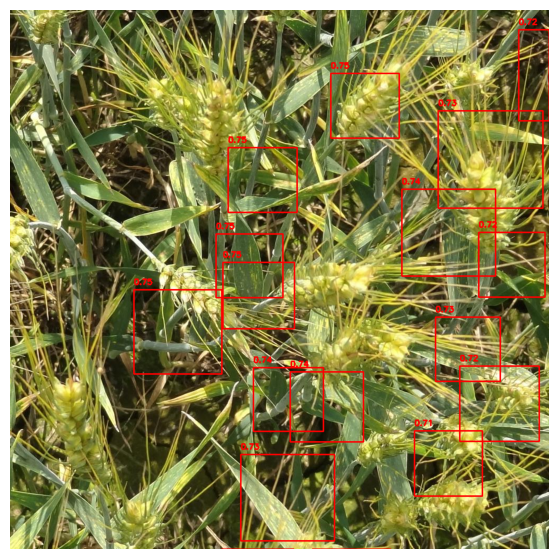

Loading test image: /content/test/cb8d261a3.jpg
Image dimensions: 1024x1024
Number of boxes after filtering: 16
Raw Boxes: [[0.46661586 0.1764899  0.59287155 0.2933124 ]
 [0.5064341  0.12616824 0.63773835 0.24674429]
 [0.4725161  0.44789264 0.6218056  0.59580827]
 [0.6040992  0.0879607  0.73667705 0.21250544]
 [0.60734636 0.37598684 0.7491879  0.5108191 ]
 [0.4779412  0.5944598  0.62448484 0.73802304]
 [0.7622156  0.28078628 0.9147019  0.42701408]
 [0.7358671  0.37760565 0.88594383 0.5233657 ]
 [0.8133614  0.23019451 0.96488774 0.37515613]
 [0.833464   0.32351297 0.98753464 0.45955148]
 [0.851163   0.28313664 1.004507   0.42556375]
 [0.93903446 0.18061665 1.0856483  0.32015067]
 [0.6856665  0.7602662  0.84446716 0.9041425 ]
 [0.9371617  0.2755417  1.0821699  0.41206333]
 [0.94147336 0.4395466  1.0892373  0.57883984]
 [0.8677296  0.6256823  1.0140733  0.7597669 ]]
Scaled Boxes: [[ 477.81464   180.72566   607.10046   300.3519  ]
 [ 518.5885    129.19627   653.04407   252.66615 ]
 [ 483.8

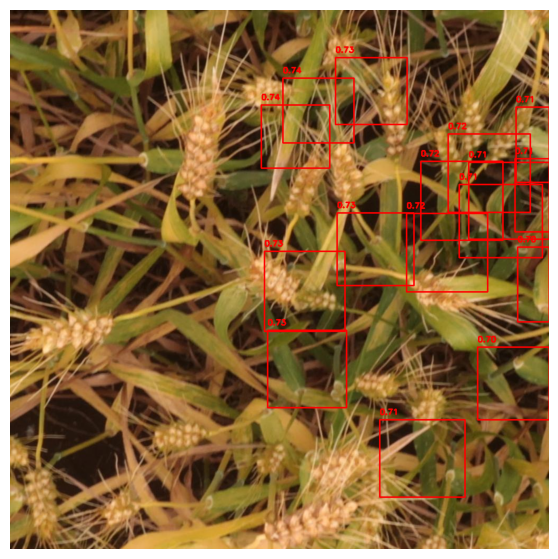

Loading test image: /content/test/51b3e36ab.jpg
Image dimensions: 1024x1024
Number of boxes after filtering: 27
Raw Boxes: [[2.7401611e-01 2.1985260e-01 4.3549246e-01 3.7691218e-01]
 [2.3360889e-01 2.9570401e-01 3.5811827e-01 4.1981268e-01]
 [1.9834930e-01 0.0000000e+00 3.4052595e-01 4.7053318e-02]
 [9.2178829e-02 4.6404995e-02 2.1883281e-01 1.6395876e-01]
 [3.5492033e-01 1.8248878e-01 4.9685675e-01 3.1954920e-01]
 [3.1435061e-02 3.1621987e-01 1.6910876e-01 4.4597793e-01]
 [5.0401686e-06 3.9647812e-01 9.9003844e-02 5.2896374e-01]
 [3.0110401e-01 4.1628620e-01 4.4141632e-01 5.4268032e-01]
 [4.5653969e-01 2.1597537e-01 5.8553535e-01 3.3639315e-01]
 [3.7876946e-01 3.2948056e-01 5.1266587e-01 4.5782176e-01]
 [2.3669299e-01 5.3242898e-01 3.8298073e-01 6.7077607e-01]
 [5.2186352e-01 1.8624008e-01 6.6631150e-01 3.2757771e-01]
 [3.0939448e-01 5.3633934e-01 4.7157711e-01 6.9385725e-01]
 [4.2492425e-01 4.6592906e-01 5.8149648e-01 6.1592877e-01]
 [4.8352733e-01 4.5187590e-01 6.1951083e-01 5.81038

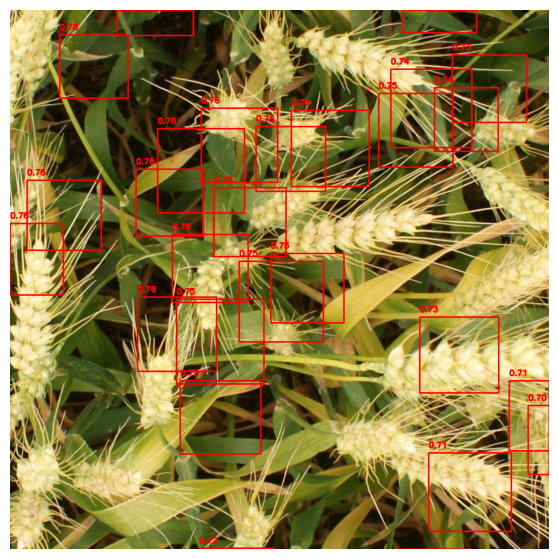

Loading test image: /content/test/53f253011.jpg
Image dimensions: 1024x1024
Number of boxes after filtering: 18
Raw Boxes: [[2.6976252e-01 1.1523648e-01 3.8052452e-01 2.2061229e-01]
 [1.2536411e-01 2.1908602e-02 2.2982642e-01 1.2532592e-01]
 [9.6406743e-02 3.4864280e-02 1.9524057e-01 1.3090251e-01]
 [4.9877167e-06 3.2251662e-01 8.1247576e-02 4.3288511e-01]
 [2.7612180e-01 3.6936530e-01 3.8346249e-01 4.6863288e-01]
 [3.4366310e-01 2.7207482e-01 4.5189002e-01 3.7182304e-01]
 [4.5800917e-02 5.1024896e-01 1.5130928e-01 6.1396080e-01]
 [4.6091804e-01 2.0939881e-01 5.6312150e-01 3.1147730e-01]
 [2.9765695e-01 4.7056204e-01 4.2046058e-01 5.8371091e-01]
 [6.8077943e-03 5.2051926e-01 1.2677298e-01 6.3672775e-01]
 [3.7008986e-01 4.2415476e-01 4.7007018e-01 5.2536339e-01]
 [5.1025403e-01 2.0868346e-01 6.1533916e-01 3.0711275e-01]
 [5.5324048e-01 3.0262288e-01 6.7132717e-01 4.1459778e-01]
 [4.0871900e-01 5.3953981e-01 5.1711214e-01 6.4046341e-01]
 [5.7496506e-01 3.8768786e-01 6.9320023e-01 4.99905

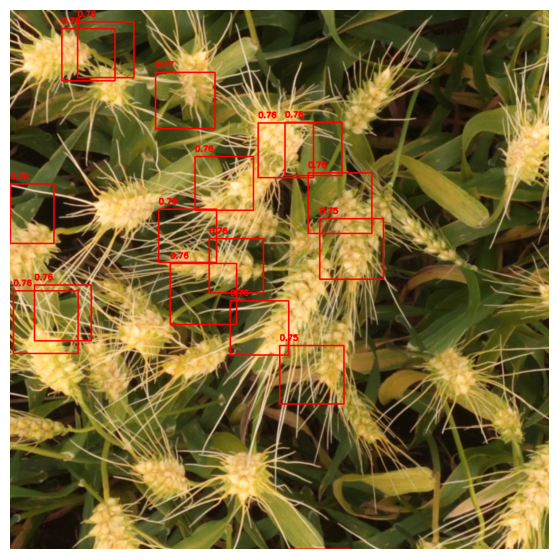

Loading test image: /content/test/348a992bb.jpg
Image dimensions: 1024x1024
Number of boxes after filtering: 19
Raw Boxes: [[0.38044256 0.51417714 0.5163239  0.64299935]
 [0.46549502 0.         0.6006158  0.06255193]
 [0.52146465 0.42145082 0.659757   0.54911387]
 [0.5580677  0.47610208 0.70459723 0.6095525 ]
 [0.49933898 0.5780187  0.63279855 0.705909  ]
 [0.6384107  0.34017757 0.7754531  0.47144222]
 [0.53892934 0.64616215 0.6698848  0.77295524]
 [0.47854373 0.69403267 0.6104603  0.8188926 ]
 [0.6918005  0.5950257  0.8274245  0.72122663]
 [0.8412823  0.25883695 0.9888258  0.3958866 ]
 [0.7690743  0.5542099  0.9081304  0.68244404]
 [0.6468842  0.73363954 0.7833109  0.85650724]
 [0.62859476 0.8436229  0.7678202  0.97185934]
 [0.94091386 0.34691215 1.0797807  0.47848502]
 [0.8776643  0.6474114  1.0165111  0.77415425]
 [0.96915805 0.55666924 1.1078248  0.6883274 ]
 [0.6088934  0.993422   0.73675334 1.1122049 ]
 [1.012513   0.32980162 1.1446884  0.45575142]
 [0.70184004 0.99854195 0.83621

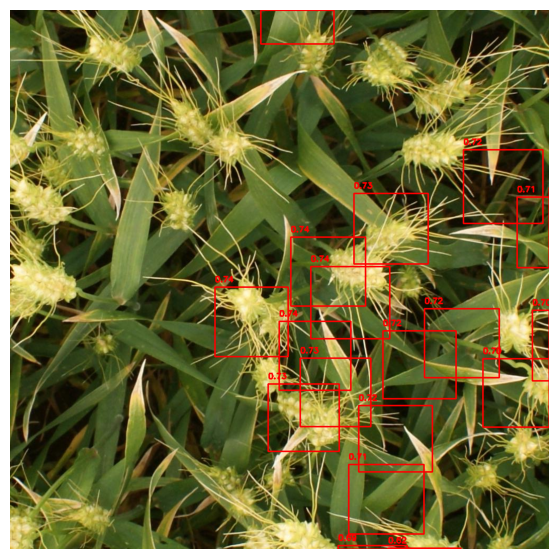

In [ ]:
import matplotlib.pyplot as plt
import torchvision.transforms as T
import cv2
import os
import numpy as np
from PIL import Image
import torch

# Define a function to visualize predictions
def visualize_predictions(model, test_image_dir, device, threshold=0.5, num_images=5):
    """
    Visualize predictions on test images.
    Args:
        model: Trained Faster R-CNN model.
        test_image_dir: Directory containing test images.
        device: Device to run the model on (CPU or GPU).
        threshold: Confidence threshold for displaying bounding boxes.
        num_images: Number of test images to visualize.
    """
    model.eval()  # Set the model to evaluation mode

    # Get list of test images
    test_images = os.listdir(test_image_dir)
    test_images = [img for img in test_images if img.endswith(".jpg")][:num_images]  # Limit the number of images

    for img_file in test_images:
        img_path = os.path.join(test_image_dir, img_file)

        # Load and debug the image
        print(f"Loading test image: {img_path}")
        try:
            image = cv2.imread(img_path, cv2.IMREAD_COLOR)
            if image is None:
                raise ValueError(f"Image {img_path} could not be loaded. Check the path or file format.")
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        except Exception as e:
            print(f"Error loading image: {e}")
            continue

        orig_image = image.copy()  # Keep the original for visualization
        h, w, _ = image.shape
        print(f"Image dimensions: {h}x{w}")

        # Normalize and convert to tensor
        image = image.astype(np.float32) / 255.0  # Normalize to [0, 1]
        image_tensor = torch.tensor(image).permute(2, 0, 1).unsqueeze(0).to(device)  # Add batch dimension

        # Get predictions
        with torch.no_grad():
            outputs = model(image_tensor)

        # Extract predictions
        boxes = outputs[0]['boxes'].cpu().numpy()
        scores = outputs[0]['scores'].cpu().numpy()

        # Filter boxes by confidence threshold
        indices = scores > threshold
        boxes = boxes[indices]
        scores = scores[indices]

        print(f"Number of boxes after filtering: {len(boxes)}")
        print(f"Raw Boxes: {boxes}")

        # Scale normalized boxes back to pixel coordinates
        boxes[:, 0] *= w  # x_min
        boxes[:, 1] *= h  # y_min
        boxes[:, 2] *= w  # x_max
        boxes[:, 3] *= h  # y_max
        print(f"Scaled Boxes: {boxes}")

        # Visualize the predictions
        for box, score in zip(boxes, scores):
            x_min, y_min, x_max, y_max = box.astype(int)
            x_min = max(0, x_min)
            y_min = max(0, y_min)
            x_max = min(w, x_max)
            y_max = min(h, y_max)

            # Draw the bounding box
            cv2.rectangle(orig_image, (x_min, y_min), (x_max, y_max), (255, 0, 0), 2)  # Blue box
            cv2.putText(orig_image, f"{score:.2f}", (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

        # Display the image
        plt.figure(figsize=(7, 7))
        plt.imshow(orig_image)
        plt.axis("off")
        plt.show()

# Define paths and device
test_image_dir = "/content/test"  # Directory containing test images
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

# Call the visualization function
visualize_predictions(model, test_image_dir, device, threshold=0.5, num_images=5)


In [ ]:


def preprocess_and_save(csv_file, image_dir, save_dir, target_size=(256, 256)):
    """
    Preprocesses images and groups bounding boxes per image. Saves them as tensors.
    """
    df = pd.read_csv(csv_file)
    os.makedirs(save_dir, exist_ok=True)

    # Group the bounding boxes by image_id
    grouped = df.groupby("image_id")

    for image_id, group in tqdm(grouped):
        img_path = os.path.join(image_dir, image_id + ".jpg")
        if not os.path.exists(img_path):
            print(f"Image {img_path} not found. Skipping...")
            continue

        # Load and preprocess the image
        image = Image.open(img_path).convert("RGB")
        image = image.resize(target_size)
        image_tensor = F.to_tensor(image)

        if torch.isnan(image_tensor).any() or torch.isinf(image_tensor).any():
         print(f"Invalid tensor for {image_id}. Skipping...")
        continue


        # Save preprocessed image
        torch.save(image_tensor, os.path.join(save_dir, f"{image_id}.pt"))

        # Process and group bounding boxes and labels
        boxes = []
        labels = []

        for _, row in group.iterrows():
            x_min, y_min, width, height = eval(row['bbox'])
            x_max = x_min + width
            y_max = y_min + height

            #print()

       #     # Normalize bounding boxes with respect to image dimensions
        #    x_min /= row['width']
         #   y_min /= row['height']
          #  x_max /= row['width']
           # y_max /= row['height']

           # Normalize and clamp bounding boxes
            x_min = max(0, min(1, x_min / row['width']))
            y_min = max(0, min(1, y_min / row['height']))
            x_max = max(0, min(1, x_max / row['width']))
            y_max = max(0, min(1, y_max / row['height']))

            if x_min >= x_max or y_min >= y_max:
                print(f"Skipping invalid box: {x_min, y_min, x_max, y_max}")
                continue  # Skip invalid boxes


            # Append the bounding box and label
            boxes.append([x_min, y_min, x_max, y_max])
            labels.append(1)  # Assuming label 1 is for wheat spike

        # Convert to tensors
        boxes = torch.tensor(boxes, dtype=torch.float32)
        labels = torch.tensor(labels, dtype=torch.int64)

        # Save target as a single dictionary per image
        target = {"boxes": boxes, "labels": labels}
       # print(target)
        #print(type(target))
        torch.save(target, os.path.join(save_dir, f"{image_id}_target.pt"))


preprocess_and_save(csv_file, image_dir, save_dir, target_size=(256, 256))


100%|██████████| 3373/3373 [01:00<00:00, 56.10it/s]


In [ ]:
import os
import torch
import numpy as np
import pandas as pd
from PIL import Image
from sklearn.model_selection import train_test_split
from torch.utils.data import Dataset, DataLoader
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.transforms import functional as F
from tqdm import tqdm

# Define the WheatDataset class
class WheatDataset(Dataset):
    def __init__(self, image_ids, dataframe, image_dir, transforms=None):
        self.image_ids = image_ids
        self.df = dataframe
        self.image_dir = image_dir
        self.transforms = transforms

    def __len__(self):
        return len(self.image_ids)

    def __getitem__(self, idx):
        image_id = self.image_ids[idx]
        records = self.df[self.df['image_id'] == image_id]

        # Load the image
        img_path = os.path.join(self.image_dir, f"{image_id}.jpg")
        if not os.path.exists(img_path):
            raise ValueError(f"Image {img_path} not found.")
        image = Image.open(img_path).convert("RGB")
        image = np.array(image).astype(np.float32) / 255.0  # Normalize to [0, 1]

        # Extract bounding boxes and labels
        h, w, _ = image.shape
        boxes = records[['x', 'y', 'w', 'h']].values
        boxes[:, 2] += boxes[:, 0]  # Convert width to x_max
        boxes[:, 3] += boxes[:, 1]  # Convert height to y_max
        boxes[:, 0] /= w  # Normalize x_min
        boxes[:, 1] /= h  # Normalize y_min
        boxes[:, 2] /= w  # Normalize x_max
        boxes[:, 3] /= h  # Normalize y_max
        boxes = torch.tensor(boxes, dtype=torch.float32)

        # Labels
        labels = torch.ones((len(boxes),), dtype=torch.int64)  # Class 1 for wheat spikes

        # Compute areas
        area = (boxes[:, 2] - boxes[:, 0]) * (boxes[:, 3] - boxes[:, 1])

        # Prepare the target dictionary
        target = {
            'boxes': boxes,
            'labels': labels,
            'area': area,
            'image_id': torch.tensor([idx]),
        }

        # Convert image to tensor
        image = torch.tensor(image).permute(2, 0, 1)  # (H, W, C) -> (C, H, W)

        return image, target


# Prepare DataFrame and split into train/validation sets
csv_file = '/content/train.csv'  # Update path to your annotations CSV
image_dir = '/content/train/'  # Update path to your images directory

df = pd.read_csv(csv_file)
df['x'] = df['bbox'].apply(lambda x: eval(x)[0])  # x_min
df['y'] = df['bbox'].apply(lambda x: eval(x)[1])  # y_min
df['w'] = df['bbox'].apply(lambda x: eval(x)[2])  # width
df['h'] = df['bbox'].apply(lambda x: eval(x)[3])  # height
train_df, val_df = train_test_split(df, test_size=0.2, random_state=42)

train_dataset = WheatDataset(train_df['image_id'].unique(), train_df, image_dir)
val_dataset = WheatDataset(val_df['image_id'].unique(), val_df, image_dir)

train_loader = DataLoader(train_dataset, batch_size=2, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
val_loader = DataLoader(val_dataset, batch_size=2, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

# Initialize the Faster R-CNN model
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model = fasterrcnn_resnet50_fpn(num_classes=2)
model.to(device)

# Optimizer and Learning Rate Scheduler
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

# Training Loop
from torch.cuda.amp import GradScaler, autocast

num_epochs = 5
scaler = GradScaler()

checkpoint_dir = '/content/checkpoints/'
os.makedirs(checkpoint_dir, exist_ok=True)

for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0

    for images, targets in tqdm(train_loader, desc=f"Epoch {epoch + 1}"):
        # Move data to GPU
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        optimizer.zero_grad()
        with autocast():
            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())
        scaler.scale(losses).backward()
        scaler.step(optimizer)
        scaler.update()

        epoch_loss += losses.item()

    lr_scheduler.step()
    print(f"Epoch {epoch + 1}, Loss: {epoch_loss:.4f}")

    # Save model checkpoint
    checkpoint_path = os.path.join(checkpoint_dir, f"faster_rcnn_epoch_{epoch + 1}.pth")
    torch.save({
        'epoch': epoch + 1,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'scaler_state_dict': scaler.state_dict(),
    }, checkpoint_path)
    print(f"Checkpoint saved at {checkpoint_path}")

# Validation
model.eval()
with torch.no_grad():
    for images, targets in tqdm(val_loader, desc="Validation"):
        images = [img.to(device) for img in images]
        outputs = model(images)  # List of dicts with keys: 'boxes', 'labels', 'scores'
        print(outputs)  # For debugging, replace with visualization logic


<ipython-input-44-92bb49ed4eb7>:95: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
Epoch 1:   0%|          | 0/1685 [00:00<?, ?it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 1:   0%|          | 1/1685 [00:00<05:32,  5.06it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 1:   0%|          | 2/1685 [00:00<04:15,  6.59it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 1:   0%|          | 3/1685 [00:00<03:53,  7.20it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `tor

Epoch 1, Loss: 22917.1446
Checkpoint saved at /content/checkpoints/faster_rcnn_epoch_1.pth


Epoch 2:   0%|          | 0/1685 [00:00<?, ?it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 2:   0%|          | 1/1685 [00:00<03:16,  8.58it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 2:   0%|          | 2/1685 [00:00<03:21,  8.34it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 2:   0%|          | 3/1685 [00:00<03:26,  8.16it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 2:   0%|          | 4/1685 [00:00<03:23,  8.26it/s]<ipytho

Epoch 2, Loss: nan
Checkpoint saved at /content/checkpoints/faster_rcnn_epoch_2.pth


Epoch 3:   0%|          | 0/1685 [00:00<?, ?it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 3:   0%|          | 1/1685 [00:00<03:07,  8.98it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 3:   0%|          | 2/1685 [00:00<03:08,  8.92it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 3:   0%|          | 3/1685 [00:00<03:07,  8.98it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 3:   0%|          | 4/1685 [00:00<03:16,  8.56it/s]<ipytho

Epoch 3, Loss: nan
Checkpoint saved at /content/checkpoints/faster_rcnn_epoch_3.pth


Epoch 4:   0%|          | 0/1685 [00:00<?, ?it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 4:   0%|          | 1/1685 [00:00<03:20,  8.41it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 4:   0%|          | 2/1685 [00:00<04:10,  6.71it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 4:   0%|          | 3/1685 [00:00<03:41,  7.61it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 4:   0%|          | 4/1685 [00:00<03:28,  8.06it/s]<ipytho

Epoch 4, Loss: nan
Checkpoint saved at /content/checkpoints/faster_rcnn_epoch_4.pth


Epoch 5:   0%|          | 0/1685 [00:00<?, ?it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 5:   0%|          | 1/1685 [00:00<03:00,  9.34it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 5:   0%|          | 2/1685 [00:00<03:04,  9.14it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 5:   0%|          | 3/1685 [00:00<03:06,  9.02it/s]<ipython-input-44-92bb49ed4eb7>:110: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 5:   0%|          | 4/1685 [00:00<03:06,  9.03it/s]<ipytho

Epoch 5, Loss: nan
Checkpoint saved at /content/checkpoints/faster_rcnn_epoch_5.pth


Validation:   0%|          | 2/1665 [00:00<02:00, 13.84it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   0%|          | 4/1665 [00:00<01:51, 14.95it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   0%|          | 6/1665 [00:00<01:50, 15.00it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   1%|          | 10/1665 [00:00<01:51, 14.81it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:   1%|          | 12/1665 [00:00<01:54, 14.42it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   1%|          | 14/1665 [00:00<01:53, 14.57it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   1%|          | 16/1665 [00:01<01:50, 14.98it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   1%|          | 18/1665 [00:01<01:48, 15.18it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   1%|          | 20/1665 [00:01<01:47, 15.31it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   1%|▏         | 22/1665 [00:01<01:47, 15.35it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   1%|▏         | 24/1665 [00:01<01:45, 15.57it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   2%|▏         | 26/1665 [00:01<01:44, 15.69it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   2%|▏         | 28/1665 [00:01<01:45, 15.46it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   2%|▏         | 30/1665 [00:01<01:45, 15.47it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   2%|▏         | 32/1665 [00:02<01:44, 15.64it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   2%|▏         | 34/1665 [00:02<01:44, 15.62it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   2%|▏         | 36/1665 [00:02<01:44, 15.63it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   2%|▏         | 38/1665 [00:02<01:44, 15.63it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   2%|▏         | 40/1665 [00:02<01:44, 15.61it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   3%|▎         | 42/1665 [00:02<01:45, 15.39it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   3%|▎         | 44/1665 [00:02<01:44, 15.55it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   3%|▎         | 46/1665 [00:03<01:42, 15.72it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   3%|▎         | 48/1665 [00:03<01:42, 15.73it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   3%|▎         | 50/1665 [00:03<01:42, 15.68it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   3%|▎         | 52/1665 [00:03<01:44, 15.38it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   3%|▎         | 54/1665 [00:03<01:43, 15.58it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   3%|▎         | 56/1665 [00:03<01:42, 15.73it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   3%|▎         | 58/1665 [00:03<01:41, 15.85it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   4%|▎         | 60/1665 [00:03<01:44, 15.34it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   4%|▎         | 62/1665 [00:04<01:45, 15.13it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   4%|▍         | 64/1665 [00:04<01:45, 15.15it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   4%|▍         | 66/1665 [00:04<01:45, 15.21it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   4%|▍         | 68/1665 [00:04<01:43, 15.42it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   4%|▍         | 70/1665 [00:04<01:43, 15.35it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   4%|▍         | 72/1665 [00:04<01:44, 15.31it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   4%|▍         | 74/1665 [00:04<01:44, 15.18it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   5%|▍         | 76/1665 [00:04<01:43, 15.29it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   5%|▍         | 78/1665 [00:05<01:43, 15.38it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   5%|▍         | 80/1665 [00:05<01:43, 15.30it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   5%|▍         | 82/1665 [00:05<01:43, 15.31it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   5%|▌         | 84/1665 [00:05<01:43, 15.22it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   5%|▌         | 86/1665 [00:05<01:46, 14.88it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   5%|▌         | 88/1665 [00:05<01:46, 14.86it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   5%|▌         | 90/1665 [00:05<01:46, 14.80it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   6%|▌         | 92/1665 [00:06<01:45, 14.93it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   6%|▌         | 94/1665 [00:06<01:43, 15.20it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   6%|▌         | 96/1665 [00:06<01:42, 15.29it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   6%|▌         | 98/1665 [00:06<01:42, 15.35it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   6%|▌         | 100/1665 [00:06<01:42, 15.29it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   6%|▌         | 102/1665 [00:06<01:42, 15.21it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   6%|▋         | 106/1665 [00:06<01:44, 14.98it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:   7%|▋         | 110/1665 [00:07<01:41, 15.29it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:   7%|▋         | 114/1665 [00:07<01:41, 15.25it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:   7%|▋         | 118/1665 [00:07<01:42, 15.11it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:   7%|▋         | 122/1665 [00:07<01:40, 15.29it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:   7%|▋         | 124/1665 [00:08<01:43, 14.95it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   8%|▊         | 126/1665 [00:08<01:42, 14.94it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   8%|▊         | 128/1665 [00:08<01:41, 15.20it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   8%|▊         | 130/1665 [00:08<01:41, 15.19it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   8%|▊         | 132/1665 [00:08<01:42, 15.01it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   8%|▊         | 134/1665 [00:08<01:41, 15.10it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   8%|▊         | 136/1665 [00:08<01:40, 15.18it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   8%|▊         | 138/1665 [00:09<01:39, 15.28it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   8%|▊         | 140/1665 [00:09<01:39, 15.27it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   9%|▊         | 142/1665 [00:09<01:39, 15.25it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   9%|▊         | 144/1665 [00:09<01:39, 15.24it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   9%|▉         | 146/1665 [00:09<01:39, 15.26it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   9%|▉         | 148/1665 [00:09<01:39, 15.27it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   9%|▉         | 150/1665 [00:09<01:38, 15.36it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   9%|▉         | 152/1665 [00:09<01:39, 15.23it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   9%|▉         | 154/1665 [00:10<01:41, 14.86it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   9%|▉         | 156/1665 [00:10<01:39, 15.12it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:   9%|▉         | 158/1665 [00:10<01:39, 15.14it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  10%|▉         | 160/1665 [00:10<01:38, 15.22it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  10%|▉         | 162/1665 [00:10<01:39, 15.13it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  10%|▉         | 164/1665 [00:10<01:38, 15.27it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  10%|▉         | 166/1665 [00:10<01:37, 15.41it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  10%|█         | 168/1665 [00:11<01:36, 15.44it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  10%|█         | 170/1665 [00:11<01:36, 15.45it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  10%|█         | 172/1665 [00:11<01:35, 15.62it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  10%|█         | 174/1665 [00:11<01:36, 15.43it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  11%|█         | 176/1665 [00:11<01:35, 15.63it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  11%|█         | 178/1665 [00:11<01:35, 15.65it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  11%|█         | 180/1665 [00:11<01:34, 15.78it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  11%|█         | 182/1665 [00:11<01:34, 15.67it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  11%|█         | 184/1665 [00:12<01:34, 15.67it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  11%|█         | 186/1665 [00:12<01:34, 15.71it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  11%|█▏        | 188/1665 [00:12<01:33, 15.73it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  11%|█▏        | 190/1665 [00:12<01:33, 15.84it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  12%|█▏        | 192/1665 [00:12<01:34, 15.60it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  12%|█▏        | 194/1665 [00:12<01:34, 15.56it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  12%|█▏        | 196/1665 [00:12<01:34, 15.62it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  12%|█▏        | 198/1665 [00:12<01:34, 15.52it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  12%|█▏        | 200/1665 [00:13<01:34, 15.47it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  12%|█▏        | 202/1665 [00:13<01:35, 15.40it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  12%|█▏        | 204/1665 [00:13<01:35, 15.26it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  12%|█▏        | 206/1665 [00:13<01:35, 15.26it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  12%|█▏        | 208/1665 [00:13<01:36, 15.09it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  13%|█▎        | 210/1665 [00:13<01:35, 15.17it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  13%|█▎        | 212/1665 [00:13<01:37, 14.93it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  13%|█▎        | 214/1665 [00:14<01:36, 15.06it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  13%|█▎        | 216/1665 [00:14<01:35, 15.13it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  13%|█▎        | 218/1665 [00:14<01:34, 15.24it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  13%|█▎        | 220/1665 [00:14<01:35, 15.14it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  13%|█▎        | 222/1665 [00:14<01:35, 15.17it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  13%|█▎        | 224/1665 [00:14<01:34, 15.23it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  14%|█▎        | 226/1665 [00:14<01:34, 15.31it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  14%|█▎        | 228/1665 [00:14<01:33, 15.43it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  14%|█▍        | 230/1665 [00:15<01:32, 15.50it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  14%|█▍        | 232/1665 [00:15<01:33, 15.29it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  14%|█▍        | 234/1665 [00:15<01:33, 15.32it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  14%|█▍        | 236/1665 [00:15<01:33, 15.31it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  14%|█▍        | 238/1665 [00:15<01:32, 15.35it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  14%|█▍        | 240/1665 [00:15<01:32, 15.33it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  15%|█▍        | 242/1665 [00:15<01:33, 15.21it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  15%|█▍        | 244/1665 [00:15<01:32, 15.40it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  15%|█▍        | 246/1665 [00:16<01:31, 15.59it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  15%|█▍        | 248/1665 [00:16<01:30, 15.63it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  15%|█▌        | 250/1665 [00:16<01:31, 15.46it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  15%|█▌        | 252/1665 [00:16<01:31, 15.48it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  15%|█▌        | 254/1665 [00:16<01:30, 15.56it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  15%|█▌        | 256/1665 [00:16<01:31, 15.45it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  15%|█▌        | 258/1665 [00:16<01:32, 15.22it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  16%|█▌        | 260/1665 [00:16<01:32, 15.19it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  16%|█▌        | 262/1665 [00:17<01:32, 15.22it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  16%|█▌        | 264/1665 [00:17<01:32, 15.19it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  16%|█▌        | 266/1665 [00:17<01:33, 14.95it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  16%|█▌        | 268/1665 [00:17<01:31, 15.24it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  16%|█▌        | 270/1665 [00:17<01:30, 15.47it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  16%|█▋        | 272/1665 [00:17<01:30, 15.47it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  16%|█▋        | 274/1665 [00:17<01:29, 15.47it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  17%|█▋        | 276/1665 [00:18<01:30, 15.43it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  17%|█▋        | 278/1665 [00:18<01:32, 15.07it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  17%|█▋        | 280/1665 [00:18<01:31, 15.17it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  17%|█▋        | 282/1665 [00:18<01:31, 15.06it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  17%|█▋        | 284/1665 [00:18<01:31, 15.06it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  17%|█▋        | 286/1665 [00:18<01:30, 15.18it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  17%|█▋        | 288/1665 [00:18<01:30, 15.26it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  17%|█▋        | 290/1665 [00:18<01:29, 15.30it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  18%|█▊        | 292/1665 [00:19<01:29, 15.42it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  18%|█▊        | 294/1665 [00:19<01:29, 15.38it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  18%|█▊        | 296/1665 [00:19<01:29, 15.32it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  18%|█▊        | 298/1665 [00:19<01:29, 15.23it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  18%|█▊        | 300/1665 [00:19<01:29, 15.19it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  18%|█▊        | 302/1665 [00:19<01:30, 15.10it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  18%|█▊        | 304/1665 [00:19<01:29, 15.22it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  18%|█▊        | 306/1665 [00:20<01:29, 15.22it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  18%|█▊        | 308/1665 [00:20<01:28, 15.38it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  19%|█▊        | 310/1665 [00:20<01:27, 15.54it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  19%|█▊        | 312/1665 [00:20<01:27, 15.48it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  19%|█▉        | 314/1665 [00:20<01:27, 15.52it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  19%|█▉        | 316/1665 [00:20<01:28, 15.17it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  19%|█▉        | 318/1665 [00:20<01:29, 15.00it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  19%|█▉        | 320/1665 [00:20<01:28, 15.18it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  19%|█▉        | 322/1665 [00:21<01:27, 15.40it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  20%|█▉        | 326/1665 [00:21<01:27, 15.23it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  20%|█▉        | 330/1665 [00:21<01:26, 15.36it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  20%|█▉        | 332/1665 [00:21<01:28, 15.13it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  20%|██        | 334/1665 [00:21<01:28, 15.09it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  20%|██        | 336/1665 [00:21<01:27, 15.23it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  20%|██        | 338/1665 [00:22<01:25, 15.46it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  20%|██        | 340/1665 [00:22<01:25, 15.52it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  21%|██        | 342/1665 [00:22<01:25, 15.56it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  21%|██        | 344/1665 [00:22<01:25, 15.44it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  21%|██        | 346/1665 [00:22<01:25, 15.51it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  21%|██        | 348/1665 [00:22<01:24, 15.59it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  21%|██        | 350/1665 [00:22<01:23, 15.73it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  21%|██        | 352/1665 [00:22<01:23, 15.78it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  21%|██▏       | 354/1665 [00:23<01:24, 15.44it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  21%|██▏       | 356/1665 [00:23<01:25, 15.33it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  22%|██▏       | 360/1665 [00:23<01:26, 15.04it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  22%|██▏       | 364/1665 [00:23<01:24, 15.43it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  22%|██▏       | 368/1665 [00:24<01:23, 15.55it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  22%|██▏       | 372/1665 [00:24<01:23, 15.40it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  23%|██▎       | 376/1665 [00:24<01:24, 15.32it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  23%|██▎       | 380/1665 [00:24<01:23, 15.32it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  23%|██▎       | 384/1665 [00:25<01:21, 15.68it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  23%|██▎       | 388/1665 [00:25<01:21, 15.62it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  24%|██▎       | 392/1665 [00:25<01:22, 15.52it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  24%|██▍       | 396/1665 [00:25<01:20, 15.68it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  24%|██▍       | 400/1665 [00:26<01:20, 15.72it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  24%|██▍       | 404/1665 [00:26<01:19, 15.94it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  25%|██▍       | 408/1665 [00:26<01:18, 15.97it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  25%|██▍       | 412/1665 [00:26<01:19, 15.69it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  25%|██▍       | 416/1665 [00:27<01:17, 16.07it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  25%|██▌       | 420/1665 [00:27<01:18, 15.88it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  25%|██▌       | 424/1665 [00:27<01:18, 15.78it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  26%|██▌       | 428/1665 [00:27<01:17, 15.95it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  26%|██▌       | 432/1665 [00:28<01:18, 15.76it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  26%|██▌       | 436/1665 [00:28<01:17, 15.77it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  26%|██▋       | 440/1665 [00:28<01:19, 15.49it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  27%|██▋       | 444/1665 [00:28<01:17, 15.67it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  27%|██▋       | 448/1665 [00:29<01:18, 15.53it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  27%|██▋       | 452/1665 [00:29<01:18, 15.51it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  27%|██▋       | 456/1665 [00:29<01:17, 15.59it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  28%|██▊       | 460/1665 [00:29<01:16, 15.78it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  28%|██▊       | 464/1665 [00:30<01:15, 15.88it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  28%|██▊       | 468/1665 [00:30<01:15, 15.81it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  28%|██▊       | 472/1665 [00:30<01:16, 15.57it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  29%|██▊       | 476/1665 [00:30<01:15, 15.66it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  29%|██▉       | 480/1665 [00:31<01:15, 15.73it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  29%|██▉       | 482/1665 [00:31<01:16, 15.38it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  29%|██▉       | 486/1665 [00:31<01:17, 15.28it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  29%|██▉       | 490/1665 [00:31<01:17, 15.16it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  30%|██▉       | 494/1665 [00:32<01:17, 15.08it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  30%|██▉       | 498/1665 [00:32<01:17, 15.01it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  30%|███       | 502/1665 [00:32<01:18, 14.90it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  30%|███       | 506/1665 [00:32<01:17, 14.88it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  31%|███       | 510/1665 [00:33<01:16, 15.09it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  31%|███       | 514/1665 [00:33<01:16, 15.13it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  31%|███       | 518/1665 [00:33<01:15, 15.24it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  31%|███▏      | 522/1665 [00:33<01:14, 15.40it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  32%|███▏      | 526/1665 [00:34<01:12, 15.72it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  32%|███▏      | 530/1665 [00:34<01:12, 15.75it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  32%|███▏      | 534/1665 [00:34<01:12, 15.60it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  32%|███▏      | 538/1665 [00:35<01:12, 15.65it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  33%|███▎      | 542/1665 [00:35<01:11, 15.78it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  33%|███▎      | 546/1665 [00:35<01:11, 15.60it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  33%|███▎      | 550/1665 [00:35<01:10, 15.71it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  33%|███▎      | 554/1665 [00:36<01:11, 15.60it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  34%|███▎      | 558/1665 [00:36<01:10, 15.63it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  34%|███▍      | 562/1665 [00:36<01:11, 15.51it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  34%|███▍      | 566/1665 [00:36<01:11, 15.47it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  34%|███▍      | 570/1665 [00:37<01:10, 15.44it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  34%|███▍      | 574/1665 [00:37<01:10, 15.40it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  35%|███▍      | 578/1665 [00:37<01:11, 15.20it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  35%|███▍      | 582/1665 [00:37<01:11, 15.23it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  35%|███▌      | 586/1665 [00:38<01:10, 15.29it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  35%|███▌      | 590/1665 [00:38<01:10, 15.22it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  36%|███▌      | 594/1665 [00:38<01:10, 15.19it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  36%|███▌      | 598/1665 [00:38<01:09, 15.41it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  36%|███▌      | 602/1665 [00:39<01:08, 15.44it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  36%|███▋      | 606/1665 [00:39<01:08, 15.39it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  37%|███▋      | 610/1665 [00:39<01:06, 15.80it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  37%|███▋      | 614/1665 [00:39<01:05, 15.94it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  37%|███▋      | 618/1665 [00:40<01:05, 15.99it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  37%|███▋      | 622/1665 [00:40<01:04, 16.10it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  38%|███▊      | 626/1665 [00:40<01:04, 16.14it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  38%|███▊      | 630/1665 [00:40<01:06, 15.54it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  38%|███▊      | 634/1665 [00:41<01:06, 15.56it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  38%|███▊      | 638/1665 [00:41<01:06, 15.53it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  39%|███▊      | 642/1665 [00:41<01:05, 15.61it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  39%|███▉      | 646/1665 [00:41<01:04, 15.71it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  39%|███▉      | 650/1665 [00:42<01:04, 15.76it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  39%|███▉      | 654/1665 [00:42<01:05, 15.41it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  40%|███▉      | 658/1665 [00:42<01:05, 15.32it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  40%|███▉      | 662/1665 [00:42<01:04, 15.56it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  40%|████      | 666/1665 [00:43<01:03, 15.78it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  40%|████      | 670/1665 [00:43<01:02, 15.82it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  40%|████      | 674/1665 [00:43<01:03, 15.55it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  41%|████      | 678/1665 [00:44<01:03, 15.45it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  41%|████      | 682/1665 [00:44<01:03, 15.40it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  41%|████      | 684/1665 [00:44<01:03, 15.33it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  41%|████▏     | 688/1665 [00:44<01:11, 13.67it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  42%|████▏     | 692/1665 [00:44<01:07, 14.42it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  42%|████▏     | 696/1665 [00:45<01:05, 14.89it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  42%|████▏     | 700/1665 [00:45<01:04, 15.02it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  42%|████▏     | 704/1665 [00:45<01:03, 15.20it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  43%|████▎     | 708/1665 [00:46<01:03, 15.08it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  43%|████▎     | 710/1665 [00:46<01:04, 14.84it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  43%|████▎     | 714/1665 [00:46<01:04, 14.71it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  43%|████▎     | 718/1665 [00:46<01:03, 14.83it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  43%|████▎     | 722/1665 [00:46<01:02, 15.06it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  44%|████▎     | 726/1665 [00:47<01:01, 15.25it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  44%|████▍     | 730/1665 [00:47<01:02, 15.07it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


Validation:  44%|████▍     | 734/1665 [00:47<01:02, 14.90it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  44%|████▍     | 738/1665 [00:48<01:00, 15.42it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  45%|████▍     | 742/1665 [00:48<00:58, 15.65it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  45%|████▍     | 746/1665 [00:48<00:59, 15.36it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  45%|████▌     | 750/1665 [00:48<00:58, 15.52it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  45%|████▌     | 754/1665 [00:49<00:59, 15.19it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  46%|████▌     | 758/1665 [00:49<00:59, 15.30it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  46%|████▌     | 762/1665 [00:49<00:58, 15.52it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  46%|████▌     | 766/1665 [00:49<00:57, 15.63it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  46%|████▌     | 770/1665 [00:50<00:56, 15.91it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  46%|████▋     | 774/1665 [00:50<00:56, 15.80it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  47%|████▋     | 778/1665 [00:50<00:56, 15.84it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  47%|████▋     | 782/1665 [00:50<00:55, 16.00it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  47%|████▋     | 786/1665 [00:51<00:56, 15.45it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  47%|████▋     | 790/1665 [00:51<00:54, 15.92it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  48%|████▊     | 794/1665 [00:51<00:56, 15.47it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  48%|████▊     | 798/1665 [00:51<00:55, 15.73it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  48%|████▊     | 802/1665 [00:52<00:54, 15.84it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  48%|████▊     | 806/1665 [00:52<00:54, 15.79it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  49%|████▊     | 810/1665 [00:52<00:54, 15.69it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  49%|████▉     | 814/1665 [00:52<00:53, 15.99it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  49%|████▉     | 818/1665 [00:53<00:52, 16.08it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  49%|████▉     | 822/1665 [00:53<00:52, 16.01it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  50%|████▉     | 826/1665 [00:53<00:53, 15.76it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  50%|████▉     | 830/1665 [00:53<00:52, 15.89it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]
[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=

Validation:  50%|████▉     | 831/1665 [00:54<00:54, 15.39it/s]

[{'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}, {'boxes': tensor([], device='cuda:0', size=(0, 4)), 'labels': tensor([], device='cuda:0', dtype=torch.int64), 'scores': tensor([], device='cuda:0')}]


KeyboardInterrupt: 

In [ ]:
import matplotlib.pyplot as plt
import torchvision.transforms as T
import cv2
import os
import numpy as np


# Define a function to visualize predictions
def visualize_predictions(model, test_image_dir, device, threshold=0.5, num_images=5):
    """
    Visualize predictions on test images.
    Args:
        model: Trained Faster R-CNN model.
        test_image_dir: Directory containing test images.
        device: Device to run the model on (CPU or GPU).
        threshold: Confidence threshold for displaying bounding boxes.
        num_images: Number of test images to visualize.
    """
    model.eval()  # Set the model to evaluation mode

    test_images = os.listdir(test_image_dir)
    test_images = [img for img in test_images if img.endswith(".jpg")][:num_images]  # Limit the number of images

    for img_file in test_images:
        img_path = os.path.join(test_image_dir, img_file)
        # Load and preprocess the image
        image = Image.open(img_path).convert("RGB")
        orig_image = np.array(image)  # Store the original image for visualization
        transform = T.ToTensor()
        image = transform(image).to(device)
        image = image.unsqueeze(0)  # Add batch dimension

        # Get predictions
        with torch.no_grad():
            outputs = model(image)

        # Extract predictions
        boxes = outputs[0]['boxes'].cpu().numpy()
        scores = outputs[0]['scores'].cpu().numpy()

        # Filter boxes by confidence threshold
        indices = scores > threshold
        boxes = boxes[indices]
        scores = scores[indices]

        # Visualize the predictions
        for box, score in zip(boxes, scores):
            x_min, y_min, x_max, y_max = box.astype(int)
            cv2.rectangle(orig_image, (x_min, y_min), (x_max, y_max), (255, 0, 0), 2)
            cv2.putText(orig_image, f"{score:.2f}", (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

        # Display the image
        plt.figure(figsize=(10, 10))
        plt.imshow(orig_image)
        plt.axis("off")
        plt.show()

# Define paths and device
test_image_dir = "/content/test"  # Directory containing test images
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

# Call the visualization function
visualize_predictions(model, test_image_dir, device, threshold=0.5, num_images=5)
